In [16]:
# !conda init powershell 
# !conda activate tree-mes

In [17]:
# !pip install statsmodels

In [18]:
# !pip install xgboost

In [19]:
# !pip install optuna

In [20]:
# !pip install seaborn --upgrade

In [21]:
# !pip install -U scikit-learn
# !pip install wandb
# !pip install shap
# !pip install tifffile
# !pip install imagecodecs
# !pip install numba.core
# import shap
# !pip install opencv-python
from tqdm import tqdm
import seaborn as sns
import matplotlib.pyplot as plt
import joblib

In [22]:
import pickle
import wandb
import networkx as nx

In [23]:
from os import path,listdir,mkdir,rename,chdir
import time
from datetime import datetime
import json
from math import floor
import re


In [24]:
import pandas as pd
pd.options.mode.chained_assignment = None
pd.set_option('display.max_rows', 100)
import numpy as np
import statsmodels.api as sm
from sklearn.model_selection import train_test_split,GroupShuffleSplit,GroupKFold
from sklearn.preprocessing import (MinMaxScaler,StandardScaler,PowerTransformer,
                                   PolynomialFeatures,OneHotEncoder,RobustScaler,QuantileTransformer)
from sklearn.ensemble import GradientBoostingRegressor,RandomForestRegressor
from sklearn.linear_model import LinearRegression, LassoCV,ElasticNetCV, SGDRegressor
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn import model_selection
from sklearn.model_selection import cross_val_score
from sklearn.metrics import mean_squared_error,make_scorer,mean_squared_log_error
import time
from sklearn.model_selection import KFold, cross_validate, StratifiedKFold, GroupKFold
from sklearn.pipeline import Pipeline

from xgboost import XGBRegressor
import optuna

from sklearn.decomposition import PCA
from sklearn.inspection import permutation_importance

In [25]:
# from tensorflow.keras.layers import Input,LeakyReLU
# from tensorflow.keras import Model,callbacks, optimizers,regularizers
# from tensorflow.keras.layers import Dense, Dropout,BatchNormalization,Activation
# from tensorflow.keras.optimizers import Adam,RMSprop,Adadelta,Adagrad,Adamax,Nadam,Ftrl,SGD
# from tensorflow.keras.backend import clear_session
# from tensorflow.keras.models import clone_model

In [26]:
from vision.feature_extractor.feature_extractor import *
from MHS.F_model_training import *

In [27]:
scalers = {"Standard":StandardScaler(),
            "MinMax":MinMaxScaler(),
            "Power":PowerTransformer(),
          "Quantile":QuantileTransformer(),
          "Robust":RobustScaler()}

In [28]:
remove_from_drop = ["foliage_fullness", "n_clust_arr_4", "cv2", "cv3", "cv4", "cv5", "q1", "q3"]

In [29]:
use_best_study = True
cfg = OmegaConf.load("/home/fruitspec-lab/FruitSpec/Code/roi/fsCounter/MHS/model_config.yaml")
validate_output_path(cfg.output_folder)
final_cols, drop_final = get_rel_cols(cfg)
f_df = read_f_df(cfg)
features_df = read_data(cfg)
full_name_org = get_full_name(features_df)

drop_final = [col for col in drop_final if col not in remove_from_drop]

features_df_clean = clean_the_df(features_df, drop_final, cfg)
features_df_w_f = add_fs(features_df_clean, f_df)
full_name_clean = get_full_name(features_df_w_f)
dropped_obs = features_df[~full_name_org.isin(full_name_clean)]
dropped_obs.to_csv("dropped_obs.csv", index=False)

X_tr_lr, y, groups = get_X_y(features_df_w_f, cfg)
X_train_trees = X_tr_lr[[col for col in cfg.tree_cols if col in X_tr_lr.columns]]

In [30]:
features_df_clean_w_f = features_df_w_f

In [31]:
features_df_clean_w_f.columns

Index(['total_foliage', 'total_orange', 'volume', 'surface_area', 'avg_volume',
       'foliage_fullness', 'center_width', 'center_perimeter', 'center_height',
       'w_h_ratio', 'q1', 'q3', 'med_intens_arr', 'fruit_foliage_ratio',
       'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr',
       'clusters_area_mean_arr', 'clusters_area_med_arr',
       'clusters_ch_area_mean_arr', 'clusters_ch_area_med_arr',
       'n_clust_arr_2', 'n_clust_arr_4', 'q_1_precent_fruits',
       'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi',
       'ndri', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew',
       'gli_skew', 'cv', 'cv2', 'cv3', 'cv4', 'cv5', 'block_name', 'name',
       'customer', 'lemon', 'mandarin', 'orange', 'F'],
      dtype='object')

In [32]:
features_df_clean_w_f["cv/F"] = features_df_clean_w_f["cv"]/features_df_clean_w_f["F"]
features_df_clean_w_f["full_name"] = features_df_clean_w_f.apply(lambda x: f"{x['block_name']}_{x['name']}", axis=1)
features_df_clean_w_f[["full_name","F","cv", "center_height","center_width","cv/F"]].sort_values("cv/F")[-50:]

,full_name,F,cv,center_height,center_width,cv/F
545,SUMGLD_R4_S1_T8,179.0,212,2.617680,2.035696,1.184358
551,SUMGLD_R4_S1_T14,149.0,179,2.410956,2.254857,1.201342
700,SUMGLD_R7_S1_T19,92.0,111,2.274685,1.284523,1.206522
454,SUMGLD_R2_S1_T16,109.0,134,2.470835,2.218006,1.229358
298,FUKUMOTO_R6_S1_T1,116.0,143,1.969936,1.591200,1.232759
99,DWDBNB09_R59_S1_T1,154.0,190,2.990784,4.097338,1.233766
651,SUMGLD_R6_S1_T18,160.0,198,2.106999,2.463081,1.237500
242,2018NINA_R32_S2_T1,138.0,172,1.835768,1.629729,1.246377
137,DWDBNW39_R6_S2_T1,162.0,202,2.713590,3.614058,1.246914
75,DWDBNB05_R29_S1_T1,216.0,272,2.759927,3.592378,1.259259


In [33]:
features_df_clean_w_f["cv/F"] = features_df_clean_w_f["cv"]/features_df_clean_w_f["F"]
features_df_clean_w_f[["full_name","F","cv", "center_height","center_width",
           "volume","cv/F","total_foliage","surface_area"]].sort_values("center_width")[:20]

,full_name,F,cv,center_height,center_width,volume,cv/F,total_foliage,surface_area
194,DWDBCN51_R5_S1_T1,292.0,597,2.027401,0.578238,0.320014,2.044521,38.856926,1.946387
325,M7XXXXXX_R30_S2_T1,149.0,27,1.836670,0.861852,0.527637,0.181208,29.536604,1.433442
229,2005XXXX_R27_S1_T1,266.0,230,2.178819,0.924618,1.862124,0.864662,90.259405,1.593236
323,M7XXXXXX_R24_S2_T1,46.0,79,1.925663,0.947417,0.698938,1.717391,32.775893,1.744875
432,SUMGLD_R11_S1_T41,46.0,72,2.398056,0.972862,1.949919,1.565217,49.527489,3.254461
753,SUMGLD_R8_S1_T24,130.0,106,1.926299,1.021177,0.913379,0.815385,33.351636,2.072626
422,SUMGLD_R11_S1_T31,48.0,49,1.528876,1.161493,1.246585,1.020833,25.179038,2.788604
14,DWDBLE43_R34_S1_T1,296.0,105,3.415446,1.164331,2.523154,0.354730,109.961885,1.675866
645,SUMGLD_R6_S1_T12,136.0,132,2.169425,1.215634,1.442308,0.970588,35.022760,2.798938
246,2018NINA_R7_S2_T1,175.0,145,1.999830,1.217535,1.960165,0.828571,61.093337,2.211250


In [34]:
features_df_clean_w_f.drop(["cv/F"],axis =1, inplace = True)

In [35]:
features_df_clean_w_f.drop(["full_name"],axis =1, inplace = True)

In [36]:
numer_cols = list(features_df_clean_w_f.select_dtypes(include=np.number).columns)
cat_cols = [col for col in features_df_clean_w_f.select_dtypes(exclude=np.number).columns if col != "full name"] 

### plots

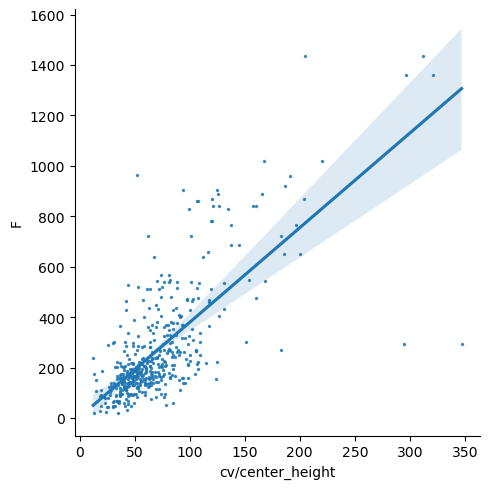

In [37]:
# inter action check
col1 = "cv"
col2 = "center_height"
new_col = f"{col1}/{col2}"
features_df_clean_w_f[new_col] = features_df_clean_w_f[col1]/features_df_clean_w_f[col2]
features_df_clean_w_f[new_col].replace(0, np.mean(features_df_clean_w_f[new_col]), inplace = True)
sns.lmplot(data = features_df_clean_w_f,x = new_col,y="F", scatter_kws={'s':2}, order = 1)
plt.show()
features_df_clean_w_f.drop(new_col, axis =1, inplace = True)

In [38]:
# coludy_rows = ["R8", "R9"]
# features_df_clean_w_f["cloudy"] = features_df_clean_w_f["name"].apply(lambda x:  np.any([row in x for row in coludy_rows]) )
# sns.set(font_scale=1)
# for col in numer_cols:
#     ax = sns.lmplot(data = features_df_clean_w_f,x = col,y="F",hue= "cloudy", scatter_kws={'s':2}, order = 1)
#     sns.regplot(data = features_df_clean_w_f,x = col,y="F", scatter_kws={'s':2}, order = 1,ci=0, ax=ax.axes[0,0],
#                x_ci = 0, color = "black", line_kws={"ls":"--"},scatter=False)
#     plt.show()

In [39]:
plot_fruit_var = get_plot_fruit_variety_df(cfg)
features_df_w_f = pd.merge(features_df_w_f, plot_fruit_var.drop_duplicates(), how="left", on="block_name")

### F~ column| fruit_type

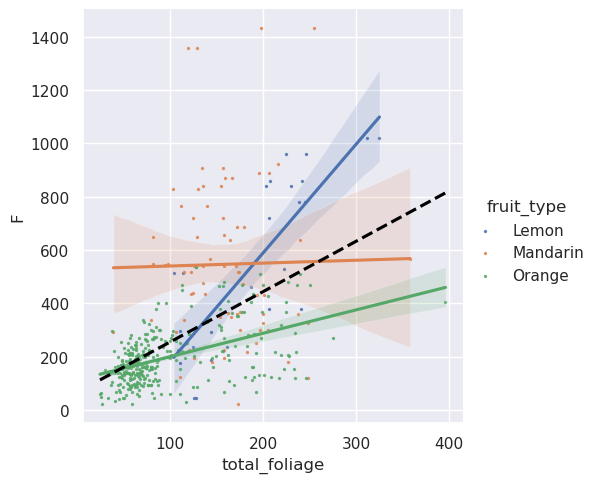

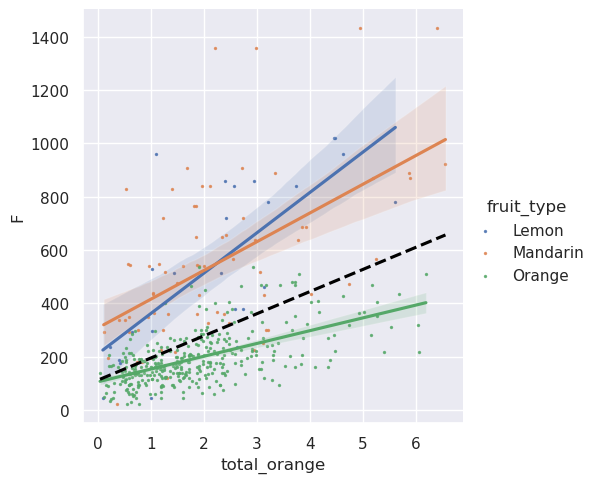

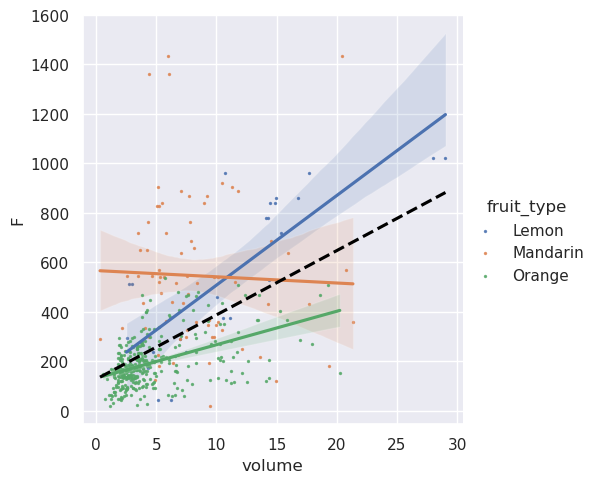

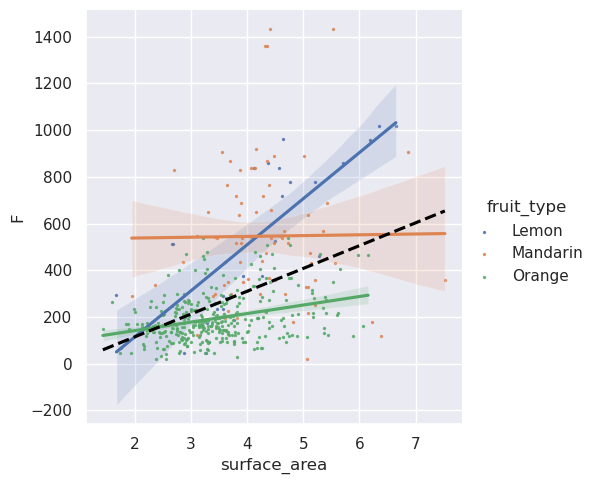

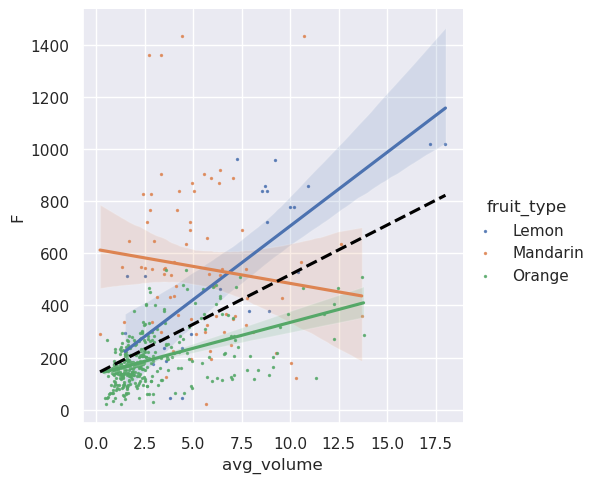

...

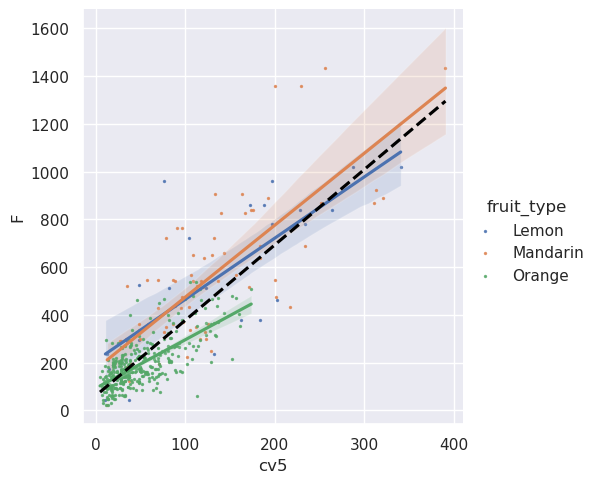

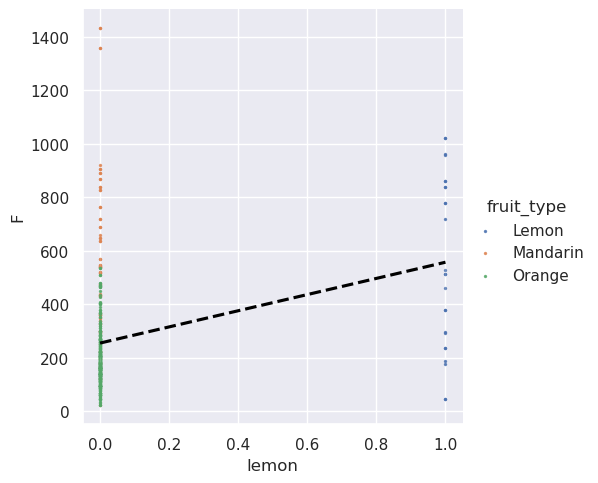

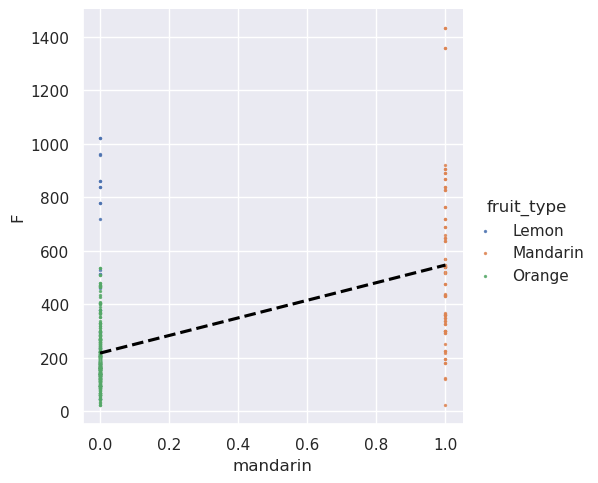

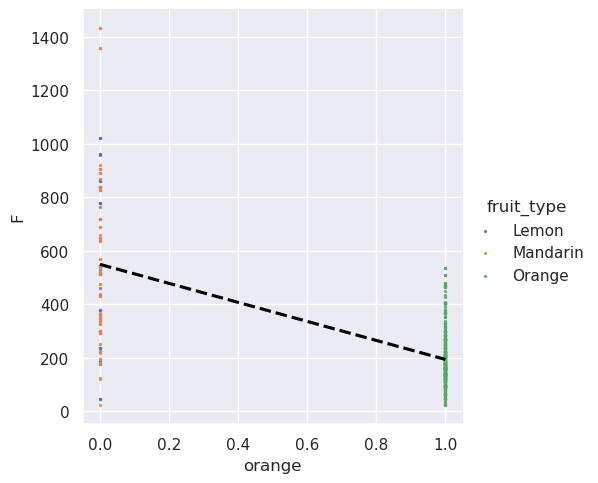

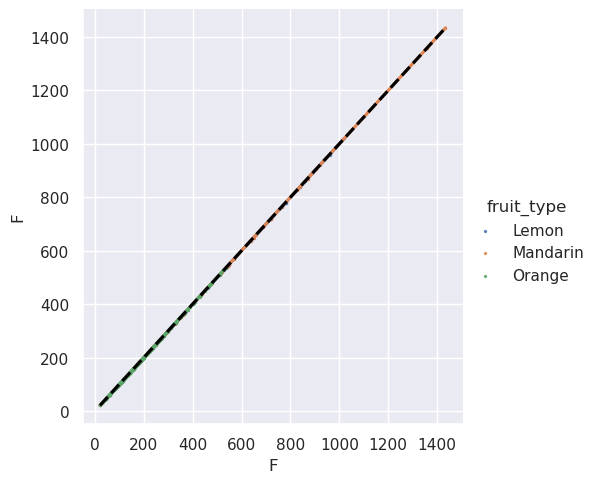

In [40]:
for col in ["mst_sums_arr", "mst_mean_arr"]:
    features_df_w_f[col].replace(0, features_df_w_f[col][features_df_w_f[col]>0].mean(), inplace = True)

sns.set(font_scale=1)
for col in numer_cols:
    if col not in features_df_w_f.columns:
        continue
    ax = sns.lmplot(data = features_df_w_f,x = col,y="F",hue= "fruit_type", scatter_kws={'s':2}, order = 1)
    sns.regplot(data = features_df_w_f,x = col,y="F", scatter_kws={'s':2}, order = 1,ci=0, ax=ax.axes[0,0],
               x_ci = 0, color = "black", line_kws={"ls":"--"},scatter=False)
    plt.show()

### F~column|sumergold

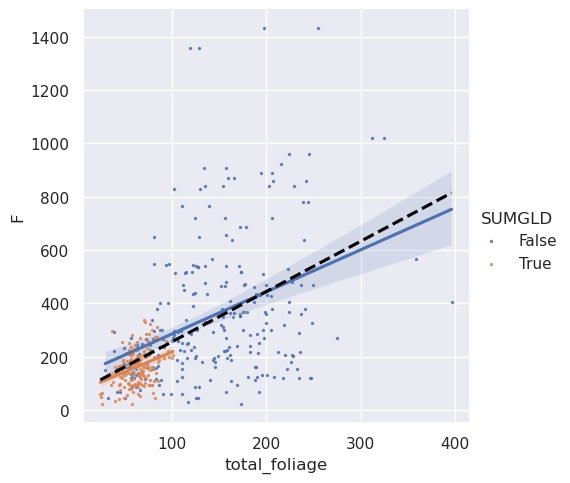

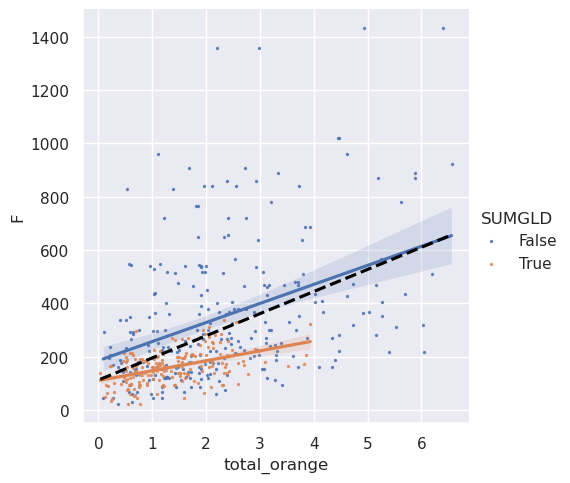

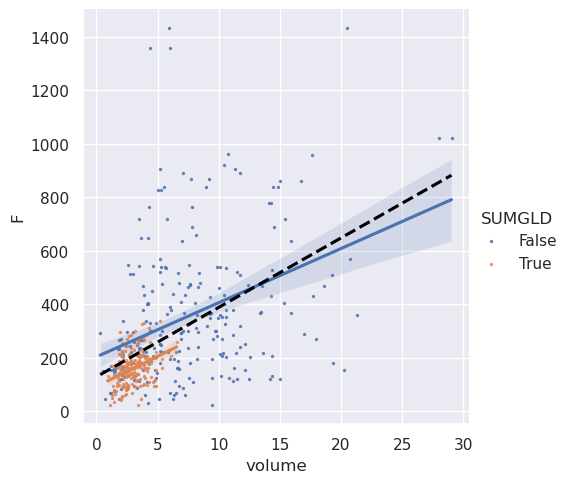

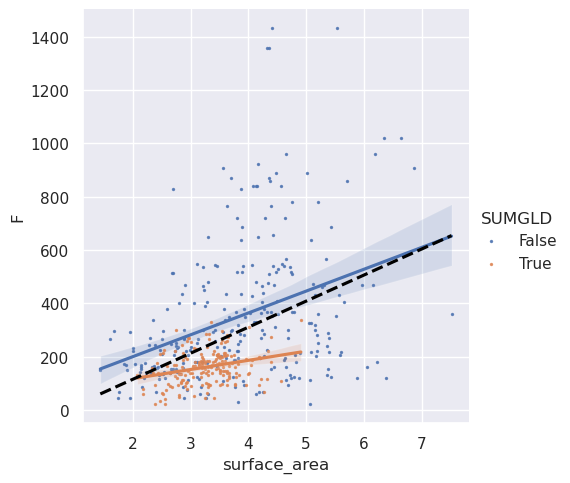

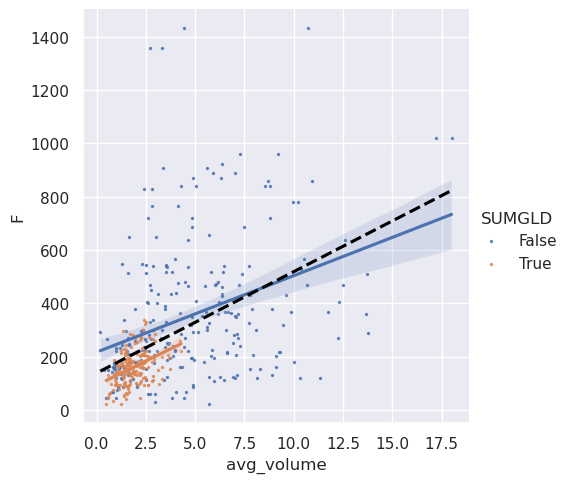

...

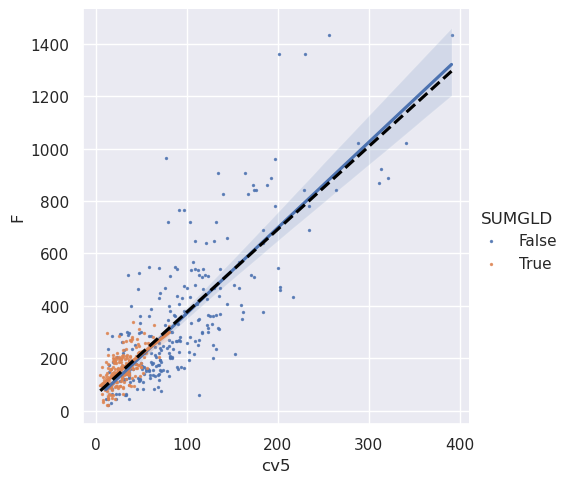

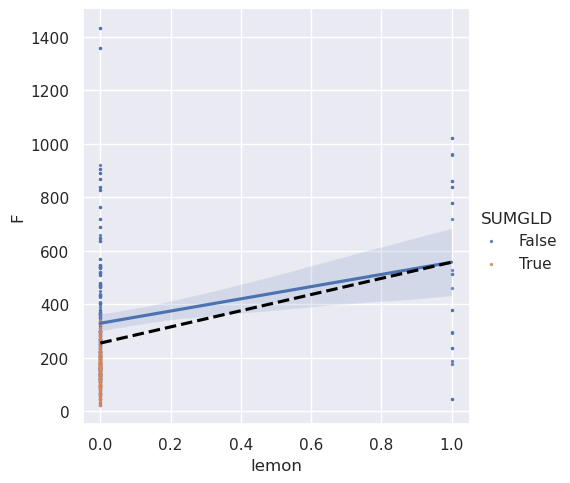

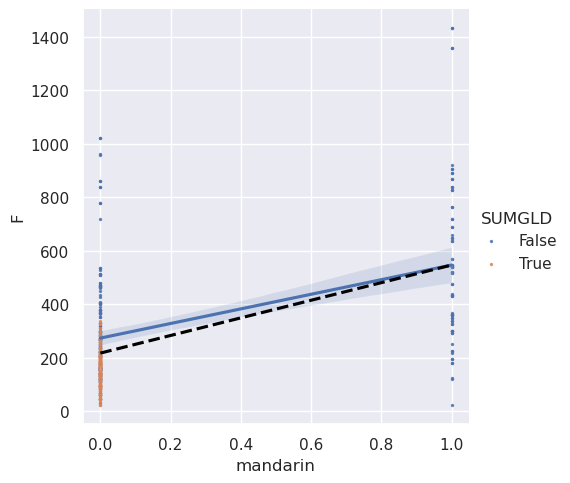

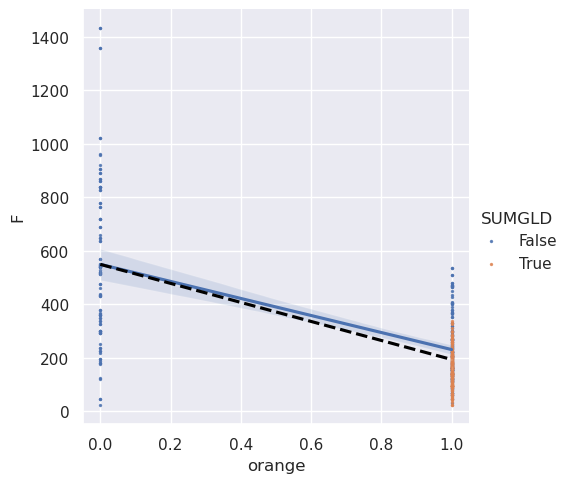

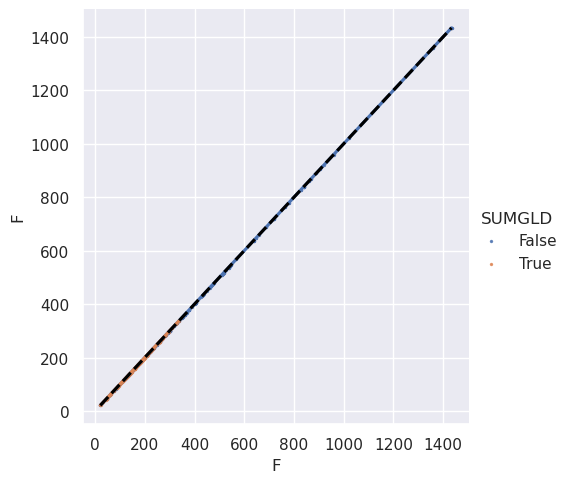

In [42]:
features_df_w_f["SUMGLD"] = features_df_w_f["block_name"] == "SUMGLD"
sns.set(font_scale=1)
for col in numer_cols:
    if col not in features_df_w_f.columns:
        continue
    ax = sns.lmplot(data = features_df_w_f,x = col,y="F",hue= "SUMGLD", scatter_kws={'s':2}, order = 1)
    sns.regplot(data = features_df_w_f,x = col,y="F", scatter_kws={'s':2}, order = 1,ci=0, ax=ax.axes[0,0],
               x_ci = 0, color = "black", line_kws={"ls":"--"},scatter=False)
    plt.show()
features_df_w_f.drop("SUMGLD", axis=1, inplace =True)

### F~column|block

In [29]:
# features_df_clean_w_f["row"] = features_df_clean_w_f["name"].apply(lambda x: x.split("_")[0])
# sns.set(font_scale=1)
# for col in numer_cols:
#     ax = sns.lmplot(data = features_df_clean_w_f,x = col,y="F",hue= "block_name", scatter_kws={'s':2}, order = 1)
#     sns.regplot(data = features_df_clean_w_f,x = col,y="F", scatter_kws={'s':2}, order = 1,ci=0, ax=ax.axes[0,0],
#                x_ci = 0, color = "black", line_kws={"ls":"--"},scatter=False)
#     plt.show()
# features_df_clean_w_f.drop(["row"],axis =1, inplace = True)

### CV interaction

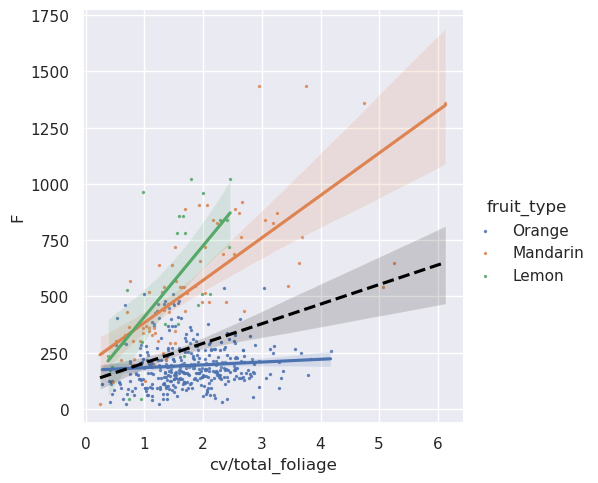

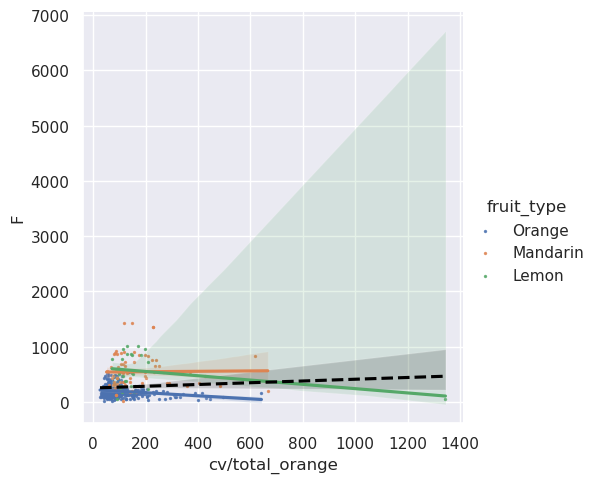

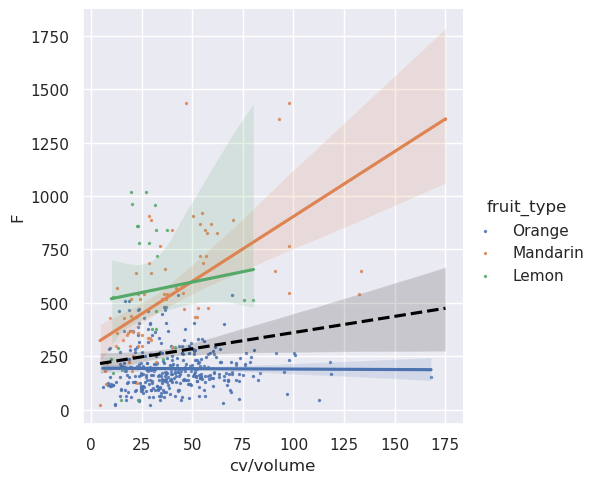

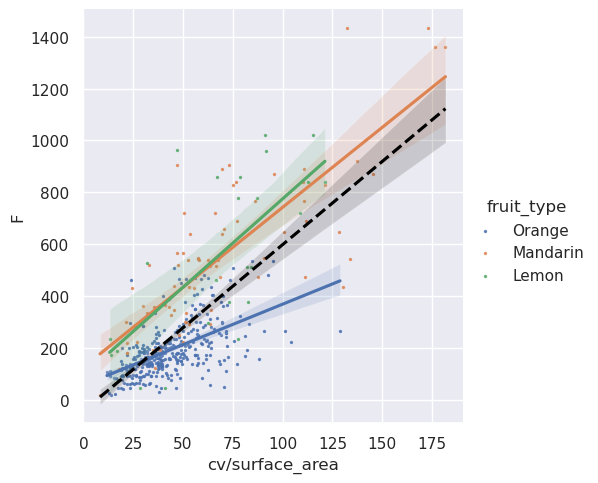

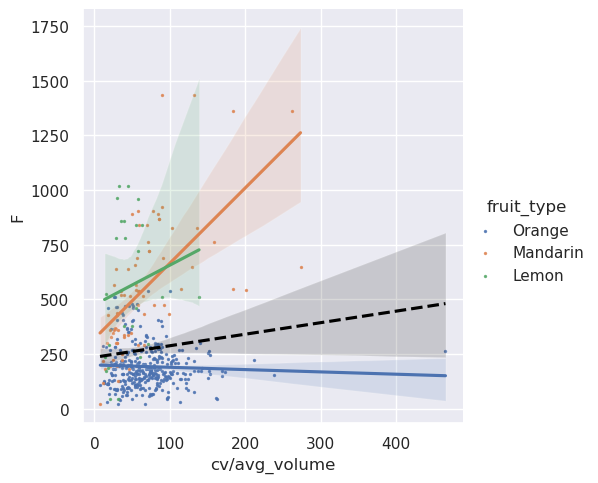

...

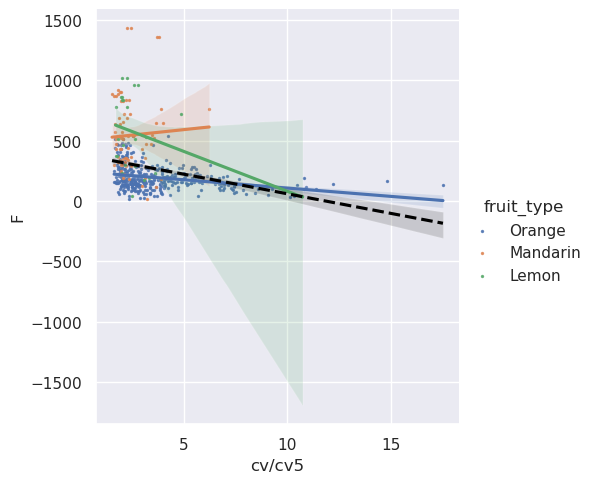

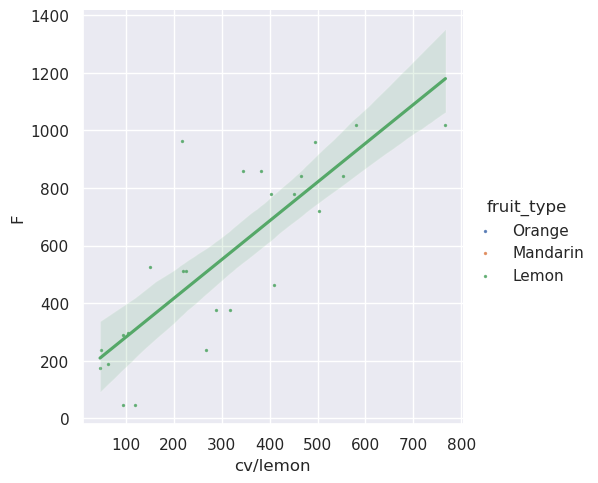

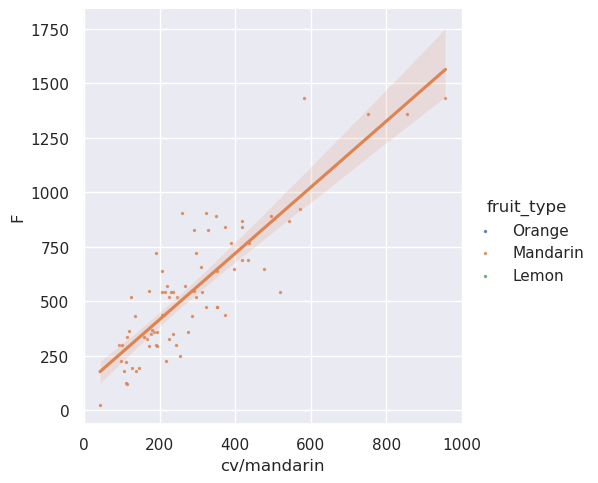

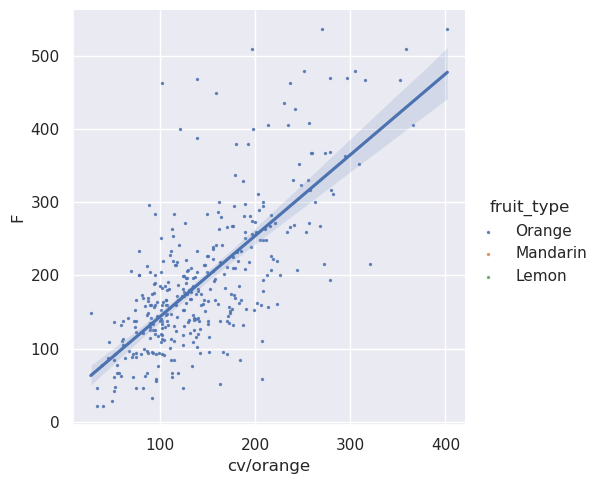

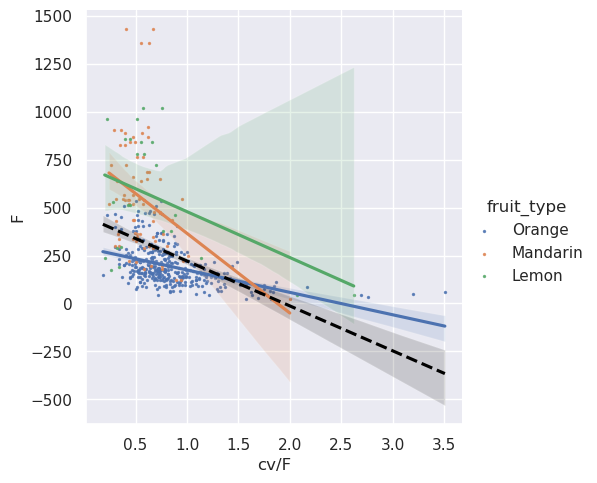

In [30]:
sns.set(font_scale=1)
for col in numer_cols:
    tmp_col = f"cv/{col}"
    features_df_w_f[tmp_col] = features_df_w_f["cv"]/features_df_w_f[col]
    ax=sns.lmplot(data = features_df_w_f,x = tmp_col,y="F", scatter_kws={'s':2},hue= "fruit_type")
    sns.regplot(data = features_df_w_f,x = tmp_col,y="F", scatter_kws={'s':2}, order = 1, ax=ax.axes[0,0],
               x_ci = 0, color = "black", line_kws={"ls":"--"},scatter=False)
    plt.show()
    features_df_w_f.drop(tmp_col, axis = 1,inplace = True)

### % hidden~column

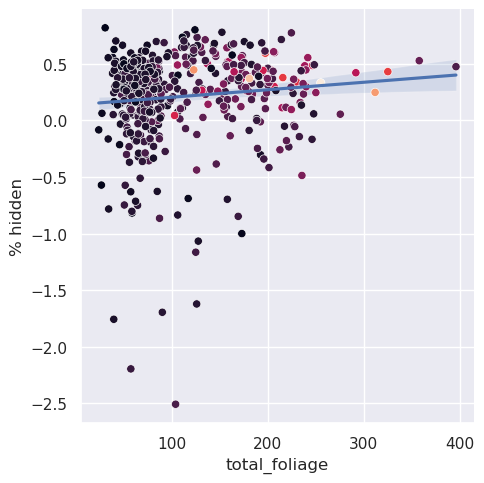

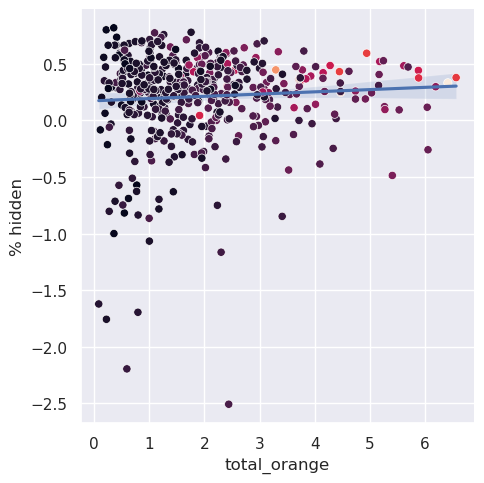

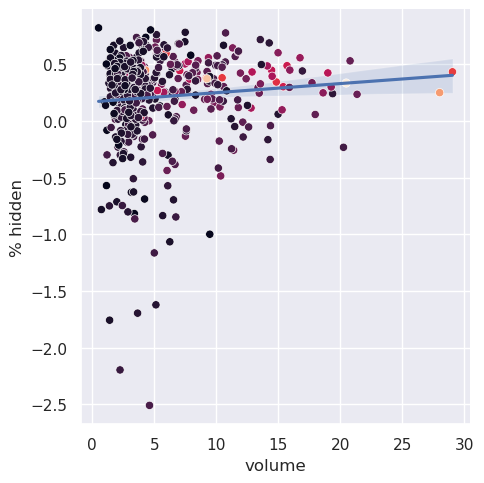

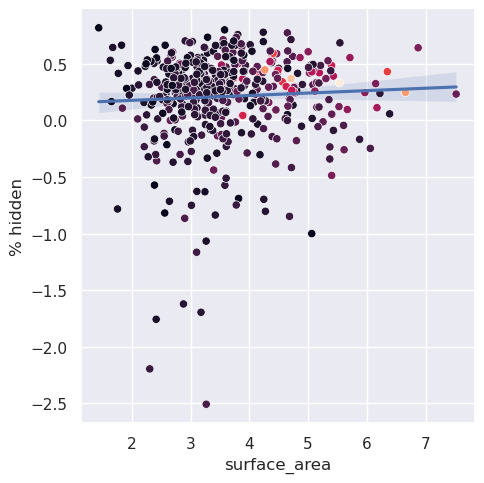

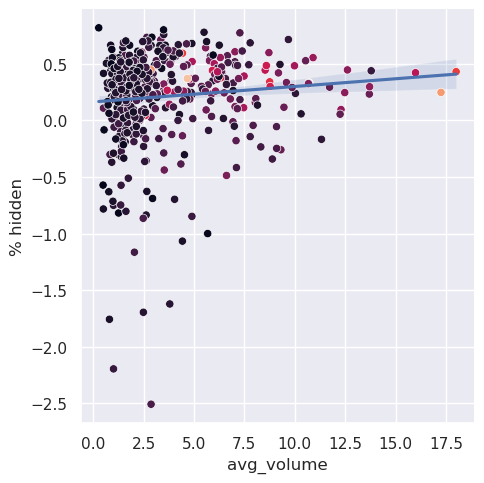

...

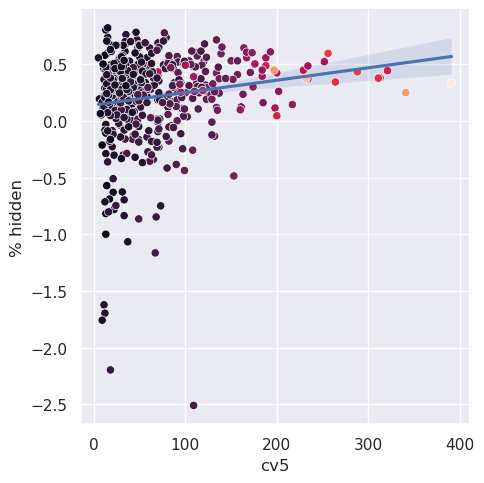

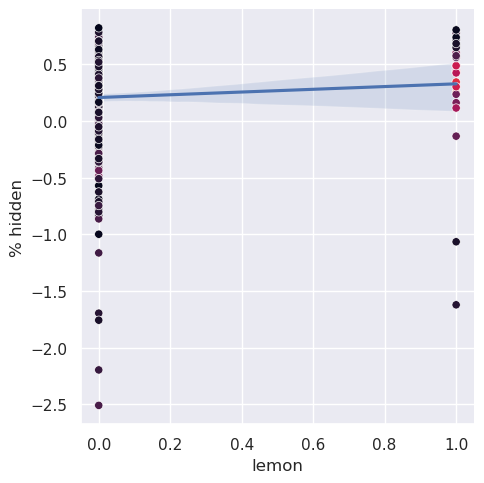

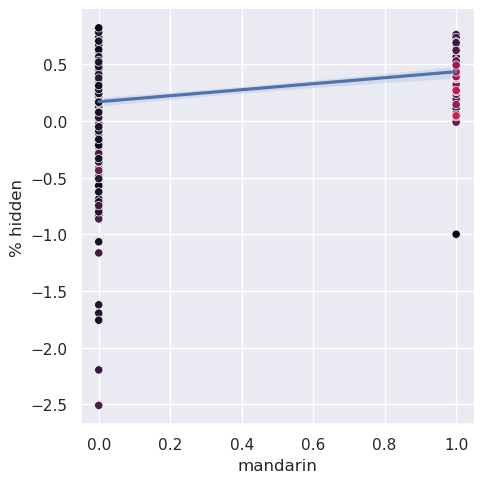

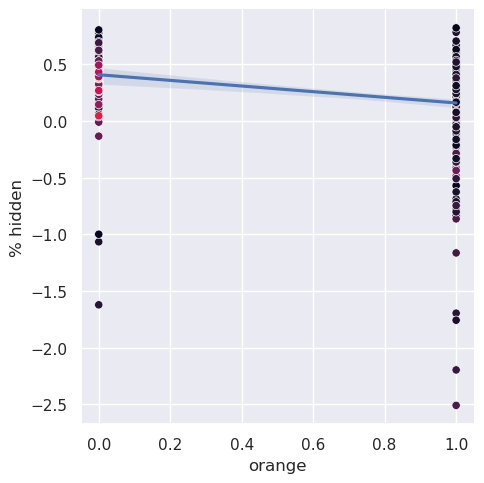

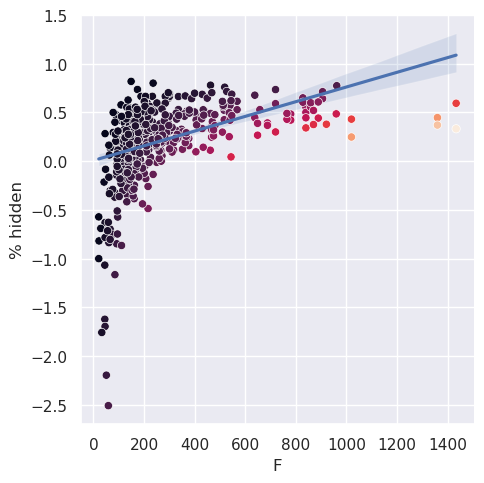

In [31]:
sns.set(font_scale=1)
features_df_clean_w_f["% hidden"]  = (features_df_clean_w_f["F"] - features_df_clean_w_f["cv"])/features_df_clean_w_f["F"]
for col in numer_cols:
    ax = sns.lmplot(data = features_df_clean_w_f,x = col,y="% hidden", scatter_kws={'s':2})
    sns.scatterplot(data = features_df_clean_w_f,x = col,y="% hidden",
                    c=features_df_clean_w_f["cv"][np.isfinite(features_df_clean_w_f[col])], ax=ax.axes[0,0])
    plt.show()
features_df_clean_w_f.drop("% hidden",axis = 1,inplace = True)

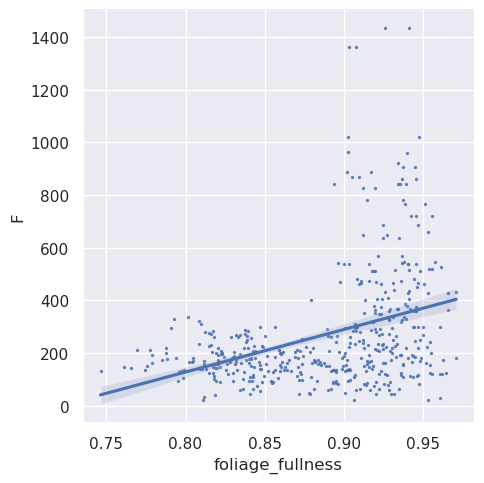

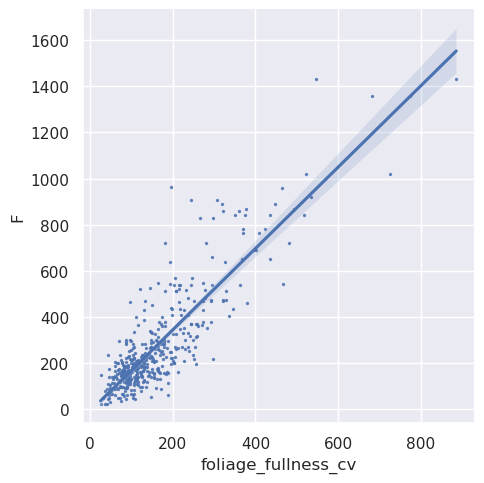

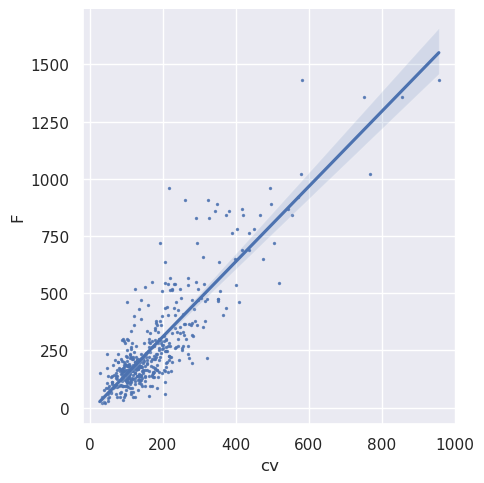

In [32]:
col = "foliage_fullness"
clean_df_temp = features_df_clean_w_f.copy(True)
clean_df_temp = clean_df_temp[clean_df_temp[col]<4000]
clean_df_temp[f"{col}_cv"] = clean_df_temp["cv"]*clean_df_temp[col]
sns.lmplot(data = clean_df_temp,x = col,y="F", scatter_kws={'s':2})
plt.show()
sns.lmplot(data = clean_df_temp,x = f"{col}_cv",y="F", scatter_kws={'s':2})
sns.lmplot(data = clean_df_temp,x = f"cv",y="F", scatter_kws={'s':2})
plt.show()

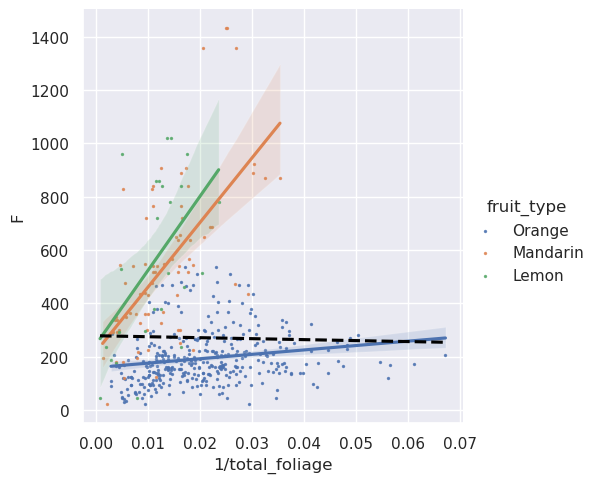

In [33]:
sns.set(font_scale=1)
col2 = "total_foliage"
col1 = "total_orange"
new_col_name = f"1/{col2}"
clean_df_temp = features_df_w_f.copy(True)
clean_df_temp[new_col_name] = clean_df_temp[col1]/clean_df_temp[col2]
ax = sns.lmplot(data = clean_df_temp,x = new_col_name,y="F",hue= "fruit_type", scatter_kws={'s':2}, order = 1)
sns.regplot(data = clean_df_temp,x = new_col_name,y="F", scatter_kws={'s':2}, order = 1,ci=0, ax=ax.axes[0,0],
           x_ci = 0, color = "black", line_kws={"ls":"--"},scatter=False)
plt.show()

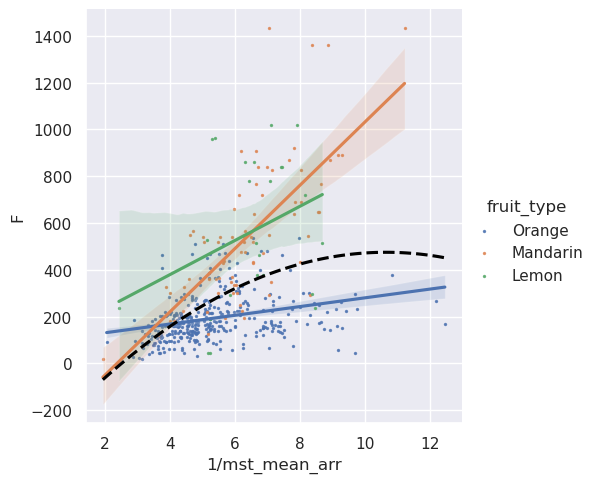

In [34]:
sns.set(font_scale=1)
col1 = "mst_mean_arr"
new_col_name = f"1/{col1}"
clean_df_temp = features_df_w_f.copy(True)
clean_df_temp[new_col_name] = 1/clean_df_temp[col1]
ax = sns.lmplot(data = clean_df_temp,x = new_col_name,y="F",hue= "fruit_type", scatter_kws={'s':2}, order = 1)
sns.regplot(data = clean_df_temp,x = new_col_name,y="F", scatter_kws={'s':1}, order = 2,ci=0, ax=ax.axes[0,0],
           x_ci = 0, color = "black", line_kws={"ls":"--"},scatter=False)
plt.show()

<AxesSubplot: >

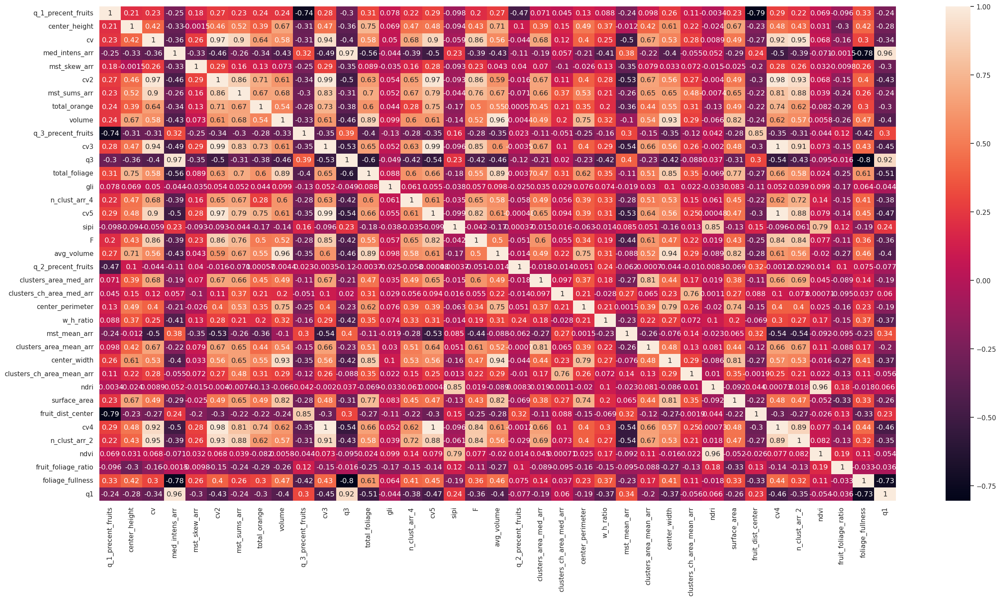

In [35]:
for_corr_plot = set([col for col in numer_cols if not col.endswith("skew")]) - {"apple",
                                                                                "mandarin","lemon","orange"}
corr_frame = features_df_clean_w_f[for_corr_plot].corr()
plt.figure(figsize=(30,15))
sns.heatmap(corr_frame, 
        xticklabels=corr_frame.columns,
        yticklabels=corr_frame.columns,annot = True, annot_kws={"fontsize": 12})


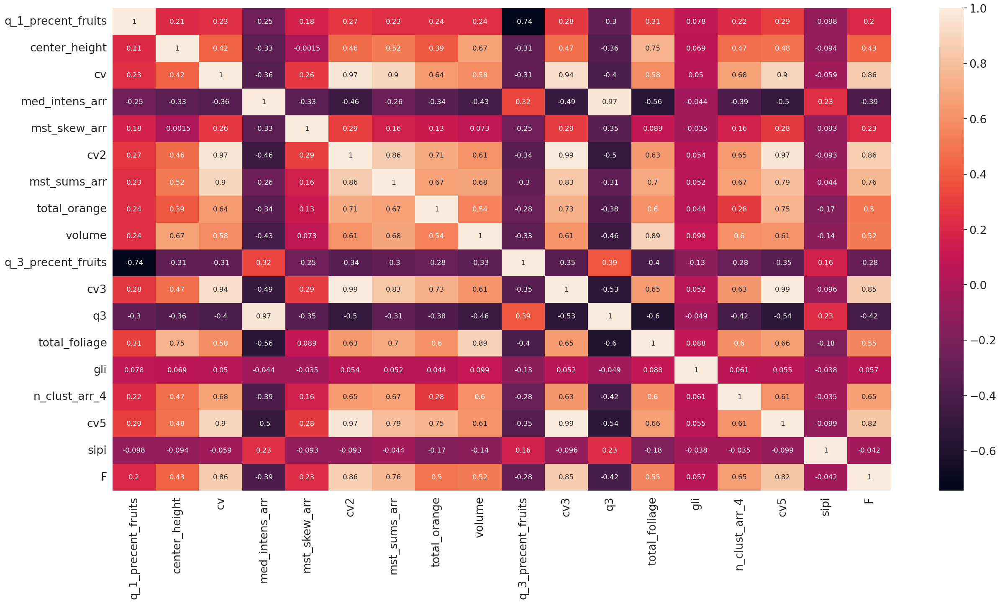

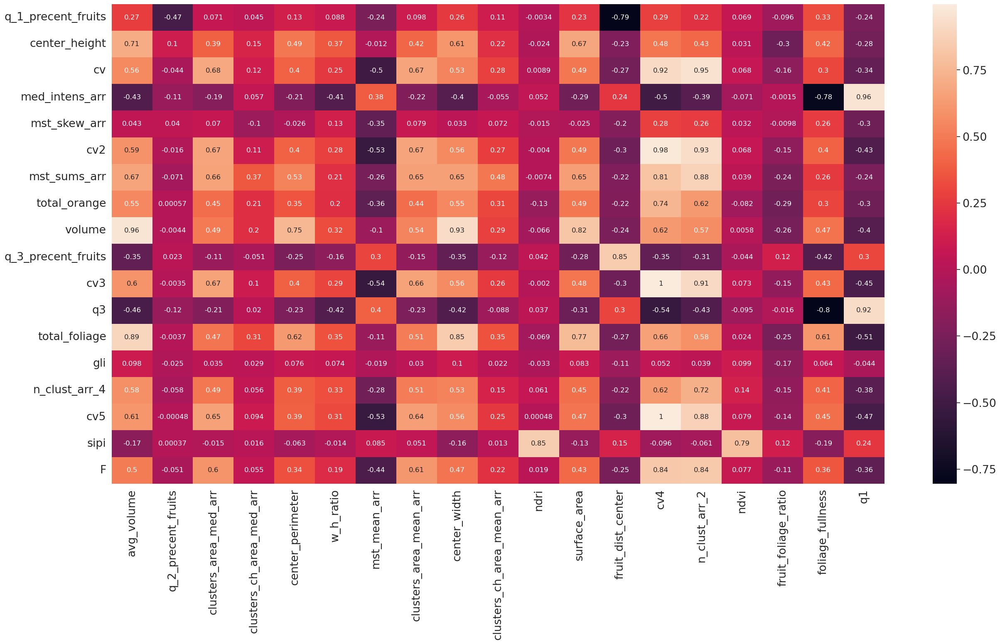

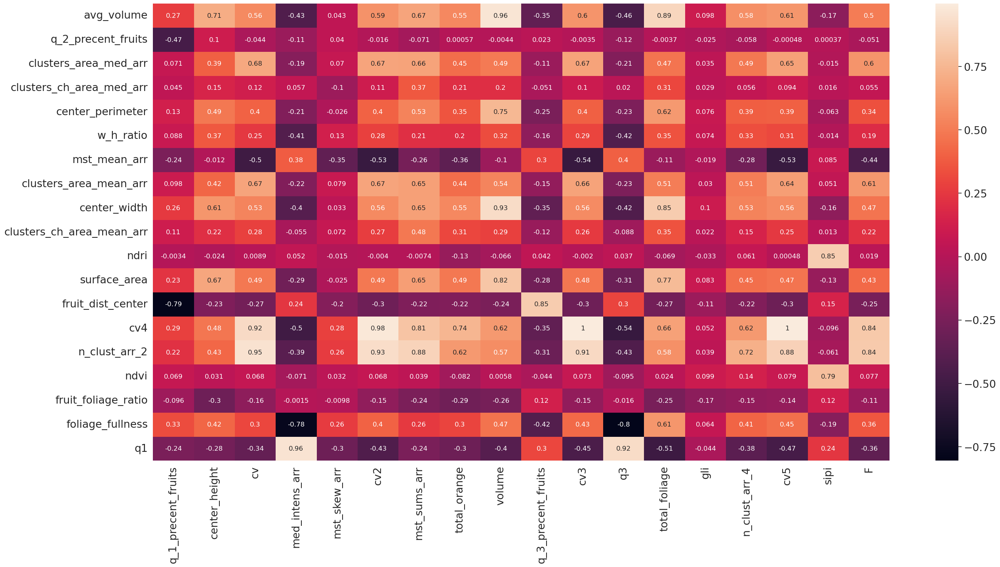

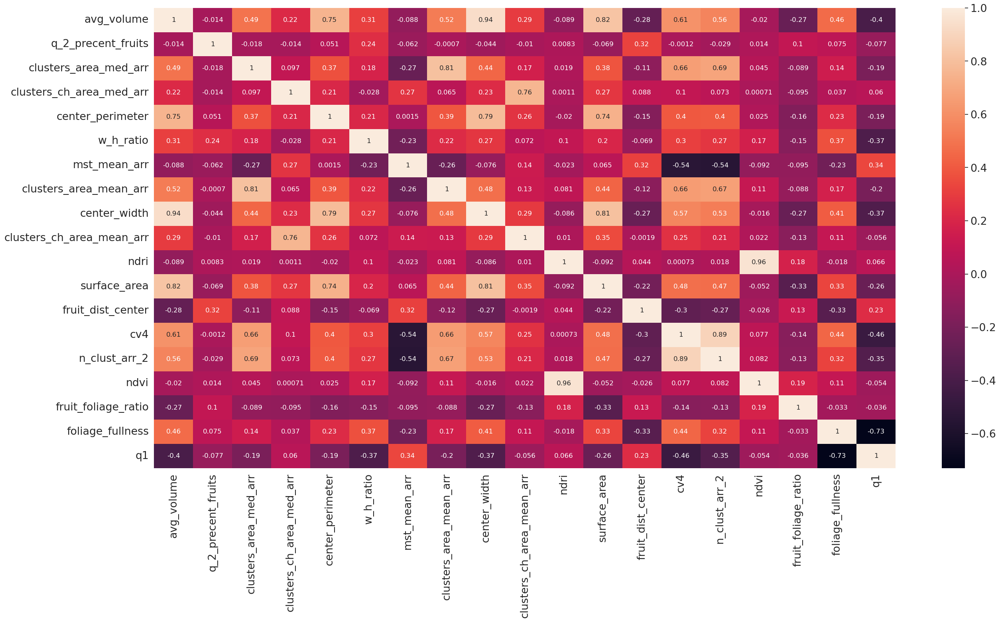

In [36]:
sns.set(font_scale=1.75)
n_cols = corr_frame.shape[0]
half_cols = int(n_cols/2)
plt.figure(figsize=(30,15))
sns.heatmap(corr_frame.iloc[:half_cols,:half_cols], 
        xticklabels=corr_frame.columns[:half_cols],
        yticklabels=corr_frame.columns[:half_cols],annot = True, annot_kws={"fontsize": 12})
plt.show()
plt.figure(figsize=(30,15))
sns.heatmap(corr_frame.iloc[:half_cols,half_cols:], 
        xticklabels=corr_frame.columns[half_cols:],
        yticklabels=corr_frame.columns[:half_cols],annot = True, annot_kws={"fontsize": 12})
plt.show()
plt.figure(figsize=(30,15))
sns.heatmap(corr_frame.iloc[half_cols:,:half_cols], 
        xticklabels=corr_frame.columns[:half_cols],
        yticklabels=corr_frame.columns[half_cols:],annot = True, annot_kws={"fontsize": 12})
plt.show()
plt.figure(figsize=(30,15))
sns.heatmap(corr_frame.iloc[half_cols:,half_cols:], 
        xticklabels=corr_frame.columns[half_cols:],
        yticklabels=corr_frame.columns[half_cols:],annot = True, annot_kws={"fontsize": 12})
plt.show()

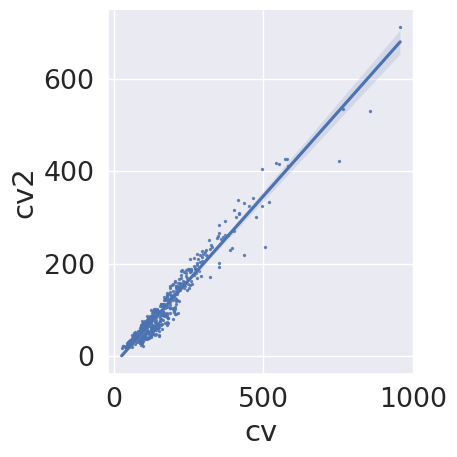

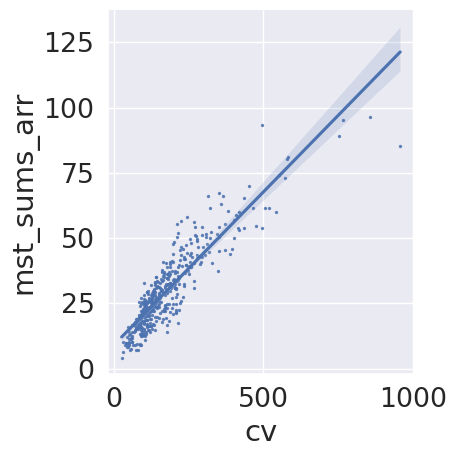

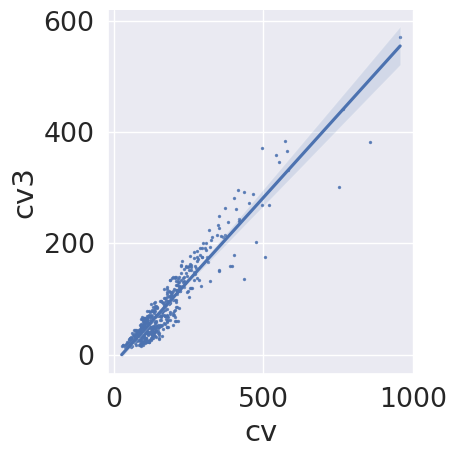

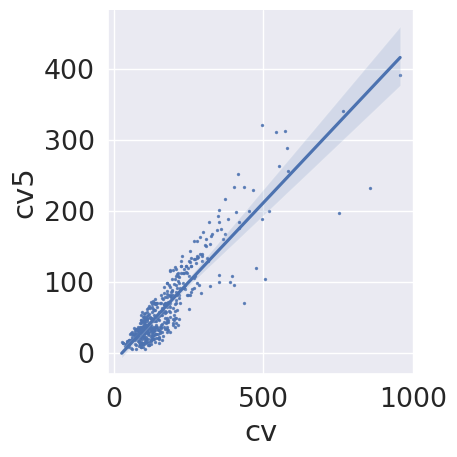

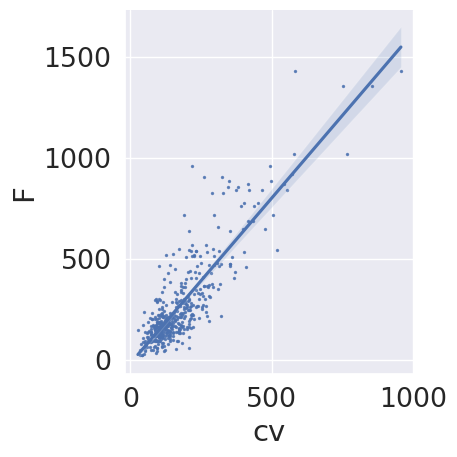

...

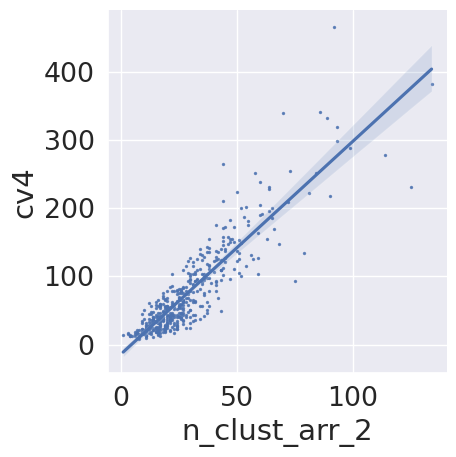

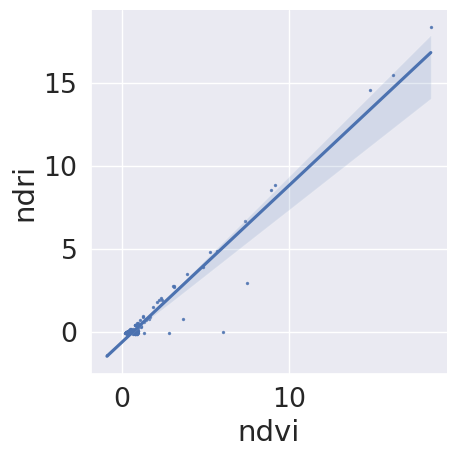

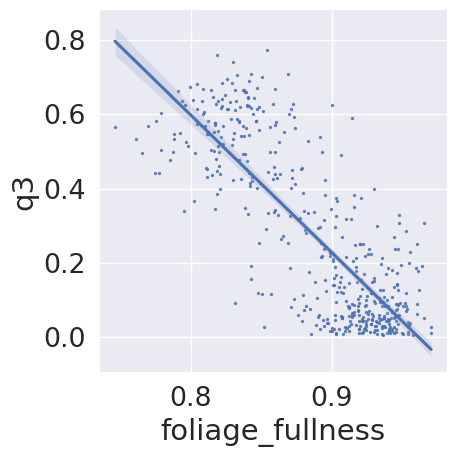

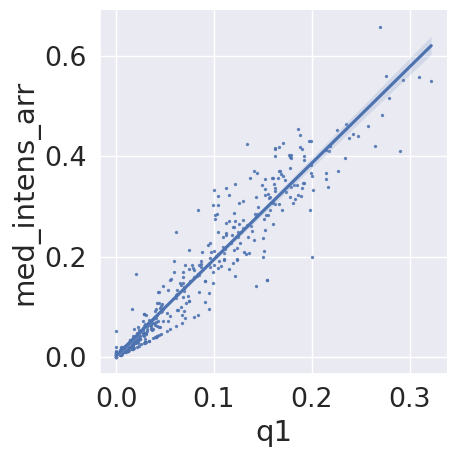

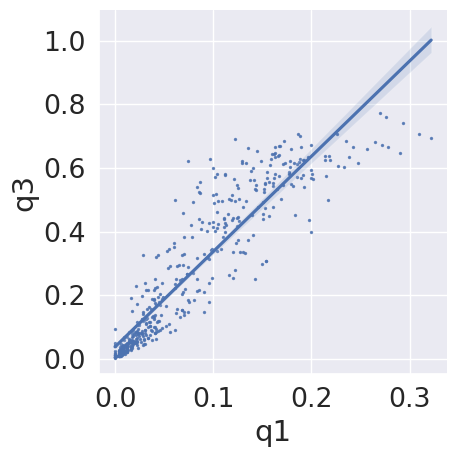

In [37]:
corr_frame_stacked = corr_frame.stack().to_frame()
bool_vec = np.all([np.abs(corr_frame_stacked[0].values) > 0.8 , np.abs(corr_frame_stacked[0].values) < 1],axis = 0)
for i, row in corr_frame_stacked[bool_vec].iterrows():
    var1, var2 = row.name
    sns.lmplot(data = features_df_clean_w_f,x = var1,y=var2, scatter_kws={'s':2})
    plt.show()

### PCA

In [38]:
n_comp = None
pca = PCA(n_comp)
X_tr_lr_sc = StandardScaler().fit_transform(X_tr_lr)
x_pcaed = pca.fit_transform(X_tr_lr_sc, y)
x_pcaed = pd.DataFrame(x_pcaed,columns = [f"PC_{i+1}" for i in range(n_comp if n_comp != None else X_tr_lr.shape[1])])

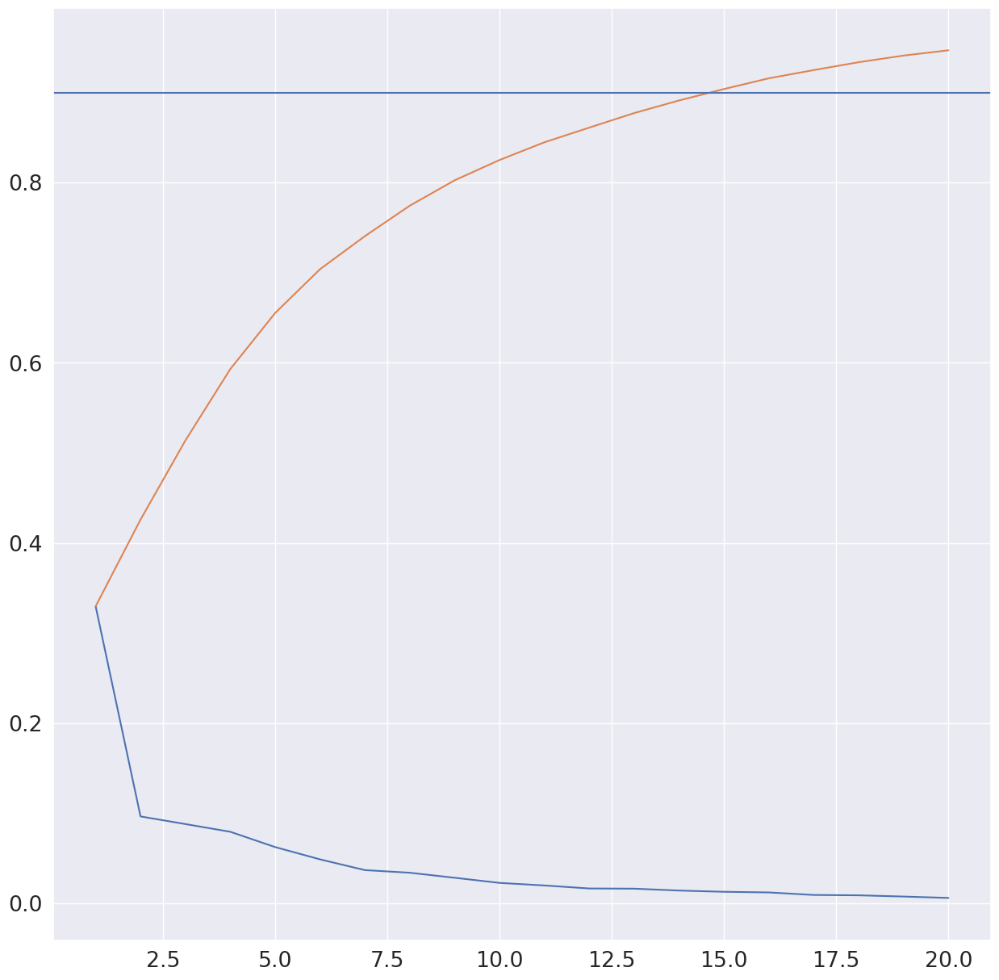

,0,1,2,3,4,5,6,7,8,9,...,48,49,50,51,52,53,54,55,56,57
cv2,0.215164,0.029544,0.117404,0.023087,0.022648,0.004645,0.003567,0.050428,0.011829,0.020840,...,0.082985,0.367091,0.534619,0.236436,0.571803,0.168861,5.724587e-16,6.062859e-16,6.782769e-16,7.251144e-16
cv3,0.214460,0.021940,0.099992,0.021919,0.033516,0.016335,0.002470,0.051407,0.001001,0.014735,...,0.092718,0.116012,0.247062,0.246548,0.552038,0.572347,4.180684e-16,2.502447e-15,4.336809e-16,1.908196e-16
cv4,0.212818,0.016072,0.088141,0.016560,0.039325,0.025290,0.003653,0.049260,0.007443,0.009894,...,0.033848,0.088526,0.118140,0.020965,0.363400,0.735420,2.341877e-17,1.622617e-15,4.683753e-16,1.039099e-15
cv5,0.210974,0.015864,0.079602,0.013161,0.040722,0.028205,0.002244,0.049510,0.011631,0.009632,...,0.075533,0.153807,0.483715,0.226944,0.452679,0.317220,1.201296e-16,2.537033e-16,9.445569e-16,5.030698e-17
cv,0.209498,0.036178,0.154109,0.037210,0.016062,0.018801,0.006096,0.029725,0.023476,0.025443,...,0.015872,0.146744,0.162434,0.693383,0.112119,0.009666,4.087302e-01,1.108847e-01,3.486637e-01,1.177118e-01
n_clust_arr_2,0.205393,0.026337,0.141641,0.047016,0.005290,0.001191,0.007958,0.000849,0.044376,0.027271,...,0.019988,0.035906,0.026397,0.054432,0.004737,0.003563,4.510281e-17,1.795439e-16,7.459311e-17,1.595946e-16
cv/fruit_foliage_ratio,0.198627,0.039100,0.105711,0.061261,0.011341,0.069752,0.058831,0.040336,0.078517,0.065504,...,0.033365,0.031194,0.049864,0.084514,0.005823,0.002962,9.020562e-17,1.838807e-16,4.163336e-17,2.775558e-17
mst_sums_arr,0.195515,0.067978,0.148238,0.025299,0.108551,0.035862,0.054175,0.022019,0.081486,0.036968,...,0.052658,0.148275,0.113660,0.166742,0.014499,0.008907,8.383051e-16,5.134781e-16,3.469447e-18,1.110223e-16
cv^2,0.182712,0.056345,0.135636,0.077721,0.021924,0.053542,0.012058,0.088773,0.067096,0.072378,...,0.106398,0.219612,0.145187,0.161567,0.021528,0.005045,2.515349e-16,8.673617e-17,9.367507e-17,1.006140e-16
cv/center_height,0.179393,0.110967,0.209491,0.025172,0.020204,0.010041,0.003991,0.051538,0.043931,0.038223,...,0.295921,0.168387,0.326988,0.171322,0.012194,0.019115,1.309716e-16,1.422473e-16,2.671474e-16,1.665335e-16


In [39]:
max_comp = 20
plt.figure(figsize=(15,15))
plt.plot(range(1,max_comp+1),pca.explained_variance_ratio_[:max_comp])
plt.plot(range(1,max_comp+1),np.cumsum(pca.explained_variance_ratio_[:max_comp]))
plt.axhline(0.9)
plt.show()
pd.DataFrame(np.abs(pca.components_.T), index = X_tr_lr.columns).sort_values(0,ascending = False)

### modeling

In [40]:
X_tr_lr['cv/foliage_fullness'] = X_tr_lr["cv"]/X_tr_lr["foliage_fullness"]

### cv cols

In [41]:
sc = scalers["Robust"]
cv_fruit_type_cols = [col for col in ["orange", "lemon", "mandarin", "apple"] if col in X_tr_lr.columns]
cv_cols = ["cv"] + cv_fruit_type_cols

print(cross_validate_with_mean(LinearRegression(),X_tr_lr[cv_cols],y))

print(cross_validate_with_mean(LinearRegression(),X_tr_lr[cv_cols],y,groups = groups))

true: 15388.0,    pred: 14879.510731603172. (3.30 %) 
true: 15361.0,    pred: 15427.272692631495. (0.43 %) 
true: 14886.0,    pred: 14733.709815784856. (1.02 %) 
true: 16751.0,    pred: 16752.117175834523. (0.01 %) 
true: 18886.0,    pred: 18774.100294552933. (0.59 %) 
true: 15863.0,    pred: 15376.368802536286. (3.07 %) 
true: 14554.0,    pred: 14470.87145480116. (0.57 %) 
true: 13018.0,    pred: 14259.578857626399. (9.54 %) 
0.37088963745650705 0.0865638521193963
(0.023167984489894978, 0.029635692200974416)
true: 31172.0,    pred: 30231.992246998736. (3.02 %) (SUMGLD)
true: 10260.0,    pred: 7802.66677836386. (23.95 %) (DWDBCL46)
true: 2600.0,    pred: 2607.8624118384355. (0.30 %) (2018XXXX)
true: 1464.0,    pred: 1264.97757619834. (13.59 %) (M7XXXXXX)
true: 1690.0,    pred: 1869.0570068333043. (10.60 %) (LaneLatX)
true: 3006.0,    pred: 3280.7951744813913. (9.14 %) (2005XXXX)
true: 3540.0,    pred: 3111.759940554278. (12.10 %) (94000000)
true: 8680.0,    pred: 8955.887154834196. (3.

### non zed features (no vi they make it worse)

In [42]:
['cv/fruit_foliage_ratio', 'cv/foliage_fullness']
    
non_zed_cols = ["cv", "foliage_fullness", "w_h_ratio", "fruit_foliage_ratio", 'cv/foliage_fullness'] + cv_fruit_type_cols

non_zed_cols = ["foliage_fullness", "w_h_ratio", 'cv/foliage_fullness'] + cv_fruit_type_cols

print(cross_validate_with_mean(LinearRegression(),X_tr_lr[non_zed_cols],y))

print(cross_validate_with_mean(LinearRegression(),X_tr_lr[non_zed_cols],y,groups = groups))

true: 15388.0,    pred: 15085.2476317376. (1.97 %) 
true: 15361.0,    pred: 15152.019121901212. (1.36 %) 
true: 14886.0,    pred: 14665.669794232435. (1.48 %) 
true: 16751.0,    pred: 16715.347826704245. (0.21 %) 
true: 18886.0,    pred: 18737.834602724684. (0.78 %) 
true: 15863.0,    pred: 15460.299036461884. (2.54 %) 
true: 14554.0,    pred: 14457.903043279952. (0.66 %) 
true: 13018.0,    pred: 14257.339058304005. (9.52 %) 
0.3766103565532889 0.08756009536758402
(0.023155614730087343, 0.02810545975152204)
true: 31172.0,    pred: 29466.61163336085. (5.47 %) (SUMGLD)
true: 10260.0,    pred: 7743.248684665292. (24.53 %) (DWDBCL46)
true: 2600.0,    pred: 2758.1044341701636. (6.08 %) (2018XXXX)
true: 1464.0,    pred: 1382.667427850141. (5.56 %) (M7XXXXXX)
true: 1690.0,    pred: 1956.6647504371645. (15.78 %) (LaneLatX)
true: 3006.0,    pred: 3222.6556096898116. (7.21 %) (2005XXXX)
true: 3540.0,    pred: 3064.671551387687. (13.43 %) (94000000)
true: 8680.0,    pred: 9027.154446683691. (4.00

In [43]:
X_non_scale = X_tr_lr.copy()[non_zed_cols]
sc = scalers["Robust"]
X_scaled = sc.fit_transform(X_non_scale)
X_scaled = pd.DataFrame(X_scaled,columns = X_non_scale.columns)
X_tr_lm = sm.add_constant(X_scaled)

model = sm.OLS(y.reset_index(drop=True),X_tr_lm)
results = model.fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      F   R-squared:                       0.804
Model:                            OLS   Adj. R-squared:                  0.802
Method:                 Least Squares   F-statistic:                     372.9
Date:                Sun, 30 Jul 2023   Prob (F-statistic):          3.30e-158
Time:                        10:55:16   Log-Likelihood:                -2763.2
No. Observations:                 460   AIC:                             5538.
Df Residuals:                     454   BIC:                             5563.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
=======================================================================================
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                 205.9053      6.000     34.315      0.000     194.113     217.697
foliage_fullness       30.9992      9.722      3.189      0.002      11.894      50.105
w_h_ratio             -19.7034      6.902     -2.855      0.005     -33.266      -6.140
cv/foliage_fullness   147.3935      5.072     29.063      0.000     137.427     157.360
orange               -107.7600     10.389    -10.372      0.000    -128.177     -87.343
lemon                  58.7817     14.862      3.955      0.000      29.576      87.988
mandarin               48.9782     11.000      4.452      0.000      27.360      70.596
==============================================================================
Omnibus:                       97.243   Durbin-Watson:                   1.451
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              405.445
Skew:                           0.873   Prob(JB):                     9.09e-89
Kurtosis:                       7.255   Cond. No.                     1.20e+16
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 4.99e-30. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

### all features

In [44]:
# TODO add cols
sc = scalers["Robust"]

print(cross_validate_with_mean(LinearRegression(),X_tr_lr,y))

print(cross_validate_with_mean(LinearRegression(),X_tr_lr,y,groups = groups))

true: 15388.0,    pred: 14446.958047089438. (6.12 %) 
true: 15361.0,    pred: 14509.924670095776. (5.54 %) 
true: 14886.0,    pred: 15058.762736758134. (1.16 %) 
true: 16751.0,    pred: 17039.529630513964. (1.72 %) 
true: 18886.0,    pred: 18881.06225451492. (0.03 %) 
true: 15863.0,    pred: 15922.01229795923. (0.37 %) 
true: 14554.0,    pred: 14437.387219340224. (0.80 %) 
true: 13018.0,    pred: 13417.686821685116. (3.07 %) 
0.3733761822085273 0.07332526375695608
(0.02351077236353666, 0.021907874594953684)
true: 31172.0,    pred: 27162.838429311367. (12.86 %) (SUMGLD)
true: 10260.0,    pred: 8204.145332026128. (20.04 %) (DWDBCL46)
true: 2600.0,    pred: 2780.284792809385. (6.93 %) (2018XXXX)
true: 1464.0,    pred: 1899.2219564005773. (29.73 %) (M7XXXXXX)
true: 1690.0,    pred: 1850.2831284673657. (9.48 %) (LaneLatX)
true: 3006.0,    pred: 3355.656670621432. (11.63 %) (2005XXXX)
true: 3540.0,    pred: 3087.1397524565527. (12.79 %) (94000000)
true: 8680.0,    pred: 10588.884241970734. (

### fit linear MHS

In [45]:
mhs = model_hybrid_selector()
mhs.iterative_fitting(X_tr_lr,y,num_stuck = 3,cols = ["cv"],use_alwyas = [])

{}
inf


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 58/58 [00:03<00:00, 17.18it/s]


added cv5, new_score: 0.3811129740757205


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 37.80it/s]


no feature could be removed, new_score: 0.400217034822144
score: 0.3811129740757205,cols: ['cv', 'cv5']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:01<00:00, 42.99it/s]


added mandarin_cv, new_score: 0.3744066830567341


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 33.91it/s]


no feature could be removed, new_score: 0.3811129740757205
score: 0.3744066830567341,cols: ['cv', 'cv5', 'mandarin_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 56/56 [00:01<00:00, 32.73it/s]


added lemon, new_score: 0.3588514676234923


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00, 31.15it/s]


no feature could be removed, new_score: 0.3672357965825406
score: 0.3588514676234923,cols: ['cv', 'cv5', 'mandarin_cv', 'lemon']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 55/55 [00:01<00:00, 41.65it/s]


added n_clust_arr_2, new_score: 0.35156360599565994


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:00<00:00, 36.38it/s]


no feature could be removed, new_score: 0.3538323109356891
score: 0.35156360599565994,cols: ['cv', 'cv5', 'mandarin_cv', 'lemon', 'n_clust_arr_2']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 54/54 [00:01<00:00, 28.71it/s]


added clusters_area_mean_arr, new_score: 0.34833175157274476


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:00<00:00, 43.36it/s]


no feature could be removed, new_score: 0.3504732156961061
score: 0.34833175157274476,cols: ['cv', 'cv5', 'mandarin_cv', 'lemon', 'n_clust_arr_2', 'clusters_area_mean_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:01<00:00, 41.81it/s]


added w_h_ratio, new_score: 0.3462761816914022


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 30.12it/s]


no feature could be removed, new_score: 0.3482852601993025
score: 0.3462761816914022,cols: ['cv', 'cv5', 'mandarin_cv', 'lemon', 'n_clust_arr_2', 'clusters_area_mean_arr', 'w_h_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 52/52 [00:01<00:00, 34.44it/s]


added q_1_precent_fruits, new_score: 0.3458251110793139


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 30.30it/s]


no feature could be removed, new_score: 0.34627618169138313
score: 0.3458251110793139,cols: ['cv', 'cv5', 'mandarin_cv', 'lemon', 'n_clust_arr_2', 'clusters_area_mean_arr', 'w_h_ratio', 'q_1_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:01<00:00, 39.14it/s]


no feature could be added, new_score: 0.3460363172251359


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 32.34it/s]


no feature could be removed, new_score: 0.34627618169138313
score: 0.3458251110793139,cols: ['cv', 'cv5', 'mandarin_cv', 'lemon', 'n_clust_arr_2', 'clusters_area_mean_arr', 'w_h_ratio', 'q_1_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:01<00:00, 28.96it/s]


no feature could be added, new_score: 0.3460363172251359


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 25.36it/s]


no feature could be removed, new_score: 0.34627618169138313
score: 0.3458251110793139,cols: ['cv', 'cv5', 'mandarin_cv', 'lemon', 'n_clust_arr_2', 'clusters_area_mean_arr', 'w_h_ratio', 'q_1_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:01<00:00, 36.26it/s]


no feature could be added, new_score: 0.3460363172251359


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 24.66it/s]


no feature could be removed, new_score: 0.34627618169138313
score: 0.3458251110793139,cols: ['cv', 'cv5', 'mandarin_cv', 'lemon', 'n_clust_arr_2', 'clusters_area_mean_arr', 'w_h_ratio', 'q_1_precent_fruits']
final cols for iteration 1: ['cv', 'cv5', 'mandarin_cv', 'lemon', 'n_clust_arr_2', 'clusters_area_mean_arr', 'w_h_ratio', 'q_1_precent_fruits']
inf


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:01<00:00, 35.75it/s]


added cv/foliage_fullness, new_score: 0.3465616104348662


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 28.23it/s]


no feature could be removed, new_score: 0.3479676020866078
score: 0.3465616104348662,cols: ['n_clust_arr_2', 'q_1_precent_fruits', 'clusters_area_mean_arr', 'mandarin_cv', 'lemon', 'cv5', 'cv/foliage_fullness']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 52/52 [00:01<00:00, 36.79it/s]


added w_h_ratio, new_score: 0.3457186000820418


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 25.60it/s]


no feature could be removed, new_score: 0.3462267729339209
score: 0.3457186000820418,cols: ['n_clust_arr_2', 'q_1_precent_fruits', 'clusters_area_mean_arr', 'mandarin_cv', 'lemon', 'cv5', 'cv/foliage_fullness', 'w_h_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:01<00:00, 28.68it/s]


no feature could be added, new_score: 0.3459162339215936


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 94.56it/s]


no feature could be removed, new_score: 0.3462267729339209
score: 0.3457186000820418,cols: ['n_clust_arr_2', 'q_1_precent_fruits', 'clusters_area_mean_arr', 'mandarin_cv', 'lemon', 'cv5', 'cv/foliage_fullness', 'w_h_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:01<00:00, 30.52it/s]


no feature could be added, new_score: 0.3459162339215936


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 26.20it/s]


no feature could be removed, new_score: 0.3462267729339209
score: 0.3457186000820418,cols: ['n_clust_arr_2', 'q_1_precent_fruits', 'clusters_area_mean_arr', 'mandarin_cv', 'lemon', 'cv5', 'cv/foliage_fullness', 'w_h_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:01<00:00, 40.15it/s]


no feature could be added, new_score: 0.3459162339215936


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 26.01it/s]


no feature could be removed, new_score: 0.3462267729339209
score: 0.3457186000820418,cols: ['n_clust_arr_2', 'q_1_precent_fruits', 'clusters_area_mean_arr', 'mandarin_cv', 'lemon', 'cv5', 'cv/foliage_fullness', 'w_h_ratio']
final cols for iteration 2: ['n_clust_arr_2', 'q_1_precent_fruits', 'clusters_area_mean_arr', 'mandarin_cv', 'lemon', 'cv5', 'cv/foliage_fullness', 'w_h_ratio']
inf


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:01<00:00, 33.63it/s]


added cv/foliage_fullness, new_score: 0.34672353969775815


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 26.48it/s]


no feature could be removed, new_score: 0.34743650797170733
score: 0.34672353969775815,cols: ['q_1_precent_fruits', 'mandarin_cv', 'cv5', 'lemon', 'w_h_ratio', 'clusters_area_mean_arr', 'cv/foliage_fullness']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 52/52 [00:01<00:00, 39.51it/s]


added n_clust_arr_2, new_score: 0.3457186000820476


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 26.63it/s]


no feature could be removed, new_score: 0.3462267729339209
score: 0.3457186000820476,cols: ['q_1_precent_fruits', 'mandarin_cv', 'cv5', 'lemon', 'w_h_ratio', 'clusters_area_mean_arr', 'cv/foliage_fullness', 'n_clust_arr_2']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:01<00:00, 34.43it/s]


no feature could be added, new_score: 0.3459162339216085


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 33.14it/s]


no feature could be removed, new_score: 0.3462267729339209
score: 0.3457186000820476,cols: ['q_1_precent_fruits', 'mandarin_cv', 'cv5', 'lemon', 'w_h_ratio', 'clusters_area_mean_arr', 'cv/foliage_fullness', 'n_clust_arr_2']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:01<00:00, 33.20it/s]


no feature could be added, new_score: 0.3459162339216085


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 26.28it/s]


no feature could be removed, new_score: 0.3462267729339209
score: 0.3457186000820476,cols: ['q_1_precent_fruits', 'mandarin_cv', 'cv5', 'lemon', 'w_h_ratio', 'clusters_area_mean_arr', 'cv/foliage_fullness', 'n_clust_arr_2']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:01<00:00, 34.45it/s]


no feature could be added, new_score: 0.3459162339216085


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 30.25it/s]


no feature could be removed, new_score: 0.3462267729339209
score: 0.3457186000820476,cols: ['q_1_precent_fruits', 'mandarin_cv', 'cv5', 'lemon', 'w_h_ratio', 'clusters_area_mean_arr', 'cv/foliage_fullness', 'n_clust_arr_2']
final cols for iteration 3: ['q_1_precent_fruits', 'mandarin_cv', 'cv5', 'lemon', 'w_h_ratio', 'clusters_area_mean_arr', 'cv/foliage_fullness', 'n_clust_arr_2']
inf


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:01<00:00, 38.30it/s]


added lemon, new_score: 0.3462267729338687


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 26.44it/s]


no feature could be removed, new_score: 0.34743650797170733
score: 0.3462267729338687,cols: ['cv/foliage_fullness', 'cv5', 'w_h_ratio', 'clusters_area_mean_arr', 'mandarin_cv', 'n_clust_arr_2', 'lemon']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 52/52 [00:01<00:00, 30.30it/s]


added q_1_precent_fruits, new_score: 0.3457186000820762


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 26.49it/s]


no feature could be removed, new_score: 0.3462267729339209
score: 0.3457186000820762,cols: ['cv/foliage_fullness', 'cv5', 'w_h_ratio', 'clusters_area_mean_arr', 'mandarin_cv', 'n_clust_arr_2', 'lemon', 'q_1_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:01<00:00, 29.24it/s]


no feature could be added, new_score: 0.345916233921547


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 59.50it/s]


no feature could be removed, new_score: 0.3462267729339209
score: 0.3457186000820762,cols: ['cv/foliage_fullness', 'cv5', 'w_h_ratio', 'clusters_area_mean_arr', 'mandarin_cv', 'n_clust_arr_2', 'lemon', 'q_1_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:01<00:00, 28.98it/s]


no feature could be added, new_score: 0.345916233921547


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 34.66it/s]


no feature could be removed, new_score: 0.3462267729339209
score: 0.3457186000820762,cols: ['cv/foliage_fullness', 'cv5', 'w_h_ratio', 'clusters_area_mean_arr', 'mandarin_cv', 'n_clust_arr_2', 'lemon', 'q_1_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:01<00:00, 29.85it/s]


no feature could be added, new_score: 0.345916233921547


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 26.62it/s]


no feature could be removed, new_score: 0.3462267729339209
score: 0.3457186000820762,cols: ['cv/foliage_fullness', 'cv5', 'w_h_ratio', 'clusters_area_mean_arr', 'mandarin_cv', 'n_clust_arr_2', 'lemon', 'q_1_precent_fruits']
final cols for iteration 4: ['cv/foliage_fullness', 'cv5', 'w_h_ratio', 'clusters_area_mean_arr', 'mandarin_cv', 'n_clust_arr_2', 'lemon', 'q_1_precent_fruits']
inf


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:01<00:00, 31.70it/s]


added lemon, new_score: 0.3611162561168078


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 25.28it/s]


removed w_h_ratio, new_score: 0.35668006311684375
score: 0.35668006311684375,cols: ['q_1_precent_fruits', 'n_clust_arr_2', 'clusters_area_mean_arr', 'mandarin_cv', 'cv/foliage_fullness', 'lemon']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:01<00:00, 31.25it/s]


added cv3, new_score: 0.34644463263171504


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.34it/s]


no feature could be removed, new_score: 0.3474311353487888
score: 0.34644463263171504,cols: ['q_1_precent_fruits', 'n_clust_arr_2', 'clusters_area_mean_arr', 'mandarin_cv', 'cv/foliage_fullness', 'lemon', 'cv3']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 52/52 [00:01<00:00, 30.43it/s]


added w_h_ratio, new_score: 0.34519805750487104


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 29.27it/s]


no feature could be removed, new_score: 0.34550716346143373
score: 0.34519805750487104,cols: ['q_1_precent_fruits', 'n_clust_arr_2', 'clusters_area_mean_arr', 'mandarin_cv', 'cv/foliage_fullness', 'lemon', 'cv3', 'w_h_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:01<00:00, 29.93it/s]


no feature could be added, new_score: 0.34520037221667266


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 33.32it/s]


no feature could be removed, new_score: 0.34550716346143373
score: 0.34519805750487104,cols: ['q_1_precent_fruits', 'n_clust_arr_2', 'clusters_area_mean_arr', 'mandarin_cv', 'cv/foliage_fullness', 'lemon', 'cv3', 'w_h_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:01<00:00, 32.35it/s]


no feature could be added, new_score: 0.34520037221667266


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 26.99it/s]


no feature could be removed, new_score: 0.34550716346143373
score: 0.34519805750487104,cols: ['q_1_precent_fruits', 'n_clust_arr_2', 'clusters_area_mean_arr', 'mandarin_cv', 'cv/foliage_fullness', 'lemon', 'cv3', 'w_h_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:01<00:00, 31.63it/s]


no feature could be added, new_score: 0.34520037221667266


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 25.84it/s]


no feature could be removed, new_score: 0.34550716346143373
score: 0.34519805750487104,cols: ['q_1_precent_fruits', 'n_clust_arr_2', 'clusters_area_mean_arr', 'mandarin_cv', 'cv/foliage_fullness', 'lemon', 'cv3', 'w_h_ratio']
final cols for iteration 5: ['q_1_precent_fruits', 'n_clust_arr_2', 'clusters_area_mean_arr', 'mandarin_cv', 'cv/foliage_fullness', 'lemon', 'cv3', 'w_h_ratio']
inf


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:01<00:00, 29.67it/s]


added clusters_area_mean_arr, new_score: 0.3462267729338615


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 25.88it/s]


no feature could be removed, new_score: 0.34743650797170733
score: 0.3462267729338615,cols: ['mandarin_cv', 'cv/foliage_fullness', 'cv5', 'w_h_ratio', 'n_clust_arr_2', 'lemon', 'clusters_area_mean_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 52/52 [00:01<00:00, 32.01it/s]


added q_1_precent_fruits, new_score: 0.34571860008204636


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 22.97it/s]


no feature could be removed, new_score: 0.3462267729339209
score: 0.34571860008204636,cols: ['mandarin_cv', 'cv/foliage_fullness', 'cv5', 'w_h_ratio', 'n_clust_arr_2', 'lemon', 'clusters_area_mean_arr', 'q_1_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:01<00:00, 31.07it/s]


no feature could be added, new_score: 0.34591623392158577


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 43.38it/s]


no feature could be removed, new_score: 0.3462267729339209
score: 0.34571860008204636,cols: ['mandarin_cv', 'cv/foliage_fullness', 'cv5', 'w_h_ratio', 'n_clust_arr_2', 'lemon', 'clusters_area_mean_arr', 'q_1_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:01<00:00, 29.10it/s]


no feature could be added, new_score: 0.34591623392158577


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 31.18it/s]


no feature could be removed, new_score: 0.3462267729339209
score: 0.34571860008204636,cols: ['mandarin_cv', 'cv/foliage_fullness', 'cv5', 'w_h_ratio', 'n_clust_arr_2', 'lemon', 'clusters_area_mean_arr', 'q_1_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:01<00:00, 31.58it/s]


no feature could be added, new_score: 0.34591623392158577


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 33.39it/s]


no feature could be removed, new_score: 0.3462267729339209
score: 0.34571860008204636,cols: ['mandarin_cv', 'cv/foliage_fullness', 'cv5', 'w_h_ratio', 'n_clust_arr_2', 'lemon', 'clusters_area_mean_arr', 'q_1_precent_fruits']
final cols for iteration 6: ['mandarin_cv', 'cv/foliage_fullness', 'cv5', 'w_h_ratio', 'n_clust_arr_2', 'lemon', 'clusters_area_mean_arr', 'q_1_precent_fruits']
inf


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:01<00:00, 42.35it/s]


added mandarin_cv, new_score: 0.3611162561168072


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 105.48it/s]


removed w_h_ratio, new_score: 0.35668006311684375
score: 0.35668006311684375,cols: ['q_1_precent_fruits', 'clusters_area_mean_arr', 'cv/foliage_fullness', 'n_clust_arr_2', 'lemon', 'mandarin_cv']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:00<00:00, 108.27it/s]


added cv3, new_score: 0.3464446326317156


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 107.16it/s]


no feature could be removed, new_score: 0.3474311353487888
score: 0.3464446326317156,cols: ['q_1_precent_fruits', 'clusters_area_mean_arr', 'cv/foliage_fullness', 'n_clust_arr_2', 'lemon', 'mandarin_cv', 'cv3']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 52/52 [00:00<00:00, 105.70it/s]


added w_h_ratio, new_score: 0.3451980575048712


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 111.84it/s]


no feature could be removed, new_score: 0.34550716346143373
score: 0.3451980575048712,cols: ['q_1_precent_fruits', 'clusters_area_mean_arr', 'cv/foliage_fullness', 'n_clust_arr_2', 'lemon', 'mandarin_cv', 'cv3', 'w_h_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:00<00:00, 94.27it/s]


no feature could be added, new_score: 0.3452003722166723


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 88.39it/s]


no feature could be removed, new_score: 0.34550716346143373
score: 0.3451980575048712,cols: ['q_1_precent_fruits', 'clusters_area_mean_arr', 'cv/foliage_fullness', 'n_clust_arr_2', 'lemon', 'mandarin_cv', 'cv3', 'w_h_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:00<00:00, 53.64it/s]


no feature could be added, new_score: 0.3452003722166723


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 31.24it/s]


no feature could be removed, new_score: 0.34550716346143373
score: 0.3451980575048712,cols: ['q_1_precent_fruits', 'clusters_area_mean_arr', 'cv/foliage_fullness', 'n_clust_arr_2', 'lemon', 'mandarin_cv', 'cv3', 'w_h_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:01<00:00, 36.04it/s]


no feature could be added, new_score: 0.3452003722166723


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 29.81it/s]


no feature could be removed, new_score: 0.34550716346143373
score: 0.3451980575048712,cols: ['q_1_precent_fruits', 'clusters_area_mean_arr', 'cv/foliage_fullness', 'n_clust_arr_2', 'lemon', 'mandarin_cv', 'cv3', 'w_h_ratio']
final cols for iteration 7: ['q_1_precent_fruits', 'clusters_area_mean_arr', 'cv/foliage_fullness', 'n_clust_arr_2', 'lemon', 'mandarin_cv', 'cv3', 'w_h_ratio']
inf


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:01<00:00, 34.03it/s]


added mandarin_cv, new_score: 0.34629260443361715


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 37.08it/s]


no feature could be removed, new_score: 0.3467584510758052
score: 0.34629260443361715,cols: ['q_1_precent_fruits', 'lemon', 'cv3', 'clusters_area_mean_arr', 'w_h_ratio', 'cv/foliage_fullness', 'mandarin_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 52/52 [00:01<00:00, 33.54it/s]


added n_clust_arr_2, new_score: 0.3451980575048903


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 36.95it/s]


no feature could be removed, new_score: 0.34550716346143373
score: 0.3451980575048903,cols: ['q_1_precent_fruits', 'lemon', 'cv3', 'clusters_area_mean_arr', 'w_h_ratio', 'cv/foliage_fullness', 'mandarin_cv', 'n_clust_arr_2']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:01<00:00, 30.92it/s]


no feature could be added, new_score: 0.3452003722166817


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 23.72it/s]


no feature could be removed, new_score: 0.34550716346143373
score: 0.3451980575048903,cols: ['q_1_precent_fruits', 'lemon', 'cv3', 'clusters_area_mean_arr', 'w_h_ratio', 'cv/foliage_fullness', 'mandarin_cv', 'n_clust_arr_2']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:01<00:00, 28.50it/s]


no feature could be added, new_score: 0.3452003722166817


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 26.54it/s]


no feature could be removed, new_score: 0.34550716346143373
score: 0.3451980575048903,cols: ['q_1_precent_fruits', 'lemon', 'cv3', 'clusters_area_mean_arr', 'w_h_ratio', 'cv/foliage_fullness', 'mandarin_cv', 'n_clust_arr_2']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:01<00:00, 29.16it/s]


no feature could be added, new_score: 0.3452003722166817


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 53.40it/s]


no feature could be removed, new_score: 0.34550716346143373
score: 0.3451980575048903,cols: ['q_1_precent_fruits', 'lemon', 'cv3', 'clusters_area_mean_arr', 'w_h_ratio', 'cv/foliage_fullness', 'mandarin_cv', 'n_clust_arr_2']
final cols for iteration 8: ['q_1_precent_fruits', 'lemon', 'cv3', 'clusters_area_mean_arr', 'w_h_ratio', 'cv/foliage_fullness', 'mandarin_cv', 'n_clust_arr_2']
inf


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:00<00:00, 110.20it/s]


added lemon, new_score: 0.3455253885030302


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 118.97it/s]


no feature could be removed, new_score: 0.34563913435975313
score: 0.3455253885030302,cols: ['cv/foliage_fullness', 'clusters_area_mean_arr', 'cv3', 'n_clust_arr_2', 'w_h_ratio', 'mandarin_cv', 'lemon']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 52/52 [00:00<00:00, 101.89it/s]


added q_1_precent_fruits, new_score: 0.3451980575048773


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 94.39it/s]


no feature could be removed, new_score: 0.34550716346148164
score: 0.3451980575048773,cols: ['cv/foliage_fullness', 'clusters_area_mean_arr', 'cv3', 'n_clust_arr_2', 'w_h_ratio', 'mandarin_cv', 'lemon', 'q_1_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:00<00:00, 93.36it/s]


no feature could be added, new_score: 0.3452003722166729


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 90.05it/s]


no feature could be removed, new_score: 0.34550716346148164
score: 0.3451980575048773,cols: ['cv/foliage_fullness', 'clusters_area_mean_arr', 'cv3', 'n_clust_arr_2', 'w_h_ratio', 'mandarin_cv', 'lemon', 'q_1_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:00<00:00, 83.04it/s]


no feature could be added, new_score: 0.3452003722166729


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 86.37it/s]


no feature could be removed, new_score: 0.34550716346148164
score: 0.3451980575048773,cols: ['cv/foliage_fullness', 'clusters_area_mean_arr', 'cv3', 'n_clust_arr_2', 'w_h_ratio', 'mandarin_cv', 'lemon', 'q_1_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:00<00:00, 82.20it/s]


no feature could be added, new_score: 0.3452003722166729


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 76.16it/s]


no feature could be removed, new_score: 0.34550716346148164
score: 0.3451980575048773,cols: ['cv/foliage_fullness', 'clusters_area_mean_arr', 'cv3', 'n_clust_arr_2', 'w_h_ratio', 'mandarin_cv', 'lemon', 'q_1_precent_fruits']
final cols for iteration 9: ['cv/foliage_fullness', 'clusters_area_mean_arr', 'cv3', 'n_clust_arr_2', 'w_h_ratio', 'mandarin_cv', 'lemon', 'q_1_precent_fruits']
inf


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:00<00:00, 85.60it/s]


added n_clust_arr_2, new_score: 0.3455071634614517


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 85.93it/s]


no feature could be removed, new_score: 0.34563913435975313
score: 0.3455071634614517,cols: ['clusters_area_mean_arr', 'cv3', 'q_1_precent_fruits', 'mandarin_cv', 'lemon', 'w_h_ratio', 'n_clust_arr_2']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 52/52 [00:00<00:00, 85.78it/s]


added cv/foliage_fullness, new_score: 0.3451980575048735


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 111.81it/s]


no feature could be removed, new_score: 0.34550716346143373
score: 0.3451980575048735,cols: ['clusters_area_mean_arr', 'cv3', 'q_1_precent_fruits', 'mandarin_cv', 'lemon', 'w_h_ratio', 'n_clust_arr_2', 'cv/foliage_fullness']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:00<00:00, 105.46it/s]


no feature could be added, new_score: 0.3452003722166731


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 110.26it/s]


no feature could be removed, new_score: 0.34550716346143373
score: 0.3451980575048735,cols: ['clusters_area_mean_arr', 'cv3', 'q_1_precent_fruits', 'mandarin_cv', 'lemon', 'w_h_ratio', 'n_clust_arr_2', 'cv/foliage_fullness']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:00<00:00, 111.58it/s]


no feature could be added, new_score: 0.3452003722166731


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 109.45it/s]


no feature could be removed, new_score: 0.34550716346143373
score: 0.3451980575048735,cols: ['clusters_area_mean_arr', 'cv3', 'q_1_precent_fruits', 'mandarin_cv', 'lemon', 'w_h_ratio', 'n_clust_arr_2', 'cv/foliage_fullness']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:00<00:00, 106.55it/s]


no feature could be added, new_score: 0.3452003722166731


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 107.28it/s]


no feature could be removed, new_score: 0.34550716346143373
score: 0.3451980575048735,cols: ['clusters_area_mean_arr', 'cv3', 'q_1_precent_fruits', 'mandarin_cv', 'lemon', 'w_h_ratio', 'n_clust_arr_2', 'cv/foliage_fullness']
final cols for iteration 10: ['clusters_area_mean_arr', 'cv3', 'q_1_precent_fruits', 'mandarin_cv', 'lemon', 'w_h_ratio', 'n_clust_arr_2', 'cv/foliage_fullness']
inf


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:00<00:00, 110.65it/s]


added w_h_ratio, new_score: 0.3455253885030335


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 110.88it/s]


no feature could be removed, new_score: 0.34563913435975313
score: 0.3455253885030335,cols: ['cv/foliage_fullness', 'clusters_area_mean_arr', 'mandarin_cv', 'lemon', 'n_clust_arr_2', 'cv3', 'w_h_ratio']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 52/52 [00:00<00:00, 108.26it/s]


added q_1_precent_fruits, new_score: 0.34519805750487426


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 116.24it/s]


no feature could be removed, new_score: 0.34550716346148164
score: 0.34519805750487426,cols: ['cv/foliage_fullness', 'clusters_area_mean_arr', 'mandarin_cv', 'lemon', 'n_clust_arr_2', 'cv3', 'w_h_ratio', 'q_1_precent_fruits']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:00<00:00, 104.10it/s]


no feature could be added, new_score: 0.34520037221667377


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 109.98it/s]


no feature could be removed, new_score: 0.34550716346148164
score: 0.34519805750487426,cols: ['cv/foliage_fullness', 'clusters_area_mean_arr', 'mandarin_cv', 'lemon', 'n_clust_arr_2', 'cv3', 'w_h_ratio', 'q_1_precent_fruits']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:00<00:00, 104.10it/s]


no feature could be added, new_score: 0.34520037221667377


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 111.74it/s]


no feature could be removed, new_score: 0.34550716346148164
score: 0.34519805750487426,cols: ['cv/foliage_fullness', 'clusters_area_mean_arr', 'mandarin_cv', 'lemon', 'n_clust_arr_2', 'cv3', 'w_h_ratio', 'q_1_precent_fruits']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:00<00:00, 109.26it/s]


no feature could be added, new_score: 0.34520037221667377


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 109.66it/s]


no feature could be removed, new_score: 0.34550716346148164
score: 0.34519805750487426,cols: ['cv/foliage_fullness', 'clusters_area_mean_arr', 'mandarin_cv', 'lemon', 'n_clust_arr_2', 'cv3', 'w_h_ratio', 'q_1_precent_fruits']
final cols for iteration 11: ['cv/foliage_fullness', 'clusters_area_mean_arr', 'mandarin_cv', 'lemon', 'n_clust_arr_2', 'cv3', 'w_h_ratio', 'q_1_precent_fruits']
inf


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:00<00:00, 108.23it/s]


added cv4, new_score: 0.3455187955013548


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 105.84it/s]


no feature could be removed, new_score: 0.3464917934512218
score: 0.3455187955013548,cols: ['lemon', 'mandarin_cv', 'n_clust_arr_2', 'w_h_ratio', 'cv/foliage_fullness', 'clusters_area_mean_arr', 'cv4']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 52/52 [00:00<00:00, 105.23it/s]


added q_1_precent_fruits, new_score: 0.34504498566773734


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 113.27it/s]


no feature could be removed, new_score: 0.3455187955013366
score: 0.34504498566773734,cols: ['lemon', 'mandarin_cv', 'n_clust_arr_2', 'w_h_ratio', 'cv/foliage_fullness', 'clusters_area_mean_arr', 'cv4', 'q_1_precent_fruits']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:00<00:00, 103.21it/s]


no feature could be added, new_score: 0.3451973836483663


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 109.18it/s]


no feature could be removed, new_score: 0.3455187955013366
score: 0.34504498566773734,cols: ['lemon', 'mandarin_cv', 'n_clust_arr_2', 'w_h_ratio', 'cv/foliage_fullness', 'clusters_area_mean_arr', 'cv4', 'q_1_precent_fruits']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:00<00:00, 108.66it/s]


no feature could be added, new_score: 0.3451973836483663


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 107.58it/s]


no feature could be removed, new_score: 0.3455187955013366
score: 0.34504498566773734,cols: ['lemon', 'mandarin_cv', 'n_clust_arr_2', 'w_h_ratio', 'cv/foliage_fullness', 'clusters_area_mean_arr', 'cv4', 'q_1_precent_fruits']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:00<00:00, 102.05it/s]


no feature could be added, new_score: 0.3451973836483663


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 115.98it/s]


no feature could be removed, new_score: 0.3455187955013366
score: 0.34504498566773734,cols: ['lemon', 'mandarin_cv', 'n_clust_arr_2', 'w_h_ratio', 'cv/foliage_fullness', 'clusters_area_mean_arr', 'cv4', 'q_1_precent_fruits']
final cols for iteration 12: ['lemon', 'mandarin_cv', 'n_clust_arr_2', 'w_h_ratio', 'cv/foliage_fullness', 'clusters_area_mean_arr', 'cv4', 'q_1_precent_fruits']
inf


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:00<00:00, 110.30it/s]


added n_clust_arr_2, new_score: 0.34552538850301756


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 109.52it/s]


no feature could be removed, new_score: 0.34563913435975313
score: 0.34552538850301756,cols: ['lemon', 'cv/foliage_fullness', 'clusters_area_mean_arr', 'w_h_ratio', 'cv3', 'mandarin_cv', 'n_clust_arr_2']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 52/52 [00:00<00:00, 106.62it/s]


added q_1_precent_fruits, new_score: 0.34519805750489385


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 98.98it/s]


no feature could be removed, new_score: 0.34550716346148164
score: 0.34519805750489385,cols: ['lemon', 'cv/foliage_fullness', 'clusters_area_mean_arr', 'w_h_ratio', 'cv3', 'mandarin_cv', 'n_clust_arr_2', 'q_1_precent_fruits']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:00<00:00, 108.71it/s]


no feature could be added, new_score: 0.34520037221667893


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 103.00it/s]


no feature could be removed, new_score: 0.34550716346148164
score: 0.34519805750489385,cols: ['lemon', 'cv/foliage_fullness', 'clusters_area_mean_arr', 'w_h_ratio', 'cv3', 'mandarin_cv', 'n_clust_arr_2', 'q_1_precent_fruits']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:00<00:00, 105.40it/s]


no feature could be added, new_score: 0.34520037221667893


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 113.03it/s]


no feature could be removed, new_score: 0.34550716346148164
score: 0.34519805750489385,cols: ['lemon', 'cv/foliage_fullness', 'clusters_area_mean_arr', 'w_h_ratio', 'cv3', 'mandarin_cv', 'n_clust_arr_2', 'q_1_precent_fruits']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:00<00:00, 106.77it/s]


no feature could be added, new_score: 0.34520037221667893


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 115.72it/s]


no feature could be removed, new_score: 0.34550716346148164
score: 0.34519805750489385,cols: ['lemon', 'cv/foliage_fullness', 'clusters_area_mean_arr', 'w_h_ratio', 'cv3', 'mandarin_cv', 'n_clust_arr_2', 'q_1_precent_fruits']
final cols for iteration 13: ['lemon', 'cv/foliage_fullness', 'clusters_area_mean_arr', 'w_h_ratio', 'cv3', 'mandarin_cv', 'n_clust_arr_2', 'q_1_precent_fruits']
inf


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:00<00:00, 106.69it/s]


added w_h_ratio, new_score: 0.34576161402188066


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 111.51it/s]


no feature could be removed, new_score: 0.3464917934512218
score: 0.34576161402188066,cols: ['cv/foliage_fullness', 'lemon', 'cv4', 'q_1_precent_fruits', 'clusters_area_mean_arr', 'mandarin_cv', 'w_h_ratio']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 52/52 [00:00<00:00, 108.97it/s]


added n_clust_arr_2, new_score: 0.34504498566773223


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 107.34it/s]


no feature could be removed, new_score: 0.3455187955013366
score: 0.34504498566773223,cols: ['cv/foliage_fullness', 'lemon', 'cv4', 'q_1_precent_fruits', 'clusters_area_mean_arr', 'mandarin_cv', 'w_h_ratio', 'n_clust_arr_2']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:00<00:00, 109.35it/s]


no feature could be added, new_score: 0.3451973836483676


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 109.08it/s]


no feature could be removed, new_score: 0.3455187955013366
score: 0.34504498566773223,cols: ['cv/foliage_fullness', 'lemon', 'cv4', 'q_1_precent_fruits', 'clusters_area_mean_arr', 'mandarin_cv', 'w_h_ratio', 'n_clust_arr_2']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:00<00:00, 103.10it/s]


no feature could be added, new_score: 0.3451973836483676


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 100.96it/s]


no feature could be removed, new_score: 0.3455187955013366
score: 0.34504498566773223,cols: ['cv/foliage_fullness', 'lemon', 'cv4', 'q_1_precent_fruits', 'clusters_area_mean_arr', 'mandarin_cv', 'w_h_ratio', 'n_clust_arr_2']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:00<00:00, 107.17it/s]


no feature could be added, new_score: 0.3451973836483676


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 111.46it/s]


no feature could be removed, new_score: 0.3455187955013366
score: 0.34504498566773223,cols: ['cv/foliage_fullness', 'lemon', 'cv4', 'q_1_precent_fruits', 'clusters_area_mean_arr', 'mandarin_cv', 'w_h_ratio', 'n_clust_arr_2']
final cols for iteration 14: ['cv/foliage_fullness', 'lemon', 'cv4', 'q_1_precent_fruits', 'clusters_area_mean_arr', 'mandarin_cv', 'w_h_ratio', 'n_clust_arr_2']
inf


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:00<00:00, 105.18it/s]


added mandarin_cv, new_score: 0.3611162561168081


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 108.82it/s]


removed w_h_ratio, new_score: 0.3566800631168417
score: 0.3566800631168417,cols: ['lemon', 'q_1_precent_fruits', 'n_clust_arr_2', 'cv/foliage_fullness', 'clusters_area_mean_arr', 'mandarin_cv']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:00<00:00, 103.89it/s]


added cv3, new_score: 0.3464446326317146


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 115.93it/s]


no feature could be removed, new_score: 0.34743113534878567
score: 0.3464446326317146,cols: ['lemon', 'q_1_precent_fruits', 'n_clust_arr_2', 'cv/foliage_fullness', 'clusters_area_mean_arr', 'mandarin_cv', 'cv3']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 52/52 [00:00<00:00, 112.02it/s]


added w_h_ratio, new_score: 0.34519805750487115


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 113.04it/s]


no feature could be removed, new_score: 0.34550716346148164
score: 0.34519805750487115,cols: ['lemon', 'q_1_precent_fruits', 'n_clust_arr_2', 'cv/foliage_fullness', 'clusters_area_mean_arr', 'mandarin_cv', 'cv3', 'w_h_ratio']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:00<00:00, 104.30it/s]


no feature could be added, new_score: 0.34520037221667277


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 103.44it/s]


no feature could be removed, new_score: 0.34550716346148164
score: 0.34519805750487115,cols: ['lemon', 'q_1_precent_fruits', 'n_clust_arr_2', 'cv/foliage_fullness', 'clusters_area_mean_arr', 'mandarin_cv', 'cv3', 'w_h_ratio']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:00<00:00, 103.79it/s]


no feature could be added, new_score: 0.34520037221667277


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 109.92it/s]


no feature could be removed, new_score: 0.34550716346148164
score: 0.34519805750487115,cols: ['lemon', 'q_1_precent_fruits', 'n_clust_arr_2', 'cv/foliage_fullness', 'clusters_area_mean_arr', 'mandarin_cv', 'cv3', 'w_h_ratio']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:00<00:00, 108.84it/s]


no feature could be added, new_score: 0.34520037221667277


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 109.95it/s]

no feature could be removed, new_score: 0.34550716346148164
score: 0.34519805750487115,cols: ['lemon', 'q_1_precent_fruits', 'n_clust_arr_2', 'cv/foliage_fullness', 'clusters_area_mean_arr', 'mandarin_cv', 'cv3', 'w_h_ratio']
final cols for iteration 15: ['lemon', 'q_1_precent_fruits', 'n_clust_arr_2', 'cv/foliage_fullness', 'clusters_area_mean_arr', 'mandarin_cv', 'cv3', 'w_h_ratio']


(0.34504498566773223, 0.09944700150159254)

In [46]:
mhs.cols

['cv/foliage_fullness',
 'lemon',
 'cv4',
 'q_1_precent_fruits',
 'clusters_area_mean_arr',
 'mandarin_cv',
 'w_h_ratio',
 'n_clust_arr_2']

In [47]:
print(cross_validate_with_mean(LinearRegression(),X_tr_lr[mhs.cols],y,groups = groups))

print(cross_validate_with_mean(LinearRegression(),X_tr_lr[mhs.cols],y,groups = groups, use_log1p = True))

true: 31172.0,    pred: 31762.12494517991. (1.89 %) (SUMGLD)
true: 10260.0,    pred: 7971.582658404179. (22.30 %) (DWDBCL46)
true: 2600.0,    pred: 2951.5910890895602. (13.52 %) (2018XXXX)
true: 1464.0,    pred: 1590.0422858874513. (8.61 %) (M7XXXXXX)
true: 1690.0,    pred: 2091.84493015872. (23.78 %) (LaneLatX)
true: 3006.0,    pred: 3183.0238575108665. (5.89 %) (2005XXXX)
true: 3540.0,    pred: 2984.6181398333215. (15.69 %) (94000000)
true: 8680.0,    pred: 9058.110010397288. (4.36 %) (Mandarin)
true: 1610.0,    pred: 2364.439685275385. (46.86 %) (FUKUMOTO)
true: 2226.0,    pred: 2632.237384633524. (18.25 %) (DWDBNB05)
true: 1494.0,    pred: 1814.5243461016794. (21.45 %) (2018NINA)
true: 3996.0,    pred: 3872.398811200696. (3.09 %) (DWDBCN51)
true: 7898.0,    pred: 7344.98608228186. (7.00 %) (DWDBMN37)
true: 2354.0,    pred: 2219.62259113249. (5.71 %) (DWDBNB07)
true: 4410.0,    pred: 4902.3238358076915. (11.16 %) (DWDBMN38)
true: 1569.0,    pred: 1885.9202075387825. (20.20 %) (DWDBN

### MHS with PCA only

In [48]:
mhs_pca = model_hybrid_selector()
mhs_pca.iterative_fitting(x_pcaed,y,num_stuck = 3,cols = [],use_alwyas = [])

print(mhs_pca.cols)

print(cross_validate_with_mean(LinearRegression(),x_pcaed[mhs_pca.cols],y,groups = groups))

print(cross_validate_with_mean(LinearRegression(),x_pcaed[mhs_pca.cols],y,groups = groups, use_log1p = True))

{}
inf


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 58/58 [00:00<00:00, 123.21it/s]


added PC_1, new_score: 0.45295861379260166


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 14926.35it/s]


no feature could be removed, new_score: inf
score: 0.45295861379260166,cols: ['PC_1']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:00<00:00, 117.51it/s]


added PC_6, new_score: 0.4325403411441918


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 121.51it/s]


no feature could be removed, new_score: 0.45295861379260166
score: 0.4325403411441918,cols: ['PC_1', 'PC_6']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 56/56 [00:00<00:00, 117.48it/s]


added PC_2, new_score: 0.4163789955387904


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 121.99it/s]


no feature could be removed, new_score: 0.4325403411441918
score: 0.4163789955387904,cols: ['PC_1', 'PC_6', 'PC_2']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 55/55 [00:00<00:00, 111.57it/s]


added PC_42, new_score: 0.4064676011199372


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00, 116.22it/s]


no feature could be removed, new_score: 0.4163789955387901
score: 0.4064676011199372,cols: ['PC_1', 'PC_6', 'PC_2', 'PC_42']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 54/54 [00:00<00:00, 110.22it/s]


added PC_5, new_score: 0.39706230100413903


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:00<00:00, 115.51it/s]


no feature could be removed, new_score: 0.4064676011199372
score: 0.39706230100413903,cols: ['PC_1', 'PC_6', 'PC_2', 'PC_42', 'PC_5']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:00<00:00, 117.36it/s]


added PC_4, new_score: 0.3852217070635862


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:00<00:00, 121.25it/s]


no feature could be removed, new_score: 0.393811257614473
score: 0.3852217070635862,cols: ['PC_1', 'PC_6', 'PC_2', 'PC_42', 'PC_5', 'PC_4']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 52/52 [00:00<00:00, 115.58it/s]


added PC_14, new_score: 0.37907033408120816


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 118.60it/s]


no feature could be removed, new_score: 0.3852217070635862
score: 0.37907033408120816,cols: ['PC_1', 'PC_6', 'PC_2', 'PC_42', 'PC_5', 'PC_4', 'PC_14']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:00<00:00, 114.79it/s]


added PC_32, new_score: 0.3762638797323977


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 117.38it/s]


no feature could be removed, new_score: 0.3790703340812079
score: 0.3762638797323977,cols: ['PC_1', 'PC_6', 'PC_2', 'PC_42', 'PC_5', 'PC_4', 'PC_14', 'PC_32']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:00<00:00, 112.59it/s]


added PC_34, new_score: 0.3714692311314414


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 115.26it/s]


no feature could be removed, new_score: 0.3762638797323979
score: 0.3714692311314414,cols: ['PC_1', 'PC_6', 'PC_2', 'PC_42', 'PC_5', 'PC_4', 'PC_14', 'PC_32', 'PC_34']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 49/49 [00:00<00:00, 109.19it/s]


added PC_8, new_score: 0.36675094311067424


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 119.15it/s]


no feature could be removed, new_score: 0.37146923113144137
score: 0.36675094311067424,cols: ['PC_1', 'PC_6', 'PC_2', 'PC_42', 'PC_5', 'PC_4', 'PC_14', 'PC_32', 'PC_34', 'PC_8']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 48/48 [00:00<00:00, 114.24it/s]


added PC_30, new_score: 0.36298140694562403


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 11/11 [00:00<00:00, 110.79it/s]


no feature could be removed, new_score: 0.36651426431914264
score: 0.36298140694562403,cols: ['PC_1', 'PC_6', 'PC_2', 'PC_42', 'PC_5', 'PC_4', 'PC_14', 'PC_32', 'PC_34', 'PC_8', 'PC_30']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 47/47 [00:00<00:00, 114.35it/s]


added PC_48, new_score: 0.35777013637611454


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:00<00:00, 110.97it/s]


no feature could be removed, new_score: 0.3629814069456241
score: 0.35777013637611454,cols: ['PC_1', 'PC_6', 'PC_2', 'PC_42', 'PC_5', 'PC_4', 'PC_14', 'PC_32', 'PC_34', 'PC_8', 'PC_30', 'PC_48']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 46/46 [00:00<00:00, 111.48it/s]


added PC_31, new_score: 0.3546941152257471


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [00:00<00:00, 116.70it/s]


no feature could be removed, new_score: 0.35777013637611443
score: 0.3546941152257471,cols: ['PC_1', 'PC_6', 'PC_2', 'PC_42', 'PC_5', 'PC_4', 'PC_14', 'PC_32', 'PC_34', 'PC_8', 'PC_30', 'PC_48', 'PC_31']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 45/45 [00:00<00:00, 105.05it/s]


added PC_3, new_score: 0.3524413811213063


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 111.12it/s]


no feature could be removed, new_score: 0.35469411522574723
score: 0.3524413811213063,cols: ['PC_1', 'PC_6', 'PC_2', 'PC_42', 'PC_5', 'PC_4', 'PC_14', 'PC_32', 'PC_34', 'PC_8', 'PC_30', 'PC_48', 'PC_31', 'PC_3']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 44/44 [00:00<00:00, 105.16it/s]


added PC_33, new_score: 0.3496517878935259


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 15/15 [00:00<00:00, 110.79it/s]


no feature could be removed, new_score: 0.35244138112130646
score: 0.3496517878935259,cols: ['PC_1', 'PC_6', 'PC_2', 'PC_42', 'PC_5', 'PC_4', 'PC_14', 'PC_32', 'PC_34', 'PC_8', 'PC_30', 'PC_48', 'PC_31', 'PC_3', 'PC_33']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 43/43 [00:00<00:00, 106.19it/s]


added PC_21, new_score: 0.34705946709348656


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 108.06it/s]


no feature could be removed, new_score: 0.34965178789352575
score: 0.34705946709348656,cols: ['PC_1', 'PC_6', 'PC_2', 'PC_42', 'PC_5', 'PC_4', 'PC_14', 'PC_32', 'PC_34', 'PC_8', 'PC_30', 'PC_48', 'PC_31', 'PC_3', 'PC_33', 'PC_21']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [00:00<00:00, 107.52it/s]


added PC_27, new_score: 0.3458963343926792


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 17/17 [00:00<00:00, 109.44it/s]


no feature could be removed, new_score: 0.34705946709348673
score: 0.3458963343926792,cols: ['PC_1', 'PC_6', 'PC_2', 'PC_42', 'PC_5', 'PC_4', 'PC_14', 'PC_32', 'PC_34', 'PC_8', 'PC_30', 'PC_48', 'PC_31', 'PC_3', 'PC_33', 'PC_21', 'PC_27']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 41/41 [00:00<00:00, 105.68it/s]


added PC_41, new_score: 0.3452263799656613


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 107.09it/s]


no feature could be removed, new_score: 0.3458963343926795
score: 0.3452263799656613,cols: ['PC_1', 'PC_6', 'PC_2', 'PC_42', 'PC_5', 'PC_4', 'PC_14', 'PC_32', 'PC_34', 'PC_8', 'PC_30', 'PC_48', 'PC_31', 'PC_3', 'PC_33', 'PC_21', 'PC_27', 'PC_41']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:00<00:00, 108.18it/s]


added PC_51, new_score: 0.3439678436217979


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 107.37it/s]


no feature could be removed, new_score: 0.34522637996566125
score: 0.3439678436217979,cols: ['PC_1', 'PC_6', 'PC_2', 'PC_42', 'PC_5', 'PC_4', 'PC_14', 'PC_32', 'PC_34', 'PC_8', 'PC_30', 'PC_48', 'PC_31', 'PC_3', 'PC_33', 'PC_21', 'PC_27', 'PC_41', 'PC_51']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 39/39 [00:00<00:00, 106.03it/s]


added PC_25, new_score: 0.34218714755872276


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 108.59it/s]


no feature could be removed, new_score: 0.34352876125773335
score: 0.34218714755872276,cols: ['PC_1', 'PC_6', 'PC_2', 'PC_42', 'PC_5', 'PC_4', 'PC_14', 'PC_32', 'PC_34', 'PC_8', 'PC_30', 'PC_48', 'PC_31', 'PC_3', 'PC_33', 'PC_21', 'PC_27', 'PC_41', 'PC_51', 'PC_25']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [00:00<00:00, 103.47it/s]


added PC_43, new_score: 0.34146941826561156


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 21/21 [00:00<00:00, 108.99it/s]


no feature could be removed, new_score: 0.34211335396858306
score: 0.34146941826561156,cols: ['PC_1', 'PC_6', 'PC_2', 'PC_42', 'PC_5', 'PC_4', 'PC_14', 'PC_32', 'PC_34', 'PC_8', 'PC_30', 'PC_48', 'PC_31', 'PC_3', 'PC_33', 'PC_21', 'PC_27', 'PC_41', 'PC_51', 'PC_25', 'PC_43']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 103.17it/s]


added PC_19, new_score: 0.33969474086261087


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 100.74it/s]


no feature could be removed, new_score: 0.34118989840015196
score: 0.33969474086261087,cols: ['PC_1', 'PC_6', 'PC_2', 'PC_42', 'PC_5', 'PC_4', 'PC_14', 'PC_32', 'PC_34', 'PC_8', 'PC_30', 'PC_48', 'PC_31', 'PC_3', 'PC_33', 'PC_21', 'PC_27', 'PC_41', 'PC_51', 'PC_25', 'PC_43', 'PC_19']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 100.35it/s]


added PC_22, new_score: 0.3390188933568574


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 105.56it/s]


no feature could be removed, new_score: 0.33969474086261126
score: 0.3390188933568574,cols: ['PC_1', 'PC_6', 'PC_2', 'PC_42', 'PC_5', 'PC_4', 'PC_14', 'PC_32', 'PC_34', 'PC_8', 'PC_30', 'PC_48', 'PC_31', 'PC_3', 'PC_33', 'PC_21', 'PC_27', 'PC_41', 'PC_51', 'PC_25', 'PC_43', 'PC_19', 'PC_22']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 104.40it/s]


added PC_55, new_score: 0.3385056649785998


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 102.20it/s]


no feature could be removed, new_score: 0.33901889335685775
score: 0.3385056649785998,cols: ['PC_1', 'PC_6', 'PC_2', 'PC_42', 'PC_5', 'PC_4', 'PC_14', 'PC_32', 'PC_34', 'PC_8', 'PC_30', 'PC_48', 'PC_31', 'PC_3', 'PC_33', 'PC_21', 'PC_27', 'PC_41', 'PC_51', 'PC_25', 'PC_43', 'PC_19', 'PC_22', 'PC_55']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 104.35it/s]


added PC_10, new_score: 0.33818694316016473


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 106.18it/s]


no feature could be removed, new_score: 0.33854355350471255
score: 0.33818694316016473,cols: ['PC_1', 'PC_6', 'PC_2', 'PC_42', 'PC_5', 'PC_4', 'PC_14', 'PC_32', 'PC_34', 'PC_8', 'PC_30', 'PC_48', 'PC_31', 'PC_3', 'PC_33', 'PC_21', 'PC_27', 'PC_41', 'PC_51', 'PC_25', 'PC_43', 'PC_19', 'PC_22', 'PC_55', 'PC_10']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 98.48it/s]


added PC_40, new_score: 0.33780846546155513


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 98.90it/s]


no feature could be removed, new_score: 0.33817770381025153
score: 0.33780846546155513,cols: ['PC_1', 'PC_6', 'PC_2', 'PC_42', 'PC_5', 'PC_4', 'PC_14', 'PC_32', 'PC_34', 'PC_8', 'PC_30', 'PC_48', 'PC_31', 'PC_3', 'PC_33', 'PC_21', 'PC_27', 'PC_41', 'PC_51', 'PC_25', 'PC_43', 'PC_19', 'PC_22', 'PC_55', 'PC_10', 'PC_40']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:00<00:00, 103.60it/s]


added PC_57, new_score: 0.3377435886653083


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 101.56it/s]


no feature could be removed, new_score: 0.33824689044342904
score: 0.3377435886653083,cols: ['PC_1', 'PC_6', 'PC_2', 'PC_42', 'PC_5', 'PC_4', 'PC_14', 'PC_32', 'PC_34', 'PC_8', 'PC_30', 'PC_48', 'PC_31', 'PC_3', 'PC_33', 'PC_21', 'PC_27', 'PC_41', 'PC_51', 'PC_25', 'PC_43', 'PC_19', 'PC_22', 'PC_55', 'PC_10', 'PC_40', 'PC_57']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 101.66it/s]


added PC_49, new_score: 0.33690152207876867


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 96.47it/s]


no feature could be removed, new_score: 0.33815116366
score: 0.33690152207876867,cols: ['PC_1', 'PC_6', 'PC_2', 'PC_42', 'PC_5', 'PC_4', 'PC_14', 'PC_32', 'PC_34', 'PC_8', 'PC_30', 'PC_48', 'PC_31', 'PC_3', 'PC_33', 'PC_21', 'PC_27', 'PC_41', 'PC_51', 'PC_25', 'PC_43', 'PC_19', 'PC_22', 'PC_55', 'PC_10', 'PC_40', 'PC_57', 'PC_49']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 97.55it/s]


no feature could be added, new_score: 0.3370324928689958


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 96.27it/s]


no feature could be removed, new_score: 0.33815116366
score: 0.33690152207876867,cols: ['PC_1', 'PC_6', 'PC_2', 'PC_42', 'PC_5', 'PC_4', 'PC_14', 'PC_32', 'PC_34', 'PC_8', 'PC_30', 'PC_48', 'PC_31', 'PC_3', 'PC_33', 'PC_21', 'PC_27', 'PC_41', 'PC_51', 'PC_25', 'PC_43', 'PC_19', 'PC_22', 'PC_55', 'PC_10', 'PC_40', 'PC_57', 'PC_49']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 95.79it/s]


no feature could be added, new_score: 0.3370324928689958


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 102.10it/s]


no feature could be removed, new_score: 0.33815116366
score: 0.33690152207876867,cols: ['PC_1', 'PC_6', 'PC_2', 'PC_42', 'PC_5', 'PC_4', 'PC_14', 'PC_32', 'PC_34', 'PC_8', 'PC_30', 'PC_48', 'PC_31', 'PC_3', 'PC_33', 'PC_21', 'PC_27', 'PC_41', 'PC_51', 'PC_25', 'PC_43', 'PC_19', 'PC_22', 'PC_55', 'PC_10', 'PC_40', 'PC_57', 'PC_49']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 100.58it/s]


no feature could be added, new_score: 0.3370324928689958


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 95.73it/s]


no feature could be removed, new_score: 0.33815116366
score: 0.33690152207876867,cols: ['PC_1', 'PC_6', 'PC_2', 'PC_42', 'PC_5', 'PC_4', 'PC_14', 'PC_32', 'PC_34', 'PC_8', 'PC_30', 'PC_48', 'PC_31', 'PC_3', 'PC_33', 'PC_21', 'PC_27', 'PC_41', 'PC_51', 'PC_25', 'PC_43', 'PC_19', 'PC_22', 'PC_55', 'PC_10', 'PC_40', 'PC_57', 'PC_49']
final cols for iteration 1: ['PC_1', 'PC_6', 'PC_2', 'PC_42', 'PC_5', 'PC_4', 'PC_14', 'PC_32', 'PC_34', 'PC_8', 'PC_30', 'PC_48', 'PC_31', 'PC_3', 'PC_33', 'PC_21', 'PC_27', 'PC_41', 'PC_51', 'PC_25', 'PC_43', 'PC_19', 'PC_22', 'PC_55', 'PC_10', 'PC_40', 'PC_57', 'PC_49']
inf


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 100.07it/s]


added PC_33, new_score: 0.342383344253931


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 104.65it/s]


removed PC_22, new_score: 0.34165289419584854
score: 0.34165289419584854,cols: ['PC_34', 'PC_14', 'PC_42', 'PC_31', 'PC_8', 'PC_2', 'PC_6', 'PC_32', 'PC_1', 'PC_3', 'PC_25', 'PC_4', 'PC_30', 'PC_48', 'PC_5', 'PC_51', 'PC_43', 'PC_10', 'PC_41', 'PC_21', 'PC_40', 'PC_33']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 100.71it/s]


added PC_19, new_score: 0.3406091736658371


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 104.42it/s]


no feature could be removed, new_score: 0.3408332867882199
score: 0.3406091736658371,cols: ['PC_34', 'PC_14', 'PC_42', 'PC_31', 'PC_8', 'PC_2', 'PC_6', 'PC_32', 'PC_1', 'PC_3', 'PC_25', 'PC_4', 'PC_30', 'PC_48', 'PC_5', 'PC_51', 'PC_43', 'PC_10', 'PC_41', 'PC_21', 'PC_40', 'PC_33', 'PC_19']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 103.34it/s]


added PC_27, new_score: 0.33944253948131775


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 105.12it/s]


no feature could be removed, new_score: 0.3397791989333875
score: 0.33944253948131775,cols: ['PC_34', 'PC_14', 'PC_42', 'PC_31', 'PC_8', 'PC_2', 'PC_6', 'PC_32', 'PC_1', 'PC_3', 'PC_25', 'PC_4', 'PC_30', 'PC_48', 'PC_5', 'PC_51', 'PC_43', 'PC_10', 'PC_41', 'PC_21', 'PC_40', 'PC_33', 'PC_19', 'PC_27']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 100.68it/s]


added PC_22, new_score: 0.33835182244349404


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 101.78it/s]


no feature could be removed, new_score: 0.3387333152016039
score: 0.33835182244349404,cols: ['PC_34', 'PC_14', 'PC_42', 'PC_31', 'PC_8', 'PC_2', 'PC_6', 'PC_32', 'PC_1', 'PC_3', 'PC_25', 'PC_4', 'PC_30', 'PC_48', 'PC_5', 'PC_51', 'PC_43', 'PC_10', 'PC_41', 'PC_21', 'PC_40', 'PC_33', 'PC_19', 'PC_27', 'PC_22']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 101.63it/s]


no feature could be added, new_score: 0.33835182244349415


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 99.68it/s]


no feature could be removed, new_score: 0.3387333152016039
score: 0.33835182244349404,cols: ['PC_34', 'PC_14', 'PC_42', 'PC_31', 'PC_8', 'PC_2', 'PC_6', 'PC_32', 'PC_1', 'PC_3', 'PC_25', 'PC_4', 'PC_30', 'PC_48', 'PC_5', 'PC_51', 'PC_43', 'PC_10', 'PC_41', 'PC_21', 'PC_40', 'PC_33', 'PC_19', 'PC_27', 'PC_22']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 95.65it/s]


no feature could be added, new_score: 0.33835182244349415


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 99.36it/s]


no feature could be removed, new_score: 0.3387333152016039
score: 0.33835182244349404,cols: ['PC_34', 'PC_14', 'PC_42', 'PC_31', 'PC_8', 'PC_2', 'PC_6', 'PC_32', 'PC_1', 'PC_3', 'PC_25', 'PC_4', 'PC_30', 'PC_48', 'PC_5', 'PC_51', 'PC_43', 'PC_10', 'PC_41', 'PC_21', 'PC_40', 'PC_33', 'PC_19', 'PC_27', 'PC_22']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 97.05it/s]


no feature could be added, new_score: 0.33835182244349415


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 99.84it/s]


no feature could be removed, new_score: 0.3387333152016039
score: 0.33835182244349404,cols: ['PC_34', 'PC_14', 'PC_42', 'PC_31', 'PC_8', 'PC_2', 'PC_6', 'PC_32', 'PC_1', 'PC_3', 'PC_25', 'PC_4', 'PC_30', 'PC_48', 'PC_5', 'PC_51', 'PC_43', 'PC_10', 'PC_41', 'PC_21', 'PC_40', 'PC_33', 'PC_19', 'PC_27', 'PC_22']
final cols for iteration 2: ['PC_34', 'PC_14', 'PC_42', 'PC_31', 'PC_8', 'PC_2', 'PC_6', 'PC_32', 'PC_1', 'PC_3', 'PC_25', 'PC_4', 'PC_30', 'PC_48', 'PC_5', 'PC_51', 'PC_43', 'PC_10', 'PC_41', 'PC_21', 'PC_40', 'PC_33', 'PC_19', 'PC_27', 'PC_22']
inf


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 99.81it/s]


added PC_1, new_score: 0.3710746844798388


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 105.01it/s]


removed PC_10, new_score: 0.3691749147418182
score: 0.3691749147418182,cols: ['PC_34', 'PC_3', 'PC_22', 'PC_2', 'PC_5', 'PC_31', 'PC_49', 'PC_30', 'PC_48', 'PC_14', 'PC_27', 'PC_43', 'PC_21', 'PC_57', 'PC_40', 'PC_8', 'PC_51', 'PC_6', 'PC_4', 'PC_33', 'PC_19', 'PC_1']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 95.93it/s]


added PC_42, new_score: 0.3566701903361972


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 95.94it/s]


removed PC_22, new_score: 0.3563685350071315
score: 0.3563685350071315,cols: ['PC_34', 'PC_3', 'PC_2', 'PC_5', 'PC_31', 'PC_49', 'PC_30', 'PC_48', 'PC_14', 'PC_27', 'PC_43', 'PC_21', 'PC_57', 'PC_40', 'PC_8', 'PC_51', 'PC_6', 'PC_4', 'PC_33', 'PC_19', 'PC_1', 'PC_42']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 103.13it/s]


added PC_32, new_score: 0.34491533146128067


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 106.76it/s]


removed PC_49, new_score: 0.3447099336709353
score: 0.3447099336709353,cols: ['PC_34', 'PC_3', 'PC_2', 'PC_5', 'PC_31', 'PC_30', 'PC_48', 'PC_14', 'PC_27', 'PC_43', 'PC_21', 'PC_57', 'PC_40', 'PC_8', 'PC_51', 'PC_6', 'PC_4', 'PC_33', 'PC_19', 'PC_1', 'PC_42', 'PC_32']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 103.36it/s]


added PC_41, new_score: 0.34092308435006


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 102.69it/s]


no feature could be removed, new_score: 0.34092308435006036
score: 0.34092308435006,cols: ['PC_34', 'PC_3', 'PC_2', 'PC_5', 'PC_31', 'PC_30', 'PC_48', 'PC_14', 'PC_27', 'PC_43', 'PC_21', 'PC_57', 'PC_40', 'PC_8', 'PC_51', 'PC_6', 'PC_4', 'PC_33', 'PC_19', 'PC_1', 'PC_42', 'PC_32', 'PC_41']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 100.12it/s]


added PC_25, new_score: 0.33979802161776196


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 106.28it/s]


removed PC_40, new_score: 0.3396947408626111
score: 0.3396947408626111,cols: ['PC_34', 'PC_3', 'PC_2', 'PC_5', 'PC_31', 'PC_30', 'PC_48', 'PC_14', 'PC_27', 'PC_43', 'PC_21', 'PC_57', 'PC_8', 'PC_51', 'PC_6', 'PC_4', 'PC_33', 'PC_19', 'PC_1', 'PC_42', 'PC_32', 'PC_41', 'PC_25']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 104.59it/s]


added PC_22, new_score: 0.3390188933568577


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 101.51it/s]


removed PC_57, new_score: 0.33901889335685764
score: 0.33901889335685764,cols: ['PC_34', 'PC_3', 'PC_2', 'PC_5', 'PC_31', 'PC_30', 'PC_48', 'PC_14', 'PC_27', 'PC_43', 'PC_21', 'PC_8', 'PC_51', 'PC_6', 'PC_4', 'PC_33', 'PC_19', 'PC_1', 'PC_42', 'PC_32', 'PC_41', 'PC_25', 'PC_22']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 100.24it/s]


added PC_55, new_score: 0.3385056649786


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 103.79it/s]


no feature could be removed, new_score: 0.33901889335685764
score: 0.3385056649786,cols: ['PC_34', 'PC_3', 'PC_2', 'PC_5', 'PC_31', 'PC_30', 'PC_48', 'PC_14', 'PC_27', 'PC_43', 'PC_21', 'PC_8', 'PC_51', 'PC_6', 'PC_4', 'PC_33', 'PC_19', 'PC_1', 'PC_42', 'PC_32', 'PC_41', 'PC_25', 'PC_22', 'PC_55']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 99.71it/s]


added PC_10, new_score: 0.3381897837275864


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 101.33it/s]


no feature could be removed, new_score: 0.3385312098157039
score: 0.3381897837275864,cols: ['PC_34', 'PC_3', 'PC_2', 'PC_5', 'PC_31', 'PC_30', 'PC_48', 'PC_14', 'PC_27', 'PC_43', 'PC_21', 'PC_8', 'PC_51', 'PC_6', 'PC_4', 'PC_33', 'PC_19', 'PC_1', 'PC_42', 'PC_32', 'PC_41', 'PC_25', 'PC_22', 'PC_55', 'PC_10']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 99.98it/s]


added PC_56, new_score: 0.3380594146660785


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 102.18it/s]


no feature could be removed, new_score: 0.3381913752599479
score: 0.3380594146660785,cols: ['PC_34', 'PC_3', 'PC_2', 'PC_5', 'PC_31', 'PC_30', 'PC_48', 'PC_14', 'PC_27', 'PC_43', 'PC_21', 'PC_8', 'PC_51', 'PC_6', 'PC_4', 'PC_33', 'PC_19', 'PC_1', 'PC_42', 'PC_32', 'PC_41', 'PC_25', 'PC_22', 'PC_55', 'PC_10', 'PC_56']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:00<00:00, 98.09it/s]


added PC_58, new_score: 0.33805697576512483


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 98.64it/s]


removed PC_56, new_score: 0.33800225539843154
score: 0.33800225539843154,cols: ['PC_34', 'PC_3', 'PC_2', 'PC_5', 'PC_31', 'PC_30', 'PC_48', 'PC_14', 'PC_27', 'PC_43', 'PC_21', 'PC_8', 'PC_51', 'PC_6', 'PC_4', 'PC_33', 'PC_19', 'PC_1', 'PC_42', 'PC_32', 'PC_41', 'PC_25', 'PC_22', 'PC_55', 'PC_10', 'PC_58']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:00<00:00, 99.08it/s]


no feature could be added, new_score: 0.33805697576512483


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 99.24it/s]


no feature could be removed, new_score: 0.33818847206413716
score: 0.33800225539843154,cols: ['PC_34', 'PC_3', 'PC_2', 'PC_5', 'PC_31', 'PC_30', 'PC_48', 'PC_14', 'PC_27', 'PC_43', 'PC_21', 'PC_8', 'PC_51', 'PC_6', 'PC_4', 'PC_33', 'PC_19', 'PC_1', 'PC_42', 'PC_32', 'PC_41', 'PC_25', 'PC_22', 'PC_55', 'PC_10', 'PC_58']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:00<00:00, 104.13it/s]


no feature could be added, new_score: 0.33805697576512483


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 103.88it/s]


no feature could be removed, new_score: 0.33818847206413716
score: 0.33800225539843154,cols: ['PC_34', 'PC_3', 'PC_2', 'PC_5', 'PC_31', 'PC_30', 'PC_48', 'PC_14', 'PC_27', 'PC_43', 'PC_21', 'PC_8', 'PC_51', 'PC_6', 'PC_4', 'PC_33', 'PC_19', 'PC_1', 'PC_42', 'PC_32', 'PC_41', 'PC_25', 'PC_22', 'PC_55', 'PC_10', 'PC_58']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:00<00:00, 104.17it/s]


no feature could be added, new_score: 0.33805697576512483


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 101.16it/s]


no feature could be removed, new_score: 0.33818847206413716
score: 0.33800225539843154,cols: ['PC_34', 'PC_3', 'PC_2', 'PC_5', 'PC_31', 'PC_30', 'PC_48', 'PC_14', 'PC_27', 'PC_43', 'PC_21', 'PC_8', 'PC_51', 'PC_6', 'PC_4', 'PC_33', 'PC_19', 'PC_1', 'PC_42', 'PC_32', 'PC_41', 'PC_25', 'PC_22', 'PC_55', 'PC_10', 'PC_58']
final cols for iteration 3: ['PC_34', 'PC_3', 'PC_2', 'PC_5', 'PC_31', 'PC_30', 'PC_48', 'PC_14', 'PC_27', 'PC_43', 'PC_21', 'PC_8', 'PC_51', 'PC_6', 'PC_4', 'PC_33', 'PC_19', 'PC_1', 'PC_42', 'PC_32', 'PC_41', 'PC_25', 'PC_22', 'PC_55', 'PC_10', 'PC_58']
inf


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 99.25it/s]


added PC_3, new_score: 0.3650458829424803


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 100.86it/s]


removed PC_49, new_score: 0.3642246245428698
score: 0.3642246245428698,cols: ['PC_48', 'PC_22', 'PC_30', 'PC_8', 'PC_10', 'PC_31', 'PC_27', 'PC_2', 'PC_51', 'PC_5', 'PC_43', 'PC_4', 'PC_40', 'PC_21', 'PC_55', 'PC_34', 'PC_19', 'PC_42', 'PC_6', 'PC_25', 'PC_1', 'PC_3']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 100.55it/s]


added PC_32, new_score: 0.3567849525574478


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 100.18it/s]


removed PC_55, new_score: 0.35484906149057166
score: 0.35484906149057166,cols: ['PC_48', 'PC_22', 'PC_30', 'PC_8', 'PC_10', 'PC_31', 'PC_27', 'PC_2', 'PC_51', 'PC_5', 'PC_43', 'PC_4', 'PC_40', 'PC_21', 'PC_34', 'PC_19', 'PC_42', 'PC_6', 'PC_25', 'PC_1', 'PC_3', 'PC_32']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 103.96it/s]


added PC_33, new_score: 0.34572585325899485


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 106.35it/s]


removed PC_40, new_score: 0.3453207522927514
score: 0.3453207522927514,cols: ['PC_48', 'PC_22', 'PC_30', 'PC_8', 'PC_10', 'PC_31', 'PC_27', 'PC_2', 'PC_51', 'PC_5', 'PC_43', 'PC_4', 'PC_21', 'PC_34', 'PC_19', 'PC_42', 'PC_6', 'PC_25', 'PC_1', 'PC_3', 'PC_32', 'PC_33']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 103.79it/s]


added PC_14, new_score: 0.34260839236872764


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 103.29it/s]


removed PC_10, new_score: 0.3425912800752252
score: 0.3425912800752252,cols: ['PC_48', 'PC_22', 'PC_30', 'PC_8', 'PC_31', 'PC_27', 'PC_2', 'PC_51', 'PC_5', 'PC_43', 'PC_4', 'PC_21', 'PC_34', 'PC_19', 'PC_42', 'PC_6', 'PC_25', 'PC_1', 'PC_3', 'PC_32', 'PC_33', 'PC_14']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 101.17it/s]


added PC_41, new_score: 0.33901889335685753


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 98.10it/s]


no feature could be removed, new_score: 0.33969474086261126
score: 0.33901889335685753,cols: ['PC_48', 'PC_22', 'PC_30', 'PC_8', 'PC_31', 'PC_27', 'PC_2', 'PC_51', 'PC_5', 'PC_43', 'PC_4', 'PC_21', 'PC_34', 'PC_19', 'PC_42', 'PC_6', 'PC_25', 'PC_1', 'PC_3', 'PC_32', 'PC_33', 'PC_14', 'PC_41']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 102.73it/s]


added PC_55, new_score: 0.3385056649785998


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 96.34it/s]


no feature could be removed, new_score: 0.33901889335685775
score: 0.3385056649785998,cols: ['PC_48', 'PC_22', 'PC_30', 'PC_8', 'PC_31', 'PC_27', 'PC_2', 'PC_51', 'PC_5', 'PC_43', 'PC_4', 'PC_21', 'PC_34', 'PC_19', 'PC_42', 'PC_6', 'PC_25', 'PC_1', 'PC_3', 'PC_32', 'PC_33', 'PC_14', 'PC_41', 'PC_55']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 104.24it/s]


added PC_10, new_score: 0.3381955554370821


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 99.69it/s]


no feature could be removed, new_score: 0.33854355350471255
score: 0.3381955554370821,cols: ['PC_48', 'PC_22', 'PC_30', 'PC_8', 'PC_31', 'PC_27', 'PC_2', 'PC_51', 'PC_5', 'PC_43', 'PC_4', 'PC_21', 'PC_34', 'PC_19', 'PC_42', 'PC_6', 'PC_25', 'PC_1', 'PC_3', 'PC_32', 'PC_33', 'PC_14', 'PC_41', 'PC_55', 'PC_10']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 98.50it/s]


added PC_9, new_score: 0.33769995048034407


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 103.44it/s]


no feature could be removed, new_score: 0.33817770381025153
score: 0.33769995048034407,cols: ['PC_48', 'PC_22', 'PC_30', 'PC_8', 'PC_31', 'PC_27', 'PC_2', 'PC_51', 'PC_5', 'PC_43', 'PC_4', 'PC_21', 'PC_34', 'PC_19', 'PC_42', 'PC_6', 'PC_25', 'PC_1', 'PC_3', 'PC_32', 'PC_33', 'PC_14', 'PC_41', 'PC_55', 'PC_10', 'PC_9']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:00<00:00, 101.37it/s]


added PC_15, new_score: 0.336795766665839


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 93.49it/s]


no feature could be removed, new_score: 0.3379623265339585
score: 0.336795766665839,cols: ['PC_48', 'PC_22', 'PC_30', 'PC_8', 'PC_31', 'PC_27', 'PC_2', 'PC_51', 'PC_5', 'PC_43', 'PC_4', 'PC_21', 'PC_34', 'PC_19', 'PC_42', 'PC_6', 'PC_25', 'PC_1', 'PC_3', 'PC_32', 'PC_33', 'PC_14', 'PC_41', 'PC_55', 'PC_10', 'PC_9', 'PC_15']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 102.01it/s]


no feature could be added, new_score: 0.3368735768044919


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 94.87it/s]


no feature could be removed, new_score: 0.3379623265339585
score: 0.336795766665839,cols: ['PC_48', 'PC_22', 'PC_30', 'PC_8', 'PC_31', 'PC_27', 'PC_2', 'PC_51', 'PC_5', 'PC_43', 'PC_4', 'PC_21', 'PC_34', 'PC_19', 'PC_42', 'PC_6', 'PC_25', 'PC_1', 'PC_3', 'PC_32', 'PC_33', 'PC_14', 'PC_41', 'PC_55', 'PC_10', 'PC_9', 'PC_15']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 96.12it/s]


no feature could be added, new_score: 0.3368735768044919


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 99.06it/s]


no feature could be removed, new_score: 0.3379623265339585
score: 0.336795766665839,cols: ['PC_48', 'PC_22', 'PC_30', 'PC_8', 'PC_31', 'PC_27', 'PC_2', 'PC_51', 'PC_5', 'PC_43', 'PC_4', 'PC_21', 'PC_34', 'PC_19', 'PC_42', 'PC_6', 'PC_25', 'PC_1', 'PC_3', 'PC_32', 'PC_33', 'PC_14', 'PC_41', 'PC_55', 'PC_10', 'PC_9', 'PC_15']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 97.23it/s]


no feature could be added, new_score: 0.3368735768044919


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 101.00it/s]


no feature could be removed, new_score: 0.3379623265339585
score: 0.336795766665839,cols: ['PC_48', 'PC_22', 'PC_30', 'PC_8', 'PC_31', 'PC_27', 'PC_2', 'PC_51', 'PC_5', 'PC_43', 'PC_4', 'PC_21', 'PC_34', 'PC_19', 'PC_42', 'PC_6', 'PC_25', 'PC_1', 'PC_3', 'PC_32', 'PC_33', 'PC_14', 'PC_41', 'PC_55', 'PC_10', 'PC_9', 'PC_15']
final cols for iteration 4: ['PC_48', 'PC_22', 'PC_30', 'PC_8', 'PC_31', 'PC_27', 'PC_2', 'PC_51', 'PC_5', 'PC_43', 'PC_4', 'PC_21', 'PC_34', 'PC_19', 'PC_42', 'PC_6', 'PC_25', 'PC_1', 'PC_3', 'PC_32', 'PC_33', 'PC_14', 'PC_41', 'PC_55', 'PC_10', 'PC_9', 'PC_15']
inf


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 105.37it/s]


added PC_1, new_score: 0.3980668209050052


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 104.36it/s]


removed PC_22, new_score: 0.393605647736792
score: 0.393605647736792,cols: ['PC_48', 'PC_2', 'PC_30', 'PC_14', 'PC_42', 'PC_43', 'PC_41', 'PC_31', 'PC_40', 'PC_51', 'PC_21', 'PC_8', 'PC_49', 'PC_34', 'PC_33', 'PC_19', 'PC_25', 'PC_5', 'PC_4', 'PC_57', 'PC_55', 'PC_1']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 102.71it/s]


added PC_6, new_score: 0.37202490425346135


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 104.54it/s]


removed PC_21, new_score: 0.3675831691697714
score: 0.3675831691697714,cols: ['PC_48', 'PC_2', 'PC_30', 'PC_14', 'PC_42', 'PC_43', 'PC_41', 'PC_31', 'PC_40', 'PC_51', 'PC_8', 'PC_49', 'PC_34', 'PC_33', 'PC_19', 'PC_25', 'PC_5', 'PC_4', 'PC_57', 'PC_55', 'PC_1', 'PC_6']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 100.94it/s]


added PC_3, new_score: 0.35605950006086573


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 99.55it/s]


removed PC_55, new_score: 0.3560168345949384
score: 0.3560168345949384,cols: ['PC_48', 'PC_2', 'PC_30', 'PC_14', 'PC_42', 'PC_43', 'PC_41', 'PC_31', 'PC_40', 'PC_51', 'PC_8', 'PC_49', 'PC_34', 'PC_33', 'PC_19', 'PC_25', 'PC_5', 'PC_4', 'PC_57', 'PC_1', 'PC_6', 'PC_3']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 101.79it/s]


added PC_32, new_score: 0.3430763208578972


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 106.74it/s]


no feature could be removed, new_score: 0.3430763208578973
score: 0.3430763208578972,cols: ['PC_48', 'PC_2', 'PC_30', 'PC_14', 'PC_42', 'PC_43', 'PC_41', 'PC_31', 'PC_40', 'PC_51', 'PC_8', 'PC_49', 'PC_34', 'PC_33', 'PC_19', 'PC_25', 'PC_5', 'PC_4', 'PC_57', 'PC_1', 'PC_6', 'PC_3', 'PC_32']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 106.78it/s]


added PC_21, new_score: 0.34058809987953176


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 96.59it/s]


no feature could be removed, new_score: 0.34058809987953176
score: 0.34058809987953176,cols: ['PC_48', 'PC_2', 'PC_30', 'PC_14', 'PC_42', 'PC_43', 'PC_41', 'PC_31', 'PC_40', 'PC_51', 'PC_8', 'PC_49', 'PC_34', 'PC_33', 'PC_19', 'PC_25', 'PC_5', 'PC_4', 'PC_57', 'PC_1', 'PC_6', 'PC_3', 'PC_32', 'PC_21']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 100.27it/s]


added PC_45, new_score: 0.3399395182367334


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 101.73it/s]


removed PC_57, new_score: 0.3399395182367332
score: 0.3399395182367332,cols: ['PC_48', 'PC_2', 'PC_30', 'PC_14', 'PC_42', 'PC_43', 'PC_41', 'PC_31', 'PC_40', 'PC_51', 'PC_8', 'PC_49', 'PC_34', 'PC_33', 'PC_19', 'PC_25', 'PC_5', 'PC_4', 'PC_1', 'PC_6', 'PC_3', 'PC_32', 'PC_21', 'PC_45']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 99.53it/s]


added PC_52, new_score: 0.33897123144568303


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 102.45it/s]


no feature could be removed, new_score: 0.3399395182367332
score: 0.33897123144568303,cols: ['PC_48', 'PC_2', 'PC_30', 'PC_14', 'PC_42', 'PC_43', 'PC_41', 'PC_31', 'PC_40', 'PC_51', 'PC_8', 'PC_49', 'PC_34', 'PC_33', 'PC_19', 'PC_25', 'PC_5', 'PC_4', 'PC_1', 'PC_6', 'PC_3', 'PC_32', 'PC_21', 'PC_45', 'PC_52']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 98.97it/s]


added PC_22, new_score: 0.338380515064698


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 103.24it/s]


no feature could be removed, new_score: 0.33897123144568286
score: 0.338380515064698,cols: ['PC_48', 'PC_2', 'PC_30', 'PC_14', 'PC_42', 'PC_43', 'PC_41', 'PC_31', 'PC_40', 'PC_51', 'PC_8', 'PC_49', 'PC_34', 'PC_33', 'PC_19', 'PC_25', 'PC_5', 'PC_4', 'PC_1', 'PC_6', 'PC_3', 'PC_32', 'PC_21', 'PC_45', 'PC_52', 'PC_22']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:00<00:00, 100.92it/s]


added PC_10, new_score: 0.33833976635294893


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 103.64it/s]


no feature could be removed, new_score: 0.3383805150646977
score: 0.33833976635294893,cols: ['PC_48', 'PC_2', 'PC_30', 'PC_14', 'PC_42', 'PC_43', 'PC_41', 'PC_31', 'PC_40', 'PC_51', 'PC_8', 'PC_49', 'PC_34', 'PC_33', 'PC_19', 'PC_25', 'PC_5', 'PC_4', 'PC_1', 'PC_6', 'PC_3', 'PC_32', 'PC_21', 'PC_45', 'PC_52', 'PC_22', 'PC_10']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 102.82it/s]


added PC_57, new_score: 0.3383397663529488


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 100.99it/s]


no feature could be removed, new_score: 0.3383397663529489
score: 0.3383397663529488,cols: ['PC_48', 'PC_2', 'PC_30', 'PC_14', 'PC_42', 'PC_43', 'PC_41', 'PC_31', 'PC_40', 'PC_51', 'PC_8', 'PC_49', 'PC_34', 'PC_33', 'PC_19', 'PC_25', 'PC_5', 'PC_4', 'PC_1', 'PC_6', 'PC_3', 'PC_32', 'PC_21', 'PC_45', 'PC_52', 'PC_22', 'PC_10', 'PC_57']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 96.80it/s]


no feature could be added, new_score: 0.33833976635294893


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 98.72it/s]


no feature could be removed, new_score: 0.3383397663529489
score: 0.3383397663529488,cols: ['PC_48', 'PC_2', 'PC_30', 'PC_14', 'PC_42', 'PC_43', 'PC_41', 'PC_31', 'PC_40', 'PC_51', 'PC_8', 'PC_49', 'PC_34', 'PC_33', 'PC_19', 'PC_25', 'PC_5', 'PC_4', 'PC_1', 'PC_6', 'PC_3', 'PC_32', 'PC_21', 'PC_45', 'PC_52', 'PC_22', 'PC_10', 'PC_57']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 98.42it/s]


no feature could be added, new_score: 0.33833976635294893


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 99.42it/s]


no feature could be removed, new_score: 0.3383397663529489
score: 0.3383397663529488,cols: ['PC_48', 'PC_2', 'PC_30', 'PC_14', 'PC_42', 'PC_43', 'PC_41', 'PC_31', 'PC_40', 'PC_51', 'PC_8', 'PC_49', 'PC_34', 'PC_33', 'PC_19', 'PC_25', 'PC_5', 'PC_4', 'PC_1', 'PC_6', 'PC_3', 'PC_32', 'PC_21', 'PC_45', 'PC_52', 'PC_22', 'PC_10', 'PC_57']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 99.28it/s]


no feature could be added, new_score: 0.33833976635294893


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 99.49it/s]


no feature could be removed, new_score: 0.3383397663529489
score: 0.3383397663529488,cols: ['PC_48', 'PC_2', 'PC_30', 'PC_14', 'PC_42', 'PC_43', 'PC_41', 'PC_31', 'PC_40', 'PC_51', 'PC_8', 'PC_49', 'PC_34', 'PC_33', 'PC_19', 'PC_25', 'PC_5', 'PC_4', 'PC_1', 'PC_6', 'PC_3', 'PC_32', 'PC_21', 'PC_45', 'PC_52', 'PC_22', 'PC_10', 'PC_57']
final cols for iteration 5: ['PC_48', 'PC_2', 'PC_30', 'PC_14', 'PC_42', 'PC_43', 'PC_41', 'PC_31', 'PC_40', 'PC_51', 'PC_8', 'PC_49', 'PC_34', 'PC_33', 'PC_19', 'PC_25', 'PC_5', 'PC_4', 'PC_1', 'PC_6', 'PC_3', 'PC_32', 'PC_21', 'PC_45', 'PC_52', 'PC_22', 'PC_10', 'PC_57']
inf


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 100.32it/s]


added PC_1, new_score: 0.41370529126449207


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 98.54it/s]


removed PC_4, new_score: 0.3955471848234446
score: 0.3955471848234446,cols: ['PC_21', 'PC_10', 'PC_27', 'PC_41', 'PC_6', 'PC_48', 'PC_2', 'PC_19', 'PC_34', 'PC_31', 'PC_14', 'PC_22', 'PC_15', 'PC_55', 'PC_33', 'PC_9', 'PC_43', 'PC_51', 'PC_8', 'PC_3', 'PC_1']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 104.18it/s]


added PC_42, new_score: 0.38048912372892485


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 105.29it/s]


removed PC_9, new_score: 0.3777960431847843
score: 0.3777960431847843,cols: ['PC_21', 'PC_10', 'PC_27', 'PC_41', 'PC_6', 'PC_48', 'PC_2', 'PC_19', 'PC_34', 'PC_31', 'PC_14', 'PC_22', 'PC_15', 'PC_55', 'PC_33', 'PC_43', 'PC_51', 'PC_8', 'PC_3', 'PC_1', 'PC_42']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 103.45it/s]


added PC_32, new_score: 0.3665224713012962


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 100.04it/s]


removed PC_15, new_score: 0.36468029505420596
score: 0.36468029505420596,cols: ['PC_21', 'PC_10', 'PC_27', 'PC_41', 'PC_6', 'PC_48', 'PC_2', 'PC_19', 'PC_34', 'PC_31', 'PC_14', 'PC_22', 'PC_55', 'PC_33', 'PC_43', 'PC_51', 'PC_8', 'PC_3', 'PC_1', 'PC_42', 'PC_32']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 98.24it/s]


added PC_5, new_score: 0.35785903490381255


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 101.24it/s]


removed PC_19, new_score: 0.35678534970131953
score: 0.35678534970131953,cols: ['PC_21', 'PC_10', 'PC_27', 'PC_41', 'PC_6', 'PC_48', 'PC_2', 'PC_34', 'PC_31', 'PC_14', 'PC_22', 'PC_55', 'PC_33', 'PC_43', 'PC_51', 'PC_8', 'PC_3', 'PC_1', 'PC_42', 'PC_32', 'PC_5']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 89.94it/s]


added PC_30, new_score: 0.35564971133675305


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 97.18it/s]


removed PC_55, new_score: 0.3543086333631779
score: 0.3543086333631779,cols: ['PC_21', 'PC_10', 'PC_27', 'PC_41', 'PC_6', 'PC_48', 'PC_2', 'PC_34', 'PC_31', 'PC_14', 'PC_22', 'PC_33', 'PC_43', 'PC_51', 'PC_8', 'PC_3', 'PC_1', 'PC_42', 'PC_32', 'PC_5', 'PC_30']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 95.50it/s]


added PC_4, new_score: 0.3448490005561624


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 84.31it/s]


removed PC_10, new_score: 0.3408995564115776
score: 0.3408995564115776,cols: ['PC_21', 'PC_27', 'PC_41', 'PC_6', 'PC_48', 'PC_2', 'PC_34', 'PC_31', 'PC_14', 'PC_22', 'PC_33', 'PC_43', 'PC_51', 'PC_8', 'PC_3', 'PC_1', 'PC_42', 'PC_32', 'PC_5', 'PC_30', 'PC_4']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 65.33it/s]


added PC_25, new_score: 0.340417911297096


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 86.34it/s]


no feature could be removed, new_score: 0.3408995564115776
score: 0.340417911297096,cols: ['PC_21', 'PC_27', 'PC_41', 'PC_6', 'PC_48', 'PC_2', 'PC_34', 'PC_31', 'PC_14', 'PC_22', 'PC_33', 'PC_43', 'PC_51', 'PC_8', 'PC_3', 'PC_1', 'PC_42', 'PC_32', 'PC_5', 'PC_30', 'PC_4', 'PC_25']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 81.00it/s]


added PC_19, new_score: 0.339018893356858


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 73.00it/s]


no feature could be removed, new_score: 0.33969474086261126
score: 0.339018893356858,cols: ['PC_21', 'PC_27', 'PC_41', 'PC_6', 'PC_48', 'PC_2', 'PC_34', 'PC_31', 'PC_14', 'PC_22', 'PC_33', 'PC_43', 'PC_51', 'PC_8', 'PC_3', 'PC_1', 'PC_42', 'PC_32', 'PC_5', 'PC_30', 'PC_4', 'PC_25', 'PC_19']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 92.92it/s]


added PC_55, new_score: 0.3385056649786003


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 99.64it/s]


no feature could be removed, new_score: 0.33901889335685775
score: 0.3385056649786003,cols: ['PC_21', 'PC_27', 'PC_41', 'PC_6', 'PC_48', 'PC_2', 'PC_34', 'PC_31', 'PC_14', 'PC_22', 'PC_33', 'PC_43', 'PC_51', 'PC_8', 'PC_3', 'PC_1', 'PC_42', 'PC_32', 'PC_5', 'PC_30', 'PC_4', 'PC_25', 'PC_19', 'PC_55']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 100.03it/s]


added PC_10, new_score: 0.3381865261349132


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 100.09it/s]


no feature could be removed, new_score: 0.33854355350471255
score: 0.3381865261349132,cols: ['PC_21', 'PC_27', 'PC_41', 'PC_6', 'PC_48', 'PC_2', 'PC_34', 'PC_31', 'PC_14', 'PC_22', 'PC_33', 'PC_43', 'PC_51', 'PC_8', 'PC_3', 'PC_1', 'PC_42', 'PC_32', 'PC_5', 'PC_30', 'PC_4', 'PC_25', 'PC_19', 'PC_55', 'PC_10']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 104.42it/s]


added PC_9, new_score: 0.33776935057393453


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 99.95it/s]


no feature could be removed, new_score: 0.33817770381025153
score: 0.33776935057393453,cols: ['PC_21', 'PC_27', 'PC_41', 'PC_6', 'PC_48', 'PC_2', 'PC_34', 'PC_31', 'PC_14', 'PC_22', 'PC_33', 'PC_43', 'PC_51', 'PC_8', 'PC_3', 'PC_1', 'PC_42', 'PC_32', 'PC_5', 'PC_30', 'PC_4', 'PC_25', 'PC_19', 'PC_55', 'PC_10', 'PC_9']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:00<00:00, 98.69it/s]


added PC_40, new_score: 0.3375631805757136


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 99.70it/s]


no feature could be removed, new_score: 0.3379462118758253
score: 0.3375631805757136,cols: ['PC_21', 'PC_27', 'PC_41', 'PC_6', 'PC_48', 'PC_2', 'PC_34', 'PC_31', 'PC_14', 'PC_22', 'PC_33', 'PC_43', 'PC_51', 'PC_8', 'PC_3', 'PC_1', 'PC_42', 'PC_32', 'PC_5', 'PC_30', 'PC_4', 'PC_25', 'PC_19', 'PC_55', 'PC_10', 'PC_9', 'PC_40']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 97.39it/s]


added PC_58, new_score: 0.33740716131060977


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 94.73it/s]


no feature could be removed, new_score: 0.33797867200695303
score: 0.33740716131060977,cols: ['PC_21', 'PC_27', 'PC_41', 'PC_6', 'PC_48', 'PC_2', 'PC_34', 'PC_31', 'PC_14', 'PC_22', 'PC_33', 'PC_43', 'PC_51', 'PC_8', 'PC_3', 'PC_1', 'PC_42', 'PC_32', 'PC_5', 'PC_30', 'PC_4', 'PC_25', 'PC_19', 'PC_55', 'PC_10', 'PC_9', 'PC_40', 'PC_58']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 96.52it/s]


no feature could be added, new_score: 0.33746988388943877


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 95.96it/s]


no feature could be removed, new_score: 0.33797867200695303
score: 0.33740716131060977,cols: ['PC_21', 'PC_27', 'PC_41', 'PC_6', 'PC_48', 'PC_2', 'PC_34', 'PC_31', 'PC_14', 'PC_22', 'PC_33', 'PC_43', 'PC_51', 'PC_8', 'PC_3', 'PC_1', 'PC_42', 'PC_32', 'PC_5', 'PC_30', 'PC_4', 'PC_25', 'PC_19', 'PC_55', 'PC_10', 'PC_9', 'PC_40', 'PC_58']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 97.88it/s]


no feature could be added, new_score: 0.33746988388943877


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 100.42it/s]


no feature could be removed, new_score: 0.33797867200695303
score: 0.33740716131060977,cols: ['PC_21', 'PC_27', 'PC_41', 'PC_6', 'PC_48', 'PC_2', 'PC_34', 'PC_31', 'PC_14', 'PC_22', 'PC_33', 'PC_43', 'PC_51', 'PC_8', 'PC_3', 'PC_1', 'PC_42', 'PC_32', 'PC_5', 'PC_30', 'PC_4', 'PC_25', 'PC_19', 'PC_55', 'PC_10', 'PC_9', 'PC_40', 'PC_58']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 95.28it/s]


no feature could be added, new_score: 0.33746988388943877


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 97.25it/s]


no feature could be removed, new_score: 0.33797867200695303
score: 0.33740716131060977,cols: ['PC_21', 'PC_27', 'PC_41', 'PC_6', 'PC_48', 'PC_2', 'PC_34', 'PC_31', 'PC_14', 'PC_22', 'PC_33', 'PC_43', 'PC_51', 'PC_8', 'PC_3', 'PC_1', 'PC_42', 'PC_32', 'PC_5', 'PC_30', 'PC_4', 'PC_25', 'PC_19', 'PC_55', 'PC_10', 'PC_9', 'PC_40', 'PC_58']
final cols for iteration 6: ['PC_21', 'PC_27', 'PC_41', 'PC_6', 'PC_48', 'PC_2', 'PC_34', 'PC_31', 'PC_14', 'PC_22', 'PC_33', 'PC_43', 'PC_51', 'PC_8', 'PC_3', 'PC_1', 'PC_42', 'PC_32', 'PC_5', 'PC_30', 'PC_4', 'PC_25', 'PC_19', 'PC_55', 'PC_10', 'PC_9', 'PC_40', 'PC_58']
inf


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 101.97it/s]


added PC_6, new_score: 0.37443624993561697


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 102.50it/s]


removed PC_21, new_score: 0.37096559177107724
score: 0.37096559177107724,cols: ['PC_34', 'PC_22', 'PC_27', 'PC_43', 'PC_10', 'PC_8', 'PC_14', 'PC_48', 'PC_42', 'PC_5', 'PC_25', 'PC_4', 'PC_19', 'PC_31', 'PC_1', 'PC_9', 'PC_51', 'PC_30', 'PC_2', 'PC_41', 'PC_6']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 99.99it/s]


added PC_3, new_score: 0.35865352051055055


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 103.98it/s]


no feature could be removed, new_score: 0.35886656342368967
score: 0.35865352051055055,cols: ['PC_34', 'PC_22', 'PC_27', 'PC_43', 'PC_10', 'PC_8', 'PC_14', 'PC_48', 'PC_42', 'PC_5', 'PC_25', 'PC_4', 'PC_19', 'PC_31', 'PC_1', 'PC_9', 'PC_51', 'PC_30', 'PC_2', 'PC_41', 'PC_6', 'PC_3']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 103.39it/s]


added PC_32, new_score: 0.3468161227317324


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 97.81it/s]


removed PC_9, new_score: 0.3465196934207814
score: 0.3465196934207814,cols: ['PC_34', 'PC_22', 'PC_27', 'PC_43', 'PC_10', 'PC_8', 'PC_14', 'PC_48', 'PC_42', 'PC_5', 'PC_25', 'PC_4', 'PC_19', 'PC_31', 'PC_1', 'PC_51', 'PC_30', 'PC_2', 'PC_41', 'PC_6', 'PC_3', 'PC_32']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 102.87it/s]


added PC_33, new_score: 0.34097217559660786


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 100.20it/s]


no feature could be removed, new_score: 0.34131913023612953
score: 0.34097217559660786,cols: ['PC_34', 'PC_22', 'PC_27', 'PC_43', 'PC_10', 'PC_8', 'PC_14', 'PC_48', 'PC_42', 'PC_5', 'PC_25', 'PC_4', 'PC_19', 'PC_31', 'PC_1', 'PC_51', 'PC_30', 'PC_2', 'PC_41', 'PC_6', 'PC_3', 'PC_32', 'PC_33']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 97.94it/s]


added PC_21, new_score: 0.3387333152016038


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 100.36it/s]


no feature could be removed, new_score: 0.33901889335685775
score: 0.3387333152016038,cols: ['PC_34', 'PC_22', 'PC_27', 'PC_43', 'PC_10', 'PC_8', 'PC_14', 'PC_48', 'PC_42', 'PC_5', 'PC_25', 'PC_4', 'PC_19', 'PC_31', 'PC_1', 'PC_51', 'PC_30', 'PC_2', 'PC_41', 'PC_6', 'PC_3', 'PC_32', 'PC_33', 'PC_21']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 101.59it/s]


added PC_55, new_score: 0.3381855613100902


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 103.39it/s]


no feature could be removed, new_score: 0.33854355350471255
score: 0.3381855613100902,cols: ['PC_34', 'PC_22', 'PC_27', 'PC_43', 'PC_10', 'PC_8', 'PC_14', 'PC_48', 'PC_42', 'PC_5', 'PC_25', 'PC_4', 'PC_19', 'PC_31', 'PC_1', 'PC_51', 'PC_30', 'PC_2', 'PC_41', 'PC_6', 'PC_3', 'PC_32', 'PC_33', 'PC_21', 'PC_55']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 98.41it/s]


added PC_56, new_score: 0.3380552586267087


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 101.40it/s]


no feature could be removed, new_score: 0.33817770381025153
score: 0.3380552586267087,cols: ['PC_34', 'PC_22', 'PC_27', 'PC_43', 'PC_10', 'PC_8', 'PC_14', 'PC_48', 'PC_42', 'PC_5', 'PC_25', 'PC_4', 'PC_19', 'PC_31', 'PC_1', 'PC_51', 'PC_30', 'PC_2', 'PC_41', 'PC_6', 'PC_3', 'PC_32', 'PC_33', 'PC_21', 'PC_55', 'PC_56']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:00<00:00, 97.95it/s]


no feature could be added, new_score: 0.33806225362741693


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 95.12it/s]


no feature could be removed, new_score: 0.33817770381025153
score: 0.3380552586267087,cols: ['PC_34', 'PC_22', 'PC_27', 'PC_43', 'PC_10', 'PC_8', 'PC_14', 'PC_48', 'PC_42', 'PC_5', 'PC_25', 'PC_4', 'PC_19', 'PC_31', 'PC_1', 'PC_51', 'PC_30', 'PC_2', 'PC_41', 'PC_6', 'PC_3', 'PC_32', 'PC_33', 'PC_21', 'PC_55', 'PC_56']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:00<00:00, 98.96it/s]


no feature could be added, new_score: 0.33806225362741693


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 98.76it/s]


no feature could be removed, new_score: 0.33817770381025153
score: 0.3380552586267087,cols: ['PC_34', 'PC_22', 'PC_27', 'PC_43', 'PC_10', 'PC_8', 'PC_14', 'PC_48', 'PC_42', 'PC_5', 'PC_25', 'PC_4', 'PC_19', 'PC_31', 'PC_1', 'PC_51', 'PC_30', 'PC_2', 'PC_41', 'PC_6', 'PC_3', 'PC_32', 'PC_33', 'PC_21', 'PC_55', 'PC_56']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:00<00:00, 98.92it/s]


no feature could be added, new_score: 0.33806225362741693


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 99.65it/s]


no feature could be removed, new_score: 0.33817770381025153
score: 0.3380552586267087,cols: ['PC_34', 'PC_22', 'PC_27', 'PC_43', 'PC_10', 'PC_8', 'PC_14', 'PC_48', 'PC_42', 'PC_5', 'PC_25', 'PC_4', 'PC_19', 'PC_31', 'PC_1', 'PC_51', 'PC_30', 'PC_2', 'PC_41', 'PC_6', 'PC_3', 'PC_32', 'PC_33', 'PC_21', 'PC_55', 'PC_56']
final cols for iteration 7: ['PC_34', 'PC_22', 'PC_27', 'PC_43', 'PC_10', 'PC_8', 'PC_14', 'PC_48', 'PC_42', 'PC_5', 'PC_25', 'PC_4', 'PC_19', 'PC_31', 'PC_1', 'PC_51', 'PC_30', 'PC_2', 'PC_41', 'PC_6', 'PC_3', 'PC_32', 'PC_33', 'PC_21', 'PC_55', 'PC_56']
inf


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 101.00it/s]


added PC_42, new_score: 0.35675815695960345


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 106.80it/s]


removed PC_22, new_score: 0.35142657212718825
score: 0.35142657212718825,cols: ['PC_14', 'PC_32', 'PC_30', 'PC_21', 'PC_10', 'PC_19', 'PC_3', 'PC_8', 'PC_27', 'PC_1', 'PC_4', 'PC_6', 'PC_15', 'PC_41', 'PC_25', 'PC_2', 'PC_48', 'PC_34', 'PC_5', 'PC_33', 'PC_42']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 100.87it/s]


added PC_31, new_score: 0.3444200591412232


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 99.50it/s]


removed PC_15, new_score: 0.3441943530437016
score: 0.3441943530437016,cols: ['PC_14', 'PC_32', 'PC_30', 'PC_21', 'PC_10', 'PC_19', 'PC_3', 'PC_8', 'PC_27', 'PC_1', 'PC_4', 'PC_6', 'PC_41', 'PC_25', 'PC_2', 'PC_48', 'PC_34', 'PC_5', 'PC_33', 'PC_42', 'PC_31']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 101.65it/s]


added PC_51, new_score: 0.3422019331025463


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 101.44it/s]


removed PC_10, new_score: 0.34194919872871077
score: 0.34194919872871077,cols: ['PC_14', 'PC_32', 'PC_30', 'PC_21', 'PC_19', 'PC_3', 'PC_8', 'PC_27', 'PC_1', 'PC_4', 'PC_6', 'PC_41', 'PC_25', 'PC_2', 'PC_48', 'PC_34', 'PC_5', 'PC_33', 'PC_42', 'PC_31', 'PC_51']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 98.84it/s]


added PC_43, new_score: 0.339694740862611


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 99.36it/s]


no feature could be removed, new_score: 0.34118989840015146
score: 0.339694740862611,cols: ['PC_14', 'PC_32', 'PC_30', 'PC_21', 'PC_19', 'PC_3', 'PC_8', 'PC_27', 'PC_1', 'PC_4', 'PC_6', 'PC_41', 'PC_25', 'PC_2', 'PC_48', 'PC_34', 'PC_5', 'PC_33', 'PC_42', 'PC_31', 'PC_51', 'PC_43']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 102.04it/s]


added PC_22, new_score: 0.33901889335685764


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 95.83it/s]


no feature could be removed, new_score: 0.339694740862611
score: 0.33901889335685764,cols: ['PC_14', 'PC_32', 'PC_30', 'PC_21', 'PC_19', 'PC_3', 'PC_8', 'PC_27', 'PC_1', 'PC_4', 'PC_6', 'PC_41', 'PC_25', 'PC_2', 'PC_48', 'PC_34', 'PC_5', 'PC_33', 'PC_42', 'PC_31', 'PC_51', 'PC_43', 'PC_22']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 96.15it/s]


added PC_55, new_score: 0.33850566497859985


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 100.98it/s]


no feature could be removed, new_score: 0.33901889335685764
score: 0.33850566497859985,cols: ['PC_14', 'PC_32', 'PC_30', 'PC_21', 'PC_19', 'PC_3', 'PC_8', 'PC_27', 'PC_1', 'PC_4', 'PC_6', 'PC_41', 'PC_25', 'PC_2', 'PC_48', 'PC_34', 'PC_5', 'PC_33', 'PC_42', 'PC_31', 'PC_51', 'PC_43', 'PC_22', 'PC_55']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 101.37it/s]


added PC_10, new_score: 0.33818005755237324


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 100.36it/s]


no feature could be removed, new_score: 0.3385312098157039
score: 0.33818005755237324,cols: ['PC_14', 'PC_32', 'PC_30', 'PC_21', 'PC_19', 'PC_3', 'PC_8', 'PC_27', 'PC_1', 'PC_4', 'PC_6', 'PC_41', 'PC_25', 'PC_2', 'PC_48', 'PC_34', 'PC_5', 'PC_33', 'PC_42', 'PC_31', 'PC_51', 'PC_43', 'PC_22', 'PC_55', 'PC_10']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 93.82it/s]


added PC_40, new_score: 0.3376937239445171


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 100.21it/s]


no feature could be removed, new_score: 0.3381913752599479
score: 0.3376937239445171,cols: ['PC_14', 'PC_32', 'PC_30', 'PC_21', 'PC_19', 'PC_3', 'PC_8', 'PC_27', 'PC_1', 'PC_4', 'PC_6', 'PC_41', 'PC_25', 'PC_2', 'PC_48', 'PC_34', 'PC_5', 'PC_33', 'PC_42', 'PC_31', 'PC_51', 'PC_43', 'PC_22', 'PC_55', 'PC_10', 'PC_40']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:00<00:00, 93.38it/s]


added PC_56, new_score: 0.33760043021811975


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 92.80it/s]


no feature could be removed, new_score: 0.33815920638603925
score: 0.33760043021811975,cols: ['PC_14', 'PC_32', 'PC_30', 'PC_21', 'PC_19', 'PC_3', 'PC_8', 'PC_27', 'PC_1', 'PC_4', 'PC_6', 'PC_41', 'PC_25', 'PC_2', 'PC_48', 'PC_34', 'PC_5', 'PC_33', 'PC_42', 'PC_31', 'PC_51', 'PC_43', 'PC_22', 'PC_55', 'PC_10', 'PC_40', 'PC_56']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 94.16it/s]


added PC_49, new_score: 0.3375277089646814


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 102.54it/s]


no feature could be removed, new_score: 0.33818975667512596
score: 0.3375277089646814,cols: ['PC_14', 'PC_32', 'PC_30', 'PC_21', 'PC_19', 'PC_3', 'PC_8', 'PC_27', 'PC_1', 'PC_4', 'PC_6', 'PC_41', 'PC_25', 'PC_2', 'PC_48', 'PC_34', 'PC_5', 'PC_33', 'PC_42', 'PC_31', 'PC_51', 'PC_43', 'PC_22', 'PC_55', 'PC_10', 'PC_40', 'PC_56', 'PC_49']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 92.94it/s]


no feature could be added, new_score: 0.33755432792079004


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 97.10it/s]


no feature could be removed, new_score: 0.33818975667512596
score: 0.3375277089646814,cols: ['PC_14', 'PC_32', 'PC_30', 'PC_21', 'PC_19', 'PC_3', 'PC_8', 'PC_27', 'PC_1', 'PC_4', 'PC_6', 'PC_41', 'PC_25', 'PC_2', 'PC_48', 'PC_34', 'PC_5', 'PC_33', 'PC_42', 'PC_31', 'PC_51', 'PC_43', 'PC_22', 'PC_55', 'PC_10', 'PC_40', 'PC_56', 'PC_49']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 97.84it/s]


no feature could be added, new_score: 0.33755432792079004


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 96.33it/s]


no feature could be removed, new_score: 0.33818975667512596
score: 0.3375277089646814,cols: ['PC_14', 'PC_32', 'PC_30', 'PC_21', 'PC_19', 'PC_3', 'PC_8', 'PC_27', 'PC_1', 'PC_4', 'PC_6', 'PC_41', 'PC_25', 'PC_2', 'PC_48', 'PC_34', 'PC_5', 'PC_33', 'PC_42', 'PC_31', 'PC_51', 'PC_43', 'PC_22', 'PC_55', 'PC_10', 'PC_40', 'PC_56', 'PC_49']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 99.33it/s]


no feature could be added, new_score: 0.33755432792079004


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 98.07it/s]


no feature could be removed, new_score: 0.33818975667512596
score: 0.3375277089646814,cols: ['PC_14', 'PC_32', 'PC_30', 'PC_21', 'PC_19', 'PC_3', 'PC_8', 'PC_27', 'PC_1', 'PC_4', 'PC_6', 'PC_41', 'PC_25', 'PC_2', 'PC_48', 'PC_34', 'PC_5', 'PC_33', 'PC_42', 'PC_31', 'PC_51', 'PC_43', 'PC_22', 'PC_55', 'PC_10', 'PC_40', 'PC_56', 'PC_49']
final cols for iteration 8: ['PC_14', 'PC_32', 'PC_30', 'PC_21', 'PC_19', 'PC_3', 'PC_8', 'PC_27', 'PC_1', 'PC_4', 'PC_6', 'PC_41', 'PC_25', 'PC_2', 'PC_48', 'PC_34', 'PC_5', 'PC_33', 'PC_42', 'PC_31', 'PC_51', 'PC_43', 'PC_22', 'PC_55', 'PC_10', 'PC_40', 'PC_56', 'PC_49']
inf


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 102.53it/s]


added PC_2, new_score: 0.39425470705322035


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 102.55it/s]


removed PC_4, new_score: 0.3725645873042573
score: 0.3725645873042573,cols: ['PC_9', 'PC_6', 'PC_22', 'PC_10', 'PC_41', 'PC_34', 'PC_33', 'PC_8', 'PC_30', 'PC_42', 'PC_3', 'PC_55', 'PC_21', 'PC_51', 'PC_1', 'PC_43', 'PC_15', 'PC_32', 'PC_31', 'PC_14', 'PC_2']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 98.86it/s]


added PC_5, new_score: 0.3616165319733034


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 105.70it/s]


removed PC_55, new_score: 0.3597429855095715
score: 0.3597429855095715,cols: ['PC_9', 'PC_6', 'PC_22', 'PC_10', 'PC_41', 'PC_34', 'PC_33', 'PC_8', 'PC_30', 'PC_42', 'PC_3', 'PC_21', 'PC_51', 'PC_1', 'PC_43', 'PC_15', 'PC_32', 'PC_31', 'PC_14', 'PC_2', 'PC_5']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 98.82it/s]


added PC_4, new_score: 0.3493615151975792


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 102.96it/s]


removed PC_15, new_score: 0.34859247344813593
score: 0.34859247344813593,cols: ['PC_9', 'PC_6', 'PC_22', 'PC_10', 'PC_41', 'PC_34', 'PC_33', 'PC_8', 'PC_30', 'PC_42', 'PC_3', 'PC_21', 'PC_51', 'PC_1', 'PC_43', 'PC_32', 'PC_31', 'PC_14', 'PC_2', 'PC_5', 'PC_4']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 99.84it/s]


added PC_48, new_score: 0.3448287422375813


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 101.68it/s]


removed PC_9, new_score: 0.3441176601771603
score: 0.3441176601771603,cols: ['PC_6', 'PC_22', 'PC_10', 'PC_41', 'PC_34', 'PC_33', 'PC_8', 'PC_30', 'PC_42', 'PC_3', 'PC_21', 'PC_51', 'PC_1', 'PC_43', 'PC_32', 'PC_31', 'PC_14', 'PC_2', 'PC_5', 'PC_4', 'PC_48']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 98.56it/s]


added PC_25, new_score: 0.3421077244429084


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 102.98it/s]


removed PC_22, new_score: 0.34202489996837276
score: 0.34202489996837276,cols: ['PC_6', 'PC_10', 'PC_41', 'PC_34', 'PC_33', 'PC_8', 'PC_30', 'PC_42', 'PC_3', 'PC_21', 'PC_51', 'PC_1', 'PC_43', 'PC_32', 'PC_31', 'PC_14', 'PC_2', 'PC_5', 'PC_4', 'PC_48', 'PC_25']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 101.45it/s]


added PC_19, new_score: 0.34083328678821995


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 101.42it/s]


no feature could be removed, new_score: 0.34118989840015196
score: 0.34083328678821995,cols: ['PC_6', 'PC_10', 'PC_41', 'PC_34', 'PC_33', 'PC_8', 'PC_30', 'PC_42', 'PC_3', 'PC_21', 'PC_51', 'PC_1', 'PC_43', 'PC_32', 'PC_31', 'PC_14', 'PC_2', 'PC_5', 'PC_4', 'PC_48', 'PC_25', 'PC_19']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 103.37it/s]


added PC_27, new_score: 0.33977919893338776


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 99.44it/s]


removed PC_10, new_score: 0.33969474086261126
score: 0.33969474086261126,cols: ['PC_6', 'PC_41', 'PC_34', 'PC_33', 'PC_8', 'PC_30', 'PC_42', 'PC_3', 'PC_21', 'PC_51', 'PC_1', 'PC_43', 'PC_32', 'PC_31', 'PC_14', 'PC_2', 'PC_5', 'PC_4', 'PC_48', 'PC_25', 'PC_19', 'PC_27']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 100.99it/s]


added PC_22, new_score: 0.33901889335685803


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 105.33it/s]


no feature could be removed, new_score: 0.33969474086261126
score: 0.33901889335685803,cols: ['PC_6', 'PC_41', 'PC_34', 'PC_33', 'PC_8', 'PC_30', 'PC_42', 'PC_3', 'PC_21', 'PC_51', 'PC_1', 'PC_43', 'PC_32', 'PC_31', 'PC_14', 'PC_2', 'PC_5', 'PC_4', 'PC_48', 'PC_25', 'PC_19', 'PC_27', 'PC_22']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 98.82it/s]


added PC_55, new_score: 0.33850566497860035


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 96.91it/s]


no feature could be removed, new_score: 0.33901889335685775
score: 0.33850566497860035,cols: ['PC_6', 'PC_41', 'PC_34', 'PC_33', 'PC_8', 'PC_30', 'PC_42', 'PC_3', 'PC_21', 'PC_51', 'PC_1', 'PC_43', 'PC_32', 'PC_31', 'PC_14', 'PC_2', 'PC_5', 'PC_4', 'PC_48', 'PC_25', 'PC_19', 'PC_27', 'PC_22', 'PC_55']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 98.50it/s]


added PC_10, new_score: 0.33818214973685123


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 97.79it/s]


no feature could be removed, new_score: 0.33854355350471255
score: 0.33818214973685123,cols: ['PC_6', 'PC_41', 'PC_34', 'PC_33', 'PC_8', 'PC_30', 'PC_42', 'PC_3', 'PC_21', 'PC_51', 'PC_1', 'PC_43', 'PC_32', 'PC_31', 'PC_14', 'PC_2', 'PC_5', 'PC_4', 'PC_48', 'PC_25', 'PC_19', 'PC_27', 'PC_22', 'PC_55', 'PC_10']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 98.72it/s]


added PC_56, new_score: 0.337934867197646


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 101.00it/s]


no feature could be removed, new_score: 0.33817770381025153
score: 0.337934867197646,cols: ['PC_6', 'PC_41', 'PC_34', 'PC_33', 'PC_8', 'PC_30', 'PC_42', 'PC_3', 'PC_21', 'PC_51', 'PC_1', 'PC_43', 'PC_32', 'PC_31', 'PC_14', 'PC_2', 'PC_5', 'PC_4', 'PC_48', 'PC_25', 'PC_19', 'PC_27', 'PC_22', 'PC_55', 'PC_10', 'PC_56']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:00<00:00, 102.81it/s]


added PC_9, new_score: 0.33782684308743605


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 100.81it/s]


no feature could be removed, new_score: 0.3379462118758253
score: 0.33782684308743605,cols: ['PC_6', 'PC_41', 'PC_34', 'PC_33', 'PC_8', 'PC_30', 'PC_42', 'PC_3', 'PC_21', 'PC_51', 'PC_1', 'PC_43', 'PC_32', 'PC_31', 'PC_14', 'PC_2', 'PC_5', 'PC_4', 'PC_48', 'PC_25', 'PC_19', 'PC_27', 'PC_22', 'PC_55', 'PC_10', 'PC_56', 'PC_9']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 99.74it/s]


added PC_40, new_score: 0.33728164971131563


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 107.91it/s]


no feature could be removed, new_score: 0.33791279445531086
score: 0.33728164971131563,cols: ['PC_6', 'PC_41', 'PC_34', 'PC_33', 'PC_8', 'PC_30', 'PC_42', 'PC_3', 'PC_21', 'PC_51', 'PC_1', 'PC_43', 'PC_32', 'PC_31', 'PC_14', 'PC_2', 'PC_5', 'PC_4', 'PC_48', 'PC_25', 'PC_19', 'PC_27', 'PC_22', 'PC_55', 'PC_10', 'PC_56', 'PC_9', 'PC_40']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 103.15it/s]


added PC_58, new_score: 0.3372312830058814


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:00<00:00, 105.12it/s]


no feature could be removed, new_score: 0.3378815982698442
score: 0.3372312830058814,cols: ['PC_6', 'PC_41', 'PC_34', 'PC_33', 'PC_8', 'PC_30', 'PC_42', 'PC_3', 'PC_21', 'PC_51', 'PC_1', 'PC_43', 'PC_32', 'PC_31', 'PC_14', 'PC_2', 'PC_5', 'PC_4', 'PC_48', 'PC_25', 'PC_19', 'PC_27', 'PC_22', 'PC_55', 'PC_10', 'PC_56', 'PC_9', 'PC_40', 'PC_58']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:00<00:00, 95.59it/s]


added PC_57, new_score: 0.3372141498333201


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 100.64it/s]


no feature could be removed, new_score: 0.3379681007034769
score: 0.3372141498333201,cols: ['PC_6', 'PC_41', 'PC_34', 'PC_33', 'PC_8', 'PC_30', 'PC_42', 'PC_3', 'PC_21', 'PC_51', 'PC_1', 'PC_43', 'PC_32', 'PC_31', 'PC_14', 'PC_2', 'PC_5', 'PC_4', 'PC_48', 'PC_25', 'PC_19', 'PC_27', 'PC_22', 'PC_55', 'PC_10', 'PC_56', 'PC_9', 'PC_40', 'PC_58', 'PC_57']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 99.54it/s]


no feature could be added, new_score: 0.33809912944462794


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 94.69it/s]


no feature could be removed, new_score: 0.3379681007034769
score: 0.3372141498333201,cols: ['PC_6', 'PC_41', 'PC_34', 'PC_33', 'PC_8', 'PC_30', 'PC_42', 'PC_3', 'PC_21', 'PC_51', 'PC_1', 'PC_43', 'PC_32', 'PC_31', 'PC_14', 'PC_2', 'PC_5', 'PC_4', 'PC_48', 'PC_25', 'PC_19', 'PC_27', 'PC_22', 'PC_55', 'PC_10', 'PC_56', 'PC_9', 'PC_40', 'PC_58', 'PC_57']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 95.37it/s]


no feature could be added, new_score: 0.33809912944462794


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 96.02it/s]


no feature could be removed, new_score: 0.3379681007034769
score: 0.3372141498333201,cols: ['PC_6', 'PC_41', 'PC_34', 'PC_33', 'PC_8', 'PC_30', 'PC_42', 'PC_3', 'PC_21', 'PC_51', 'PC_1', 'PC_43', 'PC_32', 'PC_31', 'PC_14', 'PC_2', 'PC_5', 'PC_4', 'PC_48', 'PC_25', 'PC_19', 'PC_27', 'PC_22', 'PC_55', 'PC_10', 'PC_56', 'PC_9', 'PC_40', 'PC_58', 'PC_57']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 97.25it/s]


no feature could be added, new_score: 0.33809912944462794


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 99.64it/s]


no feature could be removed, new_score: 0.3379681007034769
score: 0.3372141498333201,cols: ['PC_6', 'PC_41', 'PC_34', 'PC_33', 'PC_8', 'PC_30', 'PC_42', 'PC_3', 'PC_21', 'PC_51', 'PC_1', 'PC_43', 'PC_32', 'PC_31', 'PC_14', 'PC_2', 'PC_5', 'PC_4', 'PC_48', 'PC_25', 'PC_19', 'PC_27', 'PC_22', 'PC_55', 'PC_10', 'PC_56', 'PC_9', 'PC_40', 'PC_58', 'PC_57']
final cols for iteration 9: ['PC_6', 'PC_41', 'PC_34', 'PC_33', 'PC_8', 'PC_30', 'PC_42', 'PC_3', 'PC_21', 'PC_51', 'PC_1', 'PC_43', 'PC_32', 'PC_31', 'PC_14', 'PC_2', 'PC_5', 'PC_4', 'PC_48', 'PC_25', 'PC_19', 'PC_27', 'PC_22', 'PC_55', 'PC_10', 'PC_56', 'PC_9', 'PC_40', 'PC_58', 'PC_57']
inf


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 101.94it/s]


added PC_2, new_score: 0.3625930849439042


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 102.93it/s]


removed PC_9, new_score: 0.3613320774101876
score: 0.3613320774101876,cols: ['PC_19', 'PC_34', 'PC_10', 'PC_4', 'PC_25', 'PC_21', 'PC_3', 'PC_32', 'PC_1', 'PC_8', 'PC_30', 'PC_6', 'PC_15', 'PC_33', 'PC_51', 'PC_5', 'PC_27', 'PC_14', 'PC_43', 'PC_48', 'PC_2']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 101.19it/s]


added PC_42, new_score: 0.34856594407656344


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 102.81it/s]


removed PC_15, new_score: 0.3475740807420743
score: 0.3475740807420743,cols: ['PC_19', 'PC_34', 'PC_10', 'PC_4', 'PC_25', 'PC_21', 'PC_3', 'PC_32', 'PC_1', 'PC_8', 'PC_30', 'PC_6', 'PC_33', 'PC_51', 'PC_5', 'PC_27', 'PC_14', 'PC_43', 'PC_48', 'PC_2', 'PC_42']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 99.51it/s]


added PC_31, new_score: 0.3436227804057087


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 94.17it/s]


removed PC_10, new_score: 0.34286525423103753
score: 0.34286525423103753,cols: ['PC_19', 'PC_34', 'PC_4', 'PC_25', 'PC_21', 'PC_3', 'PC_32', 'PC_1', 'PC_8', 'PC_30', 'PC_6', 'PC_33', 'PC_51', 'PC_5', 'PC_27', 'PC_14', 'PC_43', 'PC_48', 'PC_2', 'PC_42', 'PC_31']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 101.52it/s]


added PC_41, new_score: 0.3396947408626112


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 95.64it/s]


no feature could be removed, new_score: 0.34118989840015146
score: 0.3396947408626112,cols: ['PC_19', 'PC_34', 'PC_4', 'PC_25', 'PC_21', 'PC_3', 'PC_32', 'PC_1', 'PC_8', 'PC_30', 'PC_6', 'PC_33', 'PC_51', 'PC_5', 'PC_27', 'PC_14', 'PC_43', 'PC_48', 'PC_2', 'PC_42', 'PC_31', 'PC_41']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 97.79it/s]


added PC_22, new_score: 0.33901889335685775


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 105.76it/s]


no feature could be removed, new_score: 0.339694740862611
score: 0.33901889335685775,cols: ['PC_19', 'PC_34', 'PC_4', 'PC_25', 'PC_21', 'PC_3', 'PC_32', 'PC_1', 'PC_8', 'PC_30', 'PC_6', 'PC_33', 'PC_51', 'PC_5', 'PC_27', 'PC_14', 'PC_43', 'PC_48', 'PC_2', 'PC_42', 'PC_31', 'PC_41', 'PC_22']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 104.18it/s]


added PC_55, new_score: 0.3385056649785999


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 98.01it/s]


no feature could be removed, new_score: 0.33901889335685764
score: 0.3385056649785999,cols: ['PC_19', 'PC_34', 'PC_4', 'PC_25', 'PC_21', 'PC_3', 'PC_32', 'PC_1', 'PC_8', 'PC_30', 'PC_6', 'PC_33', 'PC_51', 'PC_5', 'PC_27', 'PC_14', 'PC_43', 'PC_48', 'PC_2', 'PC_42', 'PC_31', 'PC_41', 'PC_22', 'PC_55']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 96.24it/s]


added PC_10, new_score: 0.33818511780154137


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 102.90it/s]


no feature could be removed, new_score: 0.3385312098157039
score: 0.33818511780154137,cols: ['PC_19', 'PC_34', 'PC_4', 'PC_25', 'PC_21', 'PC_3', 'PC_32', 'PC_1', 'PC_8', 'PC_30', 'PC_6', 'PC_33', 'PC_51', 'PC_5', 'PC_27', 'PC_14', 'PC_43', 'PC_48', 'PC_2', 'PC_42', 'PC_31', 'PC_41', 'PC_22', 'PC_55', 'PC_10']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 94.56it/s]


added PC_9, new_score: 0.3378087009219459


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 96.90it/s]


no feature could be removed, new_score: 0.3381913752599479
score: 0.3378087009219459,cols: ['PC_19', 'PC_34', 'PC_4', 'PC_25', 'PC_21', 'PC_3', 'PC_32', 'PC_1', 'PC_8', 'PC_30', 'PC_6', 'PC_33', 'PC_51', 'PC_5', 'PC_27', 'PC_14', 'PC_43', 'PC_48', 'PC_2', 'PC_42', 'PC_31', 'PC_41', 'PC_22', 'PC_55', 'PC_10', 'PC_9']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:00<00:00, 96.08it/s]


added PC_40, new_score: 0.33765852561362786


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 93.75it/s]


removed PC_40, new_score: 0.3374734363203353
score: 0.3374734363203353,cols: ['PC_19', 'PC_34', 'PC_4', 'PC_25', 'PC_21', 'PC_3', 'PC_32', 'PC_1', 'PC_8', 'PC_30', 'PC_6', 'PC_33', 'PC_51', 'PC_5', 'PC_27', 'PC_14', 'PC_43', 'PC_48', 'PC_2', 'PC_42', 'PC_31', 'PC_41', 'PC_22', 'PC_55', 'PC_10', 'PC_9']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:00<00:00, 92.16it/s]


no feature could be added, new_score: 0.33765852561362786


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 94.05it/s]


no feature could be removed, new_score: 0.3381913752599479
score: 0.3374734363203353,cols: ['PC_19', 'PC_34', 'PC_4', 'PC_25', 'PC_21', 'PC_3', 'PC_32', 'PC_1', 'PC_8', 'PC_30', 'PC_6', 'PC_33', 'PC_51', 'PC_5', 'PC_27', 'PC_14', 'PC_43', 'PC_48', 'PC_2', 'PC_42', 'PC_31', 'PC_41', 'PC_22', 'PC_55', 'PC_10', 'PC_9']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:00<00:00, 96.49it/s]


no feature could be added, new_score: 0.33765852561362786


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 95.13it/s]


no feature could be removed, new_score: 0.3381913752599479
score: 0.3374734363203353,cols: ['PC_19', 'PC_34', 'PC_4', 'PC_25', 'PC_21', 'PC_3', 'PC_32', 'PC_1', 'PC_8', 'PC_30', 'PC_6', 'PC_33', 'PC_51', 'PC_5', 'PC_27', 'PC_14', 'PC_43', 'PC_48', 'PC_2', 'PC_42', 'PC_31', 'PC_41', 'PC_22', 'PC_55', 'PC_10', 'PC_9']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:00<00:00, 92.88it/s]


no feature could be added, new_score: 0.33765852561362786


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 92.77it/s]


no feature could be removed, new_score: 0.3381913752599479
score: 0.3374734363203353,cols: ['PC_19', 'PC_34', 'PC_4', 'PC_25', 'PC_21', 'PC_3', 'PC_32', 'PC_1', 'PC_8', 'PC_30', 'PC_6', 'PC_33', 'PC_51', 'PC_5', 'PC_27', 'PC_14', 'PC_43', 'PC_48', 'PC_2', 'PC_42', 'PC_31', 'PC_41', 'PC_22', 'PC_55', 'PC_10', 'PC_9']
final cols for iteration 10: ['PC_19', 'PC_34', 'PC_4', 'PC_25', 'PC_21', 'PC_3', 'PC_32', 'PC_1', 'PC_8', 'PC_30', 'PC_6', 'PC_33', 'PC_51', 'PC_5', 'PC_27', 'PC_14', 'PC_43', 'PC_48', 'PC_2', 'PC_42', 'PC_31', 'PC_41', 'PC_22', 'PC_55', 'PC_10', 'PC_9']
inf


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 100.40it/s]


added PC_6, new_score: 0.396850942002877


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 93.04it/s]


removed PC_21, new_score: 0.391295368162075
score: 0.391295368162075,cols: ['PC_5', 'PC_42', 'PC_15', 'PC_2', 'PC_55', 'PC_31', 'PC_33', 'PC_1', 'PC_22', 'PC_51', 'PC_8', 'PC_9', 'PC_48', 'PC_34', 'PC_19', 'PC_10', 'PC_14', 'PC_27', 'PC_43', 'PC_30', 'PC_6']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 96.56it/s]


added PC_3, new_score: 0.37198135883360284


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 103.97it/s]


removed PC_19, new_score: 0.37111615261414693
score: 0.37111615261414693,cols: ['PC_5', 'PC_42', 'PC_15', 'PC_2', 'PC_55', 'PC_31', 'PC_33', 'PC_1', 'PC_22', 'PC_51', 'PC_8', 'PC_9', 'PC_48', 'PC_34', 'PC_10', 'PC_14', 'PC_27', 'PC_43', 'PC_30', 'PC_6', 'PC_3']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 95.93it/s]


added PC_32, new_score: 0.3593104093887354


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 102.15it/s]


removed PC_55, new_score: 0.35790164573075345
score: 0.35790164573075345,cols: ['PC_5', 'PC_42', 'PC_15', 'PC_2', 'PC_31', 'PC_33', 'PC_1', 'PC_22', 'PC_51', 'PC_8', 'PC_9', 'PC_48', 'PC_34', 'PC_10', 'PC_14', 'PC_27', 'PC_43', 'PC_30', 'PC_6', 'PC_3', 'PC_32']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 98.30it/s]


added PC_4, new_score: 0.3476123645185659


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 101.08it/s]


removed PC_10, new_score: 0.34727698526688255
score: 0.34727698526688255,cols: ['PC_5', 'PC_42', 'PC_15', 'PC_2', 'PC_31', 'PC_33', 'PC_1', 'PC_22', 'PC_51', 'PC_8', 'PC_9', 'PC_48', 'PC_34', 'PC_14', 'PC_27', 'PC_43', 'PC_30', 'PC_6', 'PC_3', 'PC_32', 'PC_4']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 98.40it/s]


added PC_41, new_score: 0.34501069042968546


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 94.02it/s]


removed PC_9, new_score: 0.3442953179683034
score: 0.3442953179683034,cols: ['PC_5', 'PC_42', 'PC_15', 'PC_2', 'PC_31', 'PC_33', 'PC_1', 'PC_22', 'PC_51', 'PC_8', 'PC_48', 'PC_34', 'PC_14', 'PC_27', 'PC_43', 'PC_30', 'PC_6', 'PC_3', 'PC_32', 'PC_4', 'PC_41']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 97.21it/s]


added PC_21, new_score: 0.3414168125673405


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 92.62it/s]


removed PC_15, new_score: 0.34089955641157765
score: 0.34089955641157765,cols: ['PC_5', 'PC_42', 'PC_2', 'PC_31', 'PC_33', 'PC_1', 'PC_22', 'PC_51', 'PC_8', 'PC_48', 'PC_34', 'PC_14', 'PC_27', 'PC_43', 'PC_30', 'PC_6', 'PC_3', 'PC_32', 'PC_4', 'PC_41', 'PC_21']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 97.56it/s]


added PC_25, new_score: 0.3404179112970962


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 102.24it/s]


no feature could be removed, new_score: 0.3408995564115776
score: 0.3404179112970962,cols: ['PC_5', 'PC_42', 'PC_2', 'PC_31', 'PC_33', 'PC_1', 'PC_22', 'PC_51', 'PC_8', 'PC_48', 'PC_34', 'PC_14', 'PC_27', 'PC_43', 'PC_30', 'PC_6', 'PC_3', 'PC_32', 'PC_4', 'PC_41', 'PC_21', 'PC_25']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 98.79it/s]


added PC_19, new_score: 0.33901889335685786


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 102.70it/s]


no feature could be removed, new_score: 0.33969474086261126
score: 0.33901889335685786,cols: ['PC_5', 'PC_42', 'PC_2', 'PC_31', 'PC_33', 'PC_1', 'PC_22', 'PC_51', 'PC_8', 'PC_48', 'PC_34', 'PC_14', 'PC_27', 'PC_43', 'PC_30', 'PC_6', 'PC_3', 'PC_32', 'PC_4', 'PC_41', 'PC_21', 'PC_25', 'PC_19']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 96.75it/s]


added PC_55, new_score: 0.33850566497860035


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 99.28it/s]


no feature could be removed, new_score: 0.33901889335685775
score: 0.33850566497860035,cols: ['PC_5', 'PC_42', 'PC_2', 'PC_31', 'PC_33', 'PC_1', 'PC_22', 'PC_51', 'PC_8', 'PC_48', 'PC_34', 'PC_14', 'PC_27', 'PC_43', 'PC_30', 'PC_6', 'PC_3', 'PC_32', 'PC_4', 'PC_41', 'PC_21', 'PC_25', 'PC_19', 'PC_55']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 103.10it/s]


added PC_10, new_score: 0.3381887701338866


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 100.19it/s]


no feature could be removed, new_score: 0.33854355350471255
score: 0.3381887701338866,cols: ['PC_5', 'PC_42', 'PC_2', 'PC_31', 'PC_33', 'PC_1', 'PC_22', 'PC_51', 'PC_8', 'PC_48', 'PC_34', 'PC_14', 'PC_27', 'PC_43', 'PC_30', 'PC_6', 'PC_3', 'PC_32', 'PC_4', 'PC_41', 'PC_21', 'PC_25', 'PC_19', 'PC_55', 'PC_10']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 96.59it/s]


no feature could be added, new_score: 0.3382346419444835


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 97.15it/s]


no feature could be removed, new_score: 0.33854355350471255
score: 0.3381887701338866,cols: ['PC_5', 'PC_42', 'PC_2', 'PC_31', 'PC_33', 'PC_1', 'PC_22', 'PC_51', 'PC_8', 'PC_48', 'PC_34', 'PC_14', 'PC_27', 'PC_43', 'PC_30', 'PC_6', 'PC_3', 'PC_32', 'PC_4', 'PC_41', 'PC_21', 'PC_25', 'PC_19', 'PC_55', 'PC_10']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 95.47it/s]


no feature could be added, new_score: 0.3382346419444835


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 99.88it/s]


no feature could be removed, new_score: 0.33854355350471255
score: 0.3381887701338866,cols: ['PC_5', 'PC_42', 'PC_2', 'PC_31', 'PC_33', 'PC_1', 'PC_22', 'PC_51', 'PC_8', 'PC_48', 'PC_34', 'PC_14', 'PC_27', 'PC_43', 'PC_30', 'PC_6', 'PC_3', 'PC_32', 'PC_4', 'PC_41', 'PC_21', 'PC_25', 'PC_19', 'PC_55', 'PC_10']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 95.82it/s]


no feature could be added, new_score: 0.3382346419444835


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 104.15it/s]


no feature could be removed, new_score: 0.33854355350471255
score: 0.3381887701338866,cols: ['PC_5', 'PC_42', 'PC_2', 'PC_31', 'PC_33', 'PC_1', 'PC_22', 'PC_51', 'PC_8', 'PC_48', 'PC_34', 'PC_14', 'PC_27', 'PC_43', 'PC_30', 'PC_6', 'PC_3', 'PC_32', 'PC_4', 'PC_41', 'PC_21', 'PC_25', 'PC_19', 'PC_55', 'PC_10']
final cols for iteration 11: ['PC_5', 'PC_42', 'PC_2', 'PC_31', 'PC_33', 'PC_1', 'PC_22', 'PC_51', 'PC_8', 'PC_48', 'PC_34', 'PC_14', 'PC_27', 'PC_43', 'PC_30', 'PC_6', 'PC_3', 'PC_32', 'PC_4', 'PC_41', 'PC_21', 'PC_25', 'PC_19', 'PC_55', 'PC_10']
inf


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 99.18it/s]


added PC_1, new_score: 0.34813308905363727


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 100.60it/s]


removed PC_15, new_score: 0.3475146394904887
score: 0.3475146394904887,cols: ['PC_27', 'PC_31', 'PC_34', 'PC_42', 'PC_33', 'PC_5', 'PC_4', 'PC_30', 'PC_25', 'PC_8', 'PC_43', 'PC_41', 'PC_2', 'PC_14', 'PC_3', 'PC_55', 'PC_51', 'PC_19', 'PC_32', 'PC_6', 'PC_1']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 99.37it/s]


added PC_48, new_score: 0.3411745102771357


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 94.51it/s]


no feature could be removed, new_score: 0.3417300436560177
score: 0.3411745102771357,cols: ['PC_27', 'PC_31', 'PC_34', 'PC_42', 'PC_33', 'PC_5', 'PC_4', 'PC_30', 'PC_25', 'PC_8', 'PC_43', 'PC_41', 'PC_2', 'PC_14', 'PC_3', 'PC_55', 'PC_51', 'PC_19', 'PC_32', 'PC_6', 'PC_1', 'PC_48']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 101.38it/s]


added PC_21, new_score: 0.3390626238008644


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 100.53it/s]


no feature could be removed, new_score: 0.33969474086261126
score: 0.3390626238008644,cols: ['PC_27', 'PC_31', 'PC_34', 'PC_42', 'PC_33', 'PC_5', 'PC_4', 'PC_30', 'PC_25', 'PC_8', 'PC_43', 'PC_41', 'PC_2', 'PC_14', 'PC_3', 'PC_55', 'PC_51', 'PC_19', 'PC_32', 'PC_6', 'PC_1', 'PC_48', 'PC_21']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 100.49it/s]


added PC_22, new_score: 0.3385652186623362


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 96.28it/s]


no feature could be removed, new_score: 0.33901889335685775
score: 0.3385652186623362,cols: ['PC_27', 'PC_31', 'PC_34', 'PC_42', 'PC_33', 'PC_5', 'PC_4', 'PC_30', 'PC_25', 'PC_8', 'PC_43', 'PC_41', 'PC_2', 'PC_14', 'PC_3', 'PC_55', 'PC_51', 'PC_19', 'PC_32', 'PC_6', 'PC_1', 'PC_48', 'PC_21', 'PC_22']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 97.12it/s]


added PC_10, new_score: 0.33823090932356925


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 96.13it/s]


no feature could be removed, new_score: 0.33854355350471255
score: 0.33823090932356925,cols: ['PC_27', 'PC_31', 'PC_34', 'PC_42', 'PC_33', 'PC_5', 'PC_4', 'PC_30', 'PC_25', 'PC_8', 'PC_43', 'PC_41', 'PC_2', 'PC_14', 'PC_3', 'PC_55', 'PC_51', 'PC_19', 'PC_32', 'PC_6', 'PC_1', 'PC_48', 'PC_21', 'PC_22', 'PC_10']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 96.01it/s]


added PC_40, new_score: 0.3372094414194293


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 97.57it/s]


no feature could be removed, new_score: 0.33817770381025153
score: 0.3372094414194293,cols: ['PC_27', 'PC_31', 'PC_34', 'PC_42', 'PC_33', 'PC_5', 'PC_4', 'PC_30', 'PC_25', 'PC_8', 'PC_43', 'PC_41', 'PC_2', 'PC_14', 'PC_3', 'PC_55', 'PC_51', 'PC_19', 'PC_32', 'PC_6', 'PC_1', 'PC_48', 'PC_21', 'PC_22', 'PC_10', 'PC_40']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:00<00:00, 96.41it/s]


added PC_57, new_score: 0.3371633428707624


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 99.27it/s]


no feature could be removed, new_score: 0.33824689044342904
score: 0.3371633428707624,cols: ['PC_27', 'PC_31', 'PC_34', 'PC_42', 'PC_33', 'PC_5', 'PC_4', 'PC_30', 'PC_25', 'PC_8', 'PC_43', 'PC_41', 'PC_2', 'PC_14', 'PC_3', 'PC_55', 'PC_51', 'PC_19', 'PC_32', 'PC_6', 'PC_1', 'PC_48', 'PC_21', 'PC_22', 'PC_10', 'PC_40', 'PC_57']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 98.89it/s]


no feature could be added, new_score: 0.3372119397495942


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 99.10it/s]


no feature could be removed, new_score: 0.33824689044342904
score: 0.3371633428707624,cols: ['PC_27', 'PC_31', 'PC_34', 'PC_42', 'PC_33', 'PC_5', 'PC_4', 'PC_30', 'PC_25', 'PC_8', 'PC_43', 'PC_41', 'PC_2', 'PC_14', 'PC_3', 'PC_55', 'PC_51', 'PC_19', 'PC_32', 'PC_6', 'PC_1', 'PC_48', 'PC_21', 'PC_22', 'PC_10', 'PC_40', 'PC_57']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 95.60it/s]


no feature could be added, new_score: 0.3372119397495942


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 103.79it/s]


no feature could be removed, new_score: 0.33824689044342904
score: 0.3371633428707624,cols: ['PC_27', 'PC_31', 'PC_34', 'PC_42', 'PC_33', 'PC_5', 'PC_4', 'PC_30', 'PC_25', 'PC_8', 'PC_43', 'PC_41', 'PC_2', 'PC_14', 'PC_3', 'PC_55', 'PC_51', 'PC_19', 'PC_32', 'PC_6', 'PC_1', 'PC_48', 'PC_21', 'PC_22', 'PC_10', 'PC_40', 'PC_57']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 97.08it/s]


no feature could be added, new_score: 0.3372119397495942


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 98.18it/s]


no feature could be removed, new_score: 0.33824689044342904
score: 0.3371633428707624,cols: ['PC_27', 'PC_31', 'PC_34', 'PC_42', 'PC_33', 'PC_5', 'PC_4', 'PC_30', 'PC_25', 'PC_8', 'PC_43', 'PC_41', 'PC_2', 'PC_14', 'PC_3', 'PC_55', 'PC_51', 'PC_19', 'PC_32', 'PC_6', 'PC_1', 'PC_48', 'PC_21', 'PC_22', 'PC_10', 'PC_40', 'PC_57']
final cols for iteration 12: ['PC_27', 'PC_31', 'PC_34', 'PC_42', 'PC_33', 'PC_5', 'PC_4', 'PC_30', 'PC_25', 'PC_8', 'PC_43', 'PC_41', 'PC_2', 'PC_14', 'PC_3', 'PC_55', 'PC_51', 'PC_19', 'PC_32', 'PC_6', 'PC_1', 'PC_48', 'PC_21', 'PC_22', 'PC_10', 'PC_40', 'PC_57']
inf


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 99.15it/s]


added PC_1, new_score: 0.37649283277140544


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 100.44it/s]


removed PC_21, new_score: 0.37038008242106557
score: 0.37038008242106557,cols: ['PC_9', 'PC_2', 'PC_4', 'PC_32', 'PC_5', 'PC_6', 'PC_25', 'PC_27', 'PC_41', 'PC_48', 'PC_42', 'PC_31', 'PC_8', 'PC_10', 'PC_30', 'PC_43', 'PC_33', 'PC_15', 'PC_14', 'PC_22', 'PC_1']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 101.24it/s]


added PC_3, new_score: 0.35687703324177455


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 92.40it/s]


removed PC_10, new_score: 0.35174872710602084
score: 0.35174872710602084,cols: ['PC_9', 'PC_2', 'PC_4', 'PC_32', 'PC_5', 'PC_6', 'PC_25', 'PC_27', 'PC_41', 'PC_48', 'PC_42', 'PC_31', 'PC_8', 'PC_30', 'PC_43', 'PC_33', 'PC_15', 'PC_14', 'PC_22', 'PC_1', 'PC_3']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 96.82it/s]


added PC_51, new_score: 0.34502654656477494


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 97.53it/s]


removed PC_9, new_score: 0.34461259985253406
score: 0.34461259985253406,cols: ['PC_2', 'PC_4', 'PC_32', 'PC_5', 'PC_6', 'PC_25', 'PC_27', 'PC_41', 'PC_48', 'PC_42', 'PC_31', 'PC_8', 'PC_30', 'PC_43', 'PC_33', 'PC_15', 'PC_14', 'PC_22', 'PC_1', 'PC_3', 'PC_51']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 97.02it/s]


added PC_34, new_score: 0.34306244997928625


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 106.36it/s]


removed PC_15, new_score: 0.342462895311767
score: 0.342462895311767,cols: ['PC_2', 'PC_4', 'PC_32', 'PC_5', 'PC_6', 'PC_25', 'PC_27', 'PC_41', 'PC_48', 'PC_42', 'PC_31', 'PC_8', 'PC_30', 'PC_43', 'PC_33', 'PC_14', 'PC_22', 'PC_1', 'PC_3', 'PC_51', 'PC_34']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 99.42it/s]


added PC_21, new_score: 0.3404179112970962


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 96.64it/s]


no feature could be removed, new_score: 0.3408995564115776
score: 0.3404179112970962,cols: ['PC_2', 'PC_4', 'PC_32', 'PC_5', 'PC_6', 'PC_25', 'PC_27', 'PC_41', 'PC_48', 'PC_42', 'PC_31', 'PC_8', 'PC_30', 'PC_43', 'PC_33', 'PC_14', 'PC_22', 'PC_1', 'PC_3', 'PC_51', 'PC_34', 'PC_21']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 100.86it/s]


added PC_19, new_score: 0.3390188933568583


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 99.30it/s]


no feature could be removed, new_score: 0.33969474086261126
score: 0.3390188933568583,cols: ['PC_2', 'PC_4', 'PC_32', 'PC_5', 'PC_6', 'PC_25', 'PC_27', 'PC_41', 'PC_48', 'PC_42', 'PC_31', 'PC_8', 'PC_30', 'PC_43', 'PC_33', 'PC_14', 'PC_22', 'PC_1', 'PC_3', 'PC_51', 'PC_34', 'PC_21', 'PC_19']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 99.51it/s]


added PC_55, new_score: 0.33850566497860013


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 102.70it/s]


no feature could be removed, new_score: 0.33901889335685775
score: 0.33850566497860013,cols: ['PC_2', 'PC_4', 'PC_32', 'PC_5', 'PC_6', 'PC_25', 'PC_27', 'PC_41', 'PC_48', 'PC_42', 'PC_31', 'PC_8', 'PC_30', 'PC_43', 'PC_33', 'PC_14', 'PC_22', 'PC_1', 'PC_3', 'PC_51', 'PC_34', 'PC_21', 'PC_19', 'PC_55']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 103.11it/s]


added PC_10, new_score: 0.3381934643717106


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 103.68it/s]


no feature could be removed, new_score: 0.33854355350471255
score: 0.3381934643717106,cols: ['PC_2', 'PC_4', 'PC_32', 'PC_5', 'PC_6', 'PC_25', 'PC_27', 'PC_41', 'PC_48', 'PC_42', 'PC_31', 'PC_8', 'PC_30', 'PC_43', 'PC_33', 'PC_14', 'PC_22', 'PC_1', 'PC_3', 'PC_51', 'PC_34', 'PC_21', 'PC_19', 'PC_55', 'PC_10']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 98.49it/s]


added PC_40, new_score: 0.33753065190643794


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 102.57it/s]


no feature could be removed, new_score: 0.33817770381025153
score: 0.33753065190643794,cols: ['PC_2', 'PC_4', 'PC_32', 'PC_5', 'PC_6', 'PC_25', 'PC_27', 'PC_41', 'PC_48', 'PC_42', 'PC_31', 'PC_8', 'PC_30', 'PC_43', 'PC_33', 'PC_14', 'PC_22', 'PC_1', 'PC_3', 'PC_51', 'PC_34', 'PC_21', 'PC_19', 'PC_55', 'PC_10', 'PC_40']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:00<00:00, 98.22it/s]


no feature could be added, new_score: 0.3375739951762453


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 102.79it/s]


no feature could be removed, new_score: 0.33817770381025153
score: 0.33753065190643794,cols: ['PC_2', 'PC_4', 'PC_32', 'PC_5', 'PC_6', 'PC_25', 'PC_27', 'PC_41', 'PC_48', 'PC_42', 'PC_31', 'PC_8', 'PC_30', 'PC_43', 'PC_33', 'PC_14', 'PC_22', 'PC_1', 'PC_3', 'PC_51', 'PC_34', 'PC_21', 'PC_19', 'PC_55', 'PC_10', 'PC_40']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:00<00:00, 97.78it/s]


no feature could be added, new_score: 0.3375739951762453


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 100.27it/s]


no feature could be removed, new_score: 0.33817770381025153
score: 0.33753065190643794,cols: ['PC_2', 'PC_4', 'PC_32', 'PC_5', 'PC_6', 'PC_25', 'PC_27', 'PC_41', 'PC_48', 'PC_42', 'PC_31', 'PC_8', 'PC_30', 'PC_43', 'PC_33', 'PC_14', 'PC_22', 'PC_1', 'PC_3', 'PC_51', 'PC_34', 'PC_21', 'PC_19', 'PC_55', 'PC_10', 'PC_40']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:00<00:00, 101.12it/s]


no feature could be added, new_score: 0.3375739951762453


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 98.48it/s]


no feature could be removed, new_score: 0.33817770381025153
score: 0.33753065190643794,cols: ['PC_2', 'PC_4', 'PC_32', 'PC_5', 'PC_6', 'PC_25', 'PC_27', 'PC_41', 'PC_48', 'PC_42', 'PC_31', 'PC_8', 'PC_30', 'PC_43', 'PC_33', 'PC_14', 'PC_22', 'PC_1', 'PC_3', 'PC_51', 'PC_34', 'PC_21', 'PC_19', 'PC_55', 'PC_10', 'PC_40']
final cols for iteration 13: ['PC_2', 'PC_4', 'PC_32', 'PC_5', 'PC_6', 'PC_25', 'PC_27', 'PC_41', 'PC_48', 'PC_42', 'PC_31', 'PC_8', 'PC_30', 'PC_43', 'PC_33', 'PC_14', 'PC_22', 'PC_1', 'PC_3', 'PC_51', 'PC_34', 'PC_21', 'PC_19', 'PC_55', 'PC_10', 'PC_40']
inf


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 99.59it/s]


added PC_5, new_score: 0.3653301814907541


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 97.60it/s]


removed PC_22, new_score: 0.36131831939516357
score: 0.36131831939516357,cols: ['PC_8', 'PC_6', 'PC_2', 'PC_34', 'PC_3', 'PC_51', 'PC_41', 'PC_32', 'PC_27', 'PC_33', 'PC_1', 'PC_4', 'PC_43', 'PC_19', 'PC_10', 'PC_30', 'PC_21', 'PC_25', 'PC_14', 'PC_15', 'PC_5']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 102.82it/s]


added PC_42, new_score: 0.3501935588396988


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 103.44it/s]


removed PC_15, new_score: 0.3491665425240285
score: 0.3491665425240285,cols: ['PC_8', 'PC_6', 'PC_2', 'PC_34', 'PC_3', 'PC_51', 'PC_41', 'PC_32', 'PC_27', 'PC_33', 'PC_1', 'PC_4', 'PC_43', 'PC_19', 'PC_10', 'PC_30', 'PC_21', 'PC_25', 'PC_14', 'PC_5', 'PC_42']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 102.74it/s]


added PC_31, new_score: 0.3447300146199157


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 100.72it/s]


removed PC_10, new_score: 0.34461212107792494
score: 0.34461212107792494,cols: ['PC_8', 'PC_6', 'PC_2', 'PC_34', 'PC_3', 'PC_51', 'PC_41', 'PC_32', 'PC_27', 'PC_33', 'PC_1', 'PC_4', 'PC_43', 'PC_19', 'PC_30', 'PC_21', 'PC_25', 'PC_14', 'PC_5', 'PC_42', 'PC_31']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 102.39it/s]


added PC_48, new_score: 0.3396947408626112


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 96.22it/s]


no feature could be removed, new_score: 0.34118989840015196
score: 0.3396947408626112,cols: ['PC_8', 'PC_6', 'PC_2', 'PC_34', 'PC_3', 'PC_51', 'PC_41', 'PC_32', 'PC_27', 'PC_33', 'PC_1', 'PC_4', 'PC_43', 'PC_19', 'PC_30', 'PC_21', 'PC_25', 'PC_14', 'PC_5', 'PC_42', 'PC_31', 'PC_48']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 98.84it/s]


added PC_22, new_score: 0.3390188933568578


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 96.08it/s]


no feature could be removed, new_score: 0.33969474086261126
score: 0.3390188933568578,cols: ['PC_8', 'PC_6', 'PC_2', 'PC_34', 'PC_3', 'PC_51', 'PC_41', 'PC_32', 'PC_27', 'PC_33', 'PC_1', 'PC_4', 'PC_43', 'PC_19', 'PC_30', 'PC_21', 'PC_25', 'PC_14', 'PC_5', 'PC_42', 'PC_31', 'PC_48', 'PC_22']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 97.41it/s]


added PC_55, new_score: 0.3385056649786003


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 98.31it/s]


no feature could be removed, new_score: 0.33901889335685775
score: 0.3385056649786003,cols: ['PC_8', 'PC_6', 'PC_2', 'PC_34', 'PC_3', 'PC_51', 'PC_41', 'PC_32', 'PC_27', 'PC_33', 'PC_1', 'PC_4', 'PC_43', 'PC_19', 'PC_30', 'PC_21', 'PC_25', 'PC_14', 'PC_5', 'PC_42', 'PC_31', 'PC_48', 'PC_22', 'PC_55']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 99.35it/s]


added PC_10, new_score: 0.33819119258239116


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 100.63it/s]


no feature could be removed, new_score: 0.33854355350471255
score: 0.33819119258239116,cols: ['PC_8', 'PC_6', 'PC_2', 'PC_34', 'PC_3', 'PC_51', 'PC_41', 'PC_32', 'PC_27', 'PC_33', 'PC_1', 'PC_4', 'PC_43', 'PC_19', 'PC_30', 'PC_21', 'PC_25', 'PC_14', 'PC_5', 'PC_42', 'PC_31', 'PC_48', 'PC_22', 'PC_55', 'PC_10']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 99.33it/s]


added PC_9, new_score: 0.337948091400455


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 104.71it/s]


no feature could be removed, new_score: 0.33817770381025153
score: 0.337948091400455,cols: ['PC_8', 'PC_6', 'PC_2', 'PC_34', 'PC_3', 'PC_51', 'PC_41', 'PC_32', 'PC_27', 'PC_33', 'PC_1', 'PC_4', 'PC_43', 'PC_19', 'PC_30', 'PC_21', 'PC_25', 'PC_14', 'PC_5', 'PC_42', 'PC_31', 'PC_48', 'PC_22', 'PC_55', 'PC_10', 'PC_9']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:00<00:00, 95.18it/s]


added PC_40, new_score: 0.3373798669019481


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 100.78it/s]


no feature could be removed, new_score: 0.3379462118758253
score: 0.3373798669019481,cols: ['PC_8', 'PC_6', 'PC_2', 'PC_34', 'PC_3', 'PC_51', 'PC_41', 'PC_32', 'PC_27', 'PC_33', 'PC_1', 'PC_4', 'PC_43', 'PC_19', 'PC_30', 'PC_21', 'PC_25', 'PC_14', 'PC_5', 'PC_42', 'PC_31', 'PC_48', 'PC_22', 'PC_55', 'PC_10', 'PC_9', 'PC_40']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 92.60it/s]


no feature could be added, new_score: 0.33740505313335456


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 92.79it/s]


no feature could be removed, new_score: 0.3379462118758253
score: 0.3373798669019481,cols: ['PC_8', 'PC_6', 'PC_2', 'PC_34', 'PC_3', 'PC_51', 'PC_41', 'PC_32', 'PC_27', 'PC_33', 'PC_1', 'PC_4', 'PC_43', 'PC_19', 'PC_30', 'PC_21', 'PC_25', 'PC_14', 'PC_5', 'PC_42', 'PC_31', 'PC_48', 'PC_22', 'PC_55', 'PC_10', 'PC_9', 'PC_40']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 99.53it/s]


no feature could be added, new_score: 0.33740505313335456


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 95.90it/s]


no feature could be removed, new_score: 0.3379462118758253
score: 0.3373798669019481,cols: ['PC_8', 'PC_6', 'PC_2', 'PC_34', 'PC_3', 'PC_51', 'PC_41', 'PC_32', 'PC_27', 'PC_33', 'PC_1', 'PC_4', 'PC_43', 'PC_19', 'PC_30', 'PC_21', 'PC_25', 'PC_14', 'PC_5', 'PC_42', 'PC_31', 'PC_48', 'PC_22', 'PC_55', 'PC_10', 'PC_9', 'PC_40']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 97.89it/s]


no feature could be added, new_score: 0.33740505313335456


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 96.10it/s]


no feature could be removed, new_score: 0.3379462118758253
score: 0.3373798669019481,cols: ['PC_8', 'PC_6', 'PC_2', 'PC_34', 'PC_3', 'PC_51', 'PC_41', 'PC_32', 'PC_27', 'PC_33', 'PC_1', 'PC_4', 'PC_43', 'PC_19', 'PC_30', 'PC_21', 'PC_25', 'PC_14', 'PC_5', 'PC_42', 'PC_31', 'PC_48', 'PC_22', 'PC_55', 'PC_10', 'PC_9', 'PC_40']
final cols for iteration 14: ['PC_8', 'PC_6', 'PC_2', 'PC_34', 'PC_3', 'PC_51', 'PC_41', 'PC_32', 'PC_27', 'PC_33', 'PC_1', 'PC_4', 'PC_43', 'PC_19', 'PC_30', 'PC_21', 'PC_25', 'PC_14', 'PC_5', 'PC_42', 'PC_31', 'PC_48', 'PC_22', 'PC_55', 'PC_10', 'PC_9', 'PC_40']
inf


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 99.00it/s]


added PC_6, new_score: 0.3751571415692138


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 98.86it/s]


removed PC_22, new_score: 0.37195569135475104
score: 0.37195569135475104,cols: ['PC_43', 'PC_10', 'PC_30', 'PC_5', 'PC_41', 'PC_27', 'PC_2', 'PC_14', 'PC_25', 'PC_42', 'PC_21', 'PC_15', 'PC_19', 'PC_31', 'PC_55', 'PC_4', 'PC_33', 'PC_3', 'PC_1', 'PC_32', 'PC_6']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 99.96it/s]


added PC_8, new_score: 0.3577543067727225


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 103.46it/s]


removed PC_31, new_score: 0.35346687159245016
score: 0.35346687159245016,cols: ['PC_43', 'PC_10', 'PC_30', 'PC_5', 'PC_41', 'PC_27', 'PC_2', 'PC_14', 'PC_25', 'PC_42', 'PC_21', 'PC_15', 'PC_19', 'PC_55', 'PC_4', 'PC_33', 'PC_3', 'PC_1', 'PC_32', 'PC_6', 'PC_8']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 98.86it/s]


added PC_48, new_score: 0.3488689875489282


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 95.25it/s]


removed PC_15, new_score: 0.3484649509520543
score: 0.3484649509520543,cols: ['PC_43', 'PC_10', 'PC_30', 'PC_5', 'PC_41', 'PC_27', 'PC_2', 'PC_14', 'PC_25', 'PC_42', 'PC_21', 'PC_19', 'PC_55', 'PC_4', 'PC_33', 'PC_3', 'PC_1', 'PC_32', 'PC_6', 'PC_8', 'PC_48']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 98.82it/s]


added PC_51, new_score: 0.3465699876305608


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 96.19it/s]


removed PC_21, new_score: 0.3463369954208757
score: 0.3463369954208757,cols: ['PC_43', 'PC_10', 'PC_30', 'PC_5', 'PC_41', 'PC_27', 'PC_2', 'PC_14', 'PC_25', 'PC_42', 'PC_19', 'PC_55', 'PC_4', 'PC_33', 'PC_3', 'PC_1', 'PC_32', 'PC_6', 'PC_8', 'PC_48', 'PC_51']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 97.41it/s]


added PC_34, new_score: 0.34554990565400523


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 105.68it/s]


removed PC_19, new_score: 0.34553411790770894
score: 0.34553411790770894,cols: ['PC_43', 'PC_10', 'PC_30', 'PC_5', 'PC_41', 'PC_27', 'PC_2', 'PC_14', 'PC_25', 'PC_42', 'PC_55', 'PC_4', 'PC_33', 'PC_3', 'PC_1', 'PC_32', 'PC_6', 'PC_8', 'PC_48', 'PC_51', 'PC_34']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 98.36it/s]


added PC_31, new_score: 0.3445616180257436


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 98.32it/s]


removed PC_10, new_score: 0.34297671260065077
score: 0.34297671260065077,cols: ['PC_43', 'PC_30', 'PC_5', 'PC_41', 'PC_27', 'PC_2', 'PC_14', 'PC_25', 'PC_42', 'PC_55', 'PC_4', 'PC_33', 'PC_3', 'PC_1', 'PC_32', 'PC_6', 'PC_8', 'PC_48', 'PC_51', 'PC_34', 'PC_31']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 99.17it/s]


added PC_21, new_score: 0.34102151870407943


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 99.92it/s]


no feature could be removed, new_score: 0.3414694182656114
score: 0.34102151870407943,cols: ['PC_43', 'PC_30', 'PC_5', 'PC_41', 'PC_27', 'PC_2', 'PC_14', 'PC_25', 'PC_42', 'PC_55', 'PC_4', 'PC_33', 'PC_3', 'PC_1', 'PC_32', 'PC_6', 'PC_8', 'PC_48', 'PC_51', 'PC_34', 'PC_31', 'PC_21']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 97.69it/s]


added PC_19, new_score: 0.33923803077048775


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 98.49it/s]


no feature could be removed, new_score: 0.339694740862611
score: 0.33923803077048775,cols: ['PC_43', 'PC_30', 'PC_5', 'PC_41', 'PC_27', 'PC_2', 'PC_14', 'PC_25', 'PC_42', 'PC_55', 'PC_4', 'PC_33', 'PC_3', 'PC_1', 'PC_32', 'PC_6', 'PC_8', 'PC_48', 'PC_51', 'PC_34', 'PC_31', 'PC_21', 'PC_19']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 99.64it/s]


added PC_22, new_score: 0.3384694054272386


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 98.28it/s]


no feature could be removed, new_score: 0.33901889335685764
score: 0.3384694054272386,cols: ['PC_43', 'PC_30', 'PC_5', 'PC_41', 'PC_27', 'PC_2', 'PC_14', 'PC_25', 'PC_42', 'PC_55', 'PC_4', 'PC_33', 'PC_3', 'PC_1', 'PC_32', 'PC_6', 'PC_8', 'PC_48', 'PC_51', 'PC_34', 'PC_31', 'PC_21', 'PC_19', 'PC_22']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 96.73it/s]


added PC_10, new_score: 0.33835821190208015


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 99.51it/s]


no feature could be removed, new_score: 0.3385312098157039
score: 0.33835821190208015,cols: ['PC_43', 'PC_30', 'PC_5', 'PC_41', 'PC_27', 'PC_2', 'PC_14', 'PC_25', 'PC_42', 'PC_55', 'PC_4', 'PC_33', 'PC_3', 'PC_1', 'PC_32', 'PC_6', 'PC_8', 'PC_48', 'PC_51', 'PC_34', 'PC_31', 'PC_21', 'PC_19', 'PC_22', 'PC_10']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 94.95it/s]


added PC_57, new_score: 0.33820677607834115


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 100.31it/s]


no feature could be removed, new_score: 0.3382104077144842
score: 0.33820677607834115,cols: ['PC_43', 'PC_30', 'PC_5', 'PC_41', 'PC_27', 'PC_2', 'PC_14', 'PC_25', 'PC_42', 'PC_55', 'PC_4', 'PC_33', 'PC_3', 'PC_1', 'PC_32', 'PC_6', 'PC_8', 'PC_48', 'PC_51', 'PC_34', 'PC_31', 'PC_21', 'PC_19', 'PC_22', 'PC_10', 'PC_57']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:00<00:00, 95.88it/s]


no feature could be added, new_score: 0.33899459799553877


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 94.67it/s]


no feature could be removed, new_score: 0.3382104077144842
score: 0.33820677607834115,cols: ['PC_43', 'PC_30', 'PC_5', 'PC_41', 'PC_27', 'PC_2', 'PC_14', 'PC_25', 'PC_42', 'PC_55', 'PC_4', 'PC_33', 'PC_3', 'PC_1', 'PC_32', 'PC_6', 'PC_8', 'PC_48', 'PC_51', 'PC_34', 'PC_31', 'PC_21', 'PC_19', 'PC_22', 'PC_10', 'PC_57']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:00<00:00, 100.28it/s]


no feature could be added, new_score: 0.33899459799553877


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 96.93it/s]


no feature could be removed, new_score: 0.3382104077144842
score: 0.33820677607834115,cols: ['PC_43', 'PC_30', 'PC_5', 'PC_41', 'PC_27', 'PC_2', 'PC_14', 'PC_25', 'PC_42', 'PC_55', 'PC_4', 'PC_33', 'PC_3', 'PC_1', 'PC_32', 'PC_6', 'PC_8', 'PC_48', 'PC_51', 'PC_34', 'PC_31', 'PC_21', 'PC_19', 'PC_22', 'PC_10', 'PC_57']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:00<00:00, 97.31it/s]


no feature could be added, new_score: 0.33899459799553877


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 65.57it/s]

no feature could be removed, new_score: 0.3382104077144842
score: 0.33820677607834115,cols: ['PC_43', 'PC_30', 'PC_5', 'PC_41', 'PC_27', 'PC_2', 'PC_14', 'PC_25', 'PC_42', 'PC_55', 'PC_4', 'PC_33', 'PC_3', 'PC_1', 'PC_32', 'PC_6', 'PC_8', 'PC_48', 'PC_51', 'PC_34', 'PC_31', 'PC_21', 'PC_19', 'PC_22', 'PC_10', 'PC_57']
final cols for iteration 15: ['PC_43', 'PC_30', 'PC_5', 'PC_41', 'PC_27', 'PC_2', 'PC_14', 'PC_25', 'PC_42', 'PC_55', 'PC_4', 'PC_33', 'PC_3', 'PC_1', 'PC_32', 'PC_6', 'PC_8', 'PC_48', 'PC_51', 'PC_34', 'PC_31', 'PC_21', 'PC_19', 'PC_22', 'PC_10', 'PC_57']
['PC_48', 'PC_22', 'PC_30', 'PC_8', 'PC_31', 'PC_27', 'PC_2', 'PC_51', 'PC_5', 'PC_43', 'PC_4', 'PC_21', 'PC_34', 'PC_19', 'PC_42', 'PC_6', 'PC_25', 'PC_1', 'PC_3', 'PC_32', 'PC_33', 'PC_14', 'PC_41', 'PC_55', 'PC_10', 'PC_9', 'PC_15']
true: 31172.0,    pred: 25144.997412905213. (19.33 %) (SUMGLD)
true: 10260.0,    pred: 8645.7222074815. (15.73 %) (DWDBCL46)
true: 2600.0,    pred: 2656.972728646443. (2.19 %) (2018XXXX)


In [49]:
mhsfpp = model_hybrid_selector()
mhsfpp.fitplusplus(X_tr_lr,y,num_stuck = 3,n_iter = 15)

{}
inf


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 59/59 [00:00<00:00, 91.19it/s]


added cv2, new_score: 0.39253044461480535


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 31775.03it/s]


no feature could be removed, new_score: inf
score: 0.39253044461480535,cols: ['cv2']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 58/58 [00:00<00:00, 100.74it/s]


added n_clust_arr_2, new_score: 0.37752741490891034


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 118.52it/s]


no feature could be removed, new_score: 0.39253044461480535
score: 0.37752741490891034,cols: ['cv2', 'n_clust_arr_2']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:00<00:00, 106.56it/s]


added mandarin_cv, new_score: 0.36807146285574244


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 102.53it/s]


no feature could be removed, new_score: 0.37752741490891034
score: 0.36807146285574244,cols: ['cv2', 'n_clust_arr_2', 'mandarin_cv']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 56/56 [00:00<00:00, 101.30it/s]


added lemon, new_score: 0.35209173447647735


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00, 106.44it/s]


no feature could be removed, new_score: 0.3647830599040536
score: 0.35209173447647735,cols: ['cv2', 'n_clust_arr_2', 'mandarin_cv', 'lemon']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 55/55 [00:00<00:00, 103.03it/s]


added clusters_area_mean_arr, new_score: 0.3477761772075077


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:00<00:00, 103.52it/s]


no feature could be removed, new_score: 0.3520917344764761
score: 0.3477761772075077,cols: ['cv2', 'n_clust_arr_2', 'mandarin_cv', 'lemon', 'clusters_area_mean_arr']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 54/54 [00:00<00:00, 100.68it/s]


added w_h_ratio, new_score: 0.3451226387546452


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:00<00:00, 94.59it/s]


no feature could be removed, new_score: 0.3477761772075087
score: 0.3451226387546452,cols: ['cv2', 'n_clust_arr_2', 'mandarin_cv', 'lemon', 'clusters_area_mean_arr', 'w_h_ratio']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:00<00:00, 100.58it/s]


added cv/fruit_foliage_ratio, new_score: 0.34424290826994697


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 94.98it/s]


no feature could be removed, new_score: 0.34512263875466154
score: 0.34424290826994697,cols: ['cv2', 'n_clust_arr_2', 'mandarin_cv', 'lemon', 'clusters_area_mean_arr', 'w_h_ratio', 'cv/fruit_foliage_ratio']


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 52/52 [00:00<00:00, 102.37it/s]


no feature could be added, new_score: 0.3444239255333452


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 92.65it/s]


no feature could be removed, new_score: 0.34512263875466154
score: 0.34424290826994697,cols: ['cv2', 'n_clust_arr_2', 'mandarin_cv', 'lemon', 'clusters_area_mean_arr', 'w_h_ratio', 'cv/fruit_foliage_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 52/52 [00:00<00:00, 93.13it/s]


no feature could be added, new_score: 0.3444239255333452


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 99.44it/s]


no feature could be removed, new_score: 0.34512263875466154
score: 0.34424290826994697,cols: ['cv2', 'n_clust_arr_2', 'mandarin_cv', 'lemon', 'clusters_area_mean_arr', 'w_h_ratio', 'cv/fruit_foliage_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 52/52 [00:00<00:00, 96.71it/s]


no feature could be added, new_score: 0.3444239255333452


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 99.61it/s]


no feature could be removed, new_score: 0.34512263875466154
score: 0.34424290826994697,cols: ['cv2', 'n_clust_arr_2', 'mandarin_cv', 'lemon', 'clusters_area_mean_arr', 'w_h_ratio', 'cv/fruit_foliage_ratio']
final cols for iteration 1: ['cv2', 'n_clust_arr_2', 'mandarin_cv', 'lemon', 'clusters_area_mean_arr', 'w_h_ratio', 'cv/fruit_foliage_ratio']
inf


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 59/59 [00:00<00:00, 76.07it/s]


removed orange, new_score: 0.3894688006589092
score: 0.3894688006589092,cols: ['total_foliage', 'total_orange', 'volume', 'surface_area', 'avg_volume', 'foliage_fullness', 'center_width', 'center_perimeter', 'center_height', 'w_h_ratio', 'q1', 'q3', 'med_intens_arr', 'fruit_foliage_ratio', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_mean_arr', 'clusters_ch_area_med_arr', 'n_clust_arr_2', 'n_clust_arr_4', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'ndri', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'gli_skew', 'cv', 'cv2', 'cv3', 'cv4', 'cv5', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/surface_area', 'cv/total_foliage', 'cv/fruit_foliage_ratio', 'orange_cv', 'orange_surface_area', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_cv', 'mandarin_surface_area', 'mandarin_center_width', 'cv

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 65.01it/s]


no feature could be added, new_score: 0.3979780099973348


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 58/58 [00:00<00:00, 72.66it/s]


removed clusters_ch_area_mean_arr, new_score: 0.38272146848939953
score: 0.38272146848939953,cols: ['total_foliage', 'total_orange', 'volume', 'surface_area', 'avg_volume', 'foliage_fullness', 'center_width', 'center_perimeter', 'center_height', 'w_h_ratio', 'q1', 'q3', 'med_intens_arr', 'fruit_foliage_ratio', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'n_clust_arr_2', 'n_clust_arr_4', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'ndri', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'gli_skew', 'cv', 'cv2', 'cv3', 'cv4', 'cv5', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/surface_area', 'cv/total_foliage', 'cv/fruit_foliage_ratio', 'orange_cv', 'orange_surface_area', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_cv', 'mandarin_surface_area', 'mandarin_center_width', 'cv/foliage

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 68.43it/s]


no feature could be added, new_score: 0.38946880065910017


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:00<00:00, 72.05it/s]


removed fruit_foliage_ratio, new_score: 0.3754896675524489
score: 0.3754896675524489,cols: ['total_foliage', 'total_orange', 'volume', 'surface_area', 'avg_volume', 'foliage_fullness', 'center_width', 'center_perimeter', 'center_height', 'w_h_ratio', 'q1', 'q3', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'n_clust_arr_2', 'n_clust_arr_4', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'ndri', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'gli_skew', 'cv', 'cv2', 'cv3', 'cv4', 'cv5', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/surface_area', 'cv/total_foliage', 'cv/fruit_foliage_ratio', 'orange_cv', 'orange_surface_area', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_cv', 'mandarin_surface_area', 'mandarin_center_width', 'cv/foliage_fullness']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 75.98it/s]


no feature could be added, new_score: 0.38272146843464305


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 56/56 [00:00<00:00, 78.45it/s]


removed q3, new_score: 0.3723423440516051
score: 0.3723423440516051,cols: ['total_foliage', 'total_orange', 'volume', 'surface_area', 'avg_volume', 'foliage_fullness', 'center_width', 'center_perimeter', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'n_clust_arr_2', 'n_clust_arr_4', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'ndri', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'gli_skew', 'cv', 'cv2', 'cv3', 'cv4', 'cv5', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/surface_area', 'cv/total_foliage', 'cv/fruit_foliage_ratio', 'orange_cv', 'orange_surface_area', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_cv', 'mandarin_surface_area', 'mandarin_center_width', 'cv/foliage_fullness']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00, 82.52it/s]


no feature could be added, new_score: 0.3754896675604911


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 55/55 [00:00<00:00, 80.32it/s]


removed ndri, new_score: 0.36921277481059317
score: 0.36921277481059317,cols: ['total_foliage', 'total_orange', 'volume', 'surface_area', 'avg_volume', 'foliage_fullness', 'center_width', 'center_perimeter', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'n_clust_arr_2', 'n_clust_arr_4', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'gli_skew', 'cv', 'cv2', 'cv3', 'cv4', 'cv5', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/surface_area', 'cv/total_foliage', 'cv/fruit_foliage_ratio', 'orange_cv', 'orange_surface_area', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_cv', 'mandarin_surface_area', 'mandarin_center_width', 'cv/foliage_fullness']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:00<00:00, 74.19it/s]


no feature could be added, new_score: 0.37234234405021255


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 54/54 [00:00<00:00, 79.47it/s]


removed cv/foliage_fullness, new_score: 0.3668512079243164
score: 0.3668512079243164,cols: ['total_foliage', 'total_orange', 'volume', 'surface_area', 'avg_volume', 'foliage_fullness', 'center_width', 'center_perimeter', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'n_clust_arr_2', 'n_clust_arr_4', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'gli_skew', 'cv', 'cv2', 'cv3', 'cv4', 'cv5', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/surface_area', 'cv/total_foliage', 'cv/fruit_foliage_ratio', 'orange_cv', 'orange_surface_area', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_cv', 'mandarin_surface_area', 'mandarin_center_width']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:00<00:00, 80.78it/s]


no feature could be added, new_score: 0.36921277462351165


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:00<00:00, 81.10it/s]


removed n_clust_arr_4, new_score: 0.3644478193230281
score: 0.3644478193230281,cols: ['total_foliage', 'total_orange', 'volume', 'surface_area', 'avg_volume', 'foliage_fullness', 'center_width', 'center_perimeter', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'n_clust_arr_2', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'gli_skew', 'cv', 'cv2', 'cv3', 'cv4', 'cv5', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/surface_area', 'cv/total_foliage', 'cv/fruit_foliage_ratio', 'orange_cv', 'orange_surface_area', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_cv', 'mandarin_surface_area', 'mandarin_center_width']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 81.06it/s]


no feature could be added, new_score: 0.366851207532527


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 52/52 [00:00<00:00, 79.54it/s]


removed n_clust_arr_2, new_score: 0.3625882674131345
score: 0.3625882674131345,cols: ['total_foliage', 'total_orange', 'volume', 'surface_area', 'avg_volume', 'foliage_fullness', 'center_width', 'center_perimeter', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'gli_skew', 'cv', 'cv2', 'cv3', 'cv4', 'cv5', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/surface_area', 'cv/total_foliage', 'cv/fruit_foliage_ratio', 'orange_cv', 'orange_surface_area', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_cv', 'mandarin_surface_area', 'mandarin_center_width']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 76.61it/s]


no feature could be added, new_score: 0.3644478187183554


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:00<00:00, 80.96it/s]


removed total_orange, new_score: 0.3599809016868043
score: 0.3599809016868043,cols: ['total_foliage', 'volume', 'surface_area', 'avg_volume', 'foliage_fullness', 'center_width', 'center_perimeter', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'gli_skew', 'cv', 'cv2', 'cv3', 'cv4', 'cv5', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/surface_area', 'cv/total_foliage', 'cv/fruit_foliage_ratio', 'orange_cv', 'orange_surface_area', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_cv', 'mandarin_surface_area', 'mandarin_center_width']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 82.85it/s]


no feature could be added, new_score: 0.36177967420284773


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:00<00:00, 76.96it/s]


removed cv5, new_score: 0.3576490390578626
score: 0.3576490390578626,cols: ['total_foliage', 'volume', 'surface_area', 'avg_volume', 'foliage_fullness', 'center_width', 'center_perimeter', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'gli_skew', 'cv', 'cv2', 'cv3', 'cv4', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/surface_area', 'cv/total_foliage', 'cv/fruit_foliage_ratio', 'orange_cv', 'orange_surface_area', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_cv', 'mandarin_surface_area', 'mandarin_center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 77.65it/s]


no feature could be added, new_score: 0.3592544280420145


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 49/49 [00:00<00:00, 80.96it/s]


removed center_perimeter, new_score: 0.355415798915507
score: 0.355415798915507,cols: ['total_foliage', 'volume', 'surface_area', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'gli_skew', 'cv', 'cv2', 'cv3', 'cv4', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/surface_area', 'cv/total_foliage', 'cv/fruit_foliage_ratio', 'orange_cv', 'orange_surface_area', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_cv', 'mandarin_surface_area', 'mandarin_center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 11/11 [00:00<00:00, 79.16it/s]


no feature could be added, new_score: 0.35764903906288825


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 48/48 [00:00<00:00, 81.15it/s]


removed gli_skew, new_score: 0.3539486112731647
score: 0.3539486112731647,cols: ['total_foliage', 'volume', 'surface_area', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'cv', 'cv2', 'cv3', 'cv4', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/surface_area', 'cv/total_foliage', 'cv/fruit_foliage_ratio', 'orange_cv', 'orange_surface_area', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_cv', 'mandarin_surface_area', 'mandarin_center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:00<00:00, 77.47it/s]


no feature could be added, new_score: 0.35541579891676733


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 47/47 [00:00<00:00, 81.13it/s]


removed cv/surface_area, new_score: 0.3522627215583656
score: 0.3522627215583656,cols: ['total_foliage', 'volume', 'surface_area', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'cv', 'cv2', 'cv3', 'cv4', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/total_foliage', 'cv/fruit_foliage_ratio', 'orange_cv', 'orange_surface_area', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_cv', 'mandarin_surface_area', 'mandarin_center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [00:00<00:00, 80.60it/s]


no feature could be added, new_score: 0.3539486112684185


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 46/46 [00:00<00:00, 83.24it/s]


removed mandarin_cv, new_score: 0.3509419751733129
score: 0.3509419751733129,cols: ['total_foliage', 'volume', 'surface_area', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'cv', 'cv2', 'cv3', 'cv4', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/total_foliage', 'cv/fruit_foliage_ratio', 'orange_cv', 'orange_surface_area', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_surface_area', 'mandarin_center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 79.76it/s]


no feature could be added, new_score: 0.35225868443877034


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 45/45 [00:00<00:00, 82.15it/s]


removed surface_area, new_score: 0.3493141687177799
score: 0.3493141687177799,cols: ['total_foliage', 'volume', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'cv', 'cv2', 'cv3', 'cv4', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/total_foliage', 'cv/fruit_foliage_ratio', 'orange_cv', 'orange_surface_area', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_surface_area', 'mandarin_center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 15/15 [00:00<00:00, 83.10it/s]


no feature could be added, new_score: 0.3506447333572719


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 44/44 [00:00<00:00, 56.67it/s]


removed mandarin_surface_area, new_score: 0.3446196573960053
score: 0.3446196573960053,cols: ['total_foliage', 'volume', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'cv', 'cv2', 'cv3', 'cv4', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/total_foliage', 'cv/fruit_foliage_ratio', 'orange_cv', 'orange_surface_area', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 85.19it/s]


no feature could be added, new_score: 0.34516292644178737


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 43/43 [00:00<00:00, 84.82it/s]


removed orange_surface_area, new_score: 0.338739992360101
score: 0.338739992360101,cols: ['total_foliage', 'volume', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'cv', 'cv2', 'cv3', 'cv4', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/total_foliage', 'cv/fruit_foliage_ratio', 'orange_cv', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 17/17 [00:00<00:00, 84.36it/s]


added surface_area, new_score: 0.3379868541857483


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 43/43 [00:00<00:00, 83.14it/s]


removed cv2, new_score: 0.33697850832296405
score: 0.33697850832296405,cols: ['total_foliage', 'volume', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'cv', 'cv3', 'cv4', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/total_foliage', 'cv/fruit_foliage_ratio', 'orange_cv', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_center_width', 'surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 17/17 [00:00<00:00, 85.11it/s]


no feature could be added, new_score: 0.3379580412451243


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [00:00<00:00, 84.45it/s]


removed ndvi_skew, new_score: 0.3362792064759512
score: 0.3362792064759512,cols: ['total_foliage', 'volume', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndri_skew', 'sipi_skew', 'cv', 'cv3', 'cv4', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/total_foliage', 'cv/fruit_foliage_ratio', 'orange_cv', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_center_width', 'surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 81.40it/s]


no feature could be added, new_score: 0.3369785083264049


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 41/41 [00:00<00:00, 86.45it/s]


removed cv4, new_score: 0.3360120501996224
score: 0.3360120501996224,cols: ['total_foliage', 'volume', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndri_skew', 'sipi_skew', 'cv', 'cv3', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/total_foliage', 'cv/fruit_foliage_ratio', 'orange_cv', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_center_width', 'surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 82.87it/s]


no feature could be added, new_score: 0.33627920639738007


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:00<00:00, 84.20it/s]


removed lemon_surface_area, new_score: 0.3359554458707872
score: 0.3359554458707872,cols: ['total_foliage', 'volume', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndri_skew', 'sipi_skew', 'cv', 'cv3', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/total_foliage', 'cv/fruit_foliage_ratio', 'orange_cv', 'orange_center_width', 'lemon_cv', 'lemon_center_width', 'mandarin_center_width', 'surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 83.32it/s]


no feature could be added, new_score: 0.3360120502016082


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 39/39 [00:00<00:00, 85.83it/s]


removed volume, new_score: 0.3358479257433383
score: 0.3358479257433383,cols: ['total_foliage', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndri_skew', 'sipi_skew', 'cv', 'cv3', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/total_foliage', 'cv/fruit_foliage_ratio', 'orange_cv', 'orange_center_width', 'lemon_cv', 'lemon_center_width', 'mandarin_center_width', 'surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 21/21 [00:00<00:00, 81.26it/s]


no feature could be added, new_score: 0.3358861571115887


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [00:00<00:00, 85.22it/s]


removed lemon, new_score: 0.3355453307068362
score: 0.3355453307068362,cols: ['total_foliage', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndri_skew', 'sipi_skew', 'cv', 'cv3', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/total_foliage', 'cv/fruit_foliage_ratio', 'orange_cv', 'orange_center_width', 'lemon_cv', 'lemon_center_width', 'mandarin_center_width', 'surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 84.95it/s]


no feature could be added, new_score: 0.33576577599179624


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 85.69it/s]


removed clusters_ch_area_med_arr, new_score: 0.33525626105800743
score: 0.33525626105800743,cols: ['total_foliage', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndri_skew', 'sipi_skew', 'cv', 'cv3', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/total_foliage', 'cv/fruit_foliage_ratio', 'orange_cv', 'orange_center_width', 'lemon_cv', 'lemon_center_width', 'mandarin_center_width', 'surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 86.87it/s]


no feature could be added, new_score: 0.3354379054263995


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 86.97it/s]


removed mst_skew_arr, new_score: 0.33501301938396494
score: 0.33501301938396494,cols: ['total_foliage', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndri_skew', 'sipi_skew', 'cv', 'cv3', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/total_foliage', 'cv/fruit_foliage_ratio', 'orange_cv', 'orange_center_width', 'lemon_cv', 'lemon_center_width', 'mandarin_center_width', 'surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 87.24it/s]


no feature could be added, new_score: 0.3352418819134872


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 88.07it/s]


no feature could be removed, new_score: 0.33501301981328596
score: 0.33501301938396494,cols: ['total_foliage', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndri_skew', 'sipi_skew', 'cv', 'cv3', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/total_foliage', 'cv/fruit_foliage_ratio', 'orange_cv', 'orange_center_width', 'lemon_cv', 'lemon_center_width', 'mandarin_center_width', 'surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 87.39it/s]


no feature could be added, new_score: 0.3352418819134872


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 89.65it/s]


no feature could be removed, new_score: 0.33501301981328596
score: 0.33501301938396494,cols: ['total_foliage', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndri_skew', 'sipi_skew', 'cv', 'cv3', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/total_foliage', 'cv/fruit_foliage_ratio', 'orange_cv', 'orange_center_width', 'lemon_cv', 'lemon_center_width', 'mandarin_center_width', 'surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 84.66it/s]


no feature could be added, new_score: 0.3352418819134872


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 88.50it/s]


no feature could be removed, new_score: 0.33501301981328596
score: 0.33501301938396494,cols: ['total_foliage', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndri_skew', 'sipi_skew', 'cv', 'cv3', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/total_foliage', 'cv/fruit_foliage_ratio', 'orange_cv', 'orange_center_width', 'lemon_cv', 'lemon_center_width', 'mandarin_center_width', 'surface_area']
final cols for iteration 2: ['total_foliage', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', '

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 95.55it/s]


added mandarin_center_width, new_score: 0.4064131797531765


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 94.74it/s]


removed fruit_foliage_ratio, new_score: 0.3966852118151728
score: 0.3966852118151728,cols: ['ndri_skew', 'mst_sums_arr', 'sipi_skew', 'lemon', 'lemon_surface_area', 'foliage_fullness', 'mandarin', 'q1', 'cv/foliage_fullness', 'cv/total_foliage', 'q_3_precent_fruits', 'volume', 'center_perimeter', 'cv/fruit_foliage_ratio', 'cv/center_height', 'mandarin_surface_area', 'n_clust_arr_4', 'total_orange', 'fruit_dist_center', 'gli', 'cv5', 'med_intens_arr', 'cv2', 'clusters_area_mean_arr', 'mandarin_center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 92.13it/s]


added mandarin_cv, new_score: 0.39094068720535236


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 92.84it/s]


removed mandarin_surface_area, new_score: 0.3832807835092147
score: 0.3832807835092147,cols: ['ndri_skew', 'mst_sums_arr', 'sipi_skew', 'lemon', 'lemon_surface_area', 'foliage_fullness', 'mandarin', 'q1', 'cv/foliage_fullness', 'cv/total_foliage', 'q_3_precent_fruits', 'volume', 'center_perimeter', 'cv/fruit_foliage_ratio', 'cv/center_height', 'n_clust_arr_4', 'total_orange', 'fruit_dist_center', 'gli', 'cv5', 'med_intens_arr', 'cv2', 'clusters_area_mean_arr', 'mandarin_center_width', 'mandarin_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 87.83it/s]


added mst_mean_arr, new_score: 0.3734952982404436


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 92.85it/s]


removed cv/fruit_foliage_ratio, new_score: 0.36706188892325486
score: 0.36706188892325486,cols: ['ndri_skew', 'mst_sums_arr', 'sipi_skew', 'lemon', 'lemon_surface_area', 'foliage_fullness', 'mandarin', 'q1', 'cv/foliage_fullness', 'cv/total_foliage', 'q_3_precent_fruits', 'volume', 'center_perimeter', 'cv/center_height', 'n_clust_arr_4', 'total_orange', 'fruit_dist_center', 'gli', 'cv5', 'med_intens_arr', 'cv2', 'clusters_area_mean_arr', 'mandarin_center_width', 'mandarin_cv', 'mst_mean_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 87.34it/s]


added q_2_precent_fruits, new_score: 0.36306903867048135


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 89.80it/s]


removed volume, new_score: 0.35902764330714376
score: 0.35902764330714376,cols: ['ndri_skew', 'mst_sums_arr', 'sipi_skew', 'lemon', 'lemon_surface_area', 'foliage_fullness', 'mandarin', 'q1', 'cv/foliage_fullness', 'cv/total_foliage', 'q_3_precent_fruits', 'center_perimeter', 'cv/center_height', 'n_clust_arr_4', 'total_orange', 'fruit_dist_center', 'gli', 'cv5', 'med_intens_arr', 'cv2', 'clusters_area_mean_arr', 'mandarin_center_width', 'mandarin_cv', 'mst_mean_arr', 'q_2_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 88.95it/s]


added q_1_precent_fruits, new_score: 0.34694235537761964


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 96.75it/s]


removed total_orange, new_score: 0.34278903987470805
score: 0.34278903987470805,cols: ['ndri_skew', 'mst_sums_arr', 'sipi_skew', 'lemon', 'lemon_surface_area', 'foliage_fullness', 'mandarin', 'q1', 'cv/foliage_fullness', 'cv/total_foliage', 'q_3_precent_fruits', 'center_perimeter', 'cv/center_height', 'n_clust_arr_4', 'fruit_dist_center', 'gli', 'cv5', 'med_intens_arr', 'cv2', 'clusters_area_mean_arr', 'mandarin_center_width', 'mandarin_cv', 'mst_mean_arr', 'q_2_precent_fruits', 'q_1_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 88.00it/s]


added total_foliage, new_score: 0.34097393838947576


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 91.13it/s]


removed n_clust_arr_4, new_score: 0.3344108587443715
score: 0.3344108587443715,cols: ['ndri_skew', 'mst_sums_arr', 'sipi_skew', 'lemon', 'lemon_surface_area', 'foliage_fullness', 'mandarin', 'q1', 'cv/foliage_fullness', 'cv/total_foliage', 'q_3_precent_fruits', 'center_perimeter', 'cv/center_height', 'fruit_dist_center', 'gli', 'cv5', 'med_intens_arr', 'cv2', 'clusters_area_mean_arr', 'mandarin_center_width', 'mandarin_cv', 'mst_mean_arr', 'q_2_precent_fruits', 'q_1_precent_fruits', 'total_foliage']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 95.53it/s]


added gli_skew, new_score: 0.3341387813848864


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 93.27it/s]


removed lemon, new_score: 0.33220746749024926
score: 0.33220746749024926,cols: ['ndri_skew', 'mst_sums_arr', 'sipi_skew', 'lemon_surface_area', 'foliage_fullness', 'mandarin', 'q1', 'cv/foliage_fullness', 'cv/total_foliage', 'q_3_precent_fruits', 'center_perimeter', 'cv/center_height', 'fruit_dist_center', 'gli', 'cv5', 'med_intens_arr', 'cv2', 'clusters_area_mean_arr', 'mandarin_center_width', 'mandarin_cv', 'mst_mean_arr', 'q_2_precent_fruits', 'q_1_precent_fruits', 'total_foliage', 'gli_skew']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 91.98it/s]


added cv/center_width, new_score: 0.33169813870904424


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 73.01it/s]


removed cv5, new_score: 0.33121992226012387
score: 0.33121992226012387,cols: ['ndri_skew', 'mst_sums_arr', 'sipi_skew', 'lemon_surface_area', 'foliage_fullness', 'mandarin', 'q1', 'cv/foliage_fullness', 'cv/total_foliage', 'q_3_precent_fruits', 'center_perimeter', 'cv/center_height', 'fruit_dist_center', 'gli', 'med_intens_arr', 'cv2', 'clusters_area_mean_arr', 'mandarin_center_width', 'mandarin_cv', 'mst_mean_arr', 'q_2_precent_fruits', 'q_1_precent_fruits', 'total_foliage', 'gli_skew', 'cv/center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 88.32it/s]


added cv^2, new_score: 0.33115037549270226


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 90.03it/s]


removed cv/foliage_fullness, new_score: 0.33025082435349984
score: 0.33025082435349984,cols: ['ndri_skew', 'mst_sums_arr', 'sipi_skew', 'lemon_surface_area', 'foliage_fullness', 'mandarin', 'q1', 'cv/total_foliage', 'q_3_precent_fruits', 'center_perimeter', 'cv/center_height', 'fruit_dist_center', 'gli', 'med_intens_arr', 'cv2', 'clusters_area_mean_arr', 'mandarin_center_width', 'mandarin_cv', 'mst_mean_arr', 'q_2_precent_fruits', 'q_1_precent_fruits', 'total_foliage', 'gli_skew', 'cv/center_width', 'cv^2']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 91.61it/s]


added clusters_area_med_arr, new_score: 0.3298976014566414


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 88.97it/s]


removed gli, new_score: 0.32951230989605984
score: 0.32951230989605984,cols: ['ndri_skew', 'mst_sums_arr', 'sipi_skew', 'lemon_surface_area', 'foliage_fullness', 'mandarin', 'q1', 'cv/total_foliage', 'q_3_precent_fruits', 'center_perimeter', 'cv/center_height', 'fruit_dist_center', 'med_intens_arr', 'cv2', 'clusters_area_mean_arr', 'mandarin_center_width', 'mandarin_cv', 'mst_mean_arr', 'q_2_precent_fruits', 'q_1_precent_fruits', 'total_foliage', 'gli_skew', 'cv/center_width', 'cv^2', 'clusters_area_med_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 88.32it/s]


no feature could be added, new_score: 0.3296604195171916


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 94.56it/s]


removed gli_skew, new_score: 0.3288959006141835
score: 0.3288959006141835,cols: ['ndri_skew', 'mst_sums_arr', 'sipi_skew', 'lemon_surface_area', 'foliage_fullness', 'mandarin', 'q1', 'cv/total_foliage', 'q_3_precent_fruits', 'center_perimeter', 'cv/center_height', 'fruit_dist_center', 'med_intens_arr', 'cv2', 'clusters_area_mean_arr', 'mandarin_center_width', 'mandarin_cv', 'mst_mean_arr', 'q_2_precent_fruits', 'q_1_precent_fruits', 'total_foliage', 'cv/center_width', 'cv^2', 'clusters_area_med_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 87.63it/s]


no feature could be added, new_score: 0.32899545720075735


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 88.05it/s]


removed foliage_fullness, new_score: 0.32862544919244285
score: 0.32862544919244285,cols: ['ndri_skew', 'mst_sums_arr', 'sipi_skew', 'lemon_surface_area', 'mandarin', 'q1', 'cv/total_foliage', 'q_3_precent_fruits', 'center_perimeter', 'cv/center_height', 'fruit_dist_center', 'med_intens_arr', 'cv2', 'clusters_area_mean_arr', 'mandarin_center_width', 'mandarin_cv', 'mst_mean_arr', 'q_2_precent_fruits', 'q_1_precent_fruits', 'total_foliage', 'cv/center_width', 'cv^2', 'clusters_area_med_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 93.44it/s]


no feature could be added, new_score: 0.32889590061589996


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 86.17it/s]


removed cv/center_height, new_score: 0.32832766637314736
score: 0.32832766637314736,cols: ['ndri_skew', 'mst_sums_arr', 'sipi_skew', 'lemon_surface_area', 'mandarin', 'q1', 'cv/total_foliage', 'q_3_precent_fruits', 'center_perimeter', 'fruit_dist_center', 'med_intens_arr', 'cv2', 'clusters_area_mean_arr', 'mandarin_center_width', 'mandarin_cv', 'mst_mean_arr', 'q_2_precent_fruits', 'q_1_precent_fruits', 'total_foliage', 'cv/center_width', 'cv^2', 'clusters_area_med_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 90.02it/s]


added cv/surface_area, new_score: 0.3281065774682941


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 95.64it/s]


removed center_perimeter, new_score: 0.3279580585199925
score: 0.3279580585199925,cols: ['ndri_skew', 'mst_sums_arr', 'sipi_skew', 'lemon_surface_area', 'mandarin', 'q1', 'cv/total_foliage', 'q_3_precent_fruits', 'fruit_dist_center', 'med_intens_arr', 'cv2', 'clusters_area_mean_arr', 'mandarin_center_width', 'mandarin_cv', 'mst_mean_arr', 'q_2_precent_fruits', 'q_1_precent_fruits', 'total_foliage', 'cv/center_width', 'cv^2', 'clusters_area_med_arr', 'cv/surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 89.82it/s]


added ndvi, new_score: 0.32763838341241824


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 86.85it/s]


removed cv/center_width, new_score: 0.3274618869414663
score: 0.3274618869414663,cols: ['ndri_skew', 'mst_sums_arr', 'sipi_skew', 'lemon_surface_area', 'mandarin', 'q1', 'cv/total_foliage', 'q_3_precent_fruits', 'fruit_dist_center', 'med_intens_arr', 'cv2', 'clusters_area_mean_arr', 'mandarin_center_width', 'mandarin_cv', 'mst_mean_arr', 'q_2_precent_fruits', 'q_1_precent_fruits', 'total_foliage', 'cv^2', 'clusters_area_med_arr', 'cv/surface_area', 'ndvi']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 91.14it/s]


added foliage_fullness, new_score: 0.3273625361356829


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 90.75it/s]


removed cv^2, new_score: 0.3267055765560937
score: 0.3267055765560937,cols: ['ndri_skew', 'mst_sums_arr', 'sipi_skew', 'lemon_surface_area', 'mandarin', 'q1', 'cv/total_foliage', 'q_3_precent_fruits', 'fruit_dist_center', 'med_intens_arr', 'cv2', 'clusters_area_mean_arr', 'mandarin_center_width', 'mandarin_cv', 'mst_mean_arr', 'q_2_precent_fruits', 'q_1_precent_fruits', 'total_foliage', 'clusters_area_med_arr', 'cv/surface_area', 'ndvi', 'foliage_fullness']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 89.18it/s]


added cv/fruit_foliage_ratio, new_score: 0.32657459435854436


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 91.36it/s]


no feature could be removed, new_score: 0.3267055765560937
score: 0.32657459435854436,cols: ['ndri_skew', 'mst_sums_arr', 'sipi_skew', 'lemon_surface_area', 'mandarin', 'q1', 'cv/total_foliage', 'q_3_precent_fruits', 'fruit_dist_center', 'med_intens_arr', 'cv2', 'clusters_area_mean_arr', 'mandarin_center_width', 'mandarin_cv', 'mst_mean_arr', 'q_2_precent_fruits', 'q_1_precent_fruits', 'total_foliage', 'clusters_area_med_arr', 'cv/surface_area', 'ndvi', 'foliage_fullness', 'cv/fruit_foliage_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 88.78it/s]


added surface_area, new_score: 0.32624321948875534


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 91.14it/s]


no feature could be removed, new_score: 0.3265745943585316
score: 0.32624321948875534,cols: ['ndri_skew', 'mst_sums_arr', 'sipi_skew', 'lemon_surface_area', 'mandarin', 'q1', 'cv/total_foliage', 'q_3_precent_fruits', 'fruit_dist_center', 'med_intens_arr', 'cv2', 'clusters_area_mean_arr', 'mandarin_center_width', 'mandarin_cv', 'mst_mean_arr', 'q_2_precent_fruits', 'q_1_precent_fruits', 'total_foliage', 'clusters_area_med_arr', 'cv/surface_area', 'ndvi', 'foliage_fullness', 'cv/fruit_foliage_ratio', 'surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 89.61it/s]


added sipi, new_score: 0.3259441796061362


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 88.87it/s]


no feature could be removed, new_score: 0.3262432194887396
score: 0.3259441796061362,cols: ['ndri_skew', 'mst_sums_arr', 'sipi_skew', 'lemon_surface_area', 'mandarin', 'q1', 'cv/total_foliage', 'q_3_precent_fruits', 'fruit_dist_center', 'med_intens_arr', 'cv2', 'clusters_area_mean_arr', 'mandarin_center_width', 'mandarin_cv', 'mst_mean_arr', 'q_2_precent_fruits', 'q_1_precent_fruits', 'total_foliage', 'clusters_area_med_arr', 'cv/surface_area', 'ndvi', 'foliage_fullness', 'cv/fruit_foliage_ratio', 'surface_area', 'sipi']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 87.72it/s]


no feature could be added, new_score: 0.32646511466269174


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 93.98it/s]


no feature could be removed, new_score: 0.3262432194887396
score: 0.3259441796061362,cols: ['ndri_skew', 'mst_sums_arr', 'sipi_skew', 'lemon_surface_area', 'mandarin', 'q1', 'cv/total_foliage', 'q_3_precent_fruits', 'fruit_dist_center', 'med_intens_arr', 'cv2', 'clusters_area_mean_arr', 'mandarin_center_width', 'mandarin_cv', 'mst_mean_arr', 'q_2_precent_fruits', 'q_1_precent_fruits', 'total_foliage', 'clusters_area_med_arr', 'cv/surface_area', 'ndvi', 'foliage_fullness', 'cv/fruit_foliage_ratio', 'surface_area', 'sipi']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 92.54it/s]


no feature could be added, new_score: 0.32646511466269174


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 93.27it/s]


no feature could be removed, new_score: 0.3262432194887396
score: 0.3259441796061362,cols: ['ndri_skew', 'mst_sums_arr', 'sipi_skew', 'lemon_surface_area', 'mandarin', 'q1', 'cv/total_foliage', 'q_3_precent_fruits', 'fruit_dist_center', 'med_intens_arr', 'cv2', 'clusters_area_mean_arr', 'mandarin_center_width', 'mandarin_cv', 'mst_mean_arr', 'q_2_precent_fruits', 'q_1_precent_fruits', 'total_foliage', 'clusters_area_med_arr', 'cv/surface_area', 'ndvi', 'foliage_fullness', 'cv/fruit_foliage_ratio', 'surface_area', 'sipi']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 94.34it/s]


no feature could be added, new_score: 0.32646511466269174


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 92.61it/s]


no feature could be removed, new_score: 0.3262432194887396
score: 0.3259441796061362,cols: ['ndri_skew', 'mst_sums_arr', 'sipi_skew', 'lemon_surface_area', 'mandarin', 'q1', 'cv/total_foliage', 'q_3_precent_fruits', 'fruit_dist_center', 'med_intens_arr', 'cv2', 'clusters_area_mean_arr', 'mandarin_center_width', 'mandarin_cv', 'mst_mean_arr', 'q_2_precent_fruits', 'q_1_precent_fruits', 'total_foliage', 'clusters_area_med_arr', 'cv/surface_area', 'ndvi', 'foliage_fullness', 'cv/fruit_foliage_ratio', 'surface_area', 'sipi']
final cols for iteration 3: ['ndri_skew', 'mst_sums_arr', 'sipi_skew', 'lemon_surface_area', 'mandarin', 'q1', 'cv/total_foliage', 'q_3_precent_fruits', 'fruit_dist_center', 'med_intens_arr', 'cv2', 'clusters_area_mean_arr', 'mandarin_center_width', 'mandarin_cv', 'mst_mean_arr', 'q_2_precent_fruits', 'q_1_precent_fruits', 'total_foliage', 'clusters_area_med_arr', 'cv/surface_area', 'ndvi', 'foliage_fullness', 'cv/fruit_foliage_ratio', 'surface_area', 'sipi']
inf


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [00:00<00:00, 95.93it/s]


added cv4, new_score: 0.37673497209410456


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 98.71it/s]


removed orange_center_width, new_score: 0.3687399132048047
score: 0.3687399132048047,cols: ['sipi', 'clusters_ch_area_med_arr', 'lemon_center_width', 'q_3_precent_fruits', 'surface_area', 'total_orange', 'mandarin_cv', 'foliage_fullness', 'cv/total_foliage', 'mst_sums_arr', 'q3', 'n_clust_arr_2', 'q_1_precent_fruits', 'orange_cv', 'clusters_area_med_arr', 'gli_skew', 'cv4']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [00:00<00:00, 90.91it/s]


added mst_mean_arr, new_score: 0.36125458707782654


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 95.09it/s]


removed surface_area, new_score: 0.3578056371875888
score: 0.3578056371875888,cols: ['sipi', 'clusters_ch_area_med_arr', 'lemon_center_width', 'q_3_precent_fruits', 'total_orange', 'mandarin_cv', 'foliage_fullness', 'cv/total_foliage', 'mst_sums_arr', 'q3', 'n_clust_arr_2', 'q_1_precent_fruits', 'orange_cv', 'clusters_area_med_arr', 'gli_skew', 'cv4', 'mst_mean_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [00:00<00:00, 95.74it/s]


added ndvi, new_score: 0.3570226998185437


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 94.51it/s]


removed total_orange, new_score: 0.35398799112291657
score: 0.35398799112291657,cols: ['sipi', 'clusters_ch_area_med_arr', 'lemon_center_width', 'q_3_precent_fruits', 'mandarin_cv', 'foliage_fullness', 'cv/total_foliage', 'mst_sums_arr', 'q3', 'n_clust_arr_2', 'q_1_precent_fruits', 'orange_cv', 'clusters_area_med_arr', 'gli_skew', 'cv4', 'mst_mean_arr', 'ndvi']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [00:00<00:00, 94.66it/s]


added q_2_precent_fruits, new_score: 0.3515880542936981


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 95.15it/s]


removed q3, new_score: 0.3481754750184214
score: 0.3481754750184214,cols: ['sipi', 'clusters_ch_area_med_arr', 'lemon_center_width', 'q_3_precent_fruits', 'mandarin_cv', 'foliage_fullness', 'cv/total_foliage', 'mst_sums_arr', 'n_clust_arr_2', 'q_1_precent_fruits', 'orange_cv', 'clusters_area_med_arr', 'gli_skew', 'cv4', 'mst_mean_arr', 'ndvi', 'q_2_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [00:00<00:00, 93.97it/s]


added total_foliage, new_score: 0.3426783649577584


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 91.71it/s]


removed foliage_fullness, new_score: 0.3400539997459814
score: 0.3400539997459814,cols: ['sipi', 'clusters_ch_area_med_arr', 'lemon_center_width', 'q_3_precent_fruits', 'mandarin_cv', 'cv/total_foliage', 'mst_sums_arr', 'n_clust_arr_2', 'q_1_precent_fruits', 'orange_cv', 'clusters_area_med_arr', 'gli_skew', 'cv4', 'mst_mean_arr', 'ndvi', 'q_2_precent_fruits', 'total_foliage']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [00:00<00:00, 94.23it/s]


added fruit_dist_center, new_score: 0.338159699116769


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 88.72it/s]


removed clusters_area_med_arr, new_score: 0.33607112128353395
score: 0.33607112128353395,cols: ['sipi', 'clusters_ch_area_med_arr', 'lemon_center_width', 'q_3_precent_fruits', 'mandarin_cv', 'cv/total_foliage', 'mst_sums_arr', 'n_clust_arr_2', 'q_1_precent_fruits', 'orange_cv', 'gli_skew', 'cv4', 'mst_mean_arr', 'ndvi', 'q_2_precent_fruits', 'total_foliage', 'fruit_dist_center']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [00:00<00:00, 92.37it/s]


added cv/surface_area, new_score: 0.3358033352165759


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 95.48it/s]


removed orange_cv, new_score: 0.3344744155933333
score: 0.3344744155933333,cols: ['sipi', 'clusters_ch_area_med_arr', 'lemon_center_width', 'q_3_precent_fruits', 'mandarin_cv', 'cv/total_foliage', 'mst_sums_arr', 'n_clust_arr_2', 'q_1_precent_fruits', 'gli_skew', 'cv4', 'mst_mean_arr', 'ndvi', 'q_2_precent_fruits', 'total_foliage', 'fruit_dist_center', 'cv/surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [00:00<00:00, 93.30it/s]


added lemon_surface_area, new_score: 0.3342711442270406


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 87.22it/s]


removed gli_skew, new_score: 0.3336295592951778
score: 0.3336295592951778,cols: ['sipi', 'clusters_ch_area_med_arr', 'lemon_center_width', 'q_3_precent_fruits', 'mandarin_cv', 'cv/total_foliage', 'mst_sums_arr', 'n_clust_arr_2', 'q_1_precent_fruits', 'cv4', 'mst_mean_arr', 'ndvi', 'q_2_precent_fruits', 'total_foliage', 'fruit_dist_center', 'cv/surface_area', 'lemon_surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [00:00<00:00, 89.07it/s]


no feature could be added, new_score: 0.3337161180099259


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 17/17 [00:00<00:00, 95.99it/s]


removed clusters_ch_area_med_arr, new_score: 0.33303476741144156
score: 0.33303476741144156,cols: ['sipi', 'lemon_center_width', 'q_3_precent_fruits', 'mandarin_cv', 'cv/total_foliage', 'mst_sums_arr', 'n_clust_arr_2', 'q_1_precent_fruits', 'cv4', 'mst_mean_arr', 'ndvi', 'q_2_precent_fruits', 'total_foliage', 'fruit_dist_center', 'cv/surface_area', 'lemon_surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 43/43 [00:00<00:00, 90.14it/s]


added clusters_area_mean_arr, new_score: 0.33291645460974834


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 17/17 [00:00<00:00, 94.84it/s]


removed lemon_center_width, new_score: 0.33265799695178305
score: 0.33265799695178305,cols: ['sipi', 'q_3_precent_fruits', 'mandarin_cv', 'cv/total_foliage', 'mst_sums_arr', 'n_clust_arr_2', 'q_1_precent_fruits', 'cv4', 'mst_mean_arr', 'ndvi', 'q_2_precent_fruits', 'total_foliage', 'fruit_dist_center', 'cv/surface_area', 'lemon_surface_area', 'clusters_area_mean_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 43/43 [00:00<00:00, 93.14it/s]


no feature could be added, new_score: 0.3328455283075871


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 96.66it/s]


no feature could be removed, new_score: 0.33283914137899473
score: 0.33265799695178305,cols: ['sipi', 'q_3_precent_fruits', 'mandarin_cv', 'cv/total_foliage', 'mst_sums_arr', 'n_clust_arr_2', 'q_1_precent_fruits', 'cv4', 'mst_mean_arr', 'ndvi', 'q_2_precent_fruits', 'total_foliage', 'fruit_dist_center', 'cv/surface_area', 'lemon_surface_area', 'clusters_area_mean_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 43/43 [00:00<00:00, 92.92it/s]


no feature could be added, new_score: 0.3328455283075871


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 98.73it/s]


no feature could be removed, new_score: 0.33283914137899473
score: 0.33265799695178305,cols: ['sipi', 'q_3_precent_fruits', 'mandarin_cv', 'cv/total_foliage', 'mst_sums_arr', 'n_clust_arr_2', 'q_1_precent_fruits', 'cv4', 'mst_mean_arr', 'ndvi', 'q_2_precent_fruits', 'total_foliage', 'fruit_dist_center', 'cv/surface_area', 'lemon_surface_area', 'clusters_area_mean_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 43/43 [00:00<00:00, 98.13it/s]


no feature could be added, new_score: 0.3328455283075871


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 90.67it/s]


no feature could be removed, new_score: 0.33283914137899473
score: 0.33265799695178305,cols: ['sipi', 'q_3_precent_fruits', 'mandarin_cv', 'cv/total_foliage', 'mst_sums_arr', 'n_clust_arr_2', 'q_1_precent_fruits', 'cv4', 'mst_mean_arr', 'ndvi', 'q_2_precent_fruits', 'total_foliage', 'fruit_dist_center', 'cv/surface_area', 'lemon_surface_area', 'clusters_area_mean_arr']
final cols for iteration 4: ['sipi', 'q_3_precent_fruits', 'mandarin_cv', 'cv/total_foliage', 'mst_sums_arr', 'n_clust_arr_2', 'q_1_precent_fruits', 'cv4', 'mst_mean_arr', 'ndvi', 'q_2_precent_fruits', 'total_foliage', 'fruit_dist_center', 'cv/surface_area', 'lemon_surface_area', 'clusters_area_mean_arr']
inf


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 91.08it/s]


added mandarin, new_score: 0.39977167927143287


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 90.30it/s]


removed n_clust_arr_4, new_score: 0.392459225635132
score: 0.392459225635132,cols: ['cv2', 'cv/fruit_foliage_ratio', 'cv/center_height', 'ndri_skew', 'gli', 'center_width', 'center_perimeter', 'ndvi_skew', 'total_foliage', 'mst_mean_arr', 'mandarin_center_width', 'cv/surface_area', 'sipi_skew', 'center_height', 'orange_surface_area', 'orange_center_width', 'cv/total_foliage', 'mandarin_surface_area', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'q_1_precent_fruits', 'mandarin']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 87.50it/s]


added mst_sums_arr, new_score: 0.3851218143772674


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 96.73it/s]


removed cv/fruit_foliage_ratio, new_score: 0.3814075311173394
score: 0.3814075311173394,cols: ['cv2', 'cv/center_height', 'ndri_skew', 'gli', 'center_width', 'center_perimeter', 'ndvi_skew', 'total_foliage', 'mst_mean_arr', 'mandarin_center_width', 'cv/surface_area', 'sipi_skew', 'center_height', 'orange_surface_area', 'orange_center_width', 'cv/total_foliage', 'mandarin_surface_area', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'q_1_precent_fruits', 'mandarin', 'mst_sums_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 88.11it/s]


added orange_cv, new_score: 0.3655457481090518


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 89.56it/s]


removed orange_surface_area, new_score: 0.3585859797610126
score: 0.3585859797610126,cols: ['cv2', 'cv/center_height', 'ndri_skew', 'gli', 'center_width', 'center_perimeter', 'ndvi_skew', 'total_foliage', 'mst_mean_arr', 'mandarin_center_width', 'cv/surface_area', 'sipi_skew', 'center_height', 'orange_center_width', 'cv/total_foliage', 'mandarin_surface_area', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'q_1_precent_fruits', 'mandarin', 'mst_sums_arr', 'orange_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 90.73it/s]


added q_2_precent_fruits, new_score: 0.35368763160426553


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 90.41it/s]


removed mandarin_surface_area, new_score: 0.34871192922136995
score: 0.34871192922136995,cols: ['cv2', 'cv/center_height', 'ndri_skew', 'gli', 'center_width', 'center_perimeter', 'ndvi_skew', 'total_foliage', 'mst_mean_arr', 'mandarin_center_width', 'cv/surface_area', 'sipi_skew', 'center_height', 'orange_center_width', 'cv/total_foliage', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'q_1_precent_fruits', 'mandarin', 'mst_sums_arr', 'orange_cv', 'q_2_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 92.19it/s]


added q_3_precent_fruits, new_score: 0.3349459274207308


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 94.59it/s]


removed ndvi_skew, new_score: 0.3322126169426194
score: 0.3322126169426194,cols: ['cv2', 'cv/center_height', 'ndri_skew', 'gli', 'center_width', 'center_perimeter', 'total_foliage', 'mst_mean_arr', 'mandarin_center_width', 'cv/surface_area', 'sipi_skew', 'center_height', 'orange_center_width', 'cv/total_foliage', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'q_1_precent_fruits', 'mandarin', 'mst_sums_arr', 'orange_cv', 'q_2_precent_fruits', 'q_3_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 90.46it/s]


added lemon_cv, new_score: 0.33057370204344305


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 91.21it/s]


removed center_perimeter, new_score: 0.32933163075217486
score: 0.32933163075217486,cols: ['cv2', 'cv/center_height', 'ndri_skew', 'gli', 'center_width', 'total_foliage', 'mst_mean_arr', 'mandarin_center_width', 'cv/surface_area', 'sipi_skew', 'center_height', 'orange_center_width', 'cv/total_foliage', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'q_1_precent_fruits', 'mandarin', 'mst_sums_arr', 'orange_cv', 'q_2_precent_fruits', 'q_3_precent_fruits', 'lemon_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 88.85it/s]


added q1, new_score: 0.32824469135947754


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 93.41it/s]


removed gli, new_score: 0.32777539868873673
score: 0.32777539868873673,cols: ['cv2', 'cv/center_height', 'ndri_skew', 'center_width', 'total_foliage', 'mst_mean_arr', 'mandarin_center_width', 'cv/surface_area', 'sipi_skew', 'center_height', 'orange_center_width', 'cv/total_foliage', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'q_1_precent_fruits', 'mandarin', 'mst_sums_arr', 'orange_cv', 'q_2_precent_fruits', 'q_3_precent_fruits', 'lemon_cv', 'q1']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 92.22it/s]


added med_intens_arr, new_score: 0.32681402394752895


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 92.43it/s]


removed mst_skew_arr, new_score: 0.326443403457186
score: 0.326443403457186,cols: ['cv2', 'cv/center_height', 'ndri_skew', 'center_width', 'total_foliage', 'mst_mean_arr', 'mandarin_center_width', 'cv/surface_area', 'sipi_skew', 'center_height', 'orange_center_width', 'cv/total_foliage', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'q_1_precent_fruits', 'mandarin', 'mst_sums_arr', 'orange_cv', 'q_2_precent_fruits', 'q_3_precent_fruits', 'lemon_cv', 'q1', 'med_intens_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 92.52it/s]


added avg_volume, new_score: 0.32580709007363884


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 89.51it/s]


no feature could be removed, new_score: 0.32595372913924403
score: 0.32580709007363884,cols: ['cv2', 'cv/center_height', 'ndri_skew', 'center_width', 'total_foliage', 'mst_mean_arr', 'mandarin_center_width', 'cv/surface_area', 'sipi_skew', 'center_height', 'orange_center_width', 'cv/total_foliage', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'q_1_precent_fruits', 'mandarin', 'mst_sums_arr', 'orange_cv', 'q_2_precent_fruits', 'q_3_precent_fruits', 'lemon_cv', 'q1', 'med_intens_arr', 'avg_volume']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 90.81it/s]


added lemon_surface_area, new_score: 0.3257012772518829


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 90.62it/s]


no feature could be removed, new_score: 0.3258070900736496
score: 0.3257012772518829,cols: ['cv2', 'cv/center_height', 'ndri_skew', 'center_width', 'total_foliage', 'mst_mean_arr', 'mandarin_center_width', 'cv/surface_area', 'sipi_skew', 'center_height', 'orange_center_width', 'cv/total_foliage', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'q_1_precent_fruits', 'mandarin', 'mst_sums_arr', 'orange_cv', 'q_2_precent_fruits', 'q_3_precent_fruits', 'lemon_cv', 'q1', 'med_intens_arr', 'avg_volume', 'lemon_surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 61.03it/s]


added lemon_center_width, new_score: 0.3257012772518823


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 50.44it/s]


no feature could be removed, new_score: 0.32570127725188447
score: 0.3257012772518823,cols: ['cv2', 'cv/center_height', 'ndri_skew', 'center_width', 'total_foliage', 'mst_mean_arr', 'mandarin_center_width', 'cv/surface_area', 'sipi_skew', 'center_height', 'orange_center_width', 'cv/total_foliage', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'q_1_precent_fruits', 'mandarin', 'mst_sums_arr', 'orange_cv', 'q_2_precent_fruits', 'q_3_precent_fruits', 'lemon_cv', 'q1', 'med_intens_arr', 'avg_volume', 'lemon_surface_area', 'lemon_center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 52.04it/s]


no feature could be added, new_score: 0.3263142094151929


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 49.57it/s]


no feature could be removed, new_score: 0.32570127725188447
score: 0.3257012772518823,cols: ['cv2', 'cv/center_height', 'ndri_skew', 'center_width', 'total_foliage', 'mst_mean_arr', 'mandarin_center_width', 'cv/surface_area', 'sipi_skew', 'center_height', 'orange_center_width', 'cv/total_foliage', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'q_1_precent_fruits', 'mandarin', 'mst_sums_arr', 'orange_cv', 'q_2_precent_fruits', 'q_3_precent_fruits', 'lemon_cv', 'q1', 'med_intens_arr', 'avg_volume', 'lemon_surface_area', 'lemon_center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 33.80it/s]


no feature could be added, new_score: 0.3263142094151929


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:01<00:00, 19.68it/s]


no feature could be removed, new_score: 0.32570127725188447
score: 0.3257012772518823,cols: ['cv2', 'cv/center_height', 'ndri_skew', 'center_width', 'total_foliage', 'mst_mean_arr', 'mandarin_center_width', 'cv/surface_area', 'sipi_skew', 'center_height', 'orange_center_width', 'cv/total_foliage', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'q_1_precent_fruits', 'mandarin', 'mst_sums_arr', 'orange_cv', 'q_2_precent_fruits', 'q_3_precent_fruits', 'lemon_cv', 'q1', 'med_intens_arr', 'avg_volume', 'lemon_surface_area', 'lemon_center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:01<00:00, 21.16it/s]


no feature could be added, new_score: 0.3263142094151929


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:01<00:00, 21.37it/s]


no feature could be removed, new_score: 0.32570127725188447
score: 0.3257012772518823,cols: ['cv2', 'cv/center_height', 'ndri_skew', 'center_width', 'total_foliage', 'mst_mean_arr', 'mandarin_center_width', 'cv/surface_area', 'sipi_skew', 'center_height', 'orange_center_width', 'cv/total_foliage', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'q_1_precent_fruits', 'mandarin', 'mst_sums_arr', 'orange_cv', 'q_2_precent_fruits', 'q_3_precent_fruits', 'lemon_cv', 'q1', 'med_intens_arr', 'avg_volume', 'lemon_surface_area', 'lemon_center_width']
final cols for iteration 5: ['cv2', 'cv/center_height', 'ndri_skew', 'center_width', 'total_foliage', 'mst_mean_arr', 'mandarin_center_width', 'cv/surface_area', 'sipi_skew', 'center_height', 'orange_center_width', 'cv/total_foliage', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'q_1_precent_fruits', 'mandarin', 'mst_sums_arr', 'orange_cv', 'q_2_precent_fruits', 'q_3_precent_fruits', 'lemon_cv', 'q1', 'med_intens_arr', 'avg_volume', 'lemon

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:01<00:00, 20.15it/s]


added mandarin_center_width, new_score: 0.38889794838038594


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [00:01<00:00, 19.80it/s]


removed mandarin_surface_area, new_score: 0.37680898912560046
score: 0.37680898912560046,cols: ['cv/surface_area', 'sipi', 'surface_area', 'cv3', 'total_orange', 'cv2', 'ndvi_skew', 'cv^2', 'fruit_dist_center', 'med_intens_arr', 'gli', 'cv/fruit_foliage_ratio', 'cv/center_width', 'fruit_foliage_ratio', 'ndvi', 'cv/total_foliage', 'n_clust_arr_4', 'q_1_precent_fruits', 'gli_skew', 'volume', 'cv5', 'mst_mean_arr', 'ndri', 'avg_volume', 'cv', 'mandarin', 'foliage_fullness', 'mst_sums_arr', 'clusters_area_mean_arr', 'lemon_surface_area', 'q3', 'mandarin_cv', 'lemon', 'clusters_ch_area_med_arr', 'cv/center_height', 'w_h_ratio', 'mandarin_center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:01<00:00, 20.62it/s]


added q1, new_score: 0.3715103210063456


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [00:01<00:00, 21.01it/s]


removed total_orange, new_score: 0.36733900356960414
score: 0.36733900356960414,cols: ['cv/surface_area', 'sipi', 'surface_area', 'cv3', 'cv2', 'ndvi_skew', 'cv^2', 'fruit_dist_center', 'med_intens_arr', 'gli', 'cv/fruit_foliage_ratio', 'cv/center_width', 'fruit_foliage_ratio', 'ndvi', 'cv/total_foliage', 'n_clust_arr_4', 'q_1_precent_fruits', 'gli_skew', 'volume', 'cv5', 'mst_mean_arr', 'ndri', 'avg_volume', 'cv', 'mandarin', 'foliage_fullness', 'mst_sums_arr', 'clusters_area_mean_arr', 'lemon_surface_area', 'q3', 'mandarin_cv', 'lemon', 'clusters_ch_area_med_arr', 'cv/center_height', 'w_h_ratio', 'mandarin_center_width', 'q1']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 22.72it/s]


added center_width, new_score: 0.3657592673177441


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [00:01<00:00, 19.18it/s]


removed surface_area, new_score: 0.3617308002811969
score: 0.3617308002811969,cols: ['cv/surface_area', 'sipi', 'cv3', 'cv2', 'ndvi_skew', 'cv^2', 'fruit_dist_center', 'med_intens_arr', 'gli', 'cv/fruit_foliage_ratio', 'cv/center_width', 'fruit_foliage_ratio', 'ndvi', 'cv/total_foliage', 'n_clust_arr_4', 'q_1_precent_fruits', 'gli_skew', 'volume', 'cv5', 'mst_mean_arr', 'ndri', 'avg_volume', 'cv', 'mandarin', 'foliage_fullness', 'mst_sums_arr', 'clusters_area_mean_arr', 'lemon_surface_area', 'q3', 'mandarin_cv', 'lemon', 'clusters_ch_area_med_arr', 'cv/center_height', 'w_h_ratio', 'mandarin_center_width', 'q1', 'center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:01<00:00, 21.30it/s]


added total_foliage, new_score: 0.361609694586246


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [00:01<00:00, 22.20it/s]


removed n_clust_arr_4, new_score: 0.3569308701929775
score: 0.3569308701929775,cols: ['cv/surface_area', 'sipi', 'cv3', 'cv2', 'ndvi_skew', 'cv^2', 'fruit_dist_center', 'med_intens_arr', 'gli', 'cv/fruit_foliage_ratio', 'cv/center_width', 'fruit_foliage_ratio', 'ndvi', 'cv/total_foliage', 'q_1_precent_fruits', 'gli_skew', 'volume', 'cv5', 'mst_mean_arr', 'ndri', 'avg_volume', 'cv', 'mandarin', 'foliage_fullness', 'mst_sums_arr', 'clusters_area_mean_arr', 'lemon_surface_area', 'q3', 'mandarin_cv', 'lemon', 'clusters_ch_area_med_arr', 'cv/center_height', 'w_h_ratio', 'mandarin_center_width', 'q1', 'center_width', 'total_foliage']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:01<00:00, 20.44it/s]


no feature could be added, new_score: 0.35792771781446786


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:01<00:00, 20.49it/s]


removed lemon_surface_area, new_score: 0.35460938592211233
score: 0.35460938592211233,cols: ['cv/surface_area', 'sipi', 'cv3', 'cv2', 'ndvi_skew', 'cv^2', 'fruit_dist_center', 'med_intens_arr', 'gli', 'cv/fruit_foliage_ratio', 'cv/center_width', 'fruit_foliage_ratio', 'ndvi', 'cv/total_foliage', 'q_1_precent_fruits', 'gli_skew', 'volume', 'cv5', 'mst_mean_arr', 'ndri', 'avg_volume', 'cv', 'mandarin', 'foliage_fullness', 'mst_sums_arr', 'clusters_area_mean_arr', 'q3', 'mandarin_cv', 'lemon', 'clusters_ch_area_med_arr', 'cv/center_height', 'w_h_ratio', 'mandarin_center_width', 'q1', 'center_width', 'total_foliage']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:01<00:00, 22.70it/s]


no feature could be added, new_score: 0.35512548798205895


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:01<00:00, 20.60it/s]


removed gli_skew, new_score: 0.3526408368557885
score: 0.3526408368557885,cols: ['cv/surface_area', 'sipi', 'cv3', 'cv2', 'ndvi_skew', 'cv^2', 'fruit_dist_center', 'med_intens_arr', 'gli', 'cv/fruit_foliage_ratio', 'cv/center_width', 'fruit_foliage_ratio', 'ndvi', 'cv/total_foliage', 'q_1_precent_fruits', 'volume', 'cv5', 'mst_mean_arr', 'ndri', 'avg_volume', 'cv', 'mandarin', 'foliage_fullness', 'mst_sums_arr', 'clusters_area_mean_arr', 'q3', 'mandarin_cv', 'lemon', 'clusters_ch_area_med_arr', 'cv/center_height', 'w_h_ratio', 'mandarin_center_width', 'q1', 'center_width', 'total_foliage']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:01<00:00, 21.09it/s]


no feature could be added, new_score: 0.35321127889819676


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:01<00:00, 21.67it/s]


removed ndri, new_score: 0.3502337959583114
score: 0.3502337959583114,cols: ['cv/surface_area', 'sipi', 'cv3', 'cv2', 'ndvi_skew', 'cv^2', 'fruit_dist_center', 'med_intens_arr', 'gli', 'cv/fruit_foliage_ratio', 'cv/center_width', 'fruit_foliage_ratio', 'ndvi', 'cv/total_foliage', 'q_1_precent_fruits', 'volume', 'cv5', 'mst_mean_arr', 'avg_volume', 'cv', 'mandarin', 'foliage_fullness', 'mst_sums_arr', 'clusters_area_mean_arr', 'q3', 'mandarin_cv', 'lemon', 'clusters_ch_area_med_arr', 'cv/center_height', 'w_h_ratio', 'mandarin_center_width', 'q1', 'center_width', 'total_foliage']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:01<00:00, 22.09it/s]


no feature could be added, new_score: 0.350823823603278


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:01<00:00, 20.44it/s]


removed q3, new_score: 0.34874289438446743
score: 0.34874289438446743,cols: ['cv/surface_area', 'sipi', 'cv3', 'cv2', 'ndvi_skew', 'cv^2', 'fruit_dist_center', 'med_intens_arr', 'gli', 'cv/fruit_foliage_ratio', 'cv/center_width', 'fruit_foliage_ratio', 'ndvi', 'cv/total_foliage', 'q_1_precent_fruits', 'volume', 'cv5', 'mst_mean_arr', 'avg_volume', 'cv', 'mandarin', 'foliage_fullness', 'mst_sums_arr', 'clusters_area_mean_arr', 'mandarin_cv', 'lemon', 'clusters_ch_area_med_arr', 'cv/center_height', 'w_h_ratio', 'mandarin_center_width', 'q1', 'center_width', 'total_foliage']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:01<00:00, 19.15it/s]


no feature could be added, new_score: 0.34935707952351275


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:01<00:00, 22.35it/s]


removed clusters_area_mean_arr, new_score: 0.34746838230783944
score: 0.34746838230783944,cols: ['cv/surface_area', 'sipi', 'cv3', 'cv2', 'ndvi_skew', 'cv^2', 'fruit_dist_center', 'med_intens_arr', 'gli', 'cv/fruit_foliage_ratio', 'cv/center_width', 'fruit_foliage_ratio', 'ndvi', 'cv/total_foliage', 'q_1_precent_fruits', 'volume', 'cv5', 'mst_mean_arr', 'avg_volume', 'cv', 'mandarin', 'foliage_fullness', 'mst_sums_arr', 'mandarin_cv', 'lemon', 'clusters_ch_area_med_arr', 'cv/center_height', 'w_h_ratio', 'mandarin_center_width', 'q1', 'center_width', 'total_foliage']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:01<00:00, 21.10it/s]


no feature could be added, new_score: 0.3482181437195975


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:01<00:00, 21.54it/s]


removed fruit_foliage_ratio, new_score: 0.3459845309879961
score: 0.3459845309879961,cols: ['cv/surface_area', 'sipi', 'cv3', 'cv2', 'ndvi_skew', 'cv^2', 'fruit_dist_center', 'med_intens_arr', 'gli', 'cv/fruit_foliage_ratio', 'cv/center_width', 'ndvi', 'cv/total_foliage', 'q_1_precent_fruits', 'volume', 'cv5', 'mst_mean_arr', 'avg_volume', 'cv', 'mandarin', 'foliage_fullness', 'mst_sums_arr', 'mandarin_cv', 'lemon', 'clusters_ch_area_med_arr', 'cv/center_height', 'w_h_ratio', 'mandarin_center_width', 'q1', 'center_width', 'total_foliage']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:01<00:00, 20.74it/s]


added q_2_precent_fruits, new_score: 0.34262049488703383


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:01<00:00, 22.39it/s]


removed center_width, new_score: 0.3418452887342823
score: 0.3418452887342823,cols: ['cv/surface_area', 'sipi', 'cv3', 'cv2', 'ndvi_skew', 'cv^2', 'fruit_dist_center', 'med_intens_arr', 'gli', 'cv/fruit_foliage_ratio', 'cv/center_width', 'ndvi', 'cv/total_foliage', 'q_1_precent_fruits', 'volume', 'cv5', 'mst_mean_arr', 'avg_volume', 'cv', 'mandarin', 'foliage_fullness', 'mst_sums_arr', 'mandarin_cv', 'lemon', 'clusters_ch_area_med_arr', 'cv/center_height', 'w_h_ratio', 'mandarin_center_width', 'q1', 'total_foliage', 'q_2_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:01<00:00, 21.05it/s]


added q_3_precent_fruits, new_score: 0.3350563015964626


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:01<00:00, 22.04it/s]


removed volume, new_score: 0.3334727537593457
score: 0.3334727537593457,cols: ['cv/surface_area', 'sipi', 'cv3', 'cv2', 'ndvi_skew', 'cv^2', 'fruit_dist_center', 'med_intens_arr', 'gli', 'cv/fruit_foliage_ratio', 'cv/center_width', 'ndvi', 'cv/total_foliage', 'q_1_precent_fruits', 'cv5', 'mst_mean_arr', 'avg_volume', 'cv', 'mandarin', 'foliage_fullness', 'mst_sums_arr', 'mandarin_cv', 'lemon', 'clusters_ch_area_med_arr', 'cv/center_height', 'w_h_ratio', 'mandarin_center_width', 'q1', 'total_foliage', 'q_2_precent_fruits', 'q_3_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:01<00:00, 21.31it/s]


added center_width, new_score: 0.33314382340720844


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:01<00:00, 22.08it/s]


removed cv, new_score: 0.3321589503473329
score: 0.3321589503473329,cols: ['cv/surface_area', 'sipi', 'cv3', 'cv2', 'ndvi_skew', 'cv^2', 'fruit_dist_center', 'med_intens_arr', 'gli', 'cv/fruit_foliage_ratio', 'cv/center_width', 'ndvi', 'cv/total_foliage', 'q_1_precent_fruits', 'cv5', 'mst_mean_arr', 'avg_volume', 'mandarin', 'foliage_fullness', 'mst_sums_arr', 'mandarin_cv', 'lemon', 'clusters_ch_area_med_arr', 'cv/center_height', 'w_h_ratio', 'mandarin_center_width', 'q1', 'total_foliage', 'q_2_precent_fruits', 'q_3_precent_fruits', 'center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:01<00:00, 19.55it/s]


no feature could be added, new_score: 0.3322176072547651


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:01<00:00, 22.02it/s]


removed cv3, new_score: 0.3308616987020943
score: 0.3308616987020943,cols: ['cv/surface_area', 'sipi', 'cv2', 'ndvi_skew', 'cv^2', 'fruit_dist_center', 'med_intens_arr', 'gli', 'cv/fruit_foliage_ratio', 'cv/center_width', 'ndvi', 'cv/total_foliage', 'q_1_precent_fruits', 'cv5', 'mst_mean_arr', 'avg_volume', 'mandarin', 'foliage_fullness', 'mst_sums_arr', 'mandarin_cv', 'lemon', 'clusters_ch_area_med_arr', 'cv/center_height', 'w_h_ratio', 'mandarin_center_width', 'q1', 'total_foliage', 'q_2_precent_fruits', 'q_3_precent_fruits', 'center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:01<00:00, 21.75it/s]


no feature could be added, new_score: 0.33148270882108843


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:01<00:00, 21.10it/s]


removed foliage_fullness, new_score: 0.33037648381854834
score: 0.33037648381854834,cols: ['cv/surface_area', 'sipi', 'cv2', 'ndvi_skew', 'cv^2', 'fruit_dist_center', 'med_intens_arr', 'gli', 'cv/fruit_foliage_ratio', 'cv/center_width', 'ndvi', 'cv/total_foliage', 'q_1_precent_fruits', 'cv5', 'mst_mean_arr', 'avg_volume', 'mandarin', 'mst_sums_arr', 'mandarin_cv', 'lemon', 'clusters_ch_area_med_arr', 'cv/center_height', 'w_h_ratio', 'mandarin_center_width', 'q1', 'total_foliage', 'q_2_precent_fruits', 'q_3_precent_fruits', 'center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:01<00:00, 21.24it/s]


no feature could be added, new_score: 0.3308616987028902


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:01<00:00, 23.78it/s]


removed center_width, new_score: 0.3296551076351918
score: 0.3296551076351918,cols: ['cv/surface_area', 'sipi', 'cv2', 'ndvi_skew', 'cv^2', 'fruit_dist_center', 'med_intens_arr', 'gli', 'cv/fruit_foliage_ratio', 'cv/center_width', 'ndvi', 'cv/total_foliage', 'q_1_precent_fruits', 'cv5', 'mst_mean_arr', 'avg_volume', 'mandarin', 'mst_sums_arr', 'mandarin_cv', 'lemon', 'clusters_ch_area_med_arr', 'cv/center_height', 'w_h_ratio', 'mandarin_center_width', 'q1', 'total_foliage', 'q_2_precent_fruits', 'q_3_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:01<00:00, 23.34it/s]


no feature could be added, new_score: 0.33037648381755946


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:01<00:00, 22.14it/s]


removed cv^2, new_score: 0.32924263194571796
score: 0.32924263194571796,cols: ['cv/surface_area', 'sipi', 'cv2', 'ndvi_skew', 'fruit_dist_center', 'med_intens_arr', 'gli', 'cv/fruit_foliage_ratio', 'cv/center_width', 'ndvi', 'cv/total_foliage', 'q_1_precent_fruits', 'cv5', 'mst_mean_arr', 'avg_volume', 'mandarin', 'mst_sums_arr', 'mandarin_cv', 'lemon', 'clusters_ch_area_med_arr', 'cv/center_height', 'w_h_ratio', 'mandarin_center_width', 'q1', 'total_foliage', 'q_2_precent_fruits', 'q_3_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:01<00:00, 23.54it/s]


no feature could be added, new_score: 0.32965510763637934


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:01<00:00, 21.75it/s]


removed cv/center_height, new_score: 0.328635315138529
score: 0.328635315138529,cols: ['cv/surface_area', 'sipi', 'cv2', 'ndvi_skew', 'fruit_dist_center', 'med_intens_arr', 'gli', 'cv/fruit_foliage_ratio', 'cv/center_width', 'ndvi', 'cv/total_foliage', 'q_1_precent_fruits', 'cv5', 'mst_mean_arr', 'avg_volume', 'mandarin', 'mst_sums_arr', 'mandarin_cv', 'lemon', 'clusters_ch_area_med_arr', 'w_h_ratio', 'mandarin_center_width', 'q1', 'total_foliage', 'q_2_precent_fruits', 'q_3_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:01<00:00, 20.81it/s]


no feature could be added, new_score: 0.32911248098988477


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:01<00:00, 22.36it/s]


removed cv5, new_score: 0.3264095412745388
score: 0.3264095412745388,cols: ['cv/surface_area', 'sipi', 'cv2', 'ndvi_skew', 'fruit_dist_center', 'med_intens_arr', 'gli', 'cv/fruit_foliage_ratio', 'cv/center_width', 'ndvi', 'cv/total_foliage', 'q_1_precent_fruits', 'mst_mean_arr', 'avg_volume', 'mandarin', 'mst_sums_arr', 'mandarin_cv', 'lemon', 'clusters_ch_area_med_arr', 'w_h_ratio', 'mandarin_center_width', 'q1', 'total_foliage', 'q_2_precent_fruits', 'q_3_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:01<00:00, 22.36it/s]


no feature could be added, new_score: 0.3269779262406358


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:01<00:00, 21.13it/s]


removed avg_volume, new_score: 0.3261574688722203
score: 0.3261574688722203,cols: ['cv/surface_area', 'sipi', 'cv2', 'ndvi_skew', 'fruit_dist_center', 'med_intens_arr', 'gli', 'cv/fruit_foliage_ratio', 'cv/center_width', 'ndvi', 'cv/total_foliage', 'q_1_precent_fruits', 'mst_mean_arr', 'mandarin', 'mst_sums_arr', 'mandarin_cv', 'lemon', 'clusters_ch_area_med_arr', 'w_h_ratio', 'mandarin_center_width', 'q1', 'total_foliage', 'q_2_precent_fruits', 'q_3_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:01<00:00, 23.07it/s]


no feature could be added, new_score: 0.32640954127454125


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:01<00:00, 23.22it/s]


removed cv/surface_area, new_score: 0.325924519179245
score: 0.325924519179245,cols: ['sipi', 'cv2', 'ndvi_skew', 'fruit_dist_center', 'med_intens_arr', 'gli', 'cv/fruit_foliage_ratio', 'cv/center_width', 'ndvi', 'cv/total_foliage', 'q_1_precent_fruits', 'mst_mean_arr', 'mandarin', 'mst_sums_arr', 'mandarin_cv', 'lemon', 'clusters_ch_area_med_arr', 'w_h_ratio', 'mandarin_center_width', 'q1', 'total_foliage', 'q_2_precent_fruits', 'q_3_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:01<00:00, 23.16it/s]


no feature could be added, new_score: 0.32615746887221914


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 23.14it/s]


no feature could be removed, new_score: 0.32614280744584134
score: 0.325924519179245,cols: ['sipi', 'cv2', 'ndvi_skew', 'fruit_dist_center', 'med_intens_arr', 'gli', 'cv/fruit_foliage_ratio', 'cv/center_width', 'ndvi', 'cv/total_foliage', 'q_1_precent_fruits', 'mst_mean_arr', 'mandarin', 'mst_sums_arr', 'mandarin_cv', 'lemon', 'clusters_ch_area_med_arr', 'w_h_ratio', 'mandarin_center_width', 'q1', 'total_foliage', 'q_2_precent_fruits', 'q_3_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:01<00:00, 23.08it/s]


no feature could be added, new_score: 0.32615746887221914


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:01<00:00, 21.28it/s]


no feature could be removed, new_score: 0.32614280744584134
score: 0.325924519179245,cols: ['sipi', 'cv2', 'ndvi_skew', 'fruit_dist_center', 'med_intens_arr', 'gli', 'cv/fruit_foliage_ratio', 'cv/center_width', 'ndvi', 'cv/total_foliage', 'q_1_precent_fruits', 'mst_mean_arr', 'mandarin', 'mst_sums_arr', 'mandarin_cv', 'lemon', 'clusters_ch_area_med_arr', 'w_h_ratio', 'mandarin_center_width', 'q1', 'total_foliage', 'q_2_precent_fruits', 'q_3_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:01<00:00, 22.54it/s]


no feature could be added, new_score: 0.32615746887221914


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 25.31it/s]


no feature could be removed, new_score: 0.32614280744584134
score: 0.325924519179245,cols: ['sipi', 'cv2', 'ndvi_skew', 'fruit_dist_center', 'med_intens_arr', 'gli', 'cv/fruit_foliage_ratio', 'cv/center_width', 'ndvi', 'cv/total_foliage', 'q_1_precent_fruits', 'mst_mean_arr', 'mandarin', 'mst_sums_arr', 'mandarin_cv', 'lemon', 'clusters_ch_area_med_arr', 'w_h_ratio', 'mandarin_center_width', 'q1', 'total_foliage', 'q_2_precent_fruits', 'q_3_precent_fruits']
final cols for iteration 6: ['sipi', 'cv2', 'ndvi_skew', 'fruit_dist_center', 'med_intens_arr', 'gli', 'cv/fruit_foliage_ratio', 'cv/center_width', 'ndvi', 'cv/total_foliage', 'q_1_precent_fruits', 'mst_mean_arr', 'mandarin', 'mst_sums_arr', 'mandarin_cv', 'lemon', 'clusters_ch_area_med_arr', 'w_h_ratio', 'mandarin_center_width', 'q1', 'total_foliage', 'q_2_precent_fruits', 'q_3_precent_fruits']
inf


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 17.99it/s]


added avg_volume, new_score: 0.385255406758084


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:02<00:00, 19.44it/s]


removed orange, new_score: 0.37948720248422596
score: 0.37948720248422596,cols: ['cv/center_height', 'mst_mean_arr', 'orange_surface_area', 'clusters_area_mean_arr', 'cv/total_foliage', 'mandarin_center_width', 'center_width', 'clusters_ch_area_mean_arr', 'cv4', 'lemon', 'q_1_precent_fruits', 'total_foliage', 'lemon_cv', 'orange_cv', 'center_height', 'ndri_skew', 'ndvi_skew', 'cv', 'cv/surface_area', 'foliage_fullness', 'clusters_area_med_arr', 'mst_skew_arr', 'q1', 'cv^2', 'q_2_precent_fruits', 'mandarin_surface_area', 'ndri', 'total_orange', 'center_perimeter', 'mandarin_cv', 'cv3', 'fruit_foliage_ratio', 'surface_area', 'med_intens_arr', 'lemon_surface_area', 'q_3_precent_fruits', 'mst_sums_arr', 'cv5', 'mandarin', 'cv/foliage_fullness', 'orange_center_width', 'cv/center_width', 'cv2', 'fruit_dist_center', 'q3', 'w_h_ratio', 'cv/fruit_foliage_ratio', 'clusters_ch_area_med_arr', 'gli_skew', 'avg_volume']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 18.27it/s]


added volume, new_score: 0.3780910026649559


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:02<00:00, 18.99it/s]


removed fruit_foliage_ratio, new_score: 0.37216080746304214
score: 0.37216080746304214,cols: ['cv/center_height', 'mst_mean_arr', 'orange_surface_area', 'clusters_area_mean_arr', 'cv/total_foliage', 'mandarin_center_width', 'center_width', 'clusters_ch_area_mean_arr', 'cv4', 'lemon', 'q_1_precent_fruits', 'total_foliage', 'lemon_cv', 'orange_cv', 'center_height', 'ndri_skew', 'ndvi_skew', 'cv', 'cv/surface_area', 'foliage_fullness', 'clusters_area_med_arr', 'mst_skew_arr', 'q1', 'cv^2', 'q_2_precent_fruits', 'mandarin_surface_area', 'ndri', 'total_orange', 'center_perimeter', 'mandarin_cv', 'cv3', 'surface_area', 'med_intens_arr', 'lemon_surface_area', 'q_3_precent_fruits', 'mst_sums_arr', 'cv5', 'mandarin', 'cv/foliage_fullness', 'orange_center_width', 'cv/center_width', 'cv2', 'fruit_dist_center', 'q3', 'w_h_ratio', 'cv/fruit_foliage_ratio', 'clusters_ch_area_med_arr', 'gli_skew', 'avg_volume', 'volume']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 19.55it/s]


added lemon_center_width, new_score: 0.3721608074569587


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:02<00:00, 17.98it/s]


removed clusters_ch_area_mean_arr, new_score: 0.3682110648996785
score: 0.3682110648996785,cols: ['cv/center_height', 'mst_mean_arr', 'orange_surface_area', 'clusters_area_mean_arr', 'cv/total_foliage', 'mandarin_center_width', 'center_width', 'cv4', 'lemon', 'q_1_precent_fruits', 'total_foliage', 'lemon_cv', 'orange_cv', 'center_height', 'ndri_skew', 'ndvi_skew', 'cv', 'cv/surface_area', 'foliage_fullness', 'clusters_area_med_arr', 'mst_skew_arr', 'q1', 'cv^2', 'q_2_precent_fruits', 'mandarin_surface_area', 'ndri', 'total_orange', 'center_perimeter', 'mandarin_cv', 'cv3', 'surface_area', 'med_intens_arr', 'lemon_surface_area', 'q_3_precent_fruits', 'mst_sums_arr', 'cv5', 'mandarin', 'cv/foliage_fullness', 'orange_center_width', 'cv/center_width', 'cv2', 'fruit_dist_center', 'q3', 'w_h_ratio', 'cv/fruit_foliage_ratio', 'clusters_ch_area_med_arr', 'gli_skew', 'avg_volume', 'volume', 'lemon_center_width']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 11.62it/s]


added sipi_skew, new_score: 0.36765503051364257


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:02<00:00, 19.25it/s]


removed total_orange, new_score: 0.3639633829403268
score: 0.3639633829403268,cols: ['cv/center_height', 'mst_mean_arr', 'orange_surface_area', 'clusters_area_mean_arr', 'cv/total_foliage', 'mandarin_center_width', 'center_width', 'cv4', 'lemon', 'q_1_precent_fruits', 'total_foliage', 'lemon_cv', 'orange_cv', 'center_height', 'ndri_skew', 'ndvi_skew', 'cv', 'cv/surface_area', 'foliage_fullness', 'clusters_area_med_arr', 'mst_skew_arr', 'q1', 'cv^2', 'q_2_precent_fruits', 'mandarin_surface_area', 'ndri', 'center_perimeter', 'mandarin_cv', 'cv3', 'surface_area', 'med_intens_arr', 'lemon_surface_area', 'q_3_precent_fruits', 'mst_sums_arr', 'cv5', 'mandarin', 'cv/foliage_fullness', 'orange_center_width', 'cv/center_width', 'cv2', 'fruit_dist_center', 'q3', 'w_h_ratio', 'cv/fruit_foliage_ratio', 'clusters_ch_area_med_arr', 'gli_skew', 'avg_volume', 'volume', 'lemon_center_width', 'sipi_skew']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 18.89it/s]


no feature could be added, new_score: 0.3650224251626667


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:02<00:00, 18.32it/s]


removed foliage_fullness, new_score: 0.3608368661142616
score: 0.3608368661142616,cols: ['cv/center_height', 'mst_mean_arr', 'orange_surface_area', 'clusters_area_mean_arr', 'cv/total_foliage', 'mandarin_center_width', 'center_width', 'cv4', 'lemon', 'q_1_precent_fruits', 'total_foliage', 'lemon_cv', 'orange_cv', 'center_height', 'ndri_skew', 'ndvi_skew', 'cv', 'cv/surface_area', 'clusters_area_med_arr', 'mst_skew_arr', 'q1', 'cv^2', 'q_2_precent_fruits', 'mandarin_surface_area', 'ndri', 'center_perimeter', 'mandarin_cv', 'cv3', 'surface_area', 'med_intens_arr', 'lemon_surface_area', 'q_3_precent_fruits', 'mst_sums_arr', 'cv5', 'mandarin', 'cv/foliage_fullness', 'orange_center_width', 'cv/center_width', 'cv2', 'fruit_dist_center', 'q3', 'w_h_ratio', 'cv/fruit_foliage_ratio', 'clusters_ch_area_med_arr', 'gli_skew', 'avg_volume', 'volume', 'lemon_center_width', 'sipi_skew']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 18.66it/s]


no feature could be added, new_score: 0.36274372679316175


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 49/49 [00:02<00:00, 19.29it/s]


removed q3, new_score: 0.3580097198794946
score: 0.3580097198794946,cols: ['cv/center_height', 'mst_mean_arr', 'orange_surface_area', 'clusters_area_mean_arr', 'cv/total_foliage', 'mandarin_center_width', 'center_width', 'cv4', 'lemon', 'q_1_precent_fruits', 'total_foliage', 'lemon_cv', 'orange_cv', 'center_height', 'ndri_skew', 'ndvi_skew', 'cv', 'cv/surface_area', 'clusters_area_med_arr', 'mst_skew_arr', 'q1', 'cv^2', 'q_2_precent_fruits', 'mandarin_surface_area', 'ndri', 'center_perimeter', 'mandarin_cv', 'cv3', 'surface_area', 'med_intens_arr', 'lemon_surface_area', 'q_3_precent_fruits', 'mst_sums_arr', 'cv5', 'mandarin', 'cv/foliage_fullness', 'orange_center_width', 'cv/center_width', 'cv2', 'fruit_dist_center', 'w_h_ratio', 'cv/fruit_foliage_ratio', 'clusters_ch_area_med_arr', 'gli_skew', 'avg_volume', 'volume', 'lemon_center_width', 'sipi_skew']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 11/11 [00:00<00:00, 19.21it/s]


no feature could be added, new_score: 0.35975646790186


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 48/48 [00:02<00:00, 21.05it/s]


removed cv5, new_score: 0.35492315940090824
score: 0.35492315940090824,cols: ['cv/center_height', 'mst_mean_arr', 'orange_surface_area', 'clusters_area_mean_arr', 'cv/total_foliage', 'mandarin_center_width', 'center_width', 'cv4', 'lemon', 'q_1_precent_fruits', 'total_foliage', 'lemon_cv', 'orange_cv', 'center_height', 'ndri_skew', 'ndvi_skew', 'cv', 'cv/surface_area', 'clusters_area_med_arr', 'mst_skew_arr', 'q1', 'cv^2', 'q_2_precent_fruits', 'mandarin_surface_area', 'ndri', 'center_perimeter', 'mandarin_cv', 'cv3', 'surface_area', 'med_intens_arr', 'lemon_surface_area', 'q_3_precent_fruits', 'mst_sums_arr', 'mandarin', 'cv/foliage_fullness', 'orange_center_width', 'cv/center_width', 'cv2', 'fruit_dist_center', 'w_h_ratio', 'cv/fruit_foliage_ratio', 'clusters_ch_area_med_arr', 'gli_skew', 'avg_volume', 'volume', 'lemon_center_width', 'sipi_skew']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:00<00:00, 19.98it/s]


no feature could be added, new_score: 0.35666484836928525


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 47/47 [00:02<00:00, 20.29it/s]


removed gli_skew, new_score: 0.3534134300891928
score: 0.3534134300891928,cols: ['cv/center_height', 'mst_mean_arr', 'orange_surface_area', 'clusters_area_mean_arr', 'cv/total_foliage', 'mandarin_center_width', 'center_width', 'cv4', 'lemon', 'q_1_precent_fruits', 'total_foliage', 'lemon_cv', 'orange_cv', 'center_height', 'ndri_skew', 'ndvi_skew', 'cv', 'cv/surface_area', 'clusters_area_med_arr', 'mst_skew_arr', 'q1', 'cv^2', 'q_2_precent_fruits', 'mandarin_surface_area', 'ndri', 'center_perimeter', 'mandarin_cv', 'cv3', 'surface_area', 'med_intens_arr', 'lemon_surface_area', 'q_3_precent_fruits', 'mst_sums_arr', 'mandarin', 'cv/foliage_fullness', 'orange_center_width', 'cv/center_width', 'cv2', 'fruit_dist_center', 'w_h_ratio', 'cv/fruit_foliage_ratio', 'clusters_ch_area_med_arr', 'avg_volume', 'volume', 'lemon_center_width', 'sipi_skew']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [00:00<00:00, 21.73it/s]


no feature could be added, new_score: 0.35492315939604563


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 46/46 [00:02<00:00, 20.55it/s]


removed w_h_ratio, new_score: 0.3519148316157842
score: 0.3519148316157842,cols: ['cv/center_height', 'mst_mean_arr', 'orange_surface_area', 'clusters_area_mean_arr', 'cv/total_foliage', 'mandarin_center_width', 'center_width', 'cv4', 'lemon', 'q_1_precent_fruits', 'total_foliage', 'lemon_cv', 'orange_cv', 'center_height', 'ndri_skew', 'ndvi_skew', 'cv', 'cv/surface_area', 'clusters_area_med_arr', 'mst_skew_arr', 'q1', 'cv^2', 'q_2_precent_fruits', 'mandarin_surface_area', 'ndri', 'center_perimeter', 'mandarin_cv', 'cv3', 'surface_area', 'med_intens_arr', 'lemon_surface_area', 'q_3_precent_fruits', 'mst_sums_arr', 'mandarin', 'cv/foliage_fullness', 'orange_center_width', 'cv/center_width', 'cv2', 'fruit_dist_center', 'cv/fruit_foliage_ratio', 'clusters_ch_area_med_arr', 'avg_volume', 'volume', 'lemon_center_width', 'sipi_skew']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 18.29it/s]


no feature could be added, new_score: 0.353269792292084


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 45/45 [00:02<00:00, 20.76it/s]


removed cv/surface_area, new_score: 0.3507236750453505
score: 0.3507236750453505,cols: ['cv/center_height', 'mst_mean_arr', 'orange_surface_area', 'clusters_area_mean_arr', 'cv/total_foliage', 'mandarin_center_width', 'center_width', 'cv4', 'lemon', 'q_1_precent_fruits', 'total_foliage', 'lemon_cv', 'orange_cv', 'center_height', 'ndri_skew', 'ndvi_skew', 'cv', 'clusters_area_med_arr', 'mst_skew_arr', 'q1', 'cv^2', 'q_2_precent_fruits', 'mandarin_surface_area', 'ndri', 'center_perimeter', 'mandarin_cv', 'cv3', 'surface_area', 'med_intens_arr', 'lemon_surface_area', 'q_3_precent_fruits', 'mst_sums_arr', 'mandarin', 'cv/foliage_fullness', 'orange_center_width', 'cv/center_width', 'cv2', 'fruit_dist_center', 'cv/fruit_foliage_ratio', 'clusters_ch_area_med_arr', 'avg_volume', 'volume', 'lemon_center_width', 'sipi_skew']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 15/15 [00:00<00:00, 21.23it/s]


no feature could be added, new_score: 0.3517754166570555


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 44/44 [00:02<00:00, 20.33it/s]


removed cv4, new_score: 0.3498857167579881
score: 0.3498857167579881,cols: ['cv/center_height', 'mst_mean_arr', 'orange_surface_area', 'clusters_area_mean_arr', 'cv/total_foliage', 'mandarin_center_width', 'center_width', 'lemon', 'q_1_precent_fruits', 'total_foliage', 'lemon_cv', 'orange_cv', 'center_height', 'ndri_skew', 'ndvi_skew', 'cv', 'clusters_area_med_arr', 'mst_skew_arr', 'q1', 'cv^2', 'q_2_precent_fruits', 'mandarin_surface_area', 'ndri', 'center_perimeter', 'mandarin_cv', 'cv3', 'surface_area', 'med_intens_arr', 'lemon_surface_area', 'q_3_precent_fruits', 'mst_sums_arr', 'mandarin', 'cv/foliage_fullness', 'orange_center_width', 'cv/center_width', 'cv2', 'fruit_dist_center', 'cv/fruit_foliage_ratio', 'clusters_ch_area_med_arr', 'avg_volume', 'volume', 'lemon_center_width', 'sipi_skew']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 20.26it/s]


no feature could be added, new_score: 0.35072367503975793


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 43/43 [00:02<00:00, 20.46it/s]


removed cv3, new_score: 0.3486323625247679
score: 0.3486323625247679,cols: ['cv/center_height', 'mst_mean_arr', 'orange_surface_area', 'clusters_area_mean_arr', 'cv/total_foliage', 'mandarin_center_width', 'center_width', 'lemon', 'q_1_precent_fruits', 'total_foliage', 'lemon_cv', 'orange_cv', 'center_height', 'ndri_skew', 'ndvi_skew', 'cv', 'clusters_area_med_arr', 'mst_skew_arr', 'q1', 'cv^2', 'q_2_precent_fruits', 'mandarin_surface_area', 'ndri', 'center_perimeter', 'mandarin_cv', 'surface_area', 'med_intens_arr', 'lemon_surface_area', 'q_3_precent_fruits', 'mst_sums_arr', 'mandarin', 'cv/foliage_fullness', 'orange_center_width', 'cv/center_width', 'cv2', 'fruit_dist_center', 'cv/fruit_foliage_ratio', 'clusters_ch_area_med_arr', 'avg_volume', 'volume', 'lemon_center_width', 'sipi_skew']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 17/17 [00:00<00:00, 19.48it/s]


no feature could be added, new_score: 0.3496890065387366


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [00:01<00:00, 21.75it/s]


removed center_perimeter, new_score: 0.3479254046769896
score: 0.3479254046769896,cols: ['cv/center_height', 'mst_mean_arr', 'orange_surface_area', 'clusters_area_mean_arr', 'cv/total_foliage', 'mandarin_center_width', 'center_width', 'lemon', 'q_1_precent_fruits', 'total_foliage', 'lemon_cv', 'orange_cv', 'center_height', 'ndri_skew', 'ndvi_skew', 'cv', 'clusters_area_med_arr', 'mst_skew_arr', 'q1', 'cv^2', 'q_2_precent_fruits', 'mandarin_surface_area', 'ndri', 'mandarin_cv', 'surface_area', 'med_intens_arr', 'lemon_surface_area', 'q_3_precent_fruits', 'mst_sums_arr', 'mandarin', 'cv/foliage_fullness', 'orange_center_width', 'cv/center_width', 'cv2', 'fruit_dist_center', 'cv/fruit_foliage_ratio', 'clusters_ch_area_med_arr', 'avg_volume', 'volume', 'lemon_center_width', 'sipi_skew']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 18.77it/s]


no feature could be added, new_score: 0.3486323625192339


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 41/41 [00:01<00:00, 20.53it/s]


removed lemon, new_score: 0.34751302724809036
score: 0.34751302724809036,cols: ['cv/center_height', 'mst_mean_arr', 'orange_surface_area', 'clusters_area_mean_arr', 'cv/total_foliage', 'mandarin_center_width', 'center_width', 'q_1_precent_fruits', 'total_foliage', 'lemon_cv', 'orange_cv', 'center_height', 'ndri_skew', 'ndvi_skew', 'cv', 'clusters_area_med_arr', 'mst_skew_arr', 'q1', 'cv^2', 'q_2_precent_fruits', 'mandarin_surface_area', 'ndri', 'mandarin_cv', 'surface_area', 'med_intens_arr', 'lemon_surface_area', 'q_3_precent_fruits', 'mst_sums_arr', 'mandarin', 'cv/foliage_fullness', 'orange_center_width', 'cv/center_width', 'cv2', 'fruit_dist_center', 'cv/fruit_foliage_ratio', 'clusters_ch_area_med_arr', 'avg_volume', 'volume', 'lemon_center_width', 'sipi_skew']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 20.52it/s]


no feature could be added, new_score: 0.34792540468249056


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 19.27it/s]


removed center_height, new_score: 0.34555698388093414
score: 0.34555698388093414,cols: ['cv/center_height', 'mst_mean_arr', 'orange_surface_area', 'clusters_area_mean_arr', 'cv/total_foliage', 'mandarin_center_width', 'center_width', 'q_1_precent_fruits', 'total_foliage', 'lemon_cv', 'orange_cv', 'ndri_skew', 'ndvi_skew', 'cv', 'clusters_area_med_arr', 'mst_skew_arr', 'q1', 'cv^2', 'q_2_precent_fruits', 'mandarin_surface_area', 'ndri', 'mandarin_cv', 'surface_area', 'med_intens_arr', 'lemon_surface_area', 'q_3_precent_fruits', 'mst_sums_arr', 'mandarin', 'cv/foliage_fullness', 'orange_center_width', 'cv/center_width', 'cv2', 'fruit_dist_center', 'cv/fruit_foliage_ratio', 'clusters_ch_area_med_arr', 'avg_volume', 'volume', 'lemon_center_width', 'sipi_skew']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:01<00:00, 19.10it/s]


no feature could be added, new_score: 0.3462581762672448


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 39/39 [00:02<00:00, 19.02it/s]


removed cv/center_height, new_score: 0.3423736980009299
score: 0.3423736980009299,cols: ['mst_mean_arr', 'orange_surface_area', 'clusters_area_mean_arr', 'cv/total_foliage', 'mandarin_center_width', 'center_width', 'q_1_precent_fruits', 'total_foliage', 'lemon_cv', 'orange_cv', 'ndri_skew', 'ndvi_skew', 'cv', 'clusters_area_med_arr', 'mst_skew_arr', 'q1', 'cv^2', 'q_2_precent_fruits', 'mandarin_surface_area', 'ndri', 'mandarin_cv', 'surface_area', 'med_intens_arr', 'lemon_surface_area', 'q_3_precent_fruits', 'mst_sums_arr', 'mandarin', 'cv/foliage_fullness', 'orange_center_width', 'cv/center_width', 'cv2', 'fruit_dist_center', 'cv/fruit_foliage_ratio', 'clusters_ch_area_med_arr', 'avg_volume', 'volume', 'lemon_center_width', 'sipi_skew']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 21/21 [00:01<00:00, 20.29it/s]


no feature could be added, new_score: 0.3433610926851155


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [00:01<00:00, 21.63it/s]


removed ndvi_skew, new_score: 0.342060114661243
score: 0.342060114661243,cols: ['mst_mean_arr', 'orange_surface_area', 'clusters_area_mean_arr', 'cv/total_foliage', 'mandarin_center_width', 'center_width', 'q_1_precent_fruits', 'total_foliage', 'lemon_cv', 'orange_cv', 'ndri_skew', 'cv', 'clusters_area_med_arr', 'mst_skew_arr', 'q1', 'cv^2', 'q_2_precent_fruits', 'mandarin_surface_area', 'ndri', 'mandarin_cv', 'surface_area', 'med_intens_arr', 'lemon_surface_area', 'q_3_precent_fruits', 'mst_sums_arr', 'mandarin', 'cv/foliage_fullness', 'orange_center_width', 'cv/center_width', 'cv2', 'fruit_dist_center', 'cv/fruit_foliage_ratio', 'clusters_ch_area_med_arr', 'avg_volume', 'volume', 'lemon_center_width', 'sipi_skew']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:01<00:00, 19.55it/s]


no feature could be added, new_score: 0.34237369801366785


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:01<00:00, 20.64it/s]


removed lemon_center_width, new_score: 0.3420601146594676
score: 0.3420601146594676,cols: ['mst_mean_arr', 'orange_surface_area', 'clusters_area_mean_arr', 'cv/total_foliage', 'mandarin_center_width', 'center_width', 'q_1_precent_fruits', 'total_foliage', 'lemon_cv', 'orange_cv', 'ndri_skew', 'cv', 'clusters_area_med_arr', 'mst_skew_arr', 'q1', 'cv^2', 'q_2_precent_fruits', 'mandarin_surface_area', 'ndri', 'mandarin_cv', 'surface_area', 'med_intens_arr', 'lemon_surface_area', 'q_3_precent_fruits', 'mst_sums_arr', 'mandarin', 'cv/foliage_fullness', 'orange_center_width', 'cv/center_width', 'cv2', 'fruit_dist_center', 'cv/fruit_foliage_ratio', 'clusters_ch_area_med_arr', 'avg_volume', 'volume', 'sipi_skew']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:01<00:00, 19.54it/s]


added lemon_center_width, new_score: 0.3420601146421846


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:01<00:00, 20.66it/s]


no feature could be removed, new_score: 0.3420601146594676
score: 0.3420601146421846,cols: ['mst_mean_arr', 'orange_surface_area', 'clusters_area_mean_arr', 'cv/total_foliage', 'mandarin_center_width', 'center_width', 'q_1_precent_fruits', 'total_foliage', 'lemon_cv', 'orange_cv', 'ndri_skew', 'cv', 'clusters_area_med_arr', 'mst_skew_arr', 'q1', 'cv^2', 'q_2_precent_fruits', 'mandarin_surface_area', 'ndri', 'mandarin_cv', 'surface_area', 'med_intens_arr', 'lemon_surface_area', 'q_3_precent_fruits', 'mst_sums_arr', 'mandarin', 'cv/foliage_fullness', 'orange_center_width', 'cv/center_width', 'cv2', 'fruit_dist_center', 'cv/fruit_foliage_ratio', 'clusters_ch_area_med_arr', 'avg_volume', 'volume', 'sipi_skew', 'lemon_center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 22.92it/s]


no feature could be added, new_score: 0.34237369800052925


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:01<00:00, 20.89it/s]


no feature could be removed, new_score: 0.3420601146594676
score: 0.3420601146421846,cols: ['mst_mean_arr', 'orange_surface_area', 'clusters_area_mean_arr', 'cv/total_foliage', 'mandarin_center_width', 'center_width', 'q_1_precent_fruits', 'total_foliage', 'lemon_cv', 'orange_cv', 'ndri_skew', 'cv', 'clusters_area_med_arr', 'mst_skew_arr', 'q1', 'cv^2', 'q_2_precent_fruits', 'mandarin_surface_area', 'ndri', 'mandarin_cv', 'surface_area', 'med_intens_arr', 'lemon_surface_area', 'q_3_precent_fruits', 'mst_sums_arr', 'mandarin', 'cv/foliage_fullness', 'orange_center_width', 'cv/center_width', 'cv2', 'fruit_dist_center', 'cv/fruit_foliage_ratio', 'clusters_ch_area_med_arr', 'avg_volume', 'volume', 'sipi_skew', 'lemon_center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:01<00:00, 19.69it/s]


no feature could be added, new_score: 0.34237369800052925


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:01<00:00, 19.96it/s]


no feature could be removed, new_score: 0.3420601146594676
score: 0.3420601146421846,cols: ['mst_mean_arr', 'orange_surface_area', 'clusters_area_mean_arr', 'cv/total_foliage', 'mandarin_center_width', 'center_width', 'q_1_precent_fruits', 'total_foliage', 'lemon_cv', 'orange_cv', 'ndri_skew', 'cv', 'clusters_area_med_arr', 'mst_skew_arr', 'q1', 'cv^2', 'q_2_precent_fruits', 'mandarin_surface_area', 'ndri', 'mandarin_cv', 'surface_area', 'med_intens_arr', 'lemon_surface_area', 'q_3_precent_fruits', 'mst_sums_arr', 'mandarin', 'cv/foliage_fullness', 'orange_center_width', 'cv/center_width', 'cv2', 'fruit_dist_center', 'cv/fruit_foliage_ratio', 'clusters_ch_area_med_arr', 'avg_volume', 'volume', 'sipi_skew', 'lemon_center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:01<00:00, 19.96it/s]


no feature could be added, new_score: 0.34237369800052925


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:01<00:00, 21.45it/s]


no feature could be removed, new_score: 0.3420601146594676
score: 0.3420601146421846,cols: ['mst_mean_arr', 'orange_surface_area', 'clusters_area_mean_arr', 'cv/total_foliage', 'mandarin_center_width', 'center_width', 'q_1_precent_fruits', 'total_foliage', 'lemon_cv', 'orange_cv', 'ndri_skew', 'cv', 'clusters_area_med_arr', 'mst_skew_arr', 'q1', 'cv^2', 'q_2_precent_fruits', 'mandarin_surface_area', 'ndri', 'mandarin_cv', 'surface_area', 'med_intens_arr', 'lemon_surface_area', 'q_3_precent_fruits', 'mst_sums_arr', 'mandarin', 'cv/foliage_fullness', 'orange_center_width', 'cv/center_width', 'cv2', 'fruit_dist_center', 'cv/fruit_foliage_ratio', 'clusters_ch_area_med_arr', 'avg_volume', 'volume', 'sipi_skew', 'lemon_center_width']
final cols for iteration 7: ['mst_mean_arr', 'orange_surface_area', 'clusters_area_mean_arr', 'cv/total_foliage', 'mandarin_center_width', 'center_width', 'q_1_precent_fruits', 'total_foliage', 'lemon_cv', 'orange_cv', 'ndri_skew', 'cv', 'clusters_area_med_arr',

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 47/47 [00:01<00:00, 28.32it/s]


added mandarin_cv, new_score: 0.39205140199545885


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [00:00<00:00, 29.45it/s]


removed avg_volume, new_score: 0.38856826322068966
score: 0.38856826322068966,cols: ['orange_center_width', 'cv', 'clusters_ch_area_mean_arr', 'gli_skew', 'q_2_precent_fruits', 'clusters_area_med_arr', 'cv/foliage_fullness', 'n_clust_arr_4', 'sipi_skew', 'cv/surface_area', 'total_orange', 'mandarin_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 47/47 [00:01<00:00, 29.32it/s]


added n_clust_arr_2, new_score: 0.3797215676851253


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [00:00<00:00, 25.32it/s]


removed q_2_precent_fruits, new_score: 0.3785800007587361
score: 0.3785800007587361,cols: ['orange_center_width', 'cv', 'clusters_ch_area_mean_arr', 'gli_skew', 'clusters_area_med_arr', 'cv/foliage_fullness', 'n_clust_arr_4', 'sipi_skew', 'cv/surface_area', 'total_orange', 'mandarin_cv', 'n_clust_arr_2']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 47/47 [00:01<00:00, 29.76it/s]


added lemon, new_score: 0.3688517647983915


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [00:00<00:00, 30.24it/s]


removed cv, new_score: 0.365533443284779
score: 0.365533443284779,cols: ['orange_center_width', 'clusters_ch_area_mean_arr', 'gli_skew', 'clusters_area_med_arr', 'cv/foliage_fullness', 'n_clust_arr_4', 'sipi_skew', 'cv/surface_area', 'total_orange', 'mandarin_cv', 'n_clust_arr_2', 'lemon']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 47/47 [00:01<00:00, 27.51it/s]


added mst_mean_arr, new_score: 0.35863262959047243


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [00:00<00:00, 30.83it/s]


removed total_orange, new_score: 0.3571955574651689
score: 0.3571955574651689,cols: ['orange_center_width', 'clusters_ch_area_mean_arr', 'gli_skew', 'clusters_area_med_arr', 'cv/foliage_fullness', 'n_clust_arr_4', 'sipi_skew', 'cv/surface_area', 'mandarin_cv', 'n_clust_arr_2', 'lemon', 'mst_mean_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 47/47 [00:01<00:00, 28.65it/s]


added q_1_precent_fruits, new_score: 0.35657511053371627


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [00:00<00:00, 32.73it/s]


removed n_clust_arr_4, new_score: 0.35438195643906956
score: 0.35438195643906956,cols: ['orange_center_width', 'clusters_ch_area_mean_arr', 'gli_skew', 'clusters_area_med_arr', 'cv/foliage_fullness', 'sipi_skew', 'cv/surface_area', 'mandarin_cv', 'n_clust_arr_2', 'lemon', 'mst_mean_arr', 'q_1_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 47/47 [00:01<00:00, 29.16it/s]


added clusters_area_mean_arr, new_score: 0.35384232401702076


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [00:00<00:00, 31.76it/s]


removed sipi_skew, new_score: 0.35216672319146464
score: 0.35216672319146464,cols: ['orange_center_width', 'clusters_ch_area_mean_arr', 'gli_skew', 'clusters_area_med_arr', 'cv/foliage_fullness', 'cv/surface_area', 'mandarin_cv', 'n_clust_arr_2', 'lemon', 'mst_mean_arr', 'q_1_precent_fruits', 'clusters_area_mean_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 47/47 [00:01<00:00, 30.51it/s]


added cv5, new_score: 0.3514381023983453


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [00:00<00:00, 30.03it/s]


removed orange_center_width, new_score: 0.34882909065918005
score: 0.34882909065918005,cols: ['clusters_ch_area_mean_arr', 'gli_skew', 'clusters_area_med_arr', 'cv/foliage_fullness', 'cv/surface_area', 'mandarin_cv', 'n_clust_arr_2', 'lemon', 'mst_mean_arr', 'q_1_precent_fruits', 'clusters_area_mean_arr', 'cv5']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 47/47 [00:01<00:00, 27.84it/s]


added mst_skew_arr, new_score: 0.34798481893662714


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [00:00<00:00, 28.38it/s]


removed gli_skew, new_score: 0.34694349693468696
score: 0.34694349693468696,cols: ['clusters_ch_area_mean_arr', 'clusters_area_med_arr', 'cv/foliage_fullness', 'cv/surface_area', 'mandarin_cv', 'n_clust_arr_2', 'lemon', 'mst_mean_arr', 'q_1_precent_fruits', 'clusters_area_mean_arr', 'cv5', 'mst_skew_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 47/47 [00:01<00:00, 25.90it/s]


added cv/total_foliage, new_score: 0.34645403701738753


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [00:00<00:00, 27.78it/s]


removed clusters_area_med_arr, new_score: 0.3460558753927815
score: 0.3460558753927815,cols: ['clusters_ch_area_mean_arr', 'cv/foliage_fullness', 'cv/surface_area', 'mandarin_cv', 'n_clust_arr_2', 'lemon', 'mst_mean_arr', 'q_1_precent_fruits', 'clusters_area_mean_arr', 'cv5', 'mst_skew_arr', 'cv/total_foliage']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 47/47 [00:01<00:00, 27.54it/s]


added total_foliage, new_score: 0.3444571209402476


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [00:00<00:00, 22.67it/s]


removed mst_skew_arr, new_score: 0.3443056883800809
score: 0.3443056883800809,cols: ['clusters_ch_area_mean_arr', 'cv/foliage_fullness', 'cv/surface_area', 'mandarin_cv', 'n_clust_arr_2', 'lemon', 'mst_mean_arr', 'q_1_precent_fruits', 'clusters_area_mean_arr', 'cv5', 'cv/total_foliage', 'total_foliage']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 47/47 [00:01<00:00, 28.52it/s]


added volume, new_score: 0.3438857038255474


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [00:00<00:00, 27.49it/s]


no feature could be removed, new_score: 0.3443056883800809
score: 0.3438857038255474,cols: ['clusters_ch_area_mean_arr', 'cv/foliage_fullness', 'cv/surface_area', 'mandarin_cv', 'n_clust_arr_2', 'lemon', 'mst_mean_arr', 'q_1_precent_fruits', 'clusters_area_mean_arr', 'cv5', 'cv/total_foliage', 'total_foliage', 'volume']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 46/46 [00:01<00:00, 27.32it/s]


no feature could be added, new_score: 0.34392649676492654


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [00:00<00:00, 31.18it/s]


no feature could be removed, new_score: 0.3443056883800809
score: 0.3438857038255474,cols: ['clusters_ch_area_mean_arr', 'cv/foliage_fullness', 'cv/surface_area', 'mandarin_cv', 'n_clust_arr_2', 'lemon', 'mst_mean_arr', 'q_1_precent_fruits', 'clusters_area_mean_arr', 'cv5', 'cv/total_foliage', 'total_foliage', 'volume']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 46/46 [00:01<00:00, 26.46it/s]


no feature could be added, new_score: 0.34392649676492654


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [00:00<00:00, 25.99it/s]


no feature could be removed, new_score: 0.3443056883800809
score: 0.3438857038255474,cols: ['clusters_ch_area_mean_arr', 'cv/foliage_fullness', 'cv/surface_area', 'mandarin_cv', 'n_clust_arr_2', 'lemon', 'mst_mean_arr', 'q_1_precent_fruits', 'clusters_area_mean_arr', 'cv5', 'cv/total_foliage', 'total_foliage', 'volume']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 46/46 [00:01<00:00, 30.09it/s]


no feature could be added, new_score: 0.34392649676492654


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [00:00<00:00, 28.20it/s]


no feature could be removed, new_score: 0.3443056883800809
score: 0.3438857038255474,cols: ['clusters_ch_area_mean_arr', 'cv/foliage_fullness', 'cv/surface_area', 'mandarin_cv', 'n_clust_arr_2', 'lemon', 'mst_mean_arr', 'q_1_precent_fruits', 'clusters_area_mean_arr', 'cv5', 'cv/total_foliage', 'total_foliage', 'volume']
final cols for iteration 8: ['clusters_ch_area_mean_arr', 'cv/foliage_fullness', 'cv/surface_area', 'mandarin_cv', 'n_clust_arr_2', 'lemon', 'mst_mean_arr', 'q_1_precent_fruits', 'clusters_area_mean_arr', 'cv5', 'cv/total_foliage', 'total_foliage', 'volume']
inf


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 55/55 [00:01<00:00, 31.59it/s]


added mandarin_cv, new_score: 0.3746952969987627


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:00<00:00, 31.40it/s]


removed center_height, new_score: 0.36965503524356597
score: 0.36965503524356597,cols: ['n_clust_arr_2', 'lemon_center_width', 'sipi', 'mandarin_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 55/55 [00:01<00:00, 30.57it/s]


added cv3, new_score: 0.3582181624774969


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:00<00:00, 34.56it/s]


removed sipi, new_score: 0.3560608810261563
score: 0.3560608810261563,cols: ['n_clust_arr_2', 'lemon_center_width', 'mandarin_cv', 'cv3']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 55/55 [00:01<00:00, 32.10it/s]


added clusters_area_mean_arr, new_score: 0.35017686954029154


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:00<00:00, 33.17it/s]


no feature could be removed, new_score: 0.3560608810261563
score: 0.35017686954029154,cols: ['n_clust_arr_2', 'lemon_center_width', 'mandarin_cv', 'cv3', 'clusters_area_mean_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 54/54 [00:01<00:00, 27.10it/s]


added w_h_ratio, new_score: 0.34666202255900963


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:00<00:00, 32.01it/s]


no feature could be removed, new_score: 0.3501768695402937
score: 0.34666202255900963,cols: ['n_clust_arr_2', 'lemon_center_width', 'mandarin_cv', 'cv3', 'clusters_area_mean_arr', 'w_h_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:01<00:00, 28.93it/s]


added orange_cv, new_score: 0.3448864727798029


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 27.63it/s]


no feature could be removed, new_score: 0.34666202255902834
score: 0.3448864727798029,cols: ['n_clust_arr_2', 'lemon_center_width', 'mandarin_cv', 'cv3', 'clusters_area_mean_arr', 'w_h_ratio', 'orange_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 52/52 [00:01<00:00, 27.43it/s]


added lemon_surface_area, new_score: 0.3448088143543455


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 29.68it/s]


no feature could be removed, new_score: 0.3448864727797968
score: 0.3448088143543455,cols: ['n_clust_arr_2', 'lemon_center_width', 'mandarin_cv', 'cv3', 'clusters_area_mean_arr', 'w_h_ratio', 'orange_cv', 'lemon_surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:01<00:00, 29.76it/s]


no feature could be added, new_score: 0.3449988727421057


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 26.95it/s]


no feature could be removed, new_score: 0.3448864727797968
score: 0.3448088143543455,cols: ['n_clust_arr_2', 'lemon_center_width', 'mandarin_cv', 'cv3', 'clusters_area_mean_arr', 'w_h_ratio', 'orange_cv', 'lemon_surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:01<00:00, 30.60it/s]


no feature could be added, new_score: 0.3449988727421057


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 26.21it/s]


no feature could be removed, new_score: 0.3448864727797968
score: 0.3448088143543455,cols: ['n_clust_arr_2', 'lemon_center_width', 'mandarin_cv', 'cv3', 'clusters_area_mean_arr', 'w_h_ratio', 'orange_cv', 'lemon_surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:01<00:00, 29.02it/s]


no feature could be added, new_score: 0.3449988727421057


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 32.07it/s]


no feature could be removed, new_score: 0.3448864727797968
score: 0.3448088143543455,cols: ['n_clust_arr_2', 'lemon_center_width', 'mandarin_cv', 'cv3', 'clusters_area_mean_arr', 'w_h_ratio', 'orange_cv', 'lemon_surface_area']
final cols for iteration 9: ['n_clust_arr_2', 'lemon_center_width', 'mandarin_cv', 'cv3', 'clusters_area_mean_arr', 'w_h_ratio', 'orange_cv', 'lemon_surface_area']
inf


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 17/17 [00:00<00:00, 19.11it/s]


added mandarin_surface_area, new_score: 0.39203107415584426


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 43/43 [00:02<00:00, 20.74it/s]


removed orange, new_score: 0.38568529885441133
score: 0.38568529885441133,cols: ['gli', 'cv3', 'q_2_precent_fruits', 'q3', 'lemon_cv', 'orange_surface_area', 'cv/total_foliage', 'foliage_fullness', 'q_3_precent_fruits', 'orange_cv', 'cv^2', 'cv/foliage_fullness', 'ndri', 'n_clust_arr_2', 'cv/fruit_foliage_ratio', 'cv', 'center_perimeter', 'fruit_foliage_ratio', 'clusters_area_med_arr', 'mandarin_cv', 'fruit_dist_center', 'mandarin', 'ndvi', 'clusters_area_mean_arr', 'ndri_skew', 'center_width', 'surface_area', 'total_foliage', 'cv/center_height', 'sipi', 'clusters_ch_area_mean_arr', 'q_1_precent_fruits', 'mst_mean_arr', 'mandarin_center_width', 'cv/center_width', 'mst_sums_arr', 'lemon', 'cv/surface_area', 'orange_center_width', 'volume', 'cv5', 'mandarin_surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 17/17 [00:00<00:00, 21.18it/s]


added w_h_ratio, new_score: 0.3834851273272585


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 43/43 [00:02<00:00, 20.23it/s]


removed clusters_ch_area_mean_arr, new_score: 0.3789975772502949
score: 0.3789975772502949,cols: ['gli', 'cv3', 'q_2_precent_fruits', 'q3', 'lemon_cv', 'orange_surface_area', 'cv/total_foliage', 'foliage_fullness', 'q_3_precent_fruits', 'orange_cv', 'cv^2', 'cv/foliage_fullness', 'ndri', 'n_clust_arr_2', 'cv/fruit_foliage_ratio', 'cv', 'center_perimeter', 'fruit_foliage_ratio', 'clusters_area_med_arr', 'mandarin_cv', 'fruit_dist_center', 'mandarin', 'ndvi', 'clusters_area_mean_arr', 'ndri_skew', 'center_width', 'surface_area', 'total_foliage', 'cv/center_height', 'sipi', 'q_1_precent_fruits', 'mst_mean_arr', 'mandarin_center_width', 'cv/center_width', 'mst_sums_arr', 'lemon', 'cv/surface_area', 'orange_center_width', 'volume', 'cv5', 'mandarin_surface_area', 'w_h_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 17/17 [00:00<00:00, 19.22it/s]


added cv2, new_score: 0.37737223542599496


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 43/43 [00:02<00:00, 19.64it/s]


removed cv5, new_score: 0.3734162634308301
score: 0.3734162634308301,cols: ['gli', 'cv3', 'q_2_precent_fruits', 'q3', 'lemon_cv', 'orange_surface_area', 'cv/total_foliage', 'foliage_fullness', 'q_3_precent_fruits', 'orange_cv', 'cv^2', 'cv/foliage_fullness', 'ndri', 'n_clust_arr_2', 'cv/fruit_foliage_ratio', 'cv', 'center_perimeter', 'fruit_foliage_ratio', 'clusters_area_med_arr', 'mandarin_cv', 'fruit_dist_center', 'mandarin', 'ndvi', 'clusters_area_mean_arr', 'ndri_skew', 'center_width', 'surface_area', 'total_foliage', 'cv/center_height', 'sipi', 'q_1_precent_fruits', 'mst_mean_arr', 'mandarin_center_width', 'cv/center_width', 'mst_sums_arr', 'lemon', 'cv/surface_area', 'orange_center_width', 'volume', 'mandarin_surface_area', 'w_h_ratio', 'cv2']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 17/17 [00:00<00:00, 20.58it/s]


added center_height, new_score: 0.3728121902365633


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 43/43 [00:02<00:00, 19.94it/s]


removed ndri, new_score: 0.369390492832066
score: 0.369390492832066,cols: ['gli', 'cv3', 'q_2_precent_fruits', 'q3', 'lemon_cv', 'orange_surface_area', 'cv/total_foliage', 'foliage_fullness', 'q_3_precent_fruits', 'orange_cv', 'cv^2', 'cv/foliage_fullness', 'n_clust_arr_2', 'cv/fruit_foliage_ratio', 'cv', 'center_perimeter', 'fruit_foliage_ratio', 'clusters_area_med_arr', 'mandarin_cv', 'fruit_dist_center', 'mandarin', 'ndvi', 'clusters_area_mean_arr', 'ndri_skew', 'center_width', 'surface_area', 'total_foliage', 'cv/center_height', 'sipi', 'q_1_precent_fruits', 'mst_mean_arr', 'mandarin_center_width', 'cv/center_width', 'mst_sums_arr', 'lemon', 'cv/surface_area', 'orange_center_width', 'volume', 'mandarin_surface_area', 'w_h_ratio', 'cv2', 'center_height']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 17/17 [00:00<00:00, 17.98it/s]


no feature could be added, new_score: 0.36939049298026483


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [00:02<00:00, 18.32it/s]


removed foliage_fullness, new_score: 0.3663643661746012
score: 0.3663643661746012,cols: ['gli', 'cv3', 'q_2_precent_fruits', 'q3', 'lemon_cv', 'orange_surface_area', 'cv/total_foliage', 'q_3_precent_fruits', 'orange_cv', 'cv^2', 'cv/foliage_fullness', 'n_clust_arr_2', 'cv/fruit_foliage_ratio', 'cv', 'center_perimeter', 'fruit_foliage_ratio', 'clusters_area_med_arr', 'mandarin_cv', 'fruit_dist_center', 'mandarin', 'ndvi', 'clusters_area_mean_arr', 'ndri_skew', 'center_width', 'surface_area', 'total_foliage', 'cv/center_height', 'sipi', 'q_1_precent_fruits', 'mst_mean_arr', 'mandarin_center_width', 'cv/center_width', 'mst_sums_arr', 'lemon', 'cv/surface_area', 'orange_center_width', 'volume', 'mandarin_surface_area', 'w_h_ratio', 'cv2', 'center_height']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 20.10it/s]


added avg_volume, new_score: 0.366181136590332


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [00:01<00:00, 21.52it/s]


removed center_perimeter, new_score: 0.3640717992230418
score: 0.3640717992230418,cols: ['gli', 'cv3', 'q_2_precent_fruits', 'q3', 'lemon_cv', 'orange_surface_area', 'cv/total_foliage', 'q_3_precent_fruits', 'orange_cv', 'cv^2', 'cv/foliage_fullness', 'n_clust_arr_2', 'cv/fruit_foliage_ratio', 'cv', 'fruit_foliage_ratio', 'clusters_area_med_arr', 'mandarin_cv', 'fruit_dist_center', 'mandarin', 'ndvi', 'clusters_area_mean_arr', 'ndri_skew', 'center_width', 'surface_area', 'total_foliage', 'cv/center_height', 'sipi', 'q_1_precent_fruits', 'mst_mean_arr', 'mandarin_center_width', 'cv/center_width', 'mst_sums_arr', 'lemon', 'cv/surface_area', 'orange_center_width', 'volume', 'mandarin_surface_area', 'w_h_ratio', 'cv2', 'center_height', 'avg_volume']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 20.32it/s]


added clusters_ch_area_med_arr, new_score: 0.36398032731270213


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [00:02<00:00, 20.47it/s]


removed cv/surface_area, new_score: 0.3628453818741182
score: 0.3628453818741182,cols: ['gli', 'cv3', 'q_2_precent_fruits', 'q3', 'lemon_cv', 'orange_surface_area', 'cv/total_foliage', 'q_3_precent_fruits', 'orange_cv', 'cv^2', 'cv/foliage_fullness', 'n_clust_arr_2', 'cv/fruit_foliage_ratio', 'cv', 'fruit_foliage_ratio', 'clusters_area_med_arr', 'mandarin_cv', 'fruit_dist_center', 'mandarin', 'ndvi', 'clusters_area_mean_arr', 'ndri_skew', 'center_width', 'surface_area', 'total_foliage', 'cv/center_height', 'sipi', 'q_1_precent_fruits', 'mst_mean_arr', 'mandarin_center_width', 'cv/center_width', 'mst_sums_arr', 'lemon', 'orange_center_width', 'volume', 'mandarin_surface_area', 'w_h_ratio', 'cv2', 'center_height', 'avg_volume', 'clusters_ch_area_med_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 20.61it/s]


added mst_skew_arr, new_score: 0.36209411232937294


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [00:02<00:00, 20.50it/s]


removed fruit_foliage_ratio, new_score: 0.3606139478121356
score: 0.3606139478121356,cols: ['gli', 'cv3', 'q_2_precent_fruits', 'q3', 'lemon_cv', 'orange_surface_area', 'cv/total_foliage', 'q_3_precent_fruits', 'orange_cv', 'cv^2', 'cv/foliage_fullness', 'n_clust_arr_2', 'cv/fruit_foliage_ratio', 'cv', 'clusters_area_med_arr', 'mandarin_cv', 'fruit_dist_center', 'mandarin', 'ndvi', 'clusters_area_mean_arr', 'ndri_skew', 'center_width', 'surface_area', 'total_foliage', 'cv/center_height', 'sipi', 'q_1_precent_fruits', 'mst_mean_arr', 'mandarin_center_width', 'cv/center_width', 'mst_sums_arr', 'lemon', 'orange_center_width', 'volume', 'mandarin_surface_area', 'w_h_ratio', 'cv2', 'center_height', 'avg_volume', 'clusters_ch_area_med_arr', 'mst_skew_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 21.53it/s]


added q1, new_score: 0.3592794696286671


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [00:02<00:00, 18.12it/s]


removed q3, new_score: 0.35606919474316256
score: 0.35606919474316256,cols: ['gli', 'cv3', 'q_2_precent_fruits', 'lemon_cv', 'orange_surface_area', 'cv/total_foliage', 'q_3_precent_fruits', 'orange_cv', 'cv^2', 'cv/foliage_fullness', 'n_clust_arr_2', 'cv/fruit_foliage_ratio', 'cv', 'clusters_area_med_arr', 'mandarin_cv', 'fruit_dist_center', 'mandarin', 'ndvi', 'clusters_area_mean_arr', 'ndri_skew', 'center_width', 'surface_area', 'total_foliage', 'cv/center_height', 'sipi', 'q_1_precent_fruits', 'mst_mean_arr', 'mandarin_center_width', 'cv/center_width', 'mst_sums_arr', 'lemon', 'orange_center_width', 'volume', 'mandarin_surface_area', 'w_h_ratio', 'cv2', 'center_height', 'avg_volume', 'clusters_ch_area_med_arr', 'mst_skew_arr', 'q1']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 19.21it/s]


added med_intens_arr, new_score: 0.35213467188162567


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [00:02<00:00, 20.70it/s]


removed n_clust_arr_2, new_score: 0.35031812354948366
score: 0.35031812354948366,cols: ['gli', 'cv3', 'q_2_precent_fruits', 'lemon_cv', 'orange_surface_area', 'cv/total_foliage', 'q_3_precent_fruits', 'orange_cv', 'cv^2', 'cv/foliage_fullness', 'cv/fruit_foliage_ratio', 'cv', 'clusters_area_med_arr', 'mandarin_cv', 'fruit_dist_center', 'mandarin', 'ndvi', 'clusters_area_mean_arr', 'ndri_skew', 'center_width', 'surface_area', 'total_foliage', 'cv/center_height', 'sipi', 'q_1_precent_fruits', 'mst_mean_arr', 'mandarin_center_width', 'cv/center_width', 'mst_sums_arr', 'lemon', 'orange_center_width', 'volume', 'mandarin_surface_area', 'w_h_ratio', 'cv2', 'center_height', 'avg_volume', 'clusters_ch_area_med_arr', 'mst_skew_arr', 'q1', 'med_intens_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 21.01it/s]


added sipi_skew, new_score: 0.3500909256927366


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [00:02<00:00, 20.39it/s]


removed cv3, new_score: 0.348720471712508
score: 0.348720471712508,cols: ['gli', 'q_2_precent_fruits', 'lemon_cv', 'orange_surface_area', 'cv/total_foliage', 'q_3_precent_fruits', 'orange_cv', 'cv^2', 'cv/foliage_fullness', 'cv/fruit_foliage_ratio', 'cv', 'clusters_area_med_arr', 'mandarin_cv', 'fruit_dist_center', 'mandarin', 'ndvi', 'clusters_area_mean_arr', 'ndri_skew', 'center_width', 'surface_area', 'total_foliage', 'cv/center_height', 'sipi', 'q_1_precent_fruits', 'mst_mean_arr', 'mandarin_center_width', 'cv/center_width', 'mst_sums_arr', 'lemon', 'orange_center_width', 'volume', 'mandarin_surface_area', 'w_h_ratio', 'cv2', 'center_height', 'avg_volume', 'clusters_ch_area_med_arr', 'mst_skew_arr', 'q1', 'med_intens_arr', 'sipi_skew']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 21.70it/s]


added lemon_center_width, new_score: 0.3487204714387997


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [00:02<00:00, 18.56it/s]


removed lemon, new_score: 0.3479933605249574
score: 0.3479933605249574,cols: ['gli', 'q_2_precent_fruits', 'lemon_cv', 'orange_surface_area', 'cv/total_foliage', 'q_3_precent_fruits', 'orange_cv', 'cv^2', 'cv/foliage_fullness', 'cv/fruit_foliage_ratio', 'cv', 'clusters_area_med_arr', 'mandarin_cv', 'fruit_dist_center', 'mandarin', 'ndvi', 'clusters_area_mean_arr', 'ndri_skew', 'center_width', 'surface_area', 'total_foliage', 'cv/center_height', 'sipi', 'q_1_precent_fruits', 'mst_mean_arr', 'mandarin_center_width', 'cv/center_width', 'mst_sums_arr', 'orange_center_width', 'volume', 'mandarin_surface_area', 'w_h_ratio', 'cv2', 'center_height', 'avg_volume', 'clusters_ch_area_med_arr', 'mst_skew_arr', 'q1', 'med_intens_arr', 'sipi_skew', 'lemon_center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 18.90it/s]


added lemon_surface_area, new_score: 0.34799336026239414


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [00:01<00:00, 21.07it/s]


removed mandarin_cv, new_score: 0.34787488413980916
score: 0.34787488413980916,cols: ['gli', 'q_2_precent_fruits', 'lemon_cv', 'orange_surface_area', 'cv/total_foliage', 'q_3_precent_fruits', 'orange_cv', 'cv^2', 'cv/foliage_fullness', 'cv/fruit_foliage_ratio', 'cv', 'clusters_area_med_arr', 'fruit_dist_center', 'mandarin', 'ndvi', 'clusters_area_mean_arr', 'ndri_skew', 'center_width', 'surface_area', 'total_foliage', 'cv/center_height', 'sipi', 'q_1_precent_fruits', 'mst_mean_arr', 'mandarin_center_width', 'cv/center_width', 'mst_sums_arr', 'orange_center_width', 'volume', 'mandarin_surface_area', 'w_h_ratio', 'cv2', 'center_height', 'avg_volume', 'clusters_ch_area_med_arr', 'mst_skew_arr', 'q1', 'med_intens_arr', 'sipi_skew', 'lemon_center_width', 'lemon_surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 20.69it/s]


no feature could be added, new_score: 0.34799336025922356


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 41/41 [00:01<00:00, 21.77it/s]


removed surface_area, new_score: 0.3462587293374306
score: 0.3462587293374306,cols: ['gli', 'q_2_precent_fruits', 'lemon_cv', 'orange_surface_area', 'cv/total_foliage', 'q_3_precent_fruits', 'orange_cv', 'cv^2', 'cv/foliage_fullness', 'cv/fruit_foliage_ratio', 'cv', 'clusters_area_med_arr', 'fruit_dist_center', 'mandarin', 'ndvi', 'clusters_area_mean_arr', 'ndri_skew', 'center_width', 'total_foliage', 'cv/center_height', 'sipi', 'q_1_precent_fruits', 'mst_mean_arr', 'mandarin_center_width', 'cv/center_width', 'mst_sums_arr', 'orange_center_width', 'volume', 'mandarin_surface_area', 'w_h_ratio', 'cv2', 'center_height', 'avg_volume', 'clusters_ch_area_med_arr', 'mst_skew_arr', 'q1', 'med_intens_arr', 'sipi_skew', 'lemon_center_width', 'lemon_surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 19.29it/s]


no feature could be added, new_score: 0.34666212019107523


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:01<00:00, 21.09it/s]


removed mandarin_surface_area, new_score: 0.34192084075378754
score: 0.34192084075378754,cols: ['gli', 'q_2_precent_fruits', 'lemon_cv', 'orange_surface_area', 'cv/total_foliage', 'q_3_precent_fruits', 'orange_cv', 'cv^2', 'cv/foliage_fullness', 'cv/fruit_foliage_ratio', 'cv', 'clusters_area_med_arr', 'fruit_dist_center', 'mandarin', 'ndvi', 'clusters_area_mean_arr', 'ndri_skew', 'center_width', 'total_foliage', 'cv/center_height', 'sipi', 'q_1_precent_fruits', 'mst_mean_arr', 'mandarin_center_width', 'cv/center_width', 'mst_sums_arr', 'orange_center_width', 'volume', 'w_h_ratio', 'cv2', 'center_height', 'avg_volume', 'clusters_ch_area_med_arr', 'mst_skew_arr', 'q1', 'med_intens_arr', 'sipi_skew', 'lemon_center_width', 'lemon_surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 20.77it/s]


no feature could be added, new_score: 0.3421828411106728


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 39/39 [00:01<00:00, 20.17it/s]


removed orange_surface_area, new_score: 0.3359996728134783
score: 0.3359996728134783,cols: ['gli', 'q_2_precent_fruits', 'lemon_cv', 'cv/total_foliage', 'q_3_precent_fruits', 'orange_cv', 'cv^2', 'cv/foliage_fullness', 'cv/fruit_foliage_ratio', 'cv', 'clusters_area_med_arr', 'fruit_dist_center', 'mandarin', 'ndvi', 'clusters_area_mean_arr', 'ndri_skew', 'center_width', 'total_foliage', 'cv/center_height', 'sipi', 'q_1_precent_fruits', 'mst_mean_arr', 'mandarin_center_width', 'cv/center_width', 'mst_sums_arr', 'orange_center_width', 'volume', 'w_h_ratio', 'cv2', 'center_height', 'avg_volume', 'clusters_ch_area_med_arr', 'mst_skew_arr', 'q1', 'med_intens_arr', 'sipi_skew', 'lemon_center_width', 'lemon_surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 21/21 [00:01<00:00, 19.71it/s]


added cv/surface_area, new_score: 0.3356214904084653


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 39/39 [00:02<00:00, 19.05it/s]


removed volume, new_score: 0.33533440599579484
score: 0.33533440599579484,cols: ['gli', 'q_2_precent_fruits', 'lemon_cv', 'cv/total_foliage', 'q_3_precent_fruits', 'orange_cv', 'cv^2', 'cv/foliage_fullness', 'cv/fruit_foliage_ratio', 'cv', 'clusters_area_med_arr', 'fruit_dist_center', 'mandarin', 'ndvi', 'clusters_area_mean_arr', 'ndri_skew', 'center_width', 'total_foliage', 'cv/center_height', 'sipi', 'q_1_precent_fruits', 'mst_mean_arr', 'mandarin_center_width', 'cv/center_width', 'mst_sums_arr', 'orange_center_width', 'w_h_ratio', 'cv2', 'center_height', 'avg_volume', 'clusters_ch_area_med_arr', 'mst_skew_arr', 'q1', 'med_intens_arr', 'sipi_skew', 'lemon_center_width', 'lemon_surface_area', 'cv/surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 21/21 [00:01<00:00, 19.39it/s]


no feature could be added, new_score: 0.33537948417310603


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [00:01<00:00, 21.03it/s]


removed center_height, new_score: 0.3348901785975139
score: 0.3348901785975139,cols: ['gli', 'q_2_precent_fruits', 'lemon_cv', 'cv/total_foliage', 'q_3_precent_fruits', 'orange_cv', 'cv^2', 'cv/foliage_fullness', 'cv/fruit_foliage_ratio', 'cv', 'clusters_area_med_arr', 'fruit_dist_center', 'mandarin', 'ndvi', 'clusters_area_mean_arr', 'ndri_skew', 'center_width', 'total_foliage', 'cv/center_height', 'sipi', 'q_1_precent_fruits', 'mst_mean_arr', 'mandarin_center_width', 'cv/center_width', 'mst_sums_arr', 'orange_center_width', 'w_h_ratio', 'cv2', 'avg_volume', 'clusters_ch_area_med_arr', 'mst_skew_arr', 'q1', 'med_intens_arr', 'sipi_skew', 'lemon_center_width', 'lemon_surface_area', 'cv/surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 22.72it/s]


no feature could be added, new_score: 0.3353344059905801


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:01<00:00, 20.44it/s]


removed cv/center_height, new_score: 0.3342629810416543
score: 0.3342629810416543,cols: ['gli', 'q_2_precent_fruits', 'lemon_cv', 'cv/total_foliage', 'q_3_precent_fruits', 'orange_cv', 'cv^2', 'cv/foliage_fullness', 'cv/fruit_foliage_ratio', 'cv', 'clusters_area_med_arr', 'fruit_dist_center', 'mandarin', 'ndvi', 'clusters_area_mean_arr', 'ndri_skew', 'center_width', 'total_foliage', 'sipi', 'q_1_precent_fruits', 'mst_mean_arr', 'mandarin_center_width', 'cv/center_width', 'mst_sums_arr', 'orange_center_width', 'w_h_ratio', 'cv2', 'avg_volume', 'clusters_ch_area_med_arr', 'mst_skew_arr', 'q1', 'med_intens_arr', 'sipi_skew', 'lemon_center_width', 'lemon_surface_area', 'cv/surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:01<00:00, 19.26it/s]


no feature could be added, new_score: 0.33441321592592654


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:01<00:00, 18.61it/s]


removed w_h_ratio, new_score: 0.3331740990181069
score: 0.3331740990181069,cols: ['gli', 'q_2_precent_fruits', 'lemon_cv', 'cv/total_foliage', 'q_3_precent_fruits', 'orange_cv', 'cv^2', 'cv/foliage_fullness', 'cv/fruit_foliage_ratio', 'cv', 'clusters_area_med_arr', 'fruit_dist_center', 'mandarin', 'ndvi', 'clusters_area_mean_arr', 'ndri_skew', 'center_width', 'total_foliage', 'sipi', 'q_1_precent_fruits', 'mst_mean_arr', 'mandarin_center_width', 'cv/center_width', 'mst_sums_arr', 'orange_center_width', 'cv2', 'avg_volume', 'clusters_ch_area_med_arr', 'mst_skew_arr', 'q1', 'med_intens_arr', 'sipi_skew', 'lemon_center_width', 'lemon_surface_area', 'cv/surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:01<00:00, 19.18it/s]


added volume, new_score: 0.33303212699896034


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:01<00:00, 18.98it/s]


removed cv/fruit_foliage_ratio, new_score: 0.3317888424118414
score: 0.3317888424118414,cols: ['gli', 'q_2_precent_fruits', 'lemon_cv', 'cv/total_foliage', 'q_3_precent_fruits', 'orange_cv', 'cv^2', 'cv/foliage_fullness', 'cv', 'clusters_area_med_arr', 'fruit_dist_center', 'mandarin', 'ndvi', 'clusters_area_mean_arr', 'ndri_skew', 'center_width', 'total_foliage', 'sipi', 'q_1_precent_fruits', 'mst_mean_arr', 'mandarin_center_width', 'cv/center_width', 'mst_sums_arr', 'orange_center_width', 'cv2', 'avg_volume', 'clusters_ch_area_med_arr', 'mst_skew_arr', 'q1', 'med_intens_arr', 'sipi_skew', 'lemon_center_width', 'lemon_surface_area', 'cv/surface_area', 'volume']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:01<00:00, 21.69it/s]


added mandarin_cv, new_score: 0.33125831652751364


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:01<00:00, 20.63it/s]


removed sipi, new_score: 0.3287617659481048
score: 0.3287617659481048,cols: ['gli', 'q_2_precent_fruits', 'lemon_cv', 'cv/total_foliage', 'q_3_precent_fruits', 'orange_cv', 'cv^2', 'cv/foliage_fullness', 'cv', 'clusters_area_med_arr', 'fruit_dist_center', 'mandarin', 'ndvi', 'clusters_area_mean_arr', 'ndri_skew', 'center_width', 'total_foliage', 'q_1_precent_fruits', 'mst_mean_arr', 'mandarin_center_width', 'cv/center_width', 'mst_sums_arr', 'orange_center_width', 'cv2', 'avg_volume', 'clusters_ch_area_med_arr', 'mst_skew_arr', 'q1', 'med_intens_arr', 'sipi_skew', 'lemon_center_width', 'lemon_surface_area', 'cv/surface_area', 'volume', 'mandarin_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:01<00:00, 19.20it/s]


no feature could be added, new_score: 0.329597282185327


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:01<00:00, 21.05it/s]


removed gli, new_score: 0.32723038436956187
score: 0.32723038436956187,cols: ['q_2_precent_fruits', 'lemon_cv', 'cv/total_foliage', 'q_3_precent_fruits', 'orange_cv', 'cv^2', 'cv/foliage_fullness', 'cv', 'clusters_area_med_arr', 'fruit_dist_center', 'mandarin', 'ndvi', 'clusters_area_mean_arr', 'ndri_skew', 'center_width', 'total_foliage', 'q_1_precent_fruits', 'mst_mean_arr', 'mandarin_center_width', 'cv/center_width', 'mst_sums_arr', 'orange_center_width', 'cv2', 'avg_volume', 'clusters_ch_area_med_arr', 'mst_skew_arr', 'q1', 'med_intens_arr', 'sipi_skew', 'lemon_center_width', 'lemon_surface_area', 'cv/surface_area', 'volume', 'mandarin_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:01<00:00, 21.73it/s]


no feature could be added, new_score: 0.3280878736208545


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:01<00:00, 21.52it/s]


removed clusters_ch_area_med_arr, new_score: 0.32644651322231777
score: 0.32644651322231777,cols: ['q_2_precent_fruits', 'lemon_cv', 'cv/total_foliage', 'q_3_precent_fruits', 'orange_cv', 'cv^2', 'cv/foliage_fullness', 'cv', 'clusters_area_med_arr', 'fruit_dist_center', 'mandarin', 'ndvi', 'clusters_area_mean_arr', 'ndri_skew', 'center_width', 'total_foliage', 'q_1_precent_fruits', 'mst_mean_arr', 'mandarin_center_width', 'cv/center_width', 'mst_sums_arr', 'orange_center_width', 'cv2', 'avg_volume', 'mst_skew_arr', 'q1', 'med_intens_arr', 'sipi_skew', 'lemon_center_width', 'lemon_surface_area', 'cv/surface_area', 'volume', 'mandarin_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:01<00:00, 20.42it/s]


no feature could be added, new_score: 0.3270935177401075


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:01<00:00, 19.98it/s]


no feature could be removed, new_score: 0.32644651329992885
score: 0.32644651322231777,cols: ['q_2_precent_fruits', 'lemon_cv', 'cv/total_foliage', 'q_3_precent_fruits', 'orange_cv', 'cv^2', 'cv/foliage_fullness', 'cv', 'clusters_area_med_arr', 'fruit_dist_center', 'mandarin', 'ndvi', 'clusters_area_mean_arr', 'ndri_skew', 'center_width', 'total_foliage', 'q_1_precent_fruits', 'mst_mean_arr', 'mandarin_center_width', 'cv/center_width', 'mst_sums_arr', 'orange_center_width', 'cv2', 'avg_volume', 'mst_skew_arr', 'q1', 'med_intens_arr', 'sipi_skew', 'lemon_center_width', 'lemon_surface_area', 'cv/surface_area', 'volume', 'mandarin_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:01<00:00, 17.96it/s]


no feature could be added, new_score: 0.3270935177401075


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:01<00:00, 20.42it/s]


no feature could be removed, new_score: 0.32644651329992885
score: 0.32644651322231777,cols: ['q_2_precent_fruits', 'lemon_cv', 'cv/total_foliage', 'q_3_precent_fruits', 'orange_cv', 'cv^2', 'cv/foliage_fullness', 'cv', 'clusters_area_med_arr', 'fruit_dist_center', 'mandarin', 'ndvi', 'clusters_area_mean_arr', 'ndri_skew', 'center_width', 'total_foliage', 'q_1_precent_fruits', 'mst_mean_arr', 'mandarin_center_width', 'cv/center_width', 'mst_sums_arr', 'orange_center_width', 'cv2', 'avg_volume', 'mst_skew_arr', 'q1', 'med_intens_arr', 'sipi_skew', 'lemon_center_width', 'lemon_surface_area', 'cv/surface_area', 'volume', 'mandarin_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:01<00:00, 21.20it/s]


no feature could be added, new_score: 0.3270935177401075


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:01<00:00, 20.72it/s]


no feature could be removed, new_score: 0.32644651329992885
score: 0.32644651322231777,cols: ['q_2_precent_fruits', 'lemon_cv', 'cv/total_foliage', 'q_3_precent_fruits', 'orange_cv', 'cv^2', 'cv/foliage_fullness', 'cv', 'clusters_area_med_arr', 'fruit_dist_center', 'mandarin', 'ndvi', 'clusters_area_mean_arr', 'ndri_skew', 'center_width', 'total_foliage', 'q_1_precent_fruits', 'mst_mean_arr', 'mandarin_center_width', 'cv/center_width', 'mst_sums_arr', 'orange_center_width', 'cv2', 'avg_volume', 'mst_skew_arr', 'q1', 'med_intens_arr', 'sipi_skew', 'lemon_center_width', 'lemon_surface_area', 'cv/surface_area', 'volume', 'mandarin_cv']
final cols for iteration 10: ['q_2_precent_fruits', 'lemon_cv', 'cv/total_foliage', 'q_3_precent_fruits', 'orange_cv', 'cv^2', 'cv/foliage_fullness', 'cv', 'clusters_area_med_arr', 'fruit_dist_center', 'mandarin', 'ndvi', 'clusters_area_mean_arr', 'ndri_skew', 'center_width', 'total_foliage', 'q_1_precent_fruits', 'mst_mean_arr', 'mandarin_center_width', 'c

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:01<00:00, 21.10it/s]


added n_clust_arr_2, new_score: 834330.2040740874


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:01<00:00, 19.96it/s]


removed orange_surface_area, new_score: 0.39872656165361225
score: 0.39872656165361225,cols: ['orange', 'ndvi', 'clusters_ch_area_med_arr', 'cv^2', 'ndri_skew', 'ndri', 'ndvi_skew', 'orange_center_width', 'orange_cv', 'cv5', 'mandarin', 'surface_area', 'cv/total_foliage', 'clusters_ch_area_mean_arr', 'center_perimeter', 'sipi', 'w_h_ratio', 'lemon_cv', 'cv/fruit_foliage_ratio', 'n_clust_arr_4', 'mandarin_center_width', 'foliage_fullness', 'mandarin_cv', 'cv4', 'gli_skew', 'q_1_precent_fruits', 'cv3', 'mst_mean_arr', 'center_height', 'fruit_dist_center', 'center_width', 'avg_volume', 'total_orange', 'fruit_foliage_ratio', 'n_clust_arr_2']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:01<00:00, 20.55it/s]


no feature could be added, new_score: 762409.4372819971


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:01<00:00, 20.00it/s]


removed fruit_foliage_ratio, new_score: 0.3924863047936694
score: 0.3924863047936694,cols: ['orange', 'ndvi', 'clusters_ch_area_med_arr', 'cv^2', 'ndri_skew', 'ndri', 'ndvi_skew', 'orange_center_width', 'orange_cv', 'cv5', 'mandarin', 'surface_area', 'cv/total_foliage', 'clusters_ch_area_mean_arr', 'center_perimeter', 'sipi', 'w_h_ratio', 'lemon_cv', 'cv/fruit_foliage_ratio', 'n_clust_arr_4', 'mandarin_center_width', 'foliage_fullness', 'mandarin_cv', 'cv4', 'gli_skew', 'q_1_precent_fruits', 'cv3', 'mst_mean_arr', 'center_height', 'fruit_dist_center', 'center_width', 'avg_volume', 'total_orange', 'n_clust_arr_2']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:01<00:00, 21.63it/s]


no feature could be added, new_score: 225892.68882351398


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:01<00:00, 21.83it/s]


removed cv/total_foliage, new_score: 0.3881126297788855
score: 0.3881126297788855,cols: ['orange', 'ndvi', 'clusters_ch_area_med_arr', 'cv^2', 'ndri_skew', 'ndri', 'ndvi_skew', 'orange_center_width', 'orange_cv', 'cv5', 'mandarin', 'surface_area', 'clusters_ch_area_mean_arr', 'center_perimeter', 'sipi', 'w_h_ratio', 'lemon_cv', 'cv/fruit_foliage_ratio', 'n_clust_arr_4', 'mandarin_center_width', 'foliage_fullness', 'mandarin_cv', 'cv4', 'gli_skew', 'q_1_precent_fruits', 'cv3', 'mst_mean_arr', 'center_height', 'fruit_dist_center', 'center_width', 'avg_volume', 'total_orange', 'n_clust_arr_2']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:01<00:00, 20.41it/s]


no feature could be added, new_score: 1223969.7704578736


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:01<00:00, 21.20it/s]


removed foliage_fullness, new_score: 0.3857828501125665
score: 0.3857828501125665,cols: ['orange', 'ndvi', 'clusters_ch_area_med_arr', 'cv^2', 'ndri_skew', 'ndri', 'ndvi_skew', 'orange_center_width', 'orange_cv', 'cv5', 'mandarin', 'surface_area', 'clusters_ch_area_mean_arr', 'center_perimeter', 'sipi', 'w_h_ratio', 'lemon_cv', 'cv/fruit_foliage_ratio', 'n_clust_arr_4', 'mandarin_center_width', 'mandarin_cv', 'cv4', 'gli_skew', 'q_1_precent_fruits', 'cv3', 'mst_mean_arr', 'center_height', 'fruit_dist_center', 'center_width', 'avg_volume', 'total_orange', 'n_clust_arr_2']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:01<00:00, 20.62it/s]


no feature could be added, new_score: 402571.9180538858


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:01<00:00, 24.09it/s]


removed n_clust_arr_4, new_score: 0.3829568926387388
score: 0.3829568926387388,cols: ['orange', 'ndvi', 'clusters_ch_area_med_arr', 'cv^2', 'ndri_skew', 'ndri', 'ndvi_skew', 'orange_center_width', 'orange_cv', 'cv5', 'mandarin', 'surface_area', 'clusters_ch_area_mean_arr', 'center_perimeter', 'sipi', 'w_h_ratio', 'lemon_cv', 'cv/fruit_foliage_ratio', 'mandarin_center_width', 'mandarin_cv', 'cv4', 'gli_skew', 'q_1_precent_fruits', 'cv3', 'mst_mean_arr', 'center_height', 'fruit_dist_center', 'center_width', 'avg_volume', 'total_orange', 'n_clust_arr_2']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:01<00:00, 20.35it/s]


no feature could be added, new_score: 83116.27670225479


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:01<00:00, 21.16it/s]


removed center_perimeter, new_score: 0.3803398483978129
score: 0.3803398483978129,cols: ['orange', 'ndvi', 'clusters_ch_area_med_arr', 'cv^2', 'ndri_skew', 'ndri', 'ndvi_skew', 'orange_center_width', 'orange_cv', 'cv5', 'mandarin', 'surface_area', 'clusters_ch_area_mean_arr', 'sipi', 'w_h_ratio', 'lemon_cv', 'cv/fruit_foliage_ratio', 'mandarin_center_width', 'mandarin_cv', 'cv4', 'gli_skew', 'q_1_precent_fruits', 'cv3', 'mst_mean_arr', 'center_height', 'fruit_dist_center', 'center_width', 'avg_volume', 'total_orange', 'n_clust_arr_2']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:01<00:00, 22.20it/s]


no feature could be added, new_score: 2074907.7663964815


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:01<00:00, 22.76it/s]


removed cv^2, new_score: 0.3775453734927654
score: 0.3775453734927654,cols: ['orange', 'ndvi', 'clusters_ch_area_med_arr', 'ndri_skew', 'ndri', 'ndvi_skew', 'orange_center_width', 'orange_cv', 'cv5', 'mandarin', 'surface_area', 'clusters_ch_area_mean_arr', 'sipi', 'w_h_ratio', 'lemon_cv', 'cv/fruit_foliage_ratio', 'mandarin_center_width', 'mandarin_cv', 'cv4', 'gli_skew', 'q_1_precent_fruits', 'cv3', 'mst_mean_arr', 'center_height', 'fruit_dist_center', 'center_width', 'avg_volume', 'total_orange', 'n_clust_arr_2']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:01<00:00, 21.56it/s]


no feature could be added, new_score: 917458.9190248708


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:01<00:00, 22.02it/s]


removed cv5, new_score: 0.3748654517522447
score: 0.3748654517522447,cols: ['orange', 'ndvi', 'clusters_ch_area_med_arr', 'ndri_skew', 'ndri', 'ndvi_skew', 'orange_center_width', 'orange_cv', 'mandarin', 'surface_area', 'clusters_ch_area_mean_arr', 'sipi', 'w_h_ratio', 'lemon_cv', 'cv/fruit_foliage_ratio', 'mandarin_center_width', 'mandarin_cv', 'cv4', 'gli_skew', 'q_1_precent_fruits', 'cv3', 'mst_mean_arr', 'center_height', 'fruit_dist_center', 'center_width', 'avg_volume', 'total_orange', 'n_clust_arr_2']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:01<00:00, 23.22it/s]


no feature could be added, new_score: 3174407.106965661


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:01<00:00, 21.22it/s]


removed cv/fruit_foliage_ratio, new_score: 0.36902717637461124
score: 0.36902717637461124,cols: ['orange', 'ndvi', 'clusters_ch_area_med_arr', 'ndri_skew', 'ndri', 'ndvi_skew', 'orange_center_width', 'orange_cv', 'mandarin', 'surface_area', 'clusters_ch_area_mean_arr', 'sipi', 'w_h_ratio', 'lemon_cv', 'mandarin_center_width', 'mandarin_cv', 'cv4', 'gli_skew', 'q_1_precent_fruits', 'cv3', 'mst_mean_arr', 'center_height', 'fruit_dist_center', 'center_width', 'avg_volume', 'total_orange', 'n_clust_arr_2']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:01<00:00, 22.47it/s]


added lemon_surface_area, new_score: 0.3686473104313466


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:01<00:00, 22.42it/s]


removed cv3, new_score: 0.3652007202538481
score: 0.3652007202538481,cols: ['orange', 'ndvi', 'clusters_ch_area_med_arr', 'ndri_skew', 'ndri', 'ndvi_skew', 'orange_center_width', 'orange_cv', 'mandarin', 'surface_area', 'clusters_ch_area_mean_arr', 'sipi', 'w_h_ratio', 'lemon_cv', 'mandarin_center_width', 'mandarin_cv', 'cv4', 'gli_skew', 'q_1_precent_fruits', 'mst_mean_arr', 'center_height', 'fruit_dist_center', 'center_width', 'avg_volume', 'total_orange', 'n_clust_arr_2', 'lemon_surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:01<00:00, 21.47it/s]


added mst_sums_arr, new_score: 0.36009626093914193


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:01<00:00, 21.47it/s]


removed total_orange, new_score: 0.35665305201325626
score: 0.35665305201325626,cols: ['orange', 'ndvi', 'clusters_ch_area_med_arr', 'ndri_skew', 'ndri', 'ndvi_skew', 'orange_center_width', 'orange_cv', 'mandarin', 'surface_area', 'clusters_ch_area_mean_arr', 'sipi', 'w_h_ratio', 'lemon_cv', 'mandarin_center_width', 'mandarin_cv', 'cv4', 'gli_skew', 'q_1_precent_fruits', 'mst_mean_arr', 'center_height', 'fruit_dist_center', 'center_width', 'avg_volume', 'n_clust_arr_2', 'lemon_surface_area', 'mst_sums_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:01<00:00, 20.86it/s]


no feature could be added, new_score: 0.35665305201325814


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:01<00:00, 22.04it/s]


removed n_clust_arr_2, new_score: 0.35334464877056626
score: 0.35334464877056626,cols: ['orange', 'ndvi', 'clusters_ch_area_med_arr', 'ndri_skew', 'ndri', 'ndvi_skew', 'orange_center_width', 'orange_cv', 'mandarin', 'surface_area', 'clusters_ch_area_mean_arr', 'sipi', 'w_h_ratio', 'lemon_cv', 'mandarin_center_width', 'mandarin_cv', 'cv4', 'gli_skew', 'q_1_precent_fruits', 'mst_mean_arr', 'center_height', 'fruit_dist_center', 'center_width', 'avg_volume', 'lemon_surface_area', 'mst_sums_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:01<00:00, 20.15it/s]


added lemon, new_score: 0.3533405278592351


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:01<00:00, 21.88it/s]


removed orange_cv, new_score: 0.3500982351158091
score: 0.3500982351158091,cols: ['orange', 'ndvi', 'clusters_ch_area_med_arr', 'ndri_skew', 'ndri', 'ndvi_skew', 'orange_center_width', 'mandarin', 'surface_area', 'clusters_ch_area_mean_arr', 'sipi', 'w_h_ratio', 'lemon_cv', 'mandarin_center_width', 'mandarin_cv', 'cv4', 'gli_skew', 'q_1_precent_fruits', 'mst_mean_arr', 'center_height', 'fruit_dist_center', 'center_width', 'avg_volume', 'lemon_surface_area', 'mst_sums_arr', 'lemon']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:01<00:00, 21.52it/s]


added cv/center_width, new_score: 0.3470551583248279


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:01<00:00, 22.36it/s]


removed ndri, new_score: 0.34624047010554804
score: 0.34624047010554804,cols: ['orange', 'ndvi', 'clusters_ch_area_med_arr', 'ndri_skew', 'ndvi_skew', 'orange_center_width', 'mandarin', 'surface_area', 'clusters_ch_area_mean_arr', 'sipi', 'w_h_ratio', 'lemon_cv', 'mandarin_center_width', 'mandarin_cv', 'cv4', 'gli_skew', 'q_1_precent_fruits', 'mst_mean_arr', 'center_height', 'fruit_dist_center', 'center_width', 'avg_volume', 'lemon_surface_area', 'mst_sums_arr', 'lemon', 'cv/center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:01<00:00, 21.26it/s]


added lemon_center_width, new_score: 0.3462245887907721


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:01<00:00, 22.44it/s]


removed ndri_skew, new_score: 0.34546426457273666
score: 0.34546426457273666,cols: ['orange', 'ndvi', 'clusters_ch_area_med_arr', 'ndvi_skew', 'orange_center_width', 'mandarin', 'surface_area', 'clusters_ch_area_mean_arr', 'sipi', 'w_h_ratio', 'lemon_cv', 'mandarin_center_width', 'mandarin_cv', 'cv4', 'gli_skew', 'q_1_precent_fruits', 'mst_mean_arr', 'center_height', 'fruit_dist_center', 'center_width', 'avg_volume', 'lemon_surface_area', 'mst_sums_arr', 'lemon', 'cv/center_width', 'lemon_center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:01<00:00, 23.18it/s]


added gli, new_score: 0.3453834922786124


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:01<00:00, 23.04it/s]


removed gli_skew, new_score: 0.34433636541494195
score: 0.34433636541494195,cols: ['orange', 'ndvi', 'clusters_ch_area_med_arr', 'ndvi_skew', 'orange_center_width', 'mandarin', 'surface_area', 'clusters_ch_area_mean_arr', 'sipi', 'w_h_ratio', 'lemon_cv', 'mandarin_center_width', 'mandarin_cv', 'cv4', 'q_1_precent_fruits', 'mst_mean_arr', 'center_height', 'fruit_dist_center', 'center_width', 'avg_volume', 'lemon_surface_area', 'mst_sums_arr', 'lemon', 'cv/center_width', 'lemon_center_width', 'gli']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:01<00:00, 20.70it/s]


no feature could be added, new_score: 0.34532029844366396


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:01<00:00, 23.93it/s]


removed clusters_ch_area_med_arr, new_score: 0.34321069325770925
score: 0.34321069325770925,cols: ['orange', 'ndvi', 'ndvi_skew', 'orange_center_width', 'mandarin', 'surface_area', 'clusters_ch_area_mean_arr', 'sipi', 'w_h_ratio', 'lemon_cv', 'mandarin_center_width', 'mandarin_cv', 'cv4', 'q_1_precent_fruits', 'mst_mean_arr', 'center_height', 'fruit_dist_center', 'center_width', 'avg_volume', 'lemon_surface_area', 'mst_sums_arr', 'lemon', 'cv/center_width', 'lemon_center_width', 'gli']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:01<00:00, 23.05it/s]


no feature could be added, new_score: 0.343827297873602


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:01<00:00, 22.19it/s]


removed ndvi_skew, new_score: 0.34252457884824894
score: 0.34252457884824894,cols: ['orange', 'ndvi', 'orange_center_width', 'mandarin', 'surface_area', 'clusters_ch_area_mean_arr', 'sipi', 'w_h_ratio', 'lemon_cv', 'mandarin_center_width', 'mandarin_cv', 'cv4', 'q_1_precent_fruits', 'mst_mean_arr', 'center_height', 'fruit_dist_center', 'center_width', 'avg_volume', 'lemon_surface_area', 'mst_sums_arr', 'lemon', 'cv/center_width', 'lemon_center_width', 'gli']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:01<00:00, 18.99it/s]


no feature could be added, new_score: 0.3432106932577367


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 24.40it/s]


removed surface_area, new_score: 0.3423114773704312
score: 0.3423114773704312,cols: ['orange', 'ndvi', 'orange_center_width', 'mandarin', 'clusters_ch_area_mean_arr', 'sipi', 'w_h_ratio', 'lemon_cv', 'mandarin_center_width', 'mandarin_cv', 'cv4', 'q_1_precent_fruits', 'mst_mean_arr', 'center_height', 'fruit_dist_center', 'center_width', 'avg_volume', 'lemon_surface_area', 'mst_sums_arr', 'lemon', 'cv/center_width', 'lemon_center_width', 'gli']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:01<00:00, 24.25it/s]


added cv/surface_area, new_score: 0.3413771333213246


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:01<00:00, 22.86it/s]


removed center_height, new_score: 0.3412550762305095
score: 0.3412550762305095,cols: ['orange', 'ndvi', 'orange_center_width', 'mandarin', 'clusters_ch_area_mean_arr', 'sipi', 'w_h_ratio', 'lemon_cv', 'mandarin_center_width', 'mandarin_cv', 'cv4', 'q_1_precent_fruits', 'mst_mean_arr', 'fruit_dist_center', 'center_width', 'avg_volume', 'lemon_surface_area', 'mst_sums_arr', 'lemon', 'cv/center_width', 'lemon_center_width', 'gli', 'cv/surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:01<00:00, 21.50it/s]


no feature could be added, new_score: 0.3413771333212921


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:01<00:00, 22.75it/s]


removed lemon_cv, new_score: 0.34071320125797844
score: 0.34071320125797844,cols: ['orange', 'ndvi', 'orange_center_width', 'mandarin', 'clusters_ch_area_mean_arr', 'sipi', 'w_h_ratio', 'mandarin_center_width', 'mandarin_cv', 'cv4', 'q_1_precent_fruits', 'mst_mean_arr', 'fruit_dist_center', 'center_width', 'avg_volume', 'lemon_surface_area', 'mst_sums_arr', 'lemon', 'cv/center_width', 'lemon_center_width', 'gli', 'cv/surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:01<00:00, 21.93it/s]


no feature could be added, new_score: 0.34125507623050677


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 22.82it/s]


removed lemon, new_score: 0.3407132012579679
score: 0.3407132012579679,cols: ['orange', 'ndvi', 'orange_center_width', 'mandarin', 'clusters_ch_area_mean_arr', 'sipi', 'w_h_ratio', 'mandarin_center_width', 'mandarin_cv', 'cv4', 'q_1_precent_fruits', 'mst_mean_arr', 'fruit_dist_center', 'center_width', 'avg_volume', 'lemon_surface_area', 'mst_sums_arr', 'cv/center_width', 'lemon_center_width', 'gli', 'cv/surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [00:01<00:00, 22.09it/s]


no feature could be added, new_score: 0.3407132012579773


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 21/21 [00:00<00:00, 23.77it/s]


no feature could be removed, new_score: 0.3407132012579822
score: 0.3407132012579679,cols: ['orange', 'ndvi', 'orange_center_width', 'mandarin', 'clusters_ch_area_mean_arr', 'sipi', 'w_h_ratio', 'mandarin_center_width', 'mandarin_cv', 'cv4', 'q_1_precent_fruits', 'mst_mean_arr', 'fruit_dist_center', 'center_width', 'avg_volume', 'lemon_surface_area', 'mst_sums_arr', 'cv/center_width', 'lemon_center_width', 'gli', 'cv/surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [00:01<00:00, 22.10it/s]


no feature could be added, new_score: 0.3407132012579773


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 21/21 [00:00<00:00, 22.62it/s]


no feature could be removed, new_score: 0.3407132012579822
score: 0.3407132012579679,cols: ['orange', 'ndvi', 'orange_center_width', 'mandarin', 'clusters_ch_area_mean_arr', 'sipi', 'w_h_ratio', 'mandarin_center_width', 'mandarin_cv', 'cv4', 'q_1_precent_fruits', 'mst_mean_arr', 'fruit_dist_center', 'center_width', 'avg_volume', 'lemon_surface_area', 'mst_sums_arr', 'cv/center_width', 'lemon_center_width', 'gli', 'cv/surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [00:01<00:00, 22.26it/s]


no feature could be added, new_score: 0.3407132012579773


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 21/21 [00:00<00:00, 22.79it/s]


no feature could be removed, new_score: 0.3407132012579822
score: 0.3407132012579679,cols: ['orange', 'ndvi', 'orange_center_width', 'mandarin', 'clusters_ch_area_mean_arr', 'sipi', 'w_h_ratio', 'mandarin_center_width', 'mandarin_cv', 'cv4', 'q_1_precent_fruits', 'mst_mean_arr', 'fruit_dist_center', 'center_width', 'avg_volume', 'lemon_surface_area', 'mst_sums_arr', 'cv/center_width', 'lemon_center_width', 'gli', 'cv/surface_area']
final cols for iteration 11: ['orange', 'ndvi', 'orange_center_width', 'mandarin', 'clusters_ch_area_mean_arr', 'sipi', 'w_h_ratio', 'mandarin_center_width', 'mandarin_cv', 'cv4', 'q_1_precent_fruits', 'mst_mean_arr', 'fruit_dist_center', 'center_width', 'avg_volume', 'lemon_surface_area', 'mst_sums_arr', 'cv/center_width', 'lemon_center_width', 'gli', 'cv/surface_area']
inf


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:02<00:00, 26.11it/s]


added cv2, new_score: 0.40020981638026276


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 26.38it/s]


removed cv/center_height, new_score: 0.39589493361713024
score: 0.39589493361713024,cols: ['clusters_area_mean_arr', 'mandarin', 'cv/foliage_fullness', 'surface_area', 'w_h_ratio', 'cv2']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:01<00:00, 30.61it/s]


added lemon, new_score: 0.3784127386810642


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 32.91it/s]


removed surface_area, new_score: 0.37616050115911226
score: 0.37616050115911226,cols: ['clusters_area_mean_arr', 'mandarin', 'cv/foliage_fullness', 'w_h_ratio', 'cv2', 'lemon']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:01<00:00, 29.36it/s]


added mandarin_cv, new_score: 0.3638192946281301


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 27.79it/s]


removed mandarin, new_score: 0.34702278609085324
score: 0.34702278609085324,cols: ['clusters_area_mean_arr', 'cv/foliage_fullness', 'w_h_ratio', 'cv2', 'lemon', 'mandarin_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:01<00:00, 32.77it/s]


added n_clust_arr_2, new_score: 0.34629340712703066


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 34.41it/s]


removed cv/foliage_fullness, new_score: 0.34512263875466154
score: 0.34512263875466154,cols: ['clusters_area_mean_arr', 'w_h_ratio', 'cv2', 'lemon', 'mandarin_cv', 'n_clust_arr_2']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:01<00:00, 30.96it/s]


added cv/fruit_foliage_ratio, new_score: 0.3442429082699456


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 32.36it/s]


no feature could be removed, new_score: 0.34512263875466154
score: 0.3442429082699456,cols: ['clusters_area_mean_arr', 'w_h_ratio', 'cv2', 'lemon', 'mandarin_cv', 'n_clust_arr_2', 'cv/fruit_foliage_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 52/52 [00:01<00:00, 28.47it/s]


no feature could be added, new_score: 0.3444239255333803


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 29.84it/s]


no feature could be removed, new_score: 0.34512263875466154
score: 0.3442429082699456,cols: ['clusters_area_mean_arr', 'w_h_ratio', 'cv2', 'lemon', 'mandarin_cv', 'n_clust_arr_2', 'cv/fruit_foliage_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 52/52 [00:01<00:00, 27.83it/s]


no feature could be added, new_score: 0.3444239255333803


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 29.03it/s]


no feature could be removed, new_score: 0.34512263875466154
score: 0.3442429082699456,cols: ['clusters_area_mean_arr', 'w_h_ratio', 'cv2', 'lemon', 'mandarin_cv', 'n_clust_arr_2', 'cv/fruit_foliage_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 52/52 [00:01<00:00, 27.55it/s]


no feature could be added, new_score: 0.3444239255333803


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 28.71it/s]


no feature could be removed, new_score: 0.34512263875466154
score: 0.3442429082699456,cols: ['clusters_area_mean_arr', 'w_h_ratio', 'cv2', 'lemon', 'mandarin_cv', 'n_clust_arr_2', 'cv/fruit_foliage_ratio']
final cols for iteration 12: ['clusters_area_mean_arr', 'w_h_ratio', 'cv2', 'lemon', 'mandarin_cv', 'n_clust_arr_2', 'cv/fruit_foliage_ratio']
inf


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:01<00:00, 21.74it/s]


added mst_sums_arr, new_score: 0.3961981058001015


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:01<00:00, 21.17it/s]


removed orange_surface_area, new_score: 0.38349761009573197
score: 0.38349761009573197,cols: ['clusters_ch_area_mean_arr', 'mst_mean_arr', 'total_orange', 'lemon_surface_area', 'cv4', 'cv5', 'w_h_ratio', 'q_1_precent_fruits', 'cv/center_height', 'cv/total_foliage', 'sipi_skew', 'lemon', 'ndri', 'ndri_skew', 'q_3_precent_fruits', 'clusters_ch_area_med_arr', 'lemon_center_width', 'cv/center_width', 'ndvi', 'total_foliage', 'cv/surface_area', 'cv2', 'fruit_dist_center', 'center_perimeter', 'clusters_area_mean_arr', 'ndvi_skew', 'mandarin_cv', 'cv^2', 'surface_area', 'center_width', 'mst_sums_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:01<00:00, 21.78it/s]


added q_2_precent_fruits, new_score: 0.3742866353879057


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:01<00:00, 23.02it/s]


removed total_orange, new_score: 0.36431020145112936
score: 0.36431020145112936,cols: ['clusters_ch_area_mean_arr', 'mst_mean_arr', 'lemon_surface_area', 'cv4', 'cv5', 'w_h_ratio', 'q_1_precent_fruits', 'cv/center_height', 'cv/total_foliage', 'sipi_skew', 'lemon', 'ndri', 'ndri_skew', 'q_3_precent_fruits', 'clusters_ch_area_med_arr', 'lemon_center_width', 'cv/center_width', 'ndvi', 'total_foliage', 'cv/surface_area', 'cv2', 'fruit_dist_center', 'center_perimeter', 'clusters_area_mean_arr', 'ndvi_skew', 'mandarin_cv', 'cv^2', 'surface_area', 'center_width', 'mst_sums_arr', 'q_2_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:01<00:00, 21.16it/s]


added center_height, new_score: 0.35995399794963956


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:01<00:00, 22.31it/s]


removed surface_area, new_score: 0.35482331436610154
score: 0.35482331436610154,cols: ['clusters_ch_area_mean_arr', 'mst_mean_arr', 'lemon_surface_area', 'cv4', 'cv5', 'w_h_ratio', 'q_1_precent_fruits', 'cv/center_height', 'cv/total_foliage', 'sipi_skew', 'lemon', 'ndri', 'ndri_skew', 'q_3_precent_fruits', 'clusters_ch_area_med_arr', 'lemon_center_width', 'cv/center_width', 'ndvi', 'total_foliage', 'cv/surface_area', 'cv2', 'fruit_dist_center', 'center_perimeter', 'clusters_area_mean_arr', 'ndvi_skew', 'mandarin_cv', 'cv^2', 'center_width', 'mst_sums_arr', 'q_2_precent_fruits', 'center_height']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:01<00:00, 20.47it/s]


added avg_volume, new_score: 0.35349825219083997


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:01<00:00, 21.59it/s]


removed clusters_ch_area_mean_arr, new_score: 0.34965569608653163
score: 0.34965569608653163,cols: ['mst_mean_arr', 'lemon_surface_area', 'cv4', 'cv5', 'w_h_ratio', 'q_1_precent_fruits', 'cv/center_height', 'cv/total_foliage', 'sipi_skew', 'lemon', 'ndri', 'ndri_skew', 'q_3_precent_fruits', 'clusters_ch_area_med_arr', 'lemon_center_width', 'cv/center_width', 'ndvi', 'total_foliage', 'cv/surface_area', 'cv2', 'fruit_dist_center', 'center_perimeter', 'clusters_area_mean_arr', 'ndvi_skew', 'mandarin_cv', 'cv^2', 'center_width', 'mst_sums_arr', 'q_2_precent_fruits', 'center_height', 'avg_volume']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:01<00:00, 20.37it/s]


added mst_skew_arr, new_score: 0.34920430109907197


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:01<00:00, 21.70it/s]


removed cv4, new_score: 0.34684001869062697
score: 0.34684001869062697,cols: ['mst_mean_arr', 'lemon_surface_area', 'cv5', 'w_h_ratio', 'q_1_precent_fruits', 'cv/center_height', 'cv/total_foliage', 'sipi_skew', 'lemon', 'ndri', 'ndri_skew', 'q_3_precent_fruits', 'clusters_ch_area_med_arr', 'lemon_center_width', 'cv/center_width', 'ndvi', 'total_foliage', 'cv/surface_area', 'cv2', 'fruit_dist_center', 'center_perimeter', 'clusters_area_mean_arr', 'ndvi_skew', 'mandarin_cv', 'cv^2', 'center_width', 'mst_sums_arr', 'q_2_precent_fruits', 'center_height', 'avg_volume', 'mst_skew_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:01<00:00, 20.48it/s]


added clusters_area_med_arr, new_score: 0.34646751843355206


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:01<00:00, 21.93it/s]


removed ndri, new_score: 0.3448869747586636
score: 0.3448869747586636,cols: ['mst_mean_arr', 'lemon_surface_area', 'cv5', 'w_h_ratio', 'q_1_precent_fruits', 'cv/center_height', 'cv/total_foliage', 'sipi_skew', 'lemon', 'ndri_skew', 'q_3_precent_fruits', 'clusters_ch_area_med_arr', 'lemon_center_width', 'cv/center_width', 'ndvi', 'total_foliage', 'cv/surface_area', 'cv2', 'fruit_dist_center', 'center_perimeter', 'clusters_area_mean_arr', 'ndvi_skew', 'mandarin_cv', 'cv^2', 'center_width', 'mst_sums_arr', 'q_2_precent_fruits', 'center_height', 'avg_volume', 'mst_skew_arr', 'clusters_area_med_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:01<00:00, 19.94it/s]


no feature could be added, new_score: 0.3450777595635702


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:01<00:00, 22.69it/s]


removed ndvi, new_score: 0.34323768772194657
score: 0.34323768772194657,cols: ['mst_mean_arr', 'lemon_surface_area', 'cv5', 'w_h_ratio', 'q_1_precent_fruits', 'cv/center_height', 'cv/total_foliage', 'sipi_skew', 'lemon', 'ndri_skew', 'q_3_precent_fruits', 'clusters_ch_area_med_arr', 'lemon_center_width', 'cv/center_width', 'total_foliage', 'cv/surface_area', 'cv2', 'fruit_dist_center', 'center_perimeter', 'clusters_area_mean_arr', 'ndvi_skew', 'mandarin_cv', 'cv^2', 'center_width', 'mst_sums_arr', 'q_2_precent_fruits', 'center_height', 'avg_volume', 'mst_skew_arr', 'clusters_area_med_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:01<00:00, 22.52it/s]


no feature could be added, new_score: 0.3433715855963912


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:01<00:00, 22.26it/s]


removed cv5, new_score: 0.34206104563508755
score: 0.34206104563508755,cols: ['mst_mean_arr', 'lemon_surface_area', 'w_h_ratio', 'q_1_precent_fruits', 'cv/center_height', 'cv/total_foliage', 'sipi_skew', 'lemon', 'ndri_skew', 'q_3_precent_fruits', 'clusters_ch_area_med_arr', 'lemon_center_width', 'cv/center_width', 'total_foliage', 'cv/surface_area', 'cv2', 'fruit_dist_center', 'center_perimeter', 'clusters_area_mean_arr', 'ndvi_skew', 'mandarin_cv', 'cv^2', 'center_width', 'mst_sums_arr', 'q_2_precent_fruits', 'center_height', 'avg_volume', 'mst_skew_arr', 'clusters_area_med_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:01<00:00, 22.25it/s]


no feature could be added, new_score: 0.34213012306105794


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:01<00:00, 19.69it/s]


removed ndvi_skew, new_score: 0.3410915723142246
score: 0.3410915723142246,cols: ['mst_mean_arr', 'lemon_surface_area', 'w_h_ratio', 'q_1_precent_fruits', 'cv/center_height', 'cv/total_foliage', 'sipi_skew', 'lemon', 'ndri_skew', 'q_3_precent_fruits', 'clusters_ch_area_med_arr', 'lemon_center_width', 'cv/center_width', 'total_foliage', 'cv/surface_area', 'cv2', 'fruit_dist_center', 'center_perimeter', 'clusters_area_mean_arr', 'mandarin_cv', 'cv^2', 'center_width', 'mst_sums_arr', 'q_2_precent_fruits', 'center_height', 'avg_volume', 'mst_skew_arr', 'clusters_area_med_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:01<00:00, 21.51it/s]


added volume, new_score: 0.3410217083136908


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:01<00:00, 24.00it/s]


removed sipi_skew, new_score: 0.34037266013145795
score: 0.34037266013145795,cols: ['mst_mean_arr', 'lemon_surface_area', 'w_h_ratio', 'q_1_precent_fruits', 'cv/center_height', 'cv/total_foliage', 'lemon', 'ndri_skew', 'q_3_precent_fruits', 'clusters_ch_area_med_arr', 'lemon_center_width', 'cv/center_width', 'total_foliage', 'cv/surface_area', 'cv2', 'fruit_dist_center', 'center_perimeter', 'clusters_area_mean_arr', 'mandarin_cv', 'cv^2', 'center_width', 'mst_sums_arr', 'q_2_precent_fruits', 'center_height', 'avg_volume', 'mst_skew_arr', 'clusters_area_med_arr', 'volume']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:01<00:00, 20.94it/s]


no feature could be added, new_score: 0.3406304897672128


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:01<00:00, 23.15it/s]


removed lemon_center_width, new_score: 0.3398952246376855
score: 0.3398952246376855,cols: ['mst_mean_arr', 'lemon_surface_area', 'w_h_ratio', 'q_1_precent_fruits', 'cv/center_height', 'cv/total_foliage', 'lemon', 'ndri_skew', 'q_3_precent_fruits', 'clusters_ch_area_med_arr', 'cv/center_width', 'total_foliage', 'cv/surface_area', 'cv2', 'fruit_dist_center', 'center_perimeter', 'clusters_area_mean_arr', 'mandarin_cv', 'cv^2', 'center_width', 'mst_sums_arr', 'q_2_precent_fruits', 'center_height', 'avg_volume', 'mst_skew_arr', 'clusters_area_med_arr', 'volume']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:01<00:00, 22.50it/s]


added orange_cv, new_score: 0.339314897767579


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:01<00:00, 22.67it/s]


removed cv/surface_area, new_score: 0.33917177063934023
score: 0.33917177063934023,cols: ['mst_mean_arr', 'lemon_surface_area', 'w_h_ratio', 'q_1_precent_fruits', 'cv/center_height', 'cv/total_foliage', 'lemon', 'ndri_skew', 'q_3_precent_fruits', 'clusters_ch_area_med_arr', 'cv/center_width', 'total_foliage', 'cv2', 'fruit_dist_center', 'center_perimeter', 'clusters_area_mean_arr', 'mandarin_cv', 'cv^2', 'center_width', 'mst_sums_arr', 'q_2_precent_fruits', 'center_height', 'avg_volume', 'mst_skew_arr', 'clusters_area_med_arr', 'volume', 'orange_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:01<00:00, 22.29it/s]


no feature could be added, new_score: 0.33931489776789237


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:01<00:00, 22.54it/s]


removed cv/center_width, new_score: 0.3390118067022243
score: 0.3390118067022243,cols: ['mst_mean_arr', 'lemon_surface_area', 'w_h_ratio', 'q_1_precent_fruits', 'cv/center_height', 'cv/total_foliage', 'lemon', 'ndri_skew', 'q_3_precent_fruits', 'clusters_ch_area_med_arr', 'total_foliage', 'cv2', 'fruit_dist_center', 'center_perimeter', 'clusters_area_mean_arr', 'mandarin_cv', 'cv^2', 'center_width', 'mst_sums_arr', 'q_2_precent_fruits', 'center_height', 'avg_volume', 'mst_skew_arr', 'clusters_area_med_arr', 'volume', 'orange_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:01<00:00, 22.91it/s]


no feature could be added, new_score: 0.3391717706353166


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:01<00:00, 21.86it/s]


removed center_width, new_score: 0.3380067572807296
score: 0.3380067572807296,cols: ['mst_mean_arr', 'lemon_surface_area', 'w_h_ratio', 'q_1_precent_fruits', 'cv/center_height', 'cv/total_foliage', 'lemon', 'ndri_skew', 'q_3_precent_fruits', 'clusters_ch_area_med_arr', 'total_foliage', 'cv2', 'fruit_dist_center', 'center_perimeter', 'clusters_area_mean_arr', 'mandarin_cv', 'cv^2', 'mst_sums_arr', 'q_2_precent_fruits', 'center_height', 'avg_volume', 'mst_skew_arr', 'clusters_area_med_arr', 'volume', 'orange_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:01<00:00, 21.44it/s]


no feature could be added, new_score: 0.33847239956938413


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:01<00:00, 22.55it/s]


removed clusters_ch_area_med_arr, new_score: 0.33760471954895876
score: 0.33760471954895876,cols: ['mst_mean_arr', 'lemon_surface_area', 'w_h_ratio', 'q_1_precent_fruits', 'cv/center_height', 'cv/total_foliage', 'lemon', 'ndri_skew', 'q_3_precent_fruits', 'total_foliage', 'cv2', 'fruit_dist_center', 'center_perimeter', 'clusters_area_mean_arr', 'mandarin_cv', 'cv^2', 'mst_sums_arr', 'q_2_precent_fruits', 'center_height', 'avg_volume', 'mst_skew_arr', 'clusters_area_med_arr', 'volume', 'orange_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:01<00:00, 24.09it/s]


no feature could be added, new_score: 0.33800675727666285


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:01<00:00, 23.75it/s]


removed center_perimeter, new_score: 0.3359666664723142
score: 0.3359666664723142,cols: ['mst_mean_arr', 'lemon_surface_area', 'w_h_ratio', 'q_1_precent_fruits', 'cv/center_height', 'cv/total_foliage', 'lemon', 'ndri_skew', 'q_3_precent_fruits', 'total_foliage', 'cv2', 'fruit_dist_center', 'clusters_area_mean_arr', 'mandarin_cv', 'cv^2', 'mst_sums_arr', 'q_2_precent_fruits', 'center_height', 'avg_volume', 'mst_skew_arr', 'clusters_area_med_arr', 'volume', 'orange_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:01<00:00, 21.03it/s]


no feature could be added, new_score: 0.336581631988572


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:01<00:00, 22.44it/s]


removed lemon_surface_area, new_score: 0.33524514011996986
score: 0.33524514011996986,cols: ['mst_mean_arr', 'w_h_ratio', 'q_1_precent_fruits', 'cv/center_height', 'cv/total_foliage', 'lemon', 'ndri_skew', 'q_3_precent_fruits', 'total_foliage', 'cv2', 'fruit_dist_center', 'clusters_area_mean_arr', 'mandarin_cv', 'cv^2', 'mst_sums_arr', 'q_2_precent_fruits', 'center_height', 'avg_volume', 'mst_skew_arr', 'clusters_area_med_arr', 'volume', 'orange_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:01<00:00, 22.35it/s]


no feature could be added, new_score: 0.3355449294952123


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:01<00:00, 14.50it/s]


removed avg_volume, new_score: 0.33493791556271457
score: 0.33493791556271457,cols: ['mst_mean_arr', 'w_h_ratio', 'q_1_precent_fruits', 'cv/center_height', 'cv/total_foliage', 'lemon', 'ndri_skew', 'q_3_precent_fruits', 'total_foliage', 'cv2', 'fruit_dist_center', 'clusters_area_mean_arr', 'mandarin_cv', 'cv^2', 'mst_sums_arr', 'q_2_precent_fruits', 'center_height', 'mst_skew_arr', 'clusters_area_med_arr', 'volume', 'orange_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [00:01<00:00, 19.87it/s]


no feature could be added, new_score: 0.334987603177665


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 21/21 [00:00<00:00, 22.69it/s]


removed volume, new_score: 0.3343536285608947
score: 0.3343536285608947,cols: ['mst_mean_arr', 'w_h_ratio', 'q_1_precent_fruits', 'cv/center_height', 'cv/total_foliage', 'lemon', 'ndri_skew', 'q_3_precent_fruits', 'total_foliage', 'cv2', 'fruit_dist_center', 'clusters_area_mean_arr', 'mandarin_cv', 'cv^2', 'mst_sums_arr', 'q_2_precent_fruits', 'center_height', 'mst_skew_arr', 'clusters_area_med_arr', 'orange_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 39/39 [00:01<00:00, 19.58it/s]


added lemon_surface_area, new_score: 0.3342921744517442


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 21/21 [00:00<00:00, 21.40it/s]


no feature could be removed, new_score: 0.3343536285608947
score: 0.3342921744517442,cols: ['mst_mean_arr', 'w_h_ratio', 'q_1_precent_fruits', 'cv/center_height', 'cv/total_foliage', 'lemon', 'ndri_skew', 'q_3_precent_fruits', 'total_foliage', 'cv2', 'fruit_dist_center', 'clusters_area_mean_arr', 'mandarin_cv', 'cv^2', 'mst_sums_arr', 'q_2_precent_fruits', 'center_height', 'mst_skew_arr', 'clusters_area_med_arr', 'orange_cv', 'lemon_surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [00:01<00:00, 24.69it/s]


no feature could be added, new_score: 0.33466367695286625


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 21/21 [00:00<00:00, 22.05it/s]


no feature could be removed, new_score: 0.3343536285608947
score: 0.3342921744517442,cols: ['mst_mean_arr', 'w_h_ratio', 'q_1_precent_fruits', 'cv/center_height', 'cv/total_foliage', 'lemon', 'ndri_skew', 'q_3_precent_fruits', 'total_foliage', 'cv2', 'fruit_dist_center', 'clusters_area_mean_arr', 'mandarin_cv', 'cv^2', 'mst_sums_arr', 'q_2_precent_fruits', 'center_height', 'mst_skew_arr', 'clusters_area_med_arr', 'orange_cv', 'lemon_surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [00:01<00:00, 20.37it/s]


no feature could be added, new_score: 0.33466367695286625


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 21/21 [00:00<00:00, 24.20it/s]


no feature could be removed, new_score: 0.3343536285608947
score: 0.3342921744517442,cols: ['mst_mean_arr', 'w_h_ratio', 'q_1_precent_fruits', 'cv/center_height', 'cv/total_foliage', 'lemon', 'ndri_skew', 'q_3_precent_fruits', 'total_foliage', 'cv2', 'fruit_dist_center', 'clusters_area_mean_arr', 'mandarin_cv', 'cv^2', 'mst_sums_arr', 'q_2_precent_fruits', 'center_height', 'mst_skew_arr', 'clusters_area_med_arr', 'orange_cv', 'lemon_surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [00:01<00:00, 24.60it/s]


no feature could be added, new_score: 0.33466367695286625


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 21/21 [00:00<00:00, 25.09it/s]


no feature could be removed, new_score: 0.3343536285608947
score: 0.3342921744517442,cols: ['mst_mean_arr', 'w_h_ratio', 'q_1_precent_fruits', 'cv/center_height', 'cv/total_foliage', 'lemon', 'ndri_skew', 'q_3_precent_fruits', 'total_foliage', 'cv2', 'fruit_dist_center', 'clusters_area_mean_arr', 'mandarin_cv', 'cv^2', 'mst_sums_arr', 'q_2_precent_fruits', 'center_height', 'mst_skew_arr', 'clusters_area_med_arr', 'orange_cv', 'lemon_surface_area']
final cols for iteration 13: ['mst_mean_arr', 'w_h_ratio', 'q_1_precent_fruits', 'cv/center_height', 'cv/total_foliage', 'lemon', 'ndri_skew', 'q_3_precent_fruits', 'total_foliage', 'cv2', 'fruit_dist_center', 'clusters_area_mean_arr', 'mandarin_cv', 'cv^2', 'mst_sums_arr', 'q_2_precent_fruits', 'center_height', 'mst_skew_arr', 'clusters_area_med_arr', 'orange_cv', 'lemon_surface_area']
inf


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 11/11 [00:00<00:00, 18.41it/s]


added center_width, new_score: 0.4008769536920386


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 49/49 [00:02<00:00, 17.46it/s]


removed clusters_ch_area_mean_arr, new_score: 0.39364949976814534
score: 0.39364949976814534,cols: ['orange_center_width', 'mandarin_surface_area', 'cv4', 'avg_volume', 'lemon_cv', 'ndri_skew', 'cv2', 'q3', 'center_perimeter', 'mst_sums_arr', 'ndvi_skew', 'cv/center_height', 'lemon', 'mandarin_cv', 'q_3_precent_fruits', 'foliage_fullness', 'n_clust_arr_2', 'cv/fruit_foliage_ratio', 'cv/center_width', 'q_1_precent_fruits', 'fruit_dist_center', 'total_foliage', 'sipi', 'gli_skew', 'w_h_ratio', 'cv3', 'orange_cv', 'volume', 'mandarin', 'surface_area', 'q_2_precent_fruits', 'cv/surface_area', 'ndvi', 'gli', 'n_clust_arr_4', 'clusters_ch_area_med_arr', 'cv', 'lemon_center_width', 'orange_surface_area', 'total_orange', 'cv^2', 'mandarin_center_width', 'cv/foliage_fullness', 'clusters_area_med_arr', 'orange', 'mst_mean_arr', 'fruit_foliage_ratio', 'center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 11/11 [00:00<00:00, 19.43it/s]


no feature could be added, new_score: 127772.21721624192


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 48/48 [00:02<00:00, 20.05it/s]


removed orange, new_score: 0.389739497296838
score: 0.389739497296838,cols: ['orange_center_width', 'mandarin_surface_area', 'cv4', 'avg_volume', 'lemon_cv', 'ndri_skew', 'cv2', 'q3', 'center_perimeter', 'mst_sums_arr', 'ndvi_skew', 'cv/center_height', 'lemon', 'mandarin_cv', 'q_3_precent_fruits', 'foliage_fullness', 'n_clust_arr_2', 'cv/fruit_foliage_ratio', 'cv/center_width', 'q_1_precent_fruits', 'fruit_dist_center', 'total_foliage', 'sipi', 'gli_skew', 'w_h_ratio', 'cv3', 'orange_cv', 'volume', 'mandarin', 'surface_area', 'q_2_precent_fruits', 'cv/surface_area', 'ndvi', 'gli', 'n_clust_arr_4', 'clusters_ch_area_med_arr', 'cv', 'lemon_center_width', 'orange_surface_area', 'total_orange', 'cv^2', 'mandarin_center_width', 'cv/foliage_fullness', 'clusters_area_med_arr', 'mst_mean_arr', 'fruit_foliage_ratio', 'center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:00<00:00, 19.30it/s]


no feature could be added, new_score: 912933.1128234441


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 47/47 [00:02<00:00, 20.04it/s]


removed center_perimeter, new_score: 0.3862812033431811
score: 0.3862812033431811,cols: ['orange_center_width', 'mandarin_surface_area', 'cv4', 'avg_volume', 'lemon_cv', 'ndri_skew', 'cv2', 'q3', 'mst_sums_arr', 'ndvi_skew', 'cv/center_height', 'lemon', 'mandarin_cv', 'q_3_precent_fruits', 'foliage_fullness', 'n_clust_arr_2', 'cv/fruit_foliage_ratio', 'cv/center_width', 'q_1_precent_fruits', 'fruit_dist_center', 'total_foliage', 'sipi', 'gli_skew', 'w_h_ratio', 'cv3', 'orange_cv', 'volume', 'mandarin', 'surface_area', 'q_2_precent_fruits', 'cv/surface_area', 'ndvi', 'gli', 'n_clust_arr_4', 'clusters_ch_area_med_arr', 'cv', 'lemon_center_width', 'orange_surface_area', 'total_orange', 'cv^2', 'mandarin_center_width', 'cv/foliage_fullness', 'clusters_area_med_arr', 'mst_mean_arr', 'fruit_foliage_ratio', 'center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [00:00<00:00, 20.35it/s]


no feature could be added, new_score: 336836.1588972093


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 46/46 [00:02<00:00, 20.65it/s]


removed total_foliage, new_score: 0.38282684118541066
score: 0.38282684118541066,cols: ['orange_center_width', 'mandarin_surface_area', 'cv4', 'avg_volume', 'lemon_cv', 'ndri_skew', 'cv2', 'q3', 'mst_sums_arr', 'ndvi_skew', 'cv/center_height', 'lemon', 'mandarin_cv', 'q_3_precent_fruits', 'foliage_fullness', 'n_clust_arr_2', 'cv/fruit_foliage_ratio', 'cv/center_width', 'q_1_precent_fruits', 'fruit_dist_center', 'sipi', 'gli_skew', 'w_h_ratio', 'cv3', 'orange_cv', 'volume', 'mandarin', 'surface_area', 'q_2_precent_fruits', 'cv/surface_area', 'ndvi', 'gli', 'n_clust_arr_4', 'clusters_ch_area_med_arr', 'cv', 'lemon_center_width', 'orange_surface_area', 'total_orange', 'cv^2', 'mandarin_center_width', 'cv/foliage_fullness', 'clusters_area_med_arr', 'mst_mean_arr', 'fruit_foliage_ratio', 'center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 19.37it/s]


no feature could be added, new_score: 1371073.1599640618


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 45/45 [00:02<00:00, 19.80it/s]


removed cv/center_height, new_score: 0.3794575424435906
score: 0.3794575424435906,cols: ['orange_center_width', 'mandarin_surface_area', 'cv4', 'avg_volume', 'lemon_cv', 'ndri_skew', 'cv2', 'q3', 'mst_sums_arr', 'ndvi_skew', 'lemon', 'mandarin_cv', 'q_3_precent_fruits', 'foliage_fullness', 'n_clust_arr_2', 'cv/fruit_foliage_ratio', 'cv/center_width', 'q_1_precent_fruits', 'fruit_dist_center', 'sipi', 'gli_skew', 'w_h_ratio', 'cv3', 'orange_cv', 'volume', 'mandarin', 'surface_area', 'q_2_precent_fruits', 'cv/surface_area', 'ndvi', 'gli', 'n_clust_arr_4', 'clusters_ch_area_med_arr', 'cv', 'lemon_center_width', 'orange_surface_area', 'total_orange', 'cv^2', 'mandarin_center_width', 'cv/foliage_fullness', 'clusters_area_med_arr', 'mst_mean_arr', 'fruit_foliage_ratio', 'center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 15/15 [00:00<00:00, 19.69it/s]


no feature could be added, new_score: 1361724.9176511513


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 44/44 [00:02<00:00, 20.39it/s]


removed q3, new_score: 0.37646987482136196
score: 0.37646987482136196,cols: ['orange_center_width', 'mandarin_surface_area', 'cv4', 'avg_volume', 'lemon_cv', 'ndri_skew', 'cv2', 'mst_sums_arr', 'ndvi_skew', 'lemon', 'mandarin_cv', 'q_3_precent_fruits', 'foliage_fullness', 'n_clust_arr_2', 'cv/fruit_foliage_ratio', 'cv/center_width', 'q_1_precent_fruits', 'fruit_dist_center', 'sipi', 'gli_skew', 'w_h_ratio', 'cv3', 'orange_cv', 'volume', 'mandarin', 'surface_area', 'q_2_precent_fruits', 'cv/surface_area', 'ndvi', 'gli', 'n_clust_arr_4', 'clusters_ch_area_med_arr', 'cv', 'lemon_center_width', 'orange_surface_area', 'total_orange', 'cv^2', 'mandarin_center_width', 'cv/foliage_fullness', 'clusters_area_med_arr', 'mst_mean_arr', 'fruit_foliage_ratio', 'center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 20.59it/s]


no feature could be added, new_score: 245413.80653982484


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 43/43 [00:02<00:00, 19.27it/s]


removed fruit_foliage_ratio, new_score: 0.3703564011818681
score: 0.3703564011818681,cols: ['orange_center_width', 'mandarin_surface_area', 'cv4', 'avg_volume', 'lemon_cv', 'ndri_skew', 'cv2', 'mst_sums_arr', 'ndvi_skew', 'lemon', 'mandarin_cv', 'q_3_precent_fruits', 'foliage_fullness', 'n_clust_arr_2', 'cv/fruit_foliage_ratio', 'cv/center_width', 'q_1_precent_fruits', 'fruit_dist_center', 'sipi', 'gli_skew', 'w_h_ratio', 'cv3', 'orange_cv', 'volume', 'mandarin', 'surface_area', 'q_2_precent_fruits', 'cv/surface_area', 'ndvi', 'gli', 'n_clust_arr_4', 'clusters_ch_area_med_arr', 'cv', 'lemon_center_width', 'orange_surface_area', 'total_orange', 'cv^2', 'mandarin_center_width', 'cv/foliage_fullness', 'clusters_area_med_arr', 'mst_mean_arr', 'center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 17/17 [00:00<00:00, 19.92it/s]


no feature could be added, new_score: 547677.3672939687


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [00:02<00:00, 19.94it/s]


removed cv/surface_area, new_score: 0.3666758870654706
score: 0.3666758870654706,cols: ['orange_center_width', 'mandarin_surface_area', 'cv4', 'avg_volume', 'lemon_cv', 'ndri_skew', 'cv2', 'mst_sums_arr', 'ndvi_skew', 'lemon', 'mandarin_cv', 'q_3_precent_fruits', 'foliage_fullness', 'n_clust_arr_2', 'cv/fruit_foliage_ratio', 'cv/center_width', 'q_1_precent_fruits', 'fruit_dist_center', 'sipi', 'gli_skew', 'w_h_ratio', 'cv3', 'orange_cv', 'volume', 'mandarin', 'surface_area', 'q_2_precent_fruits', 'ndvi', 'gli', 'n_clust_arr_4', 'clusters_ch_area_med_arr', 'cv', 'lemon_center_width', 'orange_surface_area', 'total_orange', 'cv^2', 'mandarin_center_width', 'cv/foliage_fullness', 'clusters_area_med_arr', 'mst_mean_arr', 'center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:01<00:00, 17.05it/s]


no feature could be added, new_score: 659789.4949509621


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 41/41 [00:02<00:00, 19.26it/s]


removed total_orange, new_score: 0.36464350318148975
score: 0.36464350318148975,cols: ['orange_center_width', 'mandarin_surface_area', 'cv4', 'avg_volume', 'lemon_cv', 'ndri_skew', 'cv2', 'mst_sums_arr', 'ndvi_skew', 'lemon', 'mandarin_cv', 'q_3_precent_fruits', 'foliage_fullness', 'n_clust_arr_2', 'cv/fruit_foliage_ratio', 'cv/center_width', 'q_1_precent_fruits', 'fruit_dist_center', 'sipi', 'gli_skew', 'w_h_ratio', 'cv3', 'orange_cv', 'volume', 'mandarin', 'surface_area', 'q_2_precent_fruits', 'ndvi', 'gli', 'n_clust_arr_4', 'clusters_ch_area_med_arr', 'cv', 'lemon_center_width', 'orange_surface_area', 'cv^2', 'mandarin_center_width', 'cv/foliage_fullness', 'clusters_area_med_arr', 'mst_mean_arr', 'center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 21.00it/s]


no feature could be added, new_score: 133425.0662025097


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:02<00:00, 19.24it/s]


removed n_clust_arr_4, new_score: 0.3620219885008572
score: 0.3620219885008572,cols: ['orange_center_width', 'mandarin_surface_area', 'cv4', 'avg_volume', 'lemon_cv', 'ndri_skew', 'cv2', 'mst_sums_arr', 'ndvi_skew', 'lemon', 'mandarin_cv', 'q_3_precent_fruits', 'foliage_fullness', 'n_clust_arr_2', 'cv/fruit_foliage_ratio', 'cv/center_width', 'q_1_precent_fruits', 'fruit_dist_center', 'sipi', 'gli_skew', 'w_h_ratio', 'cv3', 'orange_cv', 'volume', 'mandarin', 'surface_area', 'q_2_precent_fruits', 'ndvi', 'gli', 'clusters_ch_area_med_arr', 'cv', 'lemon_center_width', 'orange_surface_area', 'cv^2', 'mandarin_center_width', 'cv/foliage_fullness', 'clusters_area_med_arr', 'mst_mean_arr', 'center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:01<00:00, 19.61it/s]


no feature could be added, new_score: 836319.5052034652


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 39/39 [00:01<00:00, 21.13it/s]


removed gli_skew, new_score: 0.3591663080495108
score: 0.3591663080495108,cols: ['orange_center_width', 'mandarin_surface_area', 'cv4', 'avg_volume', 'lemon_cv', 'ndri_skew', 'cv2', 'mst_sums_arr', 'ndvi_skew', 'lemon', 'mandarin_cv', 'q_3_precent_fruits', 'foliage_fullness', 'n_clust_arr_2', 'cv/fruit_foliage_ratio', 'cv/center_width', 'q_1_precent_fruits', 'fruit_dist_center', 'sipi', 'w_h_ratio', 'cv3', 'orange_cv', 'volume', 'mandarin', 'surface_area', 'q_2_precent_fruits', 'ndvi', 'gli', 'clusters_ch_area_med_arr', 'cv', 'lemon_center_width', 'orange_surface_area', 'cv^2', 'mandarin_center_width', 'cv/foliage_fullness', 'clusters_area_med_arr', 'mst_mean_arr', 'center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 21/21 [00:01<00:00, 20.13it/s]


no feature could be added, new_score: 338321.6486693215


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [00:01<00:00, 20.68it/s]


removed cv4, new_score: 0.35700493474984435
score: 0.35700493474984435,cols: ['orange_center_width', 'mandarin_surface_area', 'avg_volume', 'lemon_cv', 'ndri_skew', 'cv2', 'mst_sums_arr', 'ndvi_skew', 'lemon', 'mandarin_cv', 'q_3_precent_fruits', 'foliage_fullness', 'n_clust_arr_2', 'cv/fruit_foliage_ratio', 'cv/center_width', 'q_1_precent_fruits', 'fruit_dist_center', 'sipi', 'w_h_ratio', 'cv3', 'orange_cv', 'volume', 'mandarin', 'surface_area', 'q_2_precent_fruits', 'ndvi', 'gli', 'clusters_ch_area_med_arr', 'cv', 'lemon_center_width', 'orange_surface_area', 'cv^2', 'mandarin_center_width', 'cv/foliage_fullness', 'clusters_area_med_arr', 'mst_mean_arr', 'center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:01<00:00, 19.95it/s]


no feature could be added, new_score: 7052.726461821037


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:02<00:00, 18.41it/s]


removed cv3, new_score: 0.35599527412598764
score: 0.35599527412598764,cols: ['orange_center_width', 'mandarin_surface_area', 'avg_volume', 'lemon_cv', 'ndri_skew', 'cv2', 'mst_sums_arr', 'ndvi_skew', 'lemon', 'mandarin_cv', 'q_3_precent_fruits', 'foliage_fullness', 'n_clust_arr_2', 'cv/fruit_foliage_ratio', 'cv/center_width', 'q_1_precent_fruits', 'fruit_dist_center', 'sipi', 'w_h_ratio', 'orange_cv', 'volume', 'mandarin', 'surface_area', 'q_2_precent_fruits', 'ndvi', 'gli', 'clusters_ch_area_med_arr', 'cv', 'lemon_center_width', 'orange_surface_area', 'cv^2', 'mandarin_center_width', 'cv/foliage_fullness', 'clusters_area_med_arr', 'mst_mean_arr', 'center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:01<00:00, 17.80it/s]


no feature could be added, new_score: 69184.70464248599


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:01<00:00, 20.20it/s]


removed mandarin_cv, new_score: 0.35554824785769296
score: 0.35554824785769296,cols: ['orange_center_width', 'mandarin_surface_area', 'avg_volume', 'lemon_cv', 'ndri_skew', 'cv2', 'mst_sums_arr', 'ndvi_skew', 'lemon', 'q_3_precent_fruits', 'foliage_fullness', 'n_clust_arr_2', 'cv/fruit_foliage_ratio', 'cv/center_width', 'q_1_precent_fruits', 'fruit_dist_center', 'sipi', 'w_h_ratio', 'orange_cv', 'volume', 'mandarin', 'surface_area', 'q_2_precent_fruits', 'ndvi', 'gli', 'clusters_ch_area_med_arr', 'cv', 'lemon_center_width', 'orange_surface_area', 'cv^2', 'mandarin_center_width', 'cv/foliage_fullness', 'clusters_area_med_arr', 'mst_mean_arr', 'center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:01<00:00, 20.28it/s]


no feature could be added, new_score: 52007.67801560503


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:01<00:00, 21.21it/s]


removed cv, new_score: 0.353298508834064
score: 0.353298508834064,cols: ['orange_center_width', 'mandarin_surface_area', 'avg_volume', 'lemon_cv', 'ndri_skew', 'cv2', 'mst_sums_arr', 'ndvi_skew', 'lemon', 'q_3_precent_fruits', 'foliage_fullness', 'n_clust_arr_2', 'cv/fruit_foliage_ratio', 'cv/center_width', 'q_1_precent_fruits', 'fruit_dist_center', 'sipi', 'w_h_ratio', 'orange_cv', 'volume', 'mandarin', 'surface_area', 'q_2_precent_fruits', 'ndvi', 'gli', 'clusters_ch_area_med_arr', 'lemon_center_width', 'orange_surface_area', 'cv^2', 'mandarin_center_width', 'cv/foliage_fullness', 'clusters_area_med_arr', 'mst_mean_arr', 'center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:01<00:00, 21.25it/s]


no feature could be added, new_score: 62427.55119364889


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:01<00:00, 21.24it/s]


removed n_clust_arr_2, new_score: 0.352128494177058
score: 0.352128494177058,cols: ['orange_center_width', 'mandarin_surface_area', 'avg_volume', 'lemon_cv', 'ndri_skew', 'cv2', 'mst_sums_arr', 'ndvi_skew', 'lemon', 'q_3_precent_fruits', 'foliage_fullness', 'cv/fruit_foliage_ratio', 'cv/center_width', 'q_1_precent_fruits', 'fruit_dist_center', 'sipi', 'w_h_ratio', 'orange_cv', 'volume', 'mandarin', 'surface_area', 'q_2_precent_fruits', 'ndvi', 'gli', 'clusters_ch_area_med_arr', 'lemon_center_width', 'orange_surface_area', 'cv^2', 'mandarin_center_width', 'cv/foliage_fullness', 'clusters_area_med_arr', 'mst_mean_arr', 'center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:01<00:00, 19.87it/s]


no feature could be added, new_score: 51892.553691950576


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:01<00:00, 22.10it/s]


removed volume, new_score: 0.35131267583575043
score: 0.35131267583575043,cols: ['orange_center_width', 'mandarin_surface_area', 'avg_volume', 'lemon_cv', 'ndri_skew', 'cv2', 'mst_sums_arr', 'ndvi_skew', 'lemon', 'q_3_precent_fruits', 'foliage_fullness', 'cv/fruit_foliage_ratio', 'cv/center_width', 'q_1_precent_fruits', 'fruit_dist_center', 'sipi', 'w_h_ratio', 'orange_cv', 'mandarin', 'surface_area', 'q_2_precent_fruits', 'ndvi', 'gli', 'clusters_ch_area_med_arr', 'lemon_center_width', 'orange_surface_area', 'cv^2', 'mandarin_center_width', 'cv/foliage_fullness', 'clusters_area_med_arr', 'mst_mean_arr', 'center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:01<00:00, 19.43it/s]


no feature could be added, new_score: 3966.242733242409


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:01<00:00, 21.29it/s]


removed lemon, new_score: 0.35050308388000573
score: 0.35050308388000573,cols: ['orange_center_width', 'mandarin_surface_area', 'avg_volume', 'lemon_cv', 'ndri_skew', 'cv2', 'mst_sums_arr', 'ndvi_skew', 'q_3_precent_fruits', 'foliage_fullness', 'cv/fruit_foliage_ratio', 'cv/center_width', 'q_1_precent_fruits', 'fruit_dist_center', 'sipi', 'w_h_ratio', 'orange_cv', 'mandarin', 'surface_area', 'q_2_precent_fruits', 'ndvi', 'gli', 'clusters_ch_area_med_arr', 'lemon_center_width', 'orange_surface_area', 'cv^2', 'mandarin_center_width', 'cv/foliage_fullness', 'clusters_area_med_arr', 'mst_mean_arr', 'center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:01<00:00, 20.63it/s]


no feature could be added, new_score: 3182961.172549085


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:01<00:00, 22.81it/s]


removed clusters_area_med_arr, new_score: 0.3501076684321539
score: 0.3501076684321539,cols: ['orange_center_width', 'mandarin_surface_area', 'avg_volume', 'lemon_cv', 'ndri_skew', 'cv2', 'mst_sums_arr', 'ndvi_skew', 'q_3_precent_fruits', 'foliage_fullness', 'cv/fruit_foliage_ratio', 'cv/center_width', 'q_1_precent_fruits', 'fruit_dist_center', 'sipi', 'w_h_ratio', 'orange_cv', 'mandarin', 'surface_area', 'q_2_precent_fruits', 'ndvi', 'gli', 'clusters_ch_area_med_arr', 'lemon_center_width', 'orange_surface_area', 'cv^2', 'mandarin_center_width', 'cv/foliage_fullness', 'mst_mean_arr', 'center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:01<00:00, 23.21it/s]


no feature could be added, new_score: 2674850.691958003


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:01<00:00, 22.21it/s]


removed ndri_skew, new_score: 0.34981850071185344
score: 0.34981850071185344,cols: ['orange_center_width', 'mandarin_surface_area', 'avg_volume', 'lemon_cv', 'cv2', 'mst_sums_arr', 'ndvi_skew', 'q_3_precent_fruits', 'foliage_fullness', 'cv/fruit_foliage_ratio', 'cv/center_width', 'q_1_precent_fruits', 'fruit_dist_center', 'sipi', 'w_h_ratio', 'orange_cv', 'mandarin', 'surface_area', 'q_2_precent_fruits', 'ndvi', 'gli', 'clusters_ch_area_med_arr', 'lemon_center_width', 'orange_surface_area', 'cv^2', 'mandarin_center_width', 'cv/foliage_fullness', 'mst_mean_arr', 'center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:01<00:00, 20.66it/s]


no feature could be added, new_score: 2181293.8186590853


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:01<00:00, 22.87it/s]


removed ndvi_skew, new_score: 0.3494942092830581
score: 0.3494942092830581,cols: ['orange_center_width', 'mandarin_surface_area', 'avg_volume', 'lemon_cv', 'cv2', 'mst_sums_arr', 'q_3_precent_fruits', 'foliage_fullness', 'cv/fruit_foliage_ratio', 'cv/center_width', 'q_1_precent_fruits', 'fruit_dist_center', 'sipi', 'w_h_ratio', 'orange_cv', 'mandarin', 'surface_area', 'q_2_precent_fruits', 'ndvi', 'gli', 'clusters_ch_area_med_arr', 'lemon_center_width', 'orange_surface_area', 'cv^2', 'mandarin_center_width', 'cv/foliage_fullness', 'mst_mean_arr', 'center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:01<00:00, 22.77it/s]


no feature could be added, new_score: 0.34949421019492277


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:01<00:00, 22.80it/s]


no feature could be removed, new_score: 0.349494209283847
score: 0.3494942092830581,cols: ['orange_center_width', 'mandarin_surface_area', 'avg_volume', 'lemon_cv', 'cv2', 'mst_sums_arr', 'q_3_precent_fruits', 'foliage_fullness', 'cv/fruit_foliage_ratio', 'cv/center_width', 'q_1_precent_fruits', 'fruit_dist_center', 'sipi', 'w_h_ratio', 'orange_cv', 'mandarin', 'surface_area', 'q_2_precent_fruits', 'ndvi', 'gli', 'clusters_ch_area_med_arr', 'lemon_center_width', 'orange_surface_area', 'cv^2', 'mandarin_center_width', 'cv/foliage_fullness', 'mst_mean_arr', 'center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:01<00:00, 20.14it/s]


no feature could be added, new_score: 0.34949421019492277


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:01<00:00, 22.65it/s]


no feature could be removed, new_score: 0.349494209283847
score: 0.3494942092830581,cols: ['orange_center_width', 'mandarin_surface_area', 'avg_volume', 'lemon_cv', 'cv2', 'mst_sums_arr', 'q_3_precent_fruits', 'foliage_fullness', 'cv/fruit_foliage_ratio', 'cv/center_width', 'q_1_precent_fruits', 'fruit_dist_center', 'sipi', 'w_h_ratio', 'orange_cv', 'mandarin', 'surface_area', 'q_2_precent_fruits', 'ndvi', 'gli', 'clusters_ch_area_med_arr', 'lemon_center_width', 'orange_surface_area', 'cv^2', 'mandarin_center_width', 'cv/foliage_fullness', 'mst_mean_arr', 'center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:01<00:00, 21.62it/s]


no feature could be added, new_score: 0.34949421019492277


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:01<00:00, 22.16it/s]


no feature could be removed, new_score: 0.349494209283847
score: 0.3494942092830581,cols: ['orange_center_width', 'mandarin_surface_area', 'avg_volume', 'lemon_cv', 'cv2', 'mst_sums_arr', 'q_3_precent_fruits', 'foliage_fullness', 'cv/fruit_foliage_ratio', 'cv/center_width', 'q_1_precent_fruits', 'fruit_dist_center', 'sipi', 'w_h_ratio', 'orange_cv', 'mandarin', 'surface_area', 'q_2_precent_fruits', 'ndvi', 'gli', 'clusters_ch_area_med_arr', 'lemon_center_width', 'orange_surface_area', 'cv^2', 'mandarin_center_width', 'cv/foliage_fullness', 'mst_mean_arr', 'center_width']
final cols for iteration 14: ['orange_center_width', 'mandarin_surface_area', 'avg_volume', 'lemon_cv', 'cv2', 'mst_sums_arr', 'q_3_precent_fruits', 'foliage_fullness', 'cv/fruit_foliage_ratio', 'cv/center_width', 'q_1_precent_fruits', 'fruit_dist_center', 'sipi', 'w_h_ratio', 'orange_cv', 'mandarin', 'surface_area', 'q_2_precent_fruits', 'ndvi', 'gli', 'clusters_ch_area_med_arr', 'lemon_center_width', 'orange_surface_

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:00<00:00, 16.03it/s]


added mst_mean_arr, new_score: 0.40337310593620357


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 54/54 [00:03<00:00, 16.62it/s]


removed fruit_foliage_ratio, new_score: 0.38985207143800144
score: 0.38985207143800144,cols: ['center_height', 'total_orange', 'mandarin_cv', 'avg_volume', 'lemon_surface_area', 'lemon', 'clusters_ch_area_med_arr', 'cv/center_height', 'q1', 'ndvi_skew', 'clusters_area_med_arr', 'q_1_precent_fruits', 'cv/total_foliage', 'orange_cv', 'n_clust_arr_4', 'cv5', 'q_3_precent_fruits', 'cv/foliage_fullness', 'clusters_ch_area_mean_arr', 'ndri_skew', 'mst_skew_arr', 'cv/center_width', 'cv^2', 'surface_area', 'total_foliage', 'orange_center_width', 'center_width', 'mandarin_center_width', 'mandarin_surface_area', 'cv3', 'q3', 'cv4', 'sipi', 'mst_sums_arr', 'ndri', 'gli_skew', 'gli', 'med_intens_arr', 'sipi_skew', 'volume', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio', 'cv/surface_area', 'q_2_precent_fruits', 'orange_surface_area', 'lemon_cv', 'lemon_center_width', 'fruit_dist_center', 'center_perimeter', 'orange', 'ndvi', 'mandarin', 'mst_mean_arr']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:00<00:00, 16.06it/s]


added cv2, new_score: 0.38506555009350585


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 54/54 [00:02<00:00, 19.05it/s]


removed clusters_ch_area_mean_arr, new_score: 0.37834359454206923
score: 0.37834359454206923,cols: ['center_height', 'total_orange', 'mandarin_cv', 'avg_volume', 'lemon_surface_area', 'lemon', 'clusters_ch_area_med_arr', 'cv/center_height', 'q1', 'ndvi_skew', 'clusters_area_med_arr', 'q_1_precent_fruits', 'cv/total_foliage', 'orange_cv', 'n_clust_arr_4', 'cv5', 'q_3_precent_fruits', 'cv/foliage_fullness', 'ndri_skew', 'mst_skew_arr', 'cv/center_width', 'cv^2', 'surface_area', 'total_foliage', 'orange_center_width', 'center_width', 'mandarin_center_width', 'mandarin_surface_area', 'cv3', 'q3', 'cv4', 'sipi', 'mst_sums_arr', 'ndri', 'gli_skew', 'gli', 'med_intens_arr', 'sipi_skew', 'volume', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio', 'cv/surface_area', 'q_2_precent_fruits', 'orange_surface_area', 'lemon_cv', 'lemon_center_width', 'fruit_dist_center', 'center_perimeter', 'orange', 'ndvi', 'mandarin', 'mst_mean_arr', 'cv2']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:00<00:00, 21.50it/s]


no feature could be added, new_score: 0.37847436703963533


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:02<00:00, 19.71it/s]


removed orange, new_score: 0.3734231364289666
score: 0.3734231364289666,cols: ['center_height', 'total_orange', 'mandarin_cv', 'avg_volume', 'lemon_surface_area', 'lemon', 'clusters_ch_area_med_arr', 'cv/center_height', 'q1', 'ndvi_skew', 'clusters_area_med_arr', 'q_1_precent_fruits', 'cv/total_foliage', 'orange_cv', 'n_clust_arr_4', 'cv5', 'q_3_precent_fruits', 'cv/foliage_fullness', 'ndri_skew', 'mst_skew_arr', 'cv/center_width', 'cv^2', 'surface_area', 'total_foliage', 'orange_center_width', 'center_width', 'mandarin_center_width', 'mandarin_surface_area', 'cv3', 'q3', 'cv4', 'sipi', 'mst_sums_arr', 'ndri', 'gli_skew', 'gli', 'med_intens_arr', 'sipi_skew', 'volume', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio', 'cv/surface_area', 'q_2_precent_fruits', 'orange_surface_area', 'lemon_cv', 'lemon_center_width', 'fruit_dist_center', 'center_perimeter', 'ndvi', 'mandarin', 'mst_mean_arr', 'cv2']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 20.41it/s]


added cv, new_score: 0.3709840068927962


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:02<00:00, 18.82it/s]


removed ndri, new_score: 0.36710491871046746
score: 0.36710491871046746,cols: ['center_height', 'total_orange', 'mandarin_cv', 'avg_volume', 'lemon_surface_area', 'lemon', 'clusters_ch_area_med_arr', 'cv/center_height', 'q1', 'ndvi_skew', 'clusters_area_med_arr', 'q_1_precent_fruits', 'cv/total_foliage', 'orange_cv', 'n_clust_arr_4', 'cv5', 'q_3_precent_fruits', 'cv/foliage_fullness', 'ndri_skew', 'mst_skew_arr', 'cv/center_width', 'cv^2', 'surface_area', 'total_foliage', 'orange_center_width', 'center_width', 'mandarin_center_width', 'mandarin_surface_area', 'cv3', 'q3', 'cv4', 'sipi', 'mst_sums_arr', 'gli_skew', 'gli', 'med_intens_arr', 'sipi_skew', 'volume', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio', 'cv/surface_area', 'q_2_precent_fruits', 'orange_surface_area', 'lemon_cv', 'lemon_center_width', 'fruit_dist_center', 'center_perimeter', 'ndvi', 'mandarin', 'mst_mean_arr', 'cv2', 'cv']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 20.48it/s]


no feature could be added, new_score: 0.36824702203224097


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 52/52 [00:02<00:00, 21.31it/s]


removed n_clust_arr_4, new_score: 0.36391599238884687
score: 0.36391599238884687,cols: ['center_height', 'total_orange', 'mandarin_cv', 'avg_volume', 'lemon_surface_area', 'lemon', 'clusters_ch_area_med_arr', 'cv/center_height', 'q1', 'ndvi_skew', 'clusters_area_med_arr', 'q_1_precent_fruits', 'cv/total_foliage', 'orange_cv', 'cv5', 'q_3_precent_fruits', 'cv/foliage_fullness', 'ndri_skew', 'mst_skew_arr', 'cv/center_width', 'cv^2', 'surface_area', 'total_foliage', 'orange_center_width', 'center_width', 'mandarin_center_width', 'mandarin_surface_area', 'cv3', 'q3', 'cv4', 'sipi', 'mst_sums_arr', 'gli_skew', 'gli', 'med_intens_arr', 'sipi_skew', 'volume', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio', 'cv/surface_area', 'q_2_precent_fruits', 'orange_surface_area', 'lemon_cv', 'lemon_center_width', 'fruit_dist_center', 'center_perimeter', 'ndvi', 'mandarin', 'mst_mean_arr', 'cv2', 'cv']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 17.91it/s]


no feature could be added, new_score: 0.365381062254996


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:02<00:00, 18.86it/s]


removed q3, new_score: 0.3608308674346318
score: 0.3608308674346318,cols: ['center_height', 'total_orange', 'mandarin_cv', 'avg_volume', 'lemon_surface_area', 'lemon', 'clusters_ch_area_med_arr', 'cv/center_height', 'q1', 'ndvi_skew', 'clusters_area_med_arr', 'q_1_precent_fruits', 'cv/total_foliage', 'orange_cv', 'cv5', 'q_3_precent_fruits', 'cv/foliage_fullness', 'ndri_skew', 'mst_skew_arr', 'cv/center_width', 'cv^2', 'surface_area', 'total_foliage', 'orange_center_width', 'center_width', 'mandarin_center_width', 'mandarin_surface_area', 'cv3', 'cv4', 'sipi', 'mst_sums_arr', 'gli_skew', 'gli', 'med_intens_arr', 'sipi_skew', 'volume', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio', 'cv/surface_area', 'q_2_precent_fruits', 'orange_surface_area', 'lemon_cv', 'lemon_center_width', 'fruit_dist_center', 'center_perimeter', 'ndvi', 'mandarin', 'mst_mean_arr', 'cv2', 'cv']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 18.15it/s]


no feature could be added, new_score: 0.3617706194436287


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:02<00:00, 20.31it/s]


removed ndvi_skew, new_score: 0.3588453529176417
score: 0.3588453529176417,cols: ['center_height', 'total_orange', 'mandarin_cv', 'avg_volume', 'lemon_surface_area', 'lemon', 'clusters_ch_area_med_arr', 'cv/center_height', 'q1', 'clusters_area_med_arr', 'q_1_precent_fruits', 'cv/total_foliage', 'orange_cv', 'cv5', 'q_3_precent_fruits', 'cv/foliage_fullness', 'ndri_skew', 'mst_skew_arr', 'cv/center_width', 'cv^2', 'surface_area', 'total_foliage', 'orange_center_width', 'center_width', 'mandarin_center_width', 'mandarin_surface_area', 'cv3', 'cv4', 'sipi', 'mst_sums_arr', 'gli_skew', 'gli', 'med_intens_arr', 'sipi_skew', 'volume', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio', 'cv/surface_area', 'q_2_precent_fruits', 'orange_surface_area', 'lemon_cv', 'lemon_center_width', 'fruit_dist_center', 'center_perimeter', 'ndvi', 'mandarin', 'mst_mean_arr', 'cv2', 'cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 17.10it/s]


no feature could be added, new_score: 0.36028269287784803


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 49/49 [00:02<00:00, 18.07it/s]


removed total_orange, new_score: 0.35701846596720144
score: 0.35701846596720144,cols: ['center_height', 'mandarin_cv', 'avg_volume', 'lemon_surface_area', 'lemon', 'clusters_ch_area_med_arr', 'cv/center_height', 'q1', 'clusters_area_med_arr', 'q_1_precent_fruits', 'cv/total_foliage', 'orange_cv', 'cv5', 'q_3_precent_fruits', 'cv/foliage_fullness', 'ndri_skew', 'mst_skew_arr', 'cv/center_width', 'cv^2', 'surface_area', 'total_foliage', 'orange_center_width', 'center_width', 'mandarin_center_width', 'mandarin_surface_area', 'cv3', 'cv4', 'sipi', 'mst_sums_arr', 'gli_skew', 'gli', 'med_intens_arr', 'sipi_skew', 'volume', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio', 'cv/surface_area', 'q_2_precent_fruits', 'orange_surface_area', 'lemon_cv', 'lemon_center_width', 'fruit_dist_center', 'center_perimeter', 'ndvi', 'mandarin', 'mst_mean_arr', 'cv2', 'cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 11/11 [00:00<00:00, 15.94it/s]


no feature could be added, new_score: 0.3576016487354257


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 48/48 [00:02<00:00, 17.18it/s]


removed cv4, new_score: 0.3555907030885075
score: 0.3555907030885075,cols: ['center_height', 'mandarin_cv', 'avg_volume', 'lemon_surface_area', 'lemon', 'clusters_ch_area_med_arr', 'cv/center_height', 'q1', 'clusters_area_med_arr', 'q_1_precent_fruits', 'cv/total_foliage', 'orange_cv', 'cv5', 'q_3_precent_fruits', 'cv/foliage_fullness', 'ndri_skew', 'mst_skew_arr', 'cv/center_width', 'cv^2', 'surface_area', 'total_foliage', 'orange_center_width', 'center_width', 'mandarin_center_width', 'mandarin_surface_area', 'cv3', 'sipi', 'mst_sums_arr', 'gli_skew', 'gli', 'med_intens_arr', 'sipi_skew', 'volume', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio', 'cv/surface_area', 'q_2_precent_fruits', 'orange_surface_area', 'lemon_cv', 'lemon_center_width', 'fruit_dist_center', 'center_perimeter', 'ndvi', 'mandarin', 'mst_mean_arr', 'cv2', 'cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:00<00:00, 20.44it/s]


no feature could be added, new_score: 0.35639068035050286


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 47/47 [00:02<00:00, 19.14it/s]


removed sipi, new_score: 0.3534846608958744
score: 0.3534846608958744,cols: ['center_height', 'mandarin_cv', 'avg_volume', 'lemon_surface_area', 'lemon', 'clusters_ch_area_med_arr', 'cv/center_height', 'q1', 'clusters_area_med_arr', 'q_1_precent_fruits', 'cv/total_foliage', 'orange_cv', 'cv5', 'q_3_precent_fruits', 'cv/foliage_fullness', 'ndri_skew', 'mst_skew_arr', 'cv/center_width', 'cv^2', 'surface_area', 'total_foliage', 'orange_center_width', 'center_width', 'mandarin_center_width', 'mandarin_surface_area', 'cv3', 'mst_sums_arr', 'gli_skew', 'gli', 'med_intens_arr', 'sipi_skew', 'volume', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio', 'cv/surface_area', 'q_2_precent_fruits', 'orange_surface_area', 'lemon_cv', 'lemon_center_width', 'fruit_dist_center', 'center_perimeter', 'ndvi', 'mandarin', 'mst_mean_arr', 'cv2', 'cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [00:00<00:00, 18.51it/s]


no feature could be added, new_score: 0.3548772693604652


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 46/46 [00:02<00:00, 20.74it/s]


removed gli_skew, new_score: 0.3519611334986007
score: 0.3519611334986007,cols: ['center_height', 'mandarin_cv', 'avg_volume', 'lemon_surface_area', 'lemon', 'clusters_ch_area_med_arr', 'cv/center_height', 'q1', 'clusters_area_med_arr', 'q_1_precent_fruits', 'cv/total_foliage', 'orange_cv', 'cv5', 'q_3_precent_fruits', 'cv/foliage_fullness', 'ndri_skew', 'mst_skew_arr', 'cv/center_width', 'cv^2', 'surface_area', 'total_foliage', 'orange_center_width', 'center_width', 'mandarin_center_width', 'mandarin_surface_area', 'cv3', 'mst_sums_arr', 'gli', 'med_intens_arr', 'sipi_skew', 'volume', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio', 'cv/surface_area', 'q_2_precent_fruits', 'orange_surface_area', 'lemon_cv', 'lemon_center_width', 'fruit_dist_center', 'center_perimeter', 'ndvi', 'mandarin', 'mst_mean_arr', 'cv2', 'cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 16.97it/s]


no feature could be added, new_score: 0.3526429170395483


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 45/45 [00:02<00:00, 18.99it/s]


removed cv5, new_score: 0.350700326736641
score: 0.350700326736641,cols: ['center_height', 'mandarin_cv', 'avg_volume', 'lemon_surface_area', 'lemon', 'clusters_ch_area_med_arr', 'cv/center_height', 'q1', 'clusters_area_med_arr', 'q_1_precent_fruits', 'cv/total_foliage', 'orange_cv', 'q_3_precent_fruits', 'cv/foliage_fullness', 'ndri_skew', 'mst_skew_arr', 'cv/center_width', 'cv^2', 'surface_area', 'total_foliage', 'orange_center_width', 'center_width', 'mandarin_center_width', 'mandarin_surface_area', 'cv3', 'mst_sums_arr', 'gli', 'med_intens_arr', 'sipi_skew', 'volume', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio', 'cv/surface_area', 'q_2_precent_fruits', 'orange_surface_area', 'lemon_cv', 'lemon_center_width', 'fruit_dist_center', 'center_perimeter', 'ndvi', 'mandarin', 'mst_mean_arr', 'cv2', 'cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 15/15 [00:00<00:00, 19.80it/s]


no feature could be added, new_score: 0.3513397565250776


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 44/44 [00:02<00:00, 20.04it/s]


removed gli, new_score: 0.34938615729831535
score: 0.34938615729831535,cols: ['center_height', 'mandarin_cv', 'avg_volume', 'lemon_surface_area', 'lemon', 'clusters_ch_area_med_arr', 'cv/center_height', 'q1', 'clusters_area_med_arr', 'q_1_precent_fruits', 'cv/total_foliage', 'orange_cv', 'q_3_precent_fruits', 'cv/foliage_fullness', 'ndri_skew', 'mst_skew_arr', 'cv/center_width', 'cv^2', 'surface_area', 'total_foliage', 'orange_center_width', 'center_width', 'mandarin_center_width', 'mandarin_surface_area', 'cv3', 'mst_sums_arr', 'med_intens_arr', 'sipi_skew', 'volume', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio', 'cv/surface_area', 'q_2_precent_fruits', 'orange_surface_area', 'lemon_cv', 'lemon_center_width', 'fruit_dist_center', 'center_perimeter', 'ndvi', 'mandarin', 'mst_mean_arr', 'cv2', 'cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 20.46it/s]


no feature could be added, new_score: 0.34998408838102935


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 43/43 [00:02<00:00, 20.36it/s]


removed cv/surface_area, new_score: 0.34857147718265186
score: 0.34857147718265186,cols: ['center_height', 'mandarin_cv', 'avg_volume', 'lemon_surface_area', 'lemon', 'clusters_ch_area_med_arr', 'cv/center_height', 'q1', 'clusters_area_med_arr', 'q_1_precent_fruits', 'cv/total_foliage', 'orange_cv', 'q_3_precent_fruits', 'cv/foliage_fullness', 'ndri_skew', 'mst_skew_arr', 'cv/center_width', 'cv^2', 'surface_area', 'total_foliage', 'orange_center_width', 'center_width', 'mandarin_center_width', 'mandarin_surface_area', 'cv3', 'mst_sums_arr', 'med_intens_arr', 'sipi_skew', 'volume', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio', 'q_2_precent_fruits', 'orange_surface_area', 'lemon_cv', 'lemon_center_width', 'fruit_dist_center', 'center_perimeter', 'ndvi', 'mandarin', 'mst_mean_arr', 'cv2', 'cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 17/17 [00:00<00:00, 21.29it/s]


no feature could be added, new_score: 0.3490596996307541


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [00:02<00:00, 20.83it/s]


removed cv3, new_score: 0.3473735794159317
score: 0.3473735794159317,cols: ['center_height', 'mandarin_cv', 'avg_volume', 'lemon_surface_area', 'lemon', 'clusters_ch_area_med_arr', 'cv/center_height', 'q1', 'clusters_area_med_arr', 'q_1_precent_fruits', 'cv/total_foliage', 'orange_cv', 'q_3_precent_fruits', 'cv/foliage_fullness', 'ndri_skew', 'mst_skew_arr', 'cv/center_width', 'cv^2', 'surface_area', 'total_foliage', 'orange_center_width', 'center_width', 'mandarin_center_width', 'mandarin_surface_area', 'mst_sums_arr', 'med_intens_arr', 'sipi_skew', 'volume', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio', 'q_2_precent_fruits', 'orange_surface_area', 'lemon_cv', 'lemon_center_width', 'fruit_dist_center', 'center_perimeter', 'ndvi', 'mandarin', 'mst_mean_arr', 'cv2', 'cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 20.18it/s]


no feature could be added, new_score: 0.34783782021688053


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 41/41 [00:02<00:00, 20.36it/s]


removed center_perimeter, new_score: 0.34660175932473636
score: 0.34660175932473636,cols: ['center_height', 'mandarin_cv', 'avg_volume', 'lemon_surface_area', 'lemon', 'clusters_ch_area_med_arr', 'cv/center_height', 'q1', 'clusters_area_med_arr', 'q_1_precent_fruits', 'cv/total_foliage', 'orange_cv', 'q_3_precent_fruits', 'cv/foliage_fullness', 'ndri_skew', 'mst_skew_arr', 'cv/center_width', 'cv^2', 'surface_area', 'total_foliage', 'orange_center_width', 'center_width', 'mandarin_center_width', 'mandarin_surface_area', 'mst_sums_arr', 'med_intens_arr', 'sipi_skew', 'volume', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio', 'q_2_precent_fruits', 'orange_surface_area', 'lemon_cv', 'lemon_center_width', 'fruit_dist_center', 'ndvi', 'mandarin', 'mst_mean_arr', 'cv2', 'cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 21.35it/s]


no feature could be added, new_score: 0.34696610360985297


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:01<00:00, 20.85it/s]


removed lemon, new_score: 0.3461166284068575
score: 0.3461166284068575,cols: ['center_height', 'mandarin_cv', 'avg_volume', 'lemon_surface_area', 'clusters_ch_area_med_arr', 'cv/center_height', 'q1', 'clusters_area_med_arr', 'q_1_precent_fruits', 'cv/total_foliage', 'orange_cv', 'q_3_precent_fruits', 'cv/foliage_fullness', 'ndri_skew', 'mst_skew_arr', 'cv/center_width', 'cv^2', 'surface_area', 'total_foliage', 'orange_center_width', 'center_width', 'mandarin_center_width', 'mandarin_surface_area', 'mst_sums_arr', 'med_intens_arr', 'sipi_skew', 'volume', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio', 'q_2_precent_fruits', 'orange_surface_area', 'lemon_cv', 'lemon_center_width', 'fruit_dist_center', 'ndvi', 'mandarin', 'mst_mean_arr', 'cv2', 'cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 20.89it/s]


no feature could be added, new_score: 0.34650953255077366


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 39/39 [00:01<00:00, 20.01it/s]


removed center_height, new_score: 0.3442196230675617
score: 0.3442196230675617,cols: ['mandarin_cv', 'avg_volume', 'lemon_surface_area', 'clusters_ch_area_med_arr', 'cv/center_height', 'q1', 'clusters_area_med_arr', 'q_1_precent_fruits', 'cv/total_foliage', 'orange_cv', 'q_3_precent_fruits', 'cv/foliage_fullness', 'ndri_skew', 'mst_skew_arr', 'cv/center_width', 'cv^2', 'surface_area', 'total_foliage', 'orange_center_width', 'center_width', 'mandarin_center_width', 'mandarin_surface_area', 'mst_sums_arr', 'med_intens_arr', 'sipi_skew', 'volume', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio', 'q_2_precent_fruits', 'orange_surface_area', 'lemon_cv', 'lemon_center_width', 'fruit_dist_center', 'ndvi', 'mandarin', 'mst_mean_arr', 'cv2', 'cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 21/21 [00:00<00:00, 21.31it/s]


no feature could be added, new_score: 0.34458345150771286


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [00:01<00:00, 20.24it/s]


removed cv/center_height, new_score: 0.3409385299457101
score: 0.3409385299457101,cols: ['mandarin_cv', 'avg_volume', 'lemon_surface_area', 'clusters_ch_area_med_arr', 'q1', 'clusters_area_med_arr', 'q_1_precent_fruits', 'cv/total_foliage', 'orange_cv', 'q_3_precent_fruits', 'cv/foliage_fullness', 'ndri_skew', 'mst_skew_arr', 'cv/center_width', 'cv^2', 'surface_area', 'total_foliage', 'orange_center_width', 'center_width', 'mandarin_center_width', 'mandarin_surface_area', 'mst_sums_arr', 'med_intens_arr', 'sipi_skew', 'volume', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio', 'q_2_precent_fruits', 'orange_surface_area', 'lemon_cv', 'lemon_center_width', 'fruit_dist_center', 'ndvi', 'mandarin', 'mst_mean_arr', 'cv2', 'cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:01<00:00, 21.93it/s]


no feature could be added, new_score: 0.34129302185678706


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:01<00:00, 21.21it/s]


removed lemon_center_width, new_score: 0.34093852994017004
score: 0.34093852994017004,cols: ['mandarin_cv', 'avg_volume', 'lemon_surface_area', 'clusters_ch_area_med_arr', 'q1', 'clusters_area_med_arr', 'q_1_precent_fruits', 'cv/total_foliage', 'orange_cv', 'q_3_precent_fruits', 'cv/foliage_fullness', 'ndri_skew', 'mst_skew_arr', 'cv/center_width', 'cv^2', 'surface_area', 'total_foliage', 'orange_center_width', 'center_width', 'mandarin_center_width', 'mandarin_surface_area', 'mst_sums_arr', 'med_intens_arr', 'sipi_skew', 'volume', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio', 'q_2_precent_fruits', 'orange_surface_area', 'lemon_cv', 'fruit_dist_center', 'ndvi', 'mandarin', 'mst_mean_arr', 'cv2', 'cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:01<00:00, 21.04it/s]


no feature could be added, new_score: 0.34093852994902885


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:01<00:00, 21.46it/s]


no feature could be removed, new_score: 0.340938529948848
score: 0.34093852994017004,cols: ['mandarin_cv', 'avg_volume', 'lemon_surface_area', 'clusters_ch_area_med_arr', 'q1', 'clusters_area_med_arr', 'q_1_precent_fruits', 'cv/total_foliage', 'orange_cv', 'q_3_precent_fruits', 'cv/foliage_fullness', 'ndri_skew', 'mst_skew_arr', 'cv/center_width', 'cv^2', 'surface_area', 'total_foliage', 'orange_center_width', 'center_width', 'mandarin_center_width', 'mandarin_surface_area', 'mst_sums_arr', 'med_intens_arr', 'sipi_skew', 'volume', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio', 'q_2_precent_fruits', 'orange_surface_area', 'lemon_cv', 'fruit_dist_center', 'ndvi', 'mandarin', 'mst_mean_arr', 'cv2', 'cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:01<00:00, 21.93it/s]


no feature could be added, new_score: 0.34093852994902885


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:01<00:00, 21.06it/s]


no feature could be removed, new_score: 0.340938529948848
score: 0.34093852994017004,cols: ['mandarin_cv', 'avg_volume', 'lemon_surface_area', 'clusters_ch_area_med_arr', 'q1', 'clusters_area_med_arr', 'q_1_precent_fruits', 'cv/total_foliage', 'orange_cv', 'q_3_precent_fruits', 'cv/foliage_fullness', 'ndri_skew', 'mst_skew_arr', 'cv/center_width', 'cv^2', 'surface_area', 'total_foliage', 'orange_center_width', 'center_width', 'mandarin_center_width', 'mandarin_surface_area', 'mst_sums_arr', 'med_intens_arr', 'sipi_skew', 'volume', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio', 'q_2_precent_fruits', 'orange_surface_area', 'lemon_cv', 'fruit_dist_center', 'ndvi', 'mandarin', 'mst_mean_arr', 'cv2', 'cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:01<00:00, 21.04it/s]


no feature could be added, new_score: 0.34093852994902885


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:01<00:00, 21.35it/s]


no feature could be removed, new_score: 0.340938529948848
score: 0.34093852994017004,cols: ['mandarin_cv', 'avg_volume', 'lemon_surface_area', 'clusters_ch_area_med_arr', 'q1', 'clusters_area_med_arr', 'q_1_precent_fruits', 'cv/total_foliage', 'orange_cv', 'q_3_precent_fruits', 'cv/foliage_fullness', 'ndri_skew', 'mst_skew_arr', 'cv/center_width', 'cv^2', 'surface_area', 'total_foliage', 'orange_center_width', 'center_width', 'mandarin_center_width', 'mandarin_surface_area', 'mst_sums_arr', 'med_intens_arr', 'sipi_skew', 'volume', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio', 'q_2_precent_fruits', 'orange_surface_area', 'lemon_cv', 'fruit_dist_center', 'ndvi', 'mandarin', 'mst_mean_arr', 'cv2', 'cv']
final cols for iteration 15: ['mandarin_cv', 'avg_volume', 'lemon_surface_area', 'clusters_ch_area_med_arr', 'q1', 'clusters_area_med_arr', 'q_1_precent_fruits', 'cv/total_foliage', 'orange_cv', 'q_3_precent_fruits', 'cv/foliage_fullness', 'ndri_skew', 'mst_skew_arr', 'cv/center_widt

(0.3257012772518823, 0.07781271998468148)

In [50]:
print(mhsfpp.cols)

print(cross_validate_with_mean(LinearRegression(),X_tr_lr[mhsfpp.cols],y,groups = groups))

print(cross_validate_with_mean(LinearRegression(),X_tr_lr[mhsfpp.cols],y,groups = groups, use_log1p = True))

['cv2', 'cv/center_height', 'ndri_skew', 'center_width', 'total_foliage', 'mst_mean_arr', 'mandarin_center_width', 'cv/surface_area', 'sipi_skew', 'center_height', 'orange_center_width', 'cv/total_foliage', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'q_1_precent_fruits', 'mandarin', 'mst_sums_arr', 'orange_cv', 'q_2_precent_fruits', 'q_3_precent_fruits', 'lemon_cv', 'q1', 'med_intens_arr', 'avg_volume', 'lemon_surface_area', 'lemon_center_width']
true: 31172.0,    pred: 24559.524636157876. (21.21 %) (SUMGLD)
true: 10260.0,    pred: 8033.660013395369. (21.70 %) (DWDBCL46)
true: 2600.0,    pred: 2763.66612571286. (6.29 %) (2018XXXX)
true: 1464.0,    pred: 1669.392220621543. (14.03 %) (M7XXXXXX)
true: 1690.0,    pred: 1873.896621412106. (10.88 %) (LaneLatX)
true: 3006.0,    pred: 3363.127803530351. (11.88 %) (2005XXXX)
true: 3540.0,    pred: 2781.1404906576863. (21.44 %) (94000000)
true: 8680.0,    pred: 9733.159310845234. (12.13 %) (Mandarin)
true: 1610.0,    pred: 2343.016065215

In [51]:
# def mspe(y_true, y_pred):
#     return np.mean(np.square((y_true - y_pred) / y_true))

# mhsmspe = model_hybrid_selector(SGDRegressor(loss=mspe))
# mhsmspe.fitplusplus(X_tr_lr,y,num_stuck = 3,n_iter = 15)
# print(cross_validate_with_mean(SGDRegressor(loss=mspe),X_tr_lr[mhsfpp.cols],y))

# print(cross_validate_with_mean(SGDRegressor(loss=mspe),X_tr_lr[mhsfpp.cols],y,groups = rows))

### MHS statisticlly

In [52]:
mhsfpp_statisticly = model_hybrid_selector(statisticly = True)
mhsfpp_statisticly.fitplusplus(X_tr_lr,y,num_stuck = 3)

{}
inf


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 59/59 [00:01<00:00, 35.90it/s]


added cv/fruit_foliage_ratio, new_score: 0.5251129098754758


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 9218.25it/s]


no feature could be removed, new_score: inf
score: 0.5251129098754758,cols: ['cv/fruit_foliage_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 58/58 [00:01<00:00, 37.40it/s]


added cv, new_score: 0.4013043612484134


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 47.11it/s]


removed cv/fruit_foliage_ratio, new_score: 0.400217034822144
score: 0.400217034822144,cols: ['cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 58/58 [00:01<00:00, 33.02it/s]


added cv5, new_score: 0.3811129740757205


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 32.65it/s]


no feature could be removed, new_score: 0.400217034822144
score: 0.3811129740757205,cols: ['cv', 'cv5']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:01<00:00, 33.35it/s]


added mandarin_cv, new_score: 0.3744066830567341


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 29.54it/s]


no feature could be removed, new_score: 0.3811129740757205
score: 0.3744066830567341,cols: ['cv', 'cv5', 'mandarin_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 56/56 [00:01<00:00, 31.52it/s]


added lemon, new_score: 0.3588514676234923


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00, 35.21it/s]


no feature could be removed, new_score: 0.3672357965825406
score: 0.3588514676234923,cols: ['cv', 'cv5', 'mandarin_cv', 'lemon']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 55/55 [00:01<00:00, 29.24it/s]


added clusters_area_mean_arr, new_score: 0.3521822322457163


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:00<00:00, 30.65it/s]


no feature could be removed, new_score: 0.3588514676234904
score: 0.3521822322457163,cols: ['cv', 'cv5', 'mandarin_cv', 'lemon', 'clusters_area_mean_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 54/54 [00:01<00:00, 28.67it/s]


added w_h_ratio, new_score: 0.3482852601993367


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:00<00:00, 35.69it/s]


no feature could be removed, new_score: 0.35218223224571266
score: 0.3482852601993367,cols: ['cv', 'cv5', 'mandarin_cv', 'lemon', 'clusters_area_mean_arr', 'w_h_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:01<00:00, 29.74it/s]


added n_clust_arr_2, new_score: 0.34627618169140273


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 26.86it/s]


no feature could be removed, new_score: 0.3483317515727452
score: 0.34627618169140273,cols: ['cv', 'cv5', 'mandarin_cv', 'lemon', 'clusters_area_mean_arr', 'w_h_ratio', 'n_clust_arr_2']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 52/52 [00:01<00:00, 27.52it/s]


added q_1_precent_fruits, new_score: 0.3458251110793169


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 28.60it/s]


no feature could be removed, new_score: 0.34627618169138313
score: 0.3458251110793169,cols: ['cv', 'cv5', 'mandarin_cv', 'lemon', 'clusters_area_mean_arr', 'w_h_ratio', 'n_clust_arr_2', 'q_1_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:02<00:00, 25.33it/s]


no feature could be added, new_score: 0.3460363172251334


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 26.90it/s]


no feature could be removed, new_score: 0.34627618169138313
score: 0.3458251110793169,cols: ['cv', 'cv5', 'mandarin_cv', 'lemon', 'clusters_area_mean_arr', 'w_h_ratio', 'n_clust_arr_2', 'q_1_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:01<00:00, 30.87it/s]


no feature could be added, new_score: 0.3460363172251334


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 27.66it/s]


no feature could be removed, new_score: 0.34627618169138313
score: 0.3458251110793169,cols: ['cv', 'cv5', 'mandarin_cv', 'lemon', 'clusters_area_mean_arr', 'w_h_ratio', 'n_clust_arr_2', 'q_1_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:01<00:00, 27.61it/s]


no feature could be added, new_score: 0.3460363172251334


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 28.40it/s]


no feature could be removed, new_score: 0.34627618169138313
score: 0.3458251110793169,cols: ['cv', 'cv5', 'mandarin_cv', 'lemon', 'clusters_area_mean_arr', 'w_h_ratio', 'n_clust_arr_2', 'q_1_precent_fruits']
final cols for iteration 1: ['cv', 'cv5', 'mandarin_cv', 'lemon', 'clusters_area_mean_arr', 'w_h_ratio', 'n_clust_arr_2', 'q_1_precent_fruits']
inf


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 59/59 [00:03<00:00, 18.62it/s]


removed cv/fruit_foliage_ratio, new_score: 30905276.06922738
score: 30905276.06922738,cols: ['total_foliage', 'total_orange', 'volume', 'surface_area', 'avg_volume', 'foliage_fullness', 'center_width', 'center_perimeter', 'center_height', 'w_h_ratio', 'q1', 'q3', 'med_intens_arr', 'fruit_foliage_ratio', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_mean_arr', 'clusters_ch_area_med_arr', 'n_clust_arr_2', 'n_clust_arr_4', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'ndri', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'gli_skew', 'cv', 'cv2', 'cv3', 'cv4', 'cv5', 'lemon', 'mandarin', 'orange', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/surface_area', 'cv/total_foliage', 'orange_cv', 'orange_surface_area', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_cv', 'mandarin_surface_area', 'mandarin_center_width', 'cv/f

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 19.53it/s]


added cv/fruit_foliage_ratio, new_score: 0.39797800980925513


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 59/59 [00:03<00:00, 17.22it/s]


removed orange, new_score: 0.3894688006589092
score: 0.3894688006589092,cols: ['total_foliage', 'total_orange', 'volume', 'surface_area', 'avg_volume', 'foliage_fullness', 'center_width', 'center_perimeter', 'center_height', 'w_h_ratio', 'q1', 'q3', 'med_intens_arr', 'fruit_foliage_ratio', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_mean_arr', 'clusters_ch_area_med_arr', 'n_clust_arr_2', 'n_clust_arr_4', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'ndri', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'gli_skew', 'cv', 'cv2', 'cv3', 'cv4', 'cv5', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/surface_area', 'cv/total_foliage', 'orange_cv', 'orange_surface_area', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_cv', 'mandarin_surface_area', 'mandarin_center_width', 'cv/foliage_fullness', 'cv/fr

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 17.46it/s]


no feature could be added, new_score: 0.39797800948861295


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 58/58 [00:03<00:00, 17.26it/s]


removed fruit_foliage_ratio, new_score: 0.38351740199227546
score: 0.38351740199227546,cols: ['total_foliage', 'total_orange', 'volume', 'surface_area', 'avg_volume', 'foliage_fullness', 'center_width', 'center_perimeter', 'center_height', 'w_h_ratio', 'q1', 'q3', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_mean_arr', 'clusters_ch_area_med_arr', 'n_clust_arr_2', 'n_clust_arr_4', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'ndri', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'gli_skew', 'cv', 'cv2', 'cv3', 'cv4', 'cv5', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/surface_area', 'cv/total_foliage', 'orange_cv', 'orange_surface_area', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_cv', 'mandarin_surface_area', 'mandarin_center_width', 'cv/foliage_fullness', 'cv/fruit_foli

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 20.03it/s]


no feature could be added, new_score: 0.3894688006568062


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:03<00:00, 18.72it/s]


removed clusters_ch_area_mean_arr, new_score: 0.3754896675524489
score: 0.3754896675524489,cols: ['total_foliage', 'total_orange', 'volume', 'surface_area', 'avg_volume', 'foliage_fullness', 'center_width', 'center_perimeter', 'center_height', 'w_h_ratio', 'q1', 'q3', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'n_clust_arr_2', 'n_clust_arr_4', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'ndri', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'gli_skew', 'cv', 'cv2', 'cv3', 'cv4', 'cv5', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/surface_area', 'cv/total_foliage', 'orange_cv', 'orange_surface_area', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_cv', 'mandarin_surface_area', 'mandarin_center_width', 'cv/foliage_fullness', 'cv/fruit_foliage_ratio']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 17.78it/s]


no feature could be added, new_score: 0.38272146848918176


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 56/56 [00:02<00:00, 19.15it/s]


removed q3, new_score: 0.3723423440516051
score: 0.3723423440516051,cols: ['total_foliage', 'total_orange', 'volume', 'surface_area', 'avg_volume', 'foliage_fullness', 'center_width', 'center_perimeter', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'n_clust_arr_2', 'n_clust_arr_4', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'ndri', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'gli_skew', 'cv', 'cv2', 'cv3', 'cv4', 'cv5', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/surface_area', 'cv/total_foliage', 'orange_cv', 'orange_surface_area', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_cv', 'mandarin_surface_area', 'mandarin_center_width', 'cv/foliage_fullness', 'cv/fruit_foliage_ratio']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00, 18.73it/s]


no feature could be added, new_score: 0.37548966755107427


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 55/55 [00:02<00:00, 18.68it/s]


removed ndri, new_score: 0.36921277481059317
score: 0.36921277481059317,cols: ['total_foliage', 'total_orange', 'volume', 'surface_area', 'avg_volume', 'foliage_fullness', 'center_width', 'center_perimeter', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'n_clust_arr_2', 'n_clust_arr_4', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'gli_skew', 'cv', 'cv2', 'cv3', 'cv4', 'cv5', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/surface_area', 'cv/total_foliage', 'orange_cv', 'orange_surface_area', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_cv', 'mandarin_surface_area', 'mandarin_center_width', 'cv/foliage_fullness', 'cv/fruit_foliage_ratio']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:00<00:00, 15.99it/s]


no feature could be added, new_score: 0.37234234402850075


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 54/54 [00:02<00:00, 18.54it/s]


removed cv/foliage_fullness, new_score: 0.3668512079243164
score: 0.3668512079243164,cols: ['total_foliage', 'total_orange', 'volume', 'surface_area', 'avg_volume', 'foliage_fullness', 'center_width', 'center_perimeter', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'n_clust_arr_2', 'n_clust_arr_4', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'gli_skew', 'cv', 'cv2', 'cv3', 'cv4', 'cv5', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/surface_area', 'cv/total_foliage', 'orange_cv', 'orange_surface_area', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_cv', 'mandarin_surface_area', 'mandarin_center_width', 'cv/fruit_foliage_ratio']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:00<00:00, 21.67it/s]


no feature could be added, new_score: 0.3692127743611886


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:02<00:00, 18.07it/s]


removed n_clust_arr_4, new_score: 0.3644478193230281
score: 0.3644478193230281,cols: ['total_foliage', 'total_orange', 'volume', 'surface_area', 'avg_volume', 'foliage_fullness', 'center_width', 'center_perimeter', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'n_clust_arr_2', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'gli_skew', 'cv', 'cv2', 'cv3', 'cv4', 'cv5', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/surface_area', 'cv/total_foliage', 'orange_cv', 'orange_surface_area', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_cv', 'mandarin_surface_area', 'mandarin_center_width', 'cv/fruit_foliage_ratio']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 20.53it/s]


no feature could be added, new_score: 0.36685120732518434


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 52/52 [00:02<00:00, 18.66it/s]


removed n_clust_arr_2, new_score: 0.3625882674131345
score: 0.3625882674131345,cols: ['total_foliage', 'total_orange', 'volume', 'surface_area', 'avg_volume', 'foliage_fullness', 'center_width', 'center_perimeter', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'gli_skew', 'cv', 'cv2', 'cv3', 'cv4', 'cv5', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/surface_area', 'cv/total_foliage', 'orange_cv', 'orange_surface_area', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_cv', 'mandarin_surface_area', 'mandarin_center_width', 'cv/fruit_foliage_ratio']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 18.05it/s]


no feature could be added, new_score: 0.364447818854842


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:02<00:00, 19.34it/s]


removed total_orange, new_score: 0.3599809016868043
score: 0.3599809016868043,cols: ['total_foliage', 'volume', 'surface_area', 'avg_volume', 'foliage_fullness', 'center_width', 'center_perimeter', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'gli_skew', 'cv', 'cv2', 'cv3', 'cv4', 'cv5', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/surface_area', 'cv/total_foliage', 'orange_cv', 'orange_surface_area', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_cv', 'mandarin_surface_area', 'mandarin_center_width', 'cv/fruit_foliage_ratio']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 19.31it/s]


no feature could be added, new_score: 0.3617796741977014


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:02<00:00, 18.70it/s]


removed cv5, new_score: 0.3576490390578626
score: 0.3576490390578626,cols: ['total_foliage', 'volume', 'surface_area', 'avg_volume', 'foliage_fullness', 'center_width', 'center_perimeter', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'gli_skew', 'cv', 'cv2', 'cv3', 'cv4', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/surface_area', 'cv/total_foliage', 'orange_cv', 'orange_surface_area', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_cv', 'mandarin_surface_area', 'mandarin_center_width', 'cv/fruit_foliage_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 19.97it/s]


no feature could be added, new_score: 0.35925442804590946


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 49/49 [00:02<00:00, 20.13it/s]


removed center_perimeter, new_score: 0.355415798915507
score: 0.355415798915507,cols: ['total_foliage', 'volume', 'surface_area', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'gli_skew', 'cv', 'cv2', 'cv3', 'cv4', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/surface_area', 'cv/total_foliage', 'orange_cv', 'orange_surface_area', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_cv', 'mandarin_surface_area', 'mandarin_center_width', 'cv/fruit_foliage_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 11/11 [00:00<00:00, 21.05it/s]


no feature could be added, new_score: 0.35764903906790046


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 48/48 [00:02<00:00, 19.88it/s]


removed gli_skew, new_score: 0.3539486112731647
score: 0.3539486112731647,cols: ['total_foliage', 'volume', 'surface_area', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'cv', 'cv2', 'cv3', 'cv4', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/surface_area', 'cv/total_foliage', 'orange_cv', 'orange_surface_area', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_cv', 'mandarin_surface_area', 'mandarin_center_width', 'cv/fruit_foliage_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:00<00:00, 20.29it/s]


no feature could be added, new_score: 0.3554157989090132


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 47/47 [00:02<00:00, 19.56it/s]


removed cv/surface_area, new_score: 0.3522627215583656
score: 0.3522627215583656,cols: ['total_foliage', 'volume', 'surface_area', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'cv', 'cv2', 'cv3', 'cv4', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/total_foliage', 'orange_cv', 'orange_surface_area', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_cv', 'mandarin_surface_area', 'mandarin_center_width', 'cv/fruit_foliage_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [00:00<00:00, 22.01it/s]


no feature could be added, new_score: 0.3539486112698672


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 46/46 [00:02<00:00, 21.08it/s]


removed mandarin_cv, new_score: 0.3509419751733129
score: 0.3509419751733129,cols: ['total_foliage', 'volume', 'surface_area', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'cv', 'cv2', 'cv3', 'cv4', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/total_foliage', 'orange_cv', 'orange_surface_area', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_surface_area', 'mandarin_center_width', 'cv/fruit_foliage_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 18.26it/s]


no feature could be added, new_score: 0.35226272155318766


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 45/45 [00:00<00:00, 81.11it/s]


removed surface_area, new_score: 0.3493141687177799
score: 0.3493141687177799,cols: ['total_foliage', 'volume', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'cv', 'cv2', 'cv3', 'cv4', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/total_foliage', 'orange_cv', 'orange_surface_area', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_surface_area', 'mandarin_center_width', 'cv/fruit_foliage_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 15/15 [00:00<00:00, 79.91it/s]


no feature could be added, new_score: 0.35064473336583035


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 44/44 [00:00<00:00, 63.08it/s]


removed mandarin_surface_area, new_score: 0.3446196573960053
score: 0.3446196573960053,cols: ['total_foliage', 'volume', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'cv', 'cv2', 'cv3', 'cv4', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/total_foliage', 'orange_cv', 'orange_surface_area', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_center_width', 'cv/fruit_foliage_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 64.23it/s]


no feature could be added, new_score: 0.3451629264346412


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 43/43 [00:00<00:00, 57.83it/s]


removed orange_surface_area, new_score: 0.338739992360101
score: 0.338739992360101,cols: ['total_foliage', 'volume', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'cv', 'cv2', 'cv3', 'cv4', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/total_foliage', 'orange_cv', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_center_width', 'cv/fruit_foliage_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 17/17 [00:00<00:00, 50.79it/s]


added surface_area, new_score: 0.33798685417741847


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 43/43 [00:00<00:00, 76.65it/s]


removed cv2, new_score: 0.33697850832296405
score: 0.33697850832296405,cols: ['total_foliage', 'volume', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndvi_skew', 'ndri_skew', 'sipi_skew', 'cv', 'cv3', 'cv4', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/total_foliage', 'orange_cv', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_center_width', 'cv/fruit_foliage_ratio', 'surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 17/17 [00:00<00:00, 77.62it/s]


no feature could be added, new_score: 0.3379580412425973


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [00:00<00:00, 76.39it/s]


removed ndvi_skew, new_score: 0.3362792064759512
score: 0.3362792064759512,cols: ['total_foliage', 'volume', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndri_skew', 'sipi_skew', 'cv', 'cv3', 'cv4', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/total_foliage', 'orange_cv', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_center_width', 'cv/fruit_foliage_ratio', 'surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 73.91it/s]


no feature could be added, new_score: 0.3369785083235274


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 41/41 [00:00<00:00, 79.69it/s]


removed cv4, new_score: 0.3360120501996224
score: 0.3360120501996224,cols: ['total_foliage', 'volume', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndri_skew', 'sipi_skew', 'cv', 'cv3', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/total_foliage', 'orange_cv', 'orange_center_width', 'lemon_cv', 'lemon_surface_area', 'lemon_center_width', 'mandarin_center_width', 'cv/fruit_foliage_ratio', 'surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 76.78it/s]


no feature could be added, new_score: 0.3362792063931281


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:00<00:00, 76.71it/s]


removed lemon_surface_area, new_score: 0.3359554458707872
score: 0.3359554458707872,cols: ['total_foliage', 'volume', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndri_skew', 'sipi_skew', 'cv', 'cv3', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/total_foliage', 'orange_cv', 'orange_center_width', 'lemon_cv', 'lemon_center_width', 'mandarin_center_width', 'cv/fruit_foliage_ratio', 'surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 79.96it/s]


no feature could be added, new_score: 0.33601205020044667


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 39/39 [00:00<00:00, 78.97it/s]


removed volume, new_score: 0.3358479257433383
score: 0.3358479257433383,cols: ['total_foliage', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndri_skew', 'sipi_skew', 'cv', 'cv3', 'lemon', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/total_foliage', 'orange_cv', 'orange_center_width', 'lemon_cv', 'lemon_center_width', 'mandarin_center_width', 'cv/fruit_foliage_ratio', 'surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 21/21 [00:00<00:00, 80.34it/s]


no feature could be added, new_score: 0.3358861571102094


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [00:00<00:00, 76.95it/s]


removed lemon, new_score: 0.3355453307068362
score: 0.3355453307068362,cols: ['total_foliage', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndri_skew', 'sipi_skew', 'cv', 'cv3', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/total_foliage', 'orange_cv', 'orange_center_width', 'lemon_cv', 'lemon_center_width', 'mandarin_center_width', 'cv/fruit_foliage_ratio', 'surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 76.53it/s]


no feature could be added, new_score: 0.33576577599430146


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 80.76it/s]


removed clusters_ch_area_med_arr, new_score: 0.33525626105800743
score: 0.33525626105800743,cols: ['total_foliage', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'mst_skew_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndri_skew', 'sipi_skew', 'cv', 'cv3', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/total_foliage', 'orange_cv', 'orange_center_width', 'lemon_cv', 'lemon_center_width', 'mandarin_center_width', 'cv/fruit_foliage_ratio', 'surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 78.28it/s]


no feature could be added, new_score: 0.33543790542518304


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 75.79it/s]


removed mst_skew_arr, new_score: 0.33501301938396494
score: 0.33501301938396494,cols: ['total_foliage', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndri_skew', 'sipi_skew', 'cv', 'cv3', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/total_foliage', 'orange_cv', 'orange_center_width', 'lemon_cv', 'lemon_center_width', 'mandarin_center_width', 'cv/fruit_foliage_ratio', 'surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 75.01it/s]


no feature could be added, new_score: 0.33524188190822823


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 74.57it/s]


no feature could be removed, new_score: 0.33501301981328596
score: 0.33501301938396494,cols: ['total_foliage', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndri_skew', 'sipi_skew', 'cv', 'cv3', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/total_foliage', 'orange_cv', 'orange_center_width', 'lemon_cv', 'lemon_center_width', 'mandarin_center_width', 'cv/fruit_foliage_ratio', 'surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 79.78it/s]


no feature could be added, new_score: 0.33524188190822823


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 75.22it/s]


no feature could be removed, new_score: 0.33501301981328596
score: 0.33501301938396494,cols: ['total_foliage', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndri_skew', 'sipi_skew', 'cv', 'cv3', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/total_foliage', 'orange_cv', 'orange_center_width', 'lemon_cv', 'lemon_center_width', 'mandarin_center_width', 'cv/fruit_foliage_ratio', 'surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 76.34it/s]


no feature could be added, new_score: 0.33524188190822823


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 76.09it/s]


no feature could be removed, new_score: 0.33501301981328596
score: 0.33501301938396494,cols: ['total_foliage', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', 'gli', 'ndri_skew', 'sipi_skew', 'cv', 'cv3', 'mandarin', 'cv^2', 'cv/center_height', 'cv/center_width', 'cv/total_foliage', 'orange_cv', 'orange_center_width', 'lemon_cv', 'lemon_center_width', 'mandarin_center_width', 'cv/fruit_foliage_ratio', 'surface_area']
final cols for iteration 2: ['total_foliage', 'avg_volume', 'foliage_fullness', 'center_width', 'center_height', 'w_h_ratio', 'q1', 'med_intens_arr', 'mst_sums_arr', 'mst_mean_arr', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'q_1_precent_fruits', 'q_2_precent_fruits', 'q_3_precent_fruits', 'fruit_dist_center', 'ndvi', 'sipi', '

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 72.70it/s]


added cv/fruit_foliage_ratio, new_score: 0.44272927841812454


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [00:00<00:00, 73.51it/s]


removed orange, new_score: 0.40941163041688017
score: 0.40941163041688017,cols: ['cv/center_width', 'mandarin_cv', 'mandarin_surface_area', 'lemon_cv', 'q1', 'cv5', 'orange_surface_area', 'mst_sums_arr', 'lemon', 'fruit_dist_center', 'fruit_foliage_ratio', 'total_orange', 'gli', 'n_clust_arr_2', 'volume', 'mst_mean_arr', 'cv4', 'ndvi_skew', 'cv/center_height', 'clusters_ch_area_med_arr', 'cv', 'sipi_skew', 'center_perimeter', 'mst_skew_arr', 'q3', 'cv3', 'cv2', 'gli_skew', 'q_1_precent_fruits', 'center_width', 'lemon_surface_area', 'med_intens_arr', 'q_2_precent_fruits', 'surface_area', 'foliage_fullness', 'avg_volume', 'ndri_skew', 'lemon_center_width', 'orange_cv', 'mandarin_center_width', 'cv/fruit_foliage_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 76.10it/s]


added mandarin, new_score: 0.39826917541677176


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [00:00<00:00, 77.74it/s]


removed fruit_foliage_ratio, new_score: 0.38420498897634325
score: 0.38420498897634325,cols: ['cv/center_width', 'mandarin_cv', 'mandarin_surface_area', 'lemon_cv', 'q1', 'cv5', 'orange_surface_area', 'mst_sums_arr', 'lemon', 'fruit_dist_center', 'total_orange', 'gli', 'n_clust_arr_2', 'volume', 'mst_mean_arr', 'cv4', 'ndvi_skew', 'cv/center_height', 'clusters_ch_area_med_arr', 'cv', 'sipi_skew', 'center_perimeter', 'mst_skew_arr', 'q3', 'cv3', 'cv2', 'gli_skew', 'q_1_precent_fruits', 'center_width', 'lemon_surface_area', 'med_intens_arr', 'q_2_precent_fruits', 'surface_area', 'foliage_fullness', 'avg_volume', 'ndri_skew', 'lemon_center_width', 'orange_cv', 'mandarin_center_width', 'cv/fruit_foliage_ratio', 'mandarin']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 77.82it/s]


added q_3_precent_fruits, new_score: 0.37208839808301636


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [00:00<00:00, 77.25it/s]


removed q3, new_score: 0.36806390619042495
score: 0.36806390619042495,cols: ['cv/center_width', 'mandarin_cv', 'mandarin_surface_area', 'lemon_cv', 'q1', 'cv5', 'orange_surface_area', 'mst_sums_arr', 'lemon', 'fruit_dist_center', 'total_orange', 'gli', 'n_clust_arr_2', 'volume', 'mst_mean_arr', 'cv4', 'ndvi_skew', 'cv/center_height', 'clusters_ch_area_med_arr', 'cv', 'sipi_skew', 'center_perimeter', 'mst_skew_arr', 'cv3', 'cv2', 'gli_skew', 'q_1_precent_fruits', 'center_width', 'lemon_surface_area', 'med_intens_arr', 'q_2_precent_fruits', 'surface_area', 'foliage_fullness', 'avg_volume', 'ndri_skew', 'lemon_center_width', 'orange_cv', 'mandarin_center_width', 'cv/fruit_foliage_ratio', 'mandarin', 'q_3_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 69.84it/s]


added orange_center_width, new_score: 0.36560968020086737


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [00:00<00:00, 77.32it/s]


removed cv5, new_score: 0.3622388422488473
score: 0.3622388422488473,cols: ['cv/center_width', 'mandarin_cv', 'mandarin_surface_area', 'lemon_cv', 'q1', 'orange_surface_area', 'mst_sums_arr', 'lemon', 'fruit_dist_center', 'total_orange', 'gli', 'n_clust_arr_2', 'volume', 'mst_mean_arr', 'cv4', 'ndvi_skew', 'cv/center_height', 'clusters_ch_area_med_arr', 'cv', 'sipi_skew', 'center_perimeter', 'mst_skew_arr', 'cv3', 'cv2', 'gli_skew', 'q_1_precent_fruits', 'center_width', 'lemon_surface_area', 'med_intens_arr', 'q_2_precent_fruits', 'surface_area', 'foliage_fullness', 'avg_volume', 'ndri_skew', 'lemon_center_width', 'orange_cv', 'mandarin_center_width', 'cv/fruit_foliage_ratio', 'mandarin', 'q_3_precent_fruits', 'orange_center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 69.13it/s]


added ndvi, new_score: 0.3606702522722609


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [00:00<00:00, 76.81it/s]


removed cv/center_height, new_score: 0.3578788740519011
score: 0.3578788740519011,cols: ['cv/center_width', 'mandarin_cv', 'mandarin_surface_area', 'lemon_cv', 'q1', 'orange_surface_area', 'mst_sums_arr', 'lemon', 'fruit_dist_center', 'total_orange', 'gli', 'n_clust_arr_2', 'volume', 'mst_mean_arr', 'cv4', 'ndvi_skew', 'clusters_ch_area_med_arr', 'cv', 'sipi_skew', 'center_perimeter', 'mst_skew_arr', 'cv3', 'cv2', 'gli_skew', 'q_1_precent_fruits', 'center_width', 'lemon_surface_area', 'med_intens_arr', 'q_2_precent_fruits', 'surface_area', 'foliage_fullness', 'avg_volume', 'ndri_skew', 'lemon_center_width', 'orange_cv', 'mandarin_center_width', 'cv/fruit_foliage_ratio', 'mandarin', 'q_3_precent_fruits', 'orange_center_width', 'ndvi']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 73.58it/s]


added clusters_area_mean_arr, new_score: 0.3574057038267755


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [00:00<00:00, 73.71it/s]


removed center_perimeter, new_score: 0.35510765694278545
score: 0.35510765694278545,cols: ['cv/center_width', 'mandarin_cv', 'mandarin_surface_area', 'lemon_cv', 'q1', 'orange_surface_area', 'mst_sums_arr', 'lemon', 'fruit_dist_center', 'total_orange', 'gli', 'n_clust_arr_2', 'volume', 'mst_mean_arr', 'cv4', 'ndvi_skew', 'clusters_ch_area_med_arr', 'cv', 'sipi_skew', 'mst_skew_arr', 'cv3', 'cv2', 'gli_skew', 'q_1_precent_fruits', 'center_width', 'lemon_surface_area', 'med_intens_arr', 'q_2_precent_fruits', 'surface_area', 'foliage_fullness', 'avg_volume', 'ndri_skew', 'lemon_center_width', 'orange_cv', 'mandarin_center_width', 'cv/fruit_foliage_ratio', 'mandarin', 'q_3_precent_fruits', 'orange_center_width', 'ndvi', 'clusters_area_mean_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 73.91it/s]


no feature could be added, new_score: 0.35519089770629464


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 41/41 [00:00<00:00, 75.20it/s]


removed gli_skew, new_score: 0.35271920754771025
score: 0.35271920754771025,cols: ['cv/center_width', 'mandarin_cv', 'mandarin_surface_area', 'lemon_cv', 'q1', 'orange_surface_area', 'mst_sums_arr', 'lemon', 'fruit_dist_center', 'total_orange', 'gli', 'n_clust_arr_2', 'volume', 'mst_mean_arr', 'cv4', 'ndvi_skew', 'clusters_ch_area_med_arr', 'cv', 'sipi_skew', 'mst_skew_arr', 'cv3', 'cv2', 'q_1_precent_fruits', 'center_width', 'lemon_surface_area', 'med_intens_arr', 'q_2_precent_fruits', 'surface_area', 'foliage_fullness', 'avg_volume', 'ndri_skew', 'lemon_center_width', 'orange_cv', 'mandarin_center_width', 'cv/fruit_foliage_ratio', 'mandarin', 'q_3_precent_fruits', 'orange_center_width', 'ndvi', 'clusters_area_mean_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 73.95it/s]


no feature could be added, new_score: 0.35287360563728154


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:00<00:00, 77.03it/s]


removed total_orange, new_score: 0.3503840447680133
score: 0.3503840447680133,cols: ['cv/center_width', 'mandarin_cv', 'mandarin_surface_area', 'lemon_cv', 'q1', 'orange_surface_area', 'mst_sums_arr', 'lemon', 'fruit_dist_center', 'gli', 'n_clust_arr_2', 'volume', 'mst_mean_arr', 'cv4', 'ndvi_skew', 'clusters_ch_area_med_arr', 'cv', 'sipi_skew', 'mst_skew_arr', 'cv3', 'cv2', 'q_1_precent_fruits', 'center_width', 'lemon_surface_area', 'med_intens_arr', 'q_2_precent_fruits', 'surface_area', 'foliage_fullness', 'avg_volume', 'ndri_skew', 'lemon_center_width', 'orange_cv', 'mandarin_center_width', 'cv/fruit_foliage_ratio', 'mandarin', 'q_3_precent_fruits', 'orange_center_width', 'ndvi', 'clusters_area_mean_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 77.73it/s]


no feature could be added, new_score: 0.3505519329232682


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 39/39 [00:00<00:00, 77.16it/s]


removed lemon, new_score: 0.34903818850890916
score: 0.34903818850890916,cols: ['cv/center_width', 'mandarin_cv', 'mandarin_surface_area', 'lemon_cv', 'q1', 'orange_surface_area', 'mst_sums_arr', 'fruit_dist_center', 'gli', 'n_clust_arr_2', 'volume', 'mst_mean_arr', 'cv4', 'ndvi_skew', 'clusters_ch_area_med_arr', 'cv', 'sipi_skew', 'mst_skew_arr', 'cv3', 'cv2', 'q_1_precent_fruits', 'center_width', 'lemon_surface_area', 'med_intens_arr', 'q_2_precent_fruits', 'surface_area', 'foliage_fullness', 'avg_volume', 'ndri_skew', 'lemon_center_width', 'orange_cv', 'mandarin_center_width', 'cv/fruit_foliage_ratio', 'mandarin', 'q_3_precent_fruits', 'orange_center_width', 'ndvi', 'clusters_area_mean_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 21/21 [00:00<00:00, 81.84it/s]


no feature could be added, new_score: 0.349092889346716


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [00:00<00:00, 72.74it/s]


removed volume, new_score: 0.34775335033810173
score: 0.34775335033810173,cols: ['cv/center_width', 'mandarin_cv', 'mandarin_surface_area', 'lemon_cv', 'q1', 'orange_surface_area', 'mst_sums_arr', 'fruit_dist_center', 'gli', 'n_clust_arr_2', 'mst_mean_arr', 'cv4', 'ndvi_skew', 'clusters_ch_area_med_arr', 'cv', 'sipi_skew', 'mst_skew_arr', 'cv3', 'cv2', 'q_1_precent_fruits', 'center_width', 'lemon_surface_area', 'med_intens_arr', 'q_2_precent_fruits', 'surface_area', 'foliage_fullness', 'avg_volume', 'ndri_skew', 'lemon_center_width', 'orange_cv', 'mandarin_center_width', 'cv/fruit_foliage_ratio', 'mandarin', 'q_3_precent_fruits', 'orange_center_width', 'ndvi', 'clusters_area_mean_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 78.52it/s]


added clusters_area_med_arr, new_score: 0.3476312742795803


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [00:00<00:00, 77.39it/s]


removed gli, new_score: 0.3467152628210615
score: 0.3467152628210615,cols: ['cv/center_width', 'mandarin_cv', 'mandarin_surface_area', 'lemon_cv', 'q1', 'orange_surface_area', 'mst_sums_arr', 'fruit_dist_center', 'n_clust_arr_2', 'mst_mean_arr', 'cv4', 'ndvi_skew', 'clusters_ch_area_med_arr', 'cv', 'sipi_skew', 'mst_skew_arr', 'cv3', 'cv2', 'q_1_precent_fruits', 'center_width', 'lemon_surface_area', 'med_intens_arr', 'q_2_precent_fruits', 'surface_area', 'foliage_fullness', 'avg_volume', 'ndri_skew', 'lemon_center_width', 'orange_cv', 'mandarin_center_width', 'cv/fruit_foliage_ratio', 'mandarin', 'q_3_precent_fruits', 'orange_center_width', 'ndvi', 'clusters_area_mean_arr', 'clusters_area_med_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 76.43it/s]


no feature could be added, new_score: 0.34734123682378515


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 79.27it/s]


removed mandarin_cv, new_score: 0.34606332182596244
score: 0.34606332182596244,cols: ['cv/center_width', 'mandarin_surface_area', 'lemon_cv', 'q1', 'orange_surface_area', 'mst_sums_arr', 'fruit_dist_center', 'n_clust_arr_2', 'mst_mean_arr', 'cv4', 'ndvi_skew', 'clusters_ch_area_med_arr', 'cv', 'sipi_skew', 'mst_skew_arr', 'cv3', 'cv2', 'q_1_precent_fruits', 'center_width', 'lemon_surface_area', 'med_intens_arr', 'q_2_precent_fruits', 'surface_area', 'foliage_fullness', 'avg_volume', 'ndri_skew', 'lemon_center_width', 'orange_cv', 'mandarin_center_width', 'cv/fruit_foliage_ratio', 'mandarin', 'q_3_precent_fruits', 'orange_center_width', 'ndvi', 'clusters_area_mean_arr', 'clusters_area_med_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 74.16it/s]


no feature could be added, new_score: 0.3463869913124505


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 78.22it/s]


removed surface_area, new_score: 0.3442098280813771
score: 0.3442098280813771,cols: ['cv/center_width', 'mandarin_surface_area', 'lemon_cv', 'q1', 'orange_surface_area', 'mst_sums_arr', 'fruit_dist_center', 'n_clust_arr_2', 'mst_mean_arr', 'cv4', 'ndvi_skew', 'clusters_ch_area_med_arr', 'cv', 'sipi_skew', 'mst_skew_arr', 'cv3', 'cv2', 'q_1_precent_fruits', 'center_width', 'lemon_surface_area', 'med_intens_arr', 'q_2_precent_fruits', 'foliage_fullness', 'avg_volume', 'ndri_skew', 'lemon_center_width', 'orange_cv', 'mandarin_center_width', 'cv/fruit_foliage_ratio', 'mandarin', 'q_3_precent_fruits', 'orange_center_width', 'ndvi', 'clusters_area_mean_arr', 'clusters_area_med_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 79.69it/s]


no feature could be added, new_score: 0.3445818918925552


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 79.49it/s]


removed mandarin_surface_area, new_score: 0.33875155855841943
score: 0.33875155855841943,cols: ['cv/center_width', 'lemon_cv', 'q1', 'orange_surface_area', 'mst_sums_arr', 'fruit_dist_center', 'n_clust_arr_2', 'mst_mean_arr', 'cv4', 'ndvi_skew', 'clusters_ch_area_med_arr', 'cv', 'sipi_skew', 'mst_skew_arr', 'cv3', 'cv2', 'q_1_precent_fruits', 'center_width', 'lemon_surface_area', 'med_intens_arr', 'q_2_precent_fruits', 'foliage_fullness', 'avg_volume', 'ndri_skew', 'lemon_center_width', 'orange_cv', 'mandarin_center_width', 'cv/fruit_foliage_ratio', 'mandarin', 'q_3_precent_fruits', 'orange_center_width', 'ndvi', 'clusters_area_mean_arr', 'clusters_area_med_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 72.30it/s]


no feature could be added, new_score: 0.33897002741519955


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 73.08it/s]


removed orange_surface_area, new_score: 0.33660399101813077
score: 0.33660399101813077,cols: ['cv/center_width', 'lemon_cv', 'q1', 'mst_sums_arr', 'fruit_dist_center', 'n_clust_arr_2', 'mst_mean_arr', 'cv4', 'ndvi_skew', 'clusters_ch_area_med_arr', 'cv', 'sipi_skew', 'mst_skew_arr', 'cv3', 'cv2', 'q_1_precent_fruits', 'center_width', 'lemon_surface_area', 'med_intens_arr', 'q_2_precent_fruits', 'foliage_fullness', 'avg_volume', 'ndri_skew', 'lemon_center_width', 'orange_cv', 'mandarin_center_width', 'cv/fruit_foliage_ratio', 'mandarin', 'q_3_precent_fruits', 'orange_center_width', 'ndvi', 'clusters_area_mean_arr', 'clusters_area_med_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 76.95it/s]


added surface_area, new_score: 0.3361987728467817


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 78.66it/s]


removed ndvi_skew, new_score: 0.3353334131944889
score: 0.3353334131944889,cols: ['cv/center_width', 'lemon_cv', 'q1', 'mst_sums_arr', 'fruit_dist_center', 'n_clust_arr_2', 'mst_mean_arr', 'cv4', 'clusters_ch_area_med_arr', 'cv', 'sipi_skew', 'mst_skew_arr', 'cv3', 'cv2', 'q_1_precent_fruits', 'center_width', 'lemon_surface_area', 'med_intens_arr', 'q_2_precent_fruits', 'foliage_fullness', 'avg_volume', 'ndri_skew', 'lemon_center_width', 'orange_cv', 'mandarin_center_width', 'cv/fruit_foliage_ratio', 'mandarin', 'q_3_precent_fruits', 'orange_center_width', 'ndvi', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 76.31it/s]


no feature could be added, new_score: 0.3355873894992903


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 78.99it/s]


removed n_clust_arr_2, new_score: 0.33441998211591506
score: 0.33441998211591506,cols: ['cv/center_width', 'lemon_cv', 'q1', 'mst_sums_arr', 'fruit_dist_center', 'mst_mean_arr', 'cv4', 'clusters_ch_area_med_arr', 'cv', 'sipi_skew', 'mst_skew_arr', 'cv3', 'cv2', 'q_1_precent_fruits', 'center_width', 'lemon_surface_area', 'med_intens_arr', 'q_2_precent_fruits', 'foliage_fullness', 'avg_volume', 'ndri_skew', 'lemon_center_width', 'orange_cv', 'mandarin_center_width', 'cv/fruit_foliage_ratio', 'mandarin', 'q_3_precent_fruits', 'orange_center_width', 'ndvi', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 78.66it/s]


no feature could be added, new_score: 0.33461679316770077


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:00<00:00, 78.58it/s]


removed cv/fruit_foliage_ratio, new_score: 0.33292100850211936
score: 0.33292100850211936,cols: ['cv/center_width', 'lemon_cv', 'q1', 'mst_sums_arr', 'fruit_dist_center', 'mst_mean_arr', 'cv4', 'clusters_ch_area_med_arr', 'cv', 'sipi_skew', 'mst_skew_arr', 'cv3', 'cv2', 'q_1_precent_fruits', 'center_width', 'lemon_surface_area', 'med_intens_arr', 'q_2_precent_fruits', 'foliage_fullness', 'avg_volume', 'ndri_skew', 'lemon_center_width', 'orange_cv', 'mandarin_center_width', 'mandarin', 'q_3_precent_fruits', 'orange_center_width', 'ndvi', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 76.39it/s]


added mandarin_cv, new_score: 0.3320893091344657


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:00<00:00, 80.65it/s]


removed cv4, new_score: 0.33160252169324844
score: 0.33160252169324844,cols: ['cv/center_width', 'lemon_cv', 'q1', 'mst_sums_arr', 'fruit_dist_center', 'mst_mean_arr', 'clusters_ch_area_med_arr', 'cv', 'sipi_skew', 'mst_skew_arr', 'cv3', 'cv2', 'q_1_precent_fruits', 'center_width', 'lemon_surface_area', 'med_intens_arr', 'q_2_precent_fruits', 'foliage_fullness', 'avg_volume', 'ndri_skew', 'lemon_center_width', 'orange_cv', 'mandarin_center_width', 'mandarin', 'q_3_precent_fruits', 'orange_center_width', 'ndvi', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'surface_area', 'mandarin_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 73.81it/s]


no feature could be added, new_score: 0.3316029191932131


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 81.43it/s]


removed cv3, new_score: 0.33061135416089
score: 0.33061135416089,cols: ['cv/center_width', 'lemon_cv', 'q1', 'mst_sums_arr', 'fruit_dist_center', 'mst_mean_arr', 'clusters_ch_area_med_arr', 'cv', 'sipi_skew', 'mst_skew_arr', 'cv2', 'q_1_precent_fruits', 'center_width', 'lemon_surface_area', 'med_intens_arr', 'q_2_precent_fruits', 'foliage_fullness', 'avg_volume', 'ndri_skew', 'lemon_center_width', 'orange_cv', 'mandarin_center_width', 'mandarin', 'q_3_precent_fruits', 'orange_center_width', 'ndvi', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'surface_area', 'mandarin_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:00<00:00, 81.02it/s]


added cv/total_foliage, new_score: 0.3304472146698386


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 80.67it/s]


removed foliage_fullness, new_score: 0.33032018567795884
score: 0.33032018567795884,cols: ['cv/center_width', 'lemon_cv', 'q1', 'mst_sums_arr', 'fruit_dist_center', 'mst_mean_arr', 'clusters_ch_area_med_arr', 'cv', 'sipi_skew', 'mst_skew_arr', 'cv2', 'q_1_precent_fruits', 'center_width', 'lemon_surface_area', 'med_intens_arr', 'q_2_precent_fruits', 'avg_volume', 'ndri_skew', 'lemon_center_width', 'orange_cv', 'mandarin_center_width', 'mandarin', 'q_3_precent_fruits', 'orange_center_width', 'ndvi', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'surface_area', 'mandarin_cv', 'cv/total_foliage']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:00<00:00, 77.49it/s]


added cv/foliage_fullness, new_score: 0.3296504410220271


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 78.38it/s]


removed surface_area, new_score: 0.3295700965224966
score: 0.3295700965224966,cols: ['cv/center_width', 'lemon_cv', 'q1', 'mst_sums_arr', 'fruit_dist_center', 'mst_mean_arr', 'clusters_ch_area_med_arr', 'cv', 'sipi_skew', 'mst_skew_arr', 'cv2', 'q_1_precent_fruits', 'center_width', 'lemon_surface_area', 'med_intens_arr', 'q_2_precent_fruits', 'avg_volume', 'ndri_skew', 'lemon_center_width', 'orange_cv', 'mandarin_center_width', 'mandarin', 'q_3_precent_fruits', 'orange_center_width', 'ndvi', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'mandarin_cv', 'cv/total_foliage', 'cv/foliage_fullness']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:00<00:00, 80.66it/s]


added total_foliage, new_score: 0.32878070626068634


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 79.42it/s]


removed cv/center_width, new_score: 0.32811491099457546
score: 0.32811491099457546,cols: ['lemon_cv', 'q1', 'mst_sums_arr', 'fruit_dist_center', 'mst_mean_arr', 'clusters_ch_area_med_arr', 'cv', 'sipi_skew', 'mst_skew_arr', 'cv2', 'q_1_precent_fruits', 'center_width', 'lemon_surface_area', 'med_intens_arr', 'q_2_precent_fruits', 'avg_volume', 'ndri_skew', 'lemon_center_width', 'orange_cv', 'mandarin_center_width', 'mandarin', 'q_3_precent_fruits', 'orange_center_width', 'ndvi', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'mandarin_cv', 'cv/total_foliage', 'cv/foliage_fullness', 'total_foliage']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:00<00:00, 79.07it/s]


added volume, new_score: 0.32790236752913793


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 79.35it/s]


removed clusters_ch_area_med_arr, new_score: 0.32705408956014326
score: 0.32705408956014326,cols: ['lemon_cv', 'q1', 'mst_sums_arr', 'fruit_dist_center', 'mst_mean_arr', 'cv', 'sipi_skew', 'mst_skew_arr', 'cv2', 'q_1_precent_fruits', 'center_width', 'lemon_surface_area', 'med_intens_arr', 'q_2_precent_fruits', 'avg_volume', 'ndri_skew', 'lemon_center_width', 'orange_cv', 'mandarin_center_width', 'mandarin', 'q_3_precent_fruits', 'orange_center_width', 'ndvi', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'mandarin_cv', 'cv/total_foliage', 'cv/foliage_fullness', 'total_foliage', 'volume']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:00<00:00, 83.60it/s]


no feature could be added, new_score: 0.3275409614696593


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 77.75it/s]


removed lemon_cv, new_score: 0.3270540895599836
score: 0.3270540895599836,cols: ['q1', 'mst_sums_arr', 'fruit_dist_center', 'mst_mean_arr', 'cv', 'sipi_skew', 'mst_skew_arr', 'cv2', 'q_1_precent_fruits', 'center_width', 'lemon_surface_area', 'med_intens_arr', 'q_2_precent_fruits', 'avg_volume', 'ndri_skew', 'lemon_center_width', 'orange_cv', 'mandarin_center_width', 'mandarin', 'q_3_precent_fruits', 'orange_center_width', 'ndvi', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'mandarin_cv', 'cv/total_foliage', 'cv/foliage_fullness', 'total_foliage', 'volume']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 78.88it/s]


added cv/surface_area, new_score: 0.32680965105265514


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 76.86it/s]


no feature could be removed, new_score: 0.32680965105267157
score: 0.32680965105265514,cols: ['q1', 'mst_sums_arr', 'fruit_dist_center', 'mst_mean_arr', 'cv', 'sipi_skew', 'mst_skew_arr', 'cv2', 'q_1_precent_fruits', 'center_width', 'lemon_surface_area', 'med_intens_arr', 'q_2_precent_fruits', 'avg_volume', 'ndri_skew', 'lemon_center_width', 'orange_cv', 'mandarin_center_width', 'mandarin', 'q_3_precent_fruits', 'orange_center_width', 'ndvi', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'mandarin_cv', 'cv/total_foliage', 'cv/foliage_fullness', 'total_foliage', 'volume', 'cv/surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:00<00:00, 78.34it/s]


added lemon_cv, new_score: 0.3268096510526388


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 79.73it/s]


no feature could be removed, new_score: 0.32680965105266
score: 0.3268096510526388,cols: ['q1', 'mst_sums_arr', 'fruit_dist_center', 'mst_mean_arr', 'cv', 'sipi_skew', 'mst_skew_arr', 'cv2', 'q_1_precent_fruits', 'center_width', 'lemon_surface_area', 'med_intens_arr', 'q_2_precent_fruits', 'avg_volume', 'ndri_skew', 'lemon_center_width', 'orange_cv', 'mandarin_center_width', 'mandarin', 'q_3_precent_fruits', 'orange_center_width', 'ndvi', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'mandarin_cv', 'cv/total_foliage', 'cv/foliage_fullness', 'total_foliage', 'volume', 'cv/surface_area', 'lemon_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 82.05it/s]


no feature could be added, new_score: 0.3271467082177143


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 83.23it/s]


no feature could be removed, new_score: 0.32680965105266
score: 0.3268096510526388,cols: ['q1', 'mst_sums_arr', 'fruit_dist_center', 'mst_mean_arr', 'cv', 'sipi_skew', 'mst_skew_arr', 'cv2', 'q_1_precent_fruits', 'center_width', 'lemon_surface_area', 'med_intens_arr', 'q_2_precent_fruits', 'avg_volume', 'ndri_skew', 'lemon_center_width', 'orange_cv', 'mandarin_center_width', 'mandarin', 'q_3_precent_fruits', 'orange_center_width', 'ndvi', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'mandarin_cv', 'cv/total_foliage', 'cv/foliage_fullness', 'total_foliage', 'volume', 'cv/surface_area', 'lemon_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 81.23it/s]


no feature could be added, new_score: 0.3271467082177143


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 79.89it/s]


no feature could be removed, new_score: 0.32680965105266
score: 0.3268096510526388,cols: ['q1', 'mst_sums_arr', 'fruit_dist_center', 'mst_mean_arr', 'cv', 'sipi_skew', 'mst_skew_arr', 'cv2', 'q_1_precent_fruits', 'center_width', 'lemon_surface_area', 'med_intens_arr', 'q_2_precent_fruits', 'avg_volume', 'ndri_skew', 'lemon_center_width', 'orange_cv', 'mandarin_center_width', 'mandarin', 'q_3_precent_fruits', 'orange_center_width', 'ndvi', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'mandarin_cv', 'cv/total_foliage', 'cv/foliage_fullness', 'total_foliage', 'volume', 'cv/surface_area', 'lemon_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 79.09it/s]


no feature could be added, new_score: 0.3271467082177143


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 82.13it/s]


no feature could be removed, new_score: 0.32680965105266
score: 0.3268096510526388,cols: ['q1', 'mst_sums_arr', 'fruit_dist_center', 'mst_mean_arr', 'cv', 'sipi_skew', 'mst_skew_arr', 'cv2', 'q_1_precent_fruits', 'center_width', 'lemon_surface_area', 'med_intens_arr', 'q_2_precent_fruits', 'avg_volume', 'ndri_skew', 'lemon_center_width', 'orange_cv', 'mandarin_center_width', 'mandarin', 'q_3_precent_fruits', 'orange_center_width', 'ndvi', 'clusters_area_mean_arr', 'clusters_area_med_arr', 'mandarin_cv', 'cv/total_foliage', 'cv/foliage_fullness', 'total_foliage', 'volume', 'cv/surface_area', 'lemon_cv']
final cols for iteration 3: ['q1', 'mst_sums_arr', 'fruit_dist_center', 'mst_mean_arr', 'cv', 'sipi_skew', 'mst_skew_arr', 'cv2', 'q_1_precent_fruits', 'center_width', 'lemon_surface_area', 'med_intens_arr', 'q_2_precent_fruits', 'avg_volume', 'ndri_skew', 'lemon_center_width', 'orange_cv', 'mandarin_center_width', 'mandarin', 'q_3_precent_fruits', 'orange_center_width', 'ndvi', 'cluster

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 81.49it/s]


added q_1_precent_fruits, new_score: 0.39586152206905


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 83.17it/s]


removed orange, new_score: 0.3745646294765841
score: 0.3745646294765841,cols: ['lemon_center_width', 'cv3', 'center_perimeter', 'mandarin_center_width', 'cv4', 'total_foliage', 'cv/center_width', 'n_clust_arr_2', 'clusters_ch_area_med_arr', 'cv/fruit_foliage_ratio', 'mst_mean_arr', 'center_height', 'cv^2', 'mandarin', 'lemon_surface_area', 'cv5', 'ndri_skew', 'sipi', 'surface_area', 'lemon', 'gli_skew', 'cv/foliage_fullness', 'cv/total_foliage', 'q_1_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 79.54it/s]


added ndvi, new_score: 0.36891574144444167


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 87.52it/s]


removed center_height, new_score: 0.3658840233895254
score: 0.3658840233895254,cols: ['lemon_center_width', 'cv3', 'center_perimeter', 'mandarin_center_width', 'cv4', 'total_foliage', 'cv/center_width', 'n_clust_arr_2', 'clusters_ch_area_med_arr', 'cv/fruit_foliage_ratio', 'mst_mean_arr', 'cv^2', 'mandarin', 'lemon_surface_area', 'cv5', 'ndri_skew', 'sipi', 'surface_area', 'lemon', 'gli_skew', 'cv/foliage_fullness', 'cv/total_foliage', 'q_1_precent_fruits', 'ndvi']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 82.84it/s]


added q_2_precent_fruits, new_score: 0.36396827514984664


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 80.71it/s]


removed cv5, new_score: 0.36196337163806647
score: 0.36196337163806647,cols: ['lemon_center_width', 'cv3', 'center_perimeter', 'mandarin_center_width', 'cv4', 'total_foliage', 'cv/center_width', 'n_clust_arr_2', 'clusters_ch_area_med_arr', 'cv/fruit_foliage_ratio', 'mst_mean_arr', 'cv^2', 'mandarin', 'lemon_surface_area', 'ndri_skew', 'sipi', 'surface_area', 'lemon', 'gli_skew', 'cv/foliage_fullness', 'cv/total_foliage', 'q_1_precent_fruits', 'ndvi', 'q_2_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 84.19it/s]


added q_3_precent_fruits, new_score: 0.35366749861464447


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 86.29it/s]


removed cv4, new_score: 0.35207964225052885
score: 0.35207964225052885,cols: ['lemon_center_width', 'cv3', 'center_perimeter', 'mandarin_center_width', 'total_foliage', 'cv/center_width', 'n_clust_arr_2', 'clusters_ch_area_med_arr', 'cv/fruit_foliage_ratio', 'mst_mean_arr', 'cv^2', 'mandarin', 'lemon_surface_area', 'ndri_skew', 'sipi', 'surface_area', 'lemon', 'gli_skew', 'cv/foliage_fullness', 'cv/total_foliage', 'q_1_precent_fruits', 'ndvi', 'q_2_precent_fruits', 'q_3_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 82.17it/s]


added mandarin_cv, new_score: 0.3509551843506168


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 84.89it/s]


removed lemon, new_score: 0.3484422974718957
score: 0.3484422974718957,cols: ['lemon_center_width', 'cv3', 'center_perimeter', 'mandarin_center_width', 'total_foliage', 'cv/center_width', 'n_clust_arr_2', 'clusters_ch_area_med_arr', 'cv/fruit_foliage_ratio', 'mst_mean_arr', 'cv^2', 'mandarin', 'lemon_surface_area', 'ndri_skew', 'sipi', 'surface_area', 'gli_skew', 'cv/foliage_fullness', 'cv/total_foliage', 'q_1_precent_fruits', 'ndvi', 'q_2_precent_fruits', 'q_3_precent_fruits', 'mandarin_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 83.23it/s]


added mst_sums_arr, new_score: 0.34203409897626624


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 82.00it/s]


removed clusters_ch_area_med_arr, new_score: 0.34051826057641954
score: 0.34051826057641954,cols: ['lemon_center_width', 'cv3', 'center_perimeter', 'mandarin_center_width', 'total_foliage', 'cv/center_width', 'n_clust_arr_2', 'cv/fruit_foliage_ratio', 'mst_mean_arr', 'cv^2', 'mandarin', 'lemon_surface_area', 'ndri_skew', 'sipi', 'surface_area', 'gli_skew', 'cv/foliage_fullness', 'cv/total_foliage', 'q_1_precent_fruits', 'ndvi', 'q_2_precent_fruits', 'q_3_precent_fruits', 'mandarin_cv', 'mst_sums_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 85.59it/s]


added gli, new_score: 0.3404245956931209


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 80.64it/s]


removed n_clust_arr_2, new_score: 0.33885473396796245
score: 0.33885473396796245,cols: ['lemon_center_width', 'cv3', 'center_perimeter', 'mandarin_center_width', 'total_foliage', 'cv/center_width', 'cv/fruit_foliage_ratio', 'mst_mean_arr', 'cv^2', 'mandarin', 'lemon_surface_area', 'ndri_skew', 'sipi', 'surface_area', 'gli_skew', 'cv/foliage_fullness', 'cv/total_foliage', 'q_1_precent_fruits', 'ndvi', 'q_2_precent_fruits', 'q_3_precent_fruits', 'mandarin_cv', 'mst_sums_arr', 'gli']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 82.39it/s]


added q1, new_score: 0.33852095584603736


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 86.28it/s]


removed gli_skew, new_score: 0.3369902566461896
score: 0.3369902566461896,cols: ['lemon_center_width', 'cv3', 'center_perimeter', 'mandarin_center_width', 'total_foliage', 'cv/center_width', 'cv/fruit_foliage_ratio', 'mst_mean_arr', 'cv^2', 'mandarin', 'lemon_surface_area', 'ndri_skew', 'sipi', 'surface_area', 'cv/foliage_fullness', 'cv/total_foliage', 'q_1_precent_fruits', 'ndvi', 'q_2_precent_fruits', 'q_3_precent_fruits', 'mandarin_cv', 'mst_sums_arr', 'gli', 'q1']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 78.18it/s]


added med_intens_arr, new_score: 0.3347604589320328


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 84.45it/s]


removed center_perimeter, new_score: 0.33351009445366464
score: 0.33351009445366464,cols: ['lemon_center_width', 'cv3', 'mandarin_center_width', 'total_foliage', 'cv/center_width', 'cv/fruit_foliage_ratio', 'mst_mean_arr', 'cv^2', 'mandarin', 'lemon_surface_area', 'ndri_skew', 'sipi', 'surface_area', 'cv/foliage_fullness', 'cv/total_foliage', 'q_1_precent_fruits', 'ndvi', 'q_2_precent_fruits', 'q_3_precent_fruits', 'mandarin_cv', 'mst_sums_arr', 'gli', 'q1', 'med_intens_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 83.52it/s]


added fruit_dist_center, new_score: 0.3326569396975615


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 79.72it/s]


removed lemon_center_width, new_score: 0.3317903791674789
score: 0.3317903791674789,cols: ['cv3', 'mandarin_center_width', 'total_foliage', 'cv/center_width', 'cv/fruit_foliage_ratio', 'mst_mean_arr', 'cv^2', 'mandarin', 'lemon_surface_area', 'ndri_skew', 'sipi', 'surface_area', 'cv/foliage_fullness', 'cv/total_foliage', 'q_1_precent_fruits', 'ndvi', 'q_2_precent_fruits', 'q_3_precent_fruits', 'mandarin_cv', 'mst_sums_arr', 'gli', 'q1', 'med_intens_arr', 'fruit_dist_center']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 81.80it/s]


added sipi_skew, new_score: 0.3311742071083728


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 78.71it/s]


removed gli, new_score: 0.33076715904894394
score: 0.33076715904894394,cols: ['cv3', 'mandarin_center_width', 'total_foliage', 'cv/center_width', 'cv/fruit_foliage_ratio', 'mst_mean_arr', 'cv^2', 'mandarin', 'lemon_surface_area', 'ndri_skew', 'sipi', 'surface_area', 'cv/foliage_fullness', 'cv/total_foliage', 'q_1_precent_fruits', 'ndvi', 'q_2_precent_fruits', 'q_3_precent_fruits', 'mandarin_cv', 'mst_sums_arr', 'q1', 'med_intens_arr', 'fruit_dist_center', 'sipi_skew']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 78.65it/s]


added cv4, new_score: 0.33054524788957396


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 80.34it/s]


no feature could be removed, new_score: 0.33076715904894394
score: 0.33054524788957396,cols: ['cv3', 'mandarin_center_width', 'total_foliage', 'cv/center_width', 'cv/fruit_foliage_ratio', 'mst_mean_arr', 'cv^2', 'mandarin', 'lemon_surface_area', 'ndri_skew', 'sipi', 'surface_area', 'cv/foliage_fullness', 'cv/total_foliage', 'q_1_precent_fruits', 'ndvi', 'q_2_precent_fruits', 'q_3_precent_fruits', 'mandarin_cv', 'mst_sums_arr', 'q1', 'med_intens_arr', 'fruit_dist_center', 'sipi_skew', 'cv4']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 77.67it/s]


no feature could be added, new_score: 0.3305669311714892


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 80.01it/s]


no feature could be removed, new_score: 0.33076715904894394
score: 0.33054524788957396,cols: ['cv3', 'mandarin_center_width', 'total_foliage', 'cv/center_width', 'cv/fruit_foliage_ratio', 'mst_mean_arr', 'cv^2', 'mandarin', 'lemon_surface_area', 'ndri_skew', 'sipi', 'surface_area', 'cv/foliage_fullness', 'cv/total_foliage', 'q_1_precent_fruits', 'ndvi', 'q_2_precent_fruits', 'q_3_precent_fruits', 'mandarin_cv', 'mst_sums_arr', 'q1', 'med_intens_arr', 'fruit_dist_center', 'sipi_skew', 'cv4']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 78.42it/s]


no feature could be added, new_score: 0.3305669311714892


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 85.13it/s]


no feature could be removed, new_score: 0.33076715904894394
score: 0.33054524788957396,cols: ['cv3', 'mandarin_center_width', 'total_foliage', 'cv/center_width', 'cv/fruit_foliage_ratio', 'mst_mean_arr', 'cv^2', 'mandarin', 'lemon_surface_area', 'ndri_skew', 'sipi', 'surface_area', 'cv/foliage_fullness', 'cv/total_foliage', 'q_1_precent_fruits', 'ndvi', 'q_2_precent_fruits', 'q_3_precent_fruits', 'mandarin_cv', 'mst_sums_arr', 'q1', 'med_intens_arr', 'fruit_dist_center', 'sipi_skew', 'cv4']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 71.95it/s]


no feature could be added, new_score: 0.3305669311714892


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 64.25it/s]


no feature could be removed, new_score: 0.33076715904894394
score: 0.33054524788957396,cols: ['cv3', 'mandarin_center_width', 'total_foliage', 'cv/center_width', 'cv/fruit_foliage_ratio', 'mst_mean_arr', 'cv^2', 'mandarin', 'lemon_surface_area', 'ndri_skew', 'sipi', 'surface_area', 'cv/foliage_fullness', 'cv/total_foliage', 'q_1_precent_fruits', 'ndvi', 'q_2_precent_fruits', 'q_3_precent_fruits', 'mandarin_cv', 'mst_sums_arr', 'q1', 'med_intens_arr', 'fruit_dist_center', 'sipi_skew', 'cv4']
final cols for iteration 4: ['cv3', 'mandarin_center_width', 'total_foliage', 'cv/center_width', 'cv/fruit_foliage_ratio', 'mst_mean_arr', 'cv^2', 'mandarin', 'lemon_surface_area', 'ndri_skew', 'sipi', 'surface_area', 'cv/foliage_fullness', 'cv/total_foliage', 'q_1_precent_fruits', 'ndvi', 'q_2_precent_fruits', 'q_3_precent_fruits', 'mandarin_cv', 'mst_sums_arr', 'q1', 'med_intens_arr', 'fruit_dist_center', 'sipi_skew', 'cv4']
inf


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 75.67it/s]


added cv/fruit_foliage_ratio, new_score: 0.46425568653584914


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:00<00:00, 76.20it/s]


removed orange_cv, new_score: 0.41095199835624185
score: 0.41095199835624185,cols: ['clusters_area_mean_arr', 'clusters_ch_area_mean_arr', 'gli', 'cv/center_width', 'center_width', 'q_2_precent_fruits', 'lemon_surface_area', 'orange_surface_area', 'cv5', 'ndvi', 'q_1_precent_fruits', 'cv^2', 'gli_skew', 'med_intens_arr', 'cv/center_height', 'orange_center_width', 'surface_area', 'total_foliage', 'mandarin_cv', 'mandarin', 'center_perimeter', 'mst_skew_arr', 'lemon_center_width', 'center_height', 'total_orange', 'ndvi_skew', 'fruit_foliage_ratio', 'cv/fruit_foliage_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 73.01it/s]


added cv, new_score: 0.4003405415287602


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:00<00:00, 77.09it/s]


removed fruit_foliage_ratio, new_score: 0.3901958480311194
score: 0.3901958480311194,cols: ['clusters_area_mean_arr', 'clusters_ch_area_mean_arr', 'gli', 'cv/center_width', 'center_width', 'q_2_precent_fruits', 'lemon_surface_area', 'orange_surface_area', 'cv5', 'ndvi', 'q_1_precent_fruits', 'cv^2', 'gli_skew', 'med_intens_arr', 'cv/center_height', 'orange_center_width', 'surface_area', 'total_foliage', 'mandarin_cv', 'mandarin', 'center_perimeter', 'mst_skew_arr', 'lemon_center_width', 'center_height', 'total_orange', 'ndvi_skew', 'cv/fruit_foliage_ratio', 'cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 77.41it/s]


added mst_mean_arr, new_score: 0.3844548837465256


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:00<00:00, 78.00it/s]


removed total_foliage, new_score: 0.38092902494496994
score: 0.38092902494496994,cols: ['clusters_area_mean_arr', 'clusters_ch_area_mean_arr', 'gli', 'cv/center_width', 'center_width', 'q_2_precent_fruits', 'lemon_surface_area', 'orange_surface_area', 'cv5', 'ndvi', 'q_1_precent_fruits', 'cv^2', 'gli_skew', 'med_intens_arr', 'cv/center_height', 'orange_center_width', 'surface_area', 'mandarin_cv', 'mandarin', 'center_perimeter', 'mst_skew_arr', 'lemon_center_width', 'center_height', 'total_orange', 'ndvi_skew', 'cv/fruit_foliage_ratio', 'cv', 'mst_mean_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 80.38it/s]


added q1, new_score: 0.3750407628379582


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:00<00:00, 78.50it/s]


removed center_perimeter, new_score: 0.37196696590654066
score: 0.37196696590654066,cols: ['clusters_area_mean_arr', 'clusters_ch_area_mean_arr', 'gli', 'cv/center_width', 'center_width', 'q_2_precent_fruits', 'lemon_surface_area', 'orange_surface_area', 'cv5', 'ndvi', 'q_1_precent_fruits', 'cv^2', 'gli_skew', 'med_intens_arr', 'cv/center_height', 'orange_center_width', 'surface_area', 'mandarin_cv', 'mandarin', 'mst_skew_arr', 'lemon_center_width', 'center_height', 'total_orange', 'ndvi_skew', 'cv/fruit_foliage_ratio', 'cv', 'mst_mean_arr', 'q1']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 78.94it/s]


added q_3_precent_fruits, new_score: 0.36824349640555964


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:00<00:00, 78.33it/s]


removed mandarin, new_score: 0.3655040273555116
score: 0.3655040273555116,cols: ['clusters_area_mean_arr', 'clusters_ch_area_mean_arr', 'gli', 'cv/center_width', 'center_width', 'q_2_precent_fruits', 'lemon_surface_area', 'orange_surface_area', 'cv5', 'ndvi', 'q_1_precent_fruits', 'cv^2', 'gli_skew', 'med_intens_arr', 'cv/center_height', 'orange_center_width', 'surface_area', 'mandarin_cv', 'mst_skew_arr', 'lemon_center_width', 'center_height', 'total_orange', 'ndvi_skew', 'cv/fruit_foliage_ratio', 'cv', 'mst_mean_arr', 'q1', 'q_3_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 73.78it/s]


added fruit_dist_center, new_score: 0.36309902764687807


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:00<00:00, 75.14it/s]


removed orange_surface_area, new_score: 0.35593872332653154
score: 0.35593872332653154,cols: ['clusters_area_mean_arr', 'clusters_ch_area_mean_arr', 'gli', 'cv/center_width', 'center_width', 'q_2_precent_fruits', 'lemon_surface_area', 'cv5', 'ndvi', 'q_1_precent_fruits', 'cv^2', 'gli_skew', 'med_intens_arr', 'cv/center_height', 'orange_center_width', 'surface_area', 'mandarin_cv', 'mst_skew_arr', 'lemon_center_width', 'center_height', 'total_orange', 'ndvi_skew', 'cv/fruit_foliage_ratio', 'cv', 'mst_mean_arr', 'q1', 'q_3_precent_fruits', 'fruit_dist_center']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 76.18it/s]


added cv2, new_score: 0.35332733089923035


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:00<00:00, 80.82it/s]


removed center_height, new_score: 0.34970714111709106
score: 0.34970714111709106,cols: ['clusters_area_mean_arr', 'clusters_ch_area_mean_arr', 'gli', 'cv/center_width', 'center_width', 'q_2_precent_fruits', 'lemon_surface_area', 'cv5', 'ndvi', 'q_1_precent_fruits', 'cv^2', 'gli_skew', 'med_intens_arr', 'cv/center_height', 'orange_center_width', 'surface_area', 'mandarin_cv', 'mst_skew_arr', 'lemon_center_width', 'total_orange', 'ndvi_skew', 'cv/fruit_foliage_ratio', 'cv', 'mst_mean_arr', 'q1', 'q_3_precent_fruits', 'fruit_dist_center', 'cv2']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 81.34it/s]


added n_clust_arr_2, new_score: 0.34842460794720376


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:00<00:00, 76.79it/s]


removed lemon_center_width, new_score: 0.3460571212970494
score: 0.3460571212970494,cols: ['clusters_area_mean_arr', 'clusters_ch_area_mean_arr', 'gli', 'cv/center_width', 'center_width', 'q_2_precent_fruits', 'lemon_surface_area', 'cv5', 'ndvi', 'q_1_precent_fruits', 'cv^2', 'gli_skew', 'med_intens_arr', 'cv/center_height', 'orange_center_width', 'surface_area', 'mandarin_cv', 'mst_skew_arr', 'total_orange', 'ndvi_skew', 'cv/fruit_foliage_ratio', 'cv', 'mst_mean_arr', 'q1', 'q_3_precent_fruits', 'fruit_dist_center', 'cv2', 'n_clust_arr_2']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 80.08it/s]


added ndri_skew, new_score: 0.34574567553300817


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:00<00:00, 81.99it/s]


removed total_orange, new_score: 0.343872028658734
score: 0.343872028658734,cols: ['clusters_area_mean_arr', 'clusters_ch_area_mean_arr', 'gli', 'cv/center_width', 'center_width', 'q_2_precent_fruits', 'lemon_surface_area', 'cv5', 'ndvi', 'q_1_precent_fruits', 'cv^2', 'gli_skew', 'med_intens_arr', 'cv/center_height', 'orange_center_width', 'surface_area', 'mandarin_cv', 'mst_skew_arr', 'ndvi_skew', 'cv/fruit_foliage_ratio', 'cv', 'mst_mean_arr', 'q1', 'q_3_precent_fruits', 'fruit_dist_center', 'cv2', 'n_clust_arr_2', 'ndri_skew']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 78.50it/s]


added cv/total_foliage, new_score: 0.342752877541043


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:00<00:00, 78.11it/s]


removed gli_skew, new_score: 0.3411811478496659
score: 0.3411811478496659,cols: ['clusters_area_mean_arr', 'clusters_ch_area_mean_arr', 'gli', 'cv/center_width', 'center_width', 'q_2_precent_fruits', 'lemon_surface_area', 'cv5', 'ndvi', 'q_1_precent_fruits', 'cv^2', 'med_intens_arr', 'cv/center_height', 'orange_center_width', 'surface_area', 'mandarin_cv', 'mst_skew_arr', 'ndvi_skew', 'cv/fruit_foliage_ratio', 'cv', 'mst_mean_arr', 'q1', 'q_3_precent_fruits', 'fruit_dist_center', 'cv2', 'n_clust_arr_2', 'ndri_skew', 'cv/total_foliage']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 83.09it/s]


added foliage_fullness, new_score: 0.34070054690235885


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:00<00:00, 78.38it/s]


removed surface_area, new_score: 0.33949941509341613
score: 0.33949941509341613,cols: ['clusters_area_mean_arr', 'clusters_ch_area_mean_arr', 'gli', 'cv/center_width', 'center_width', 'q_2_precent_fruits', 'lemon_surface_area', 'cv5', 'ndvi', 'q_1_precent_fruits', 'cv^2', 'med_intens_arr', 'cv/center_height', 'orange_center_width', 'mandarin_cv', 'mst_skew_arr', 'ndvi_skew', 'cv/fruit_foliage_ratio', 'cv', 'mst_mean_arr', 'q1', 'q_3_precent_fruits', 'fruit_dist_center', 'cv2', 'n_clust_arr_2', 'ndri_skew', 'cv/total_foliage', 'foliage_fullness']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 78.89it/s]


added cv/surface_area, new_score: 0.33914868980143115


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:00<00:00, 81.53it/s]


removed cv/center_height, new_score: 0.3379653779827927
score: 0.3379653779827927,cols: ['clusters_area_mean_arr', 'clusters_ch_area_mean_arr', 'gli', 'cv/center_width', 'center_width', 'q_2_precent_fruits', 'lemon_surface_area', 'cv5', 'ndvi', 'q_1_precent_fruits', 'cv^2', 'med_intens_arr', 'orange_center_width', 'mandarin_cv', 'mst_skew_arr', 'ndvi_skew', 'cv/fruit_foliage_ratio', 'cv', 'mst_mean_arr', 'q1', 'q_3_precent_fruits', 'fruit_dist_center', 'cv2', 'n_clust_arr_2', 'ndri_skew', 'cv/total_foliage', 'foliage_fullness', 'cv/surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 79.13it/s]


added sipi_skew, new_score: 0.33789575834016355


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:00<00:00, 82.38it/s]


removed ndvi_skew, new_score: 0.3371986513852885
score: 0.3371986513852885,cols: ['clusters_area_mean_arr', 'clusters_ch_area_mean_arr', 'gli', 'cv/center_width', 'center_width', 'q_2_precent_fruits', 'lemon_surface_area', 'cv5', 'ndvi', 'q_1_precent_fruits', 'cv^2', 'med_intens_arr', 'orange_center_width', 'mandarin_cv', 'mst_skew_arr', 'cv/fruit_foliage_ratio', 'cv', 'mst_mean_arr', 'q1', 'q_3_precent_fruits', 'fruit_dist_center', 'cv2', 'n_clust_arr_2', 'ndri_skew', 'cv/total_foliage', 'foliage_fullness', 'cv/surface_area', 'sipi_skew']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 81.60it/s]


no feature could be added, new_score: 0.33756463731785114


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 83.19it/s]


removed cv5, new_score: 0.3366150960876094
score: 0.3366150960876094,cols: ['clusters_area_mean_arr', 'clusters_ch_area_mean_arr', 'gli', 'cv/center_width', 'center_width', 'q_2_precent_fruits', 'lemon_surface_area', 'ndvi', 'q_1_precent_fruits', 'cv^2', 'med_intens_arr', 'orange_center_width', 'mandarin_cv', 'mst_skew_arr', 'cv/fruit_foliage_ratio', 'cv', 'mst_mean_arr', 'q1', 'q_3_precent_fruits', 'fruit_dist_center', 'cv2', 'n_clust_arr_2', 'ndri_skew', 'cv/total_foliage', 'foliage_fullness', 'cv/surface_area', 'sipi_skew']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:00<00:00, 80.04it/s]


no feature could be added, new_score: 0.3368926392863866


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 82.74it/s]


removed mst_skew_arr, new_score: 0.3363611953455488
score: 0.3363611953455488,cols: ['clusters_area_mean_arr', 'clusters_ch_area_mean_arr', 'gli', 'cv/center_width', 'center_width', 'q_2_precent_fruits', 'lemon_surface_area', 'ndvi', 'q_1_precent_fruits', 'cv^2', 'med_intens_arr', 'orange_center_width', 'mandarin_cv', 'cv/fruit_foliage_ratio', 'cv', 'mst_mean_arr', 'q1', 'q_3_precent_fruits', 'fruit_dist_center', 'cv2', 'n_clust_arr_2', 'ndri_skew', 'cv/total_foliage', 'foliage_fullness', 'cv/surface_area', 'sipi_skew']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 81.36it/s]


no feature could be added, new_score: 0.33661509608703705


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 79.62it/s]


removed gli, new_score: 0.33619441839403197
score: 0.33619441839403197,cols: ['clusters_area_mean_arr', 'clusters_ch_area_mean_arr', 'cv/center_width', 'center_width', 'q_2_precent_fruits', 'lemon_surface_area', 'ndvi', 'q_1_precent_fruits', 'cv^2', 'med_intens_arr', 'orange_center_width', 'mandarin_cv', 'cv/fruit_foliage_ratio', 'cv', 'mst_mean_arr', 'q1', 'q_3_precent_fruits', 'fruit_dist_center', 'cv2', 'n_clust_arr_2', 'ndri_skew', 'cv/total_foliage', 'foliage_fullness', 'cv/surface_area', 'sipi_skew']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 81.27it/s]


added center_perimeter, new_score: 0.33619154184252076


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 84.71it/s]


removed sipi_skew, new_score: 0.335859752784018
score: 0.335859752784018,cols: ['clusters_area_mean_arr', 'clusters_ch_area_mean_arr', 'cv/center_width', 'center_width', 'q_2_precent_fruits', 'lemon_surface_area', 'ndvi', 'q_1_precent_fruits', 'cv^2', 'med_intens_arr', 'orange_center_width', 'mandarin_cv', 'cv/fruit_foliage_ratio', 'cv', 'mst_mean_arr', 'q1', 'q_3_precent_fruits', 'fruit_dist_center', 'cv2', 'n_clust_arr_2', 'ndri_skew', 'cv/total_foliage', 'foliage_fullness', 'cv/surface_area', 'center_perimeter']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 82.90it/s]


no feature could be added, new_score: 0.33596641655796045


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 79.07it/s]


no feature could be removed, new_score: 0.3361602558358029
score: 0.335859752784018,cols: ['clusters_area_mean_arr', 'clusters_ch_area_mean_arr', 'cv/center_width', 'center_width', 'q_2_precent_fruits', 'lemon_surface_area', 'ndvi', 'q_1_precent_fruits', 'cv^2', 'med_intens_arr', 'orange_center_width', 'mandarin_cv', 'cv/fruit_foliage_ratio', 'cv', 'mst_mean_arr', 'q1', 'q_3_precent_fruits', 'fruit_dist_center', 'cv2', 'n_clust_arr_2', 'ndri_skew', 'cv/total_foliage', 'foliage_fullness', 'cv/surface_area', 'center_perimeter']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 59.33it/s]


no feature could be added, new_score: 0.33596641655796045


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 68.92it/s]


no feature could be removed, new_score: 0.3361602558358029
score: 0.335859752784018,cols: ['clusters_area_mean_arr', 'clusters_ch_area_mean_arr', 'cv/center_width', 'center_width', 'q_2_precent_fruits', 'lemon_surface_area', 'ndvi', 'q_1_precent_fruits', 'cv^2', 'med_intens_arr', 'orange_center_width', 'mandarin_cv', 'cv/fruit_foliage_ratio', 'cv', 'mst_mean_arr', 'q1', 'q_3_precent_fruits', 'fruit_dist_center', 'cv2', 'n_clust_arr_2', 'ndri_skew', 'cv/total_foliage', 'foliage_fullness', 'cv/surface_area', 'center_perimeter']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 83.55it/s]


no feature could be added, new_score: 0.33596641655796045


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 62.96it/s]


no feature could be removed, new_score: 0.3361602558358029
score: 0.335859752784018,cols: ['clusters_area_mean_arr', 'clusters_ch_area_mean_arr', 'cv/center_width', 'center_width', 'q_2_precent_fruits', 'lemon_surface_area', 'ndvi', 'q_1_precent_fruits', 'cv^2', 'med_intens_arr', 'orange_center_width', 'mandarin_cv', 'cv/fruit_foliage_ratio', 'cv', 'mst_mean_arr', 'q1', 'q_3_precent_fruits', 'fruit_dist_center', 'cv2', 'n_clust_arr_2', 'ndri_skew', 'cv/total_foliage', 'foliage_fullness', 'cv/surface_area', 'center_perimeter']
final cols for iteration 5: ['clusters_area_mean_arr', 'clusters_ch_area_mean_arr', 'cv/center_width', 'center_width', 'q_2_precent_fruits', 'lemon_surface_area', 'ndvi', 'q_1_precent_fruits', 'cv^2', 'med_intens_arr', 'orange_center_width', 'mandarin_cv', 'cv/fruit_foliage_ratio', 'cv', 'mst_mean_arr', 'q1', 'q_3_precent_fruits', 'fruit_dist_center', 'cv2', 'n_clust_arr_2', 'ndri_skew', 'cv/total_foliage', 'foliage_fullness', 'cv/surface_area', 'center_perimeter'

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 70.57it/s]


added cv/fruit_foliage_ratio, new_score: 112978791.63042639


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:00<00:00, 68.93it/s]


removed mandarin_cv, new_score: 0.4141440193138476
score: 0.4141440193138476,cols: ['mandarin', 'q_2_precent_fruits', 'cv5', 'surface_area', 'n_clust_arr_2', 'sipi_skew', 'q_3_precent_fruits', 'orange_center_width', 'lemon_center_width', 'clusters_ch_area_mean_arr', 'mst_sums_arr', 'ndri', 'orange', 'cv/surface_area', 'sipi', 'med_intens_arr', 'avg_volume', 'gli', 'ndvi', 'q3', 'orange_cv', 'clusters_area_med_arr', 'cv4', 'lemon_cv', 'ndri_skew', 'cv3', 'w_h_ratio', 'fruit_foliage_ratio', 'ndvi_skew', 'cv/foliage_fullness', 'cv/total_foliage', 'center_height', 'mandarin_surface_area', 'clusters_ch_area_med_arr', 'cv2', 'lemon', 'total_foliage', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 71.60it/s]


no feature could be added, new_score: 1329192.490038205


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 39/39 [00:00<00:00, 55.50it/s]


removed mandarin_surface_area, new_score: 0.39905188809156966
score: 0.39905188809156966,cols: ['mandarin', 'q_2_precent_fruits', 'cv5', 'surface_area', 'n_clust_arr_2', 'sipi_skew', 'q_3_precent_fruits', 'orange_center_width', 'lemon_center_width', 'clusters_ch_area_mean_arr', 'mst_sums_arr', 'ndri', 'orange', 'cv/surface_area', 'sipi', 'med_intens_arr', 'avg_volume', 'gli', 'ndvi', 'q3', 'orange_cv', 'clusters_area_med_arr', 'cv4', 'lemon_cv', 'ndri_skew', 'cv3', 'w_h_ratio', 'fruit_foliage_ratio', 'ndvi_skew', 'cv/foliage_fullness', 'cv/total_foliage', 'center_height', 'clusters_ch_area_med_arr', 'cv2', 'lemon', 'total_foliage', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 21/21 [00:00<00:00, 49.46it/s]


no feature could be added, new_score: 209107.51100527015


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [00:00<00:00, 44.22it/s]


removed fruit_foliage_ratio, new_score: 0.39121475672724687
score: 0.39121475672724687,cols: ['mandarin', 'q_2_precent_fruits', 'cv5', 'surface_area', 'n_clust_arr_2', 'sipi_skew', 'q_3_precent_fruits', 'orange_center_width', 'lemon_center_width', 'clusters_ch_area_mean_arr', 'mst_sums_arr', 'ndri', 'orange', 'cv/surface_area', 'sipi', 'med_intens_arr', 'avg_volume', 'gli', 'ndvi', 'q3', 'orange_cv', 'clusters_area_med_arr', 'cv4', 'lemon_cv', 'ndri_skew', 'cv3', 'w_h_ratio', 'ndvi_skew', 'cv/foliage_fullness', 'cv/total_foliage', 'center_height', 'clusters_ch_area_med_arr', 'cv2', 'lemon', 'total_foliage', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 50.44it/s]


no feature could be added, new_score: 2690416.5757656964


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 45.69it/s]


removed clusters_ch_area_mean_arr, new_score: 0.38687543542459835
score: 0.38687543542459835,cols: ['mandarin', 'q_2_precent_fruits', 'cv5', 'surface_area', 'n_clust_arr_2', 'sipi_skew', 'q_3_precent_fruits', 'orange_center_width', 'lemon_center_width', 'mst_sums_arr', 'ndri', 'orange', 'cv/surface_area', 'sipi', 'med_intens_arr', 'avg_volume', 'gli', 'ndvi', 'q3', 'orange_cv', 'clusters_area_med_arr', 'cv4', 'lemon_cv', 'ndri_skew', 'cv3', 'w_h_ratio', 'ndvi_skew', 'cv/foliage_fullness', 'cv/total_foliage', 'center_height', 'clusters_ch_area_med_arr', 'cv2', 'lemon', 'total_foliage', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 38.72it/s]


no feature could be added, new_score: 2475987.9597203652


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 39.17it/s]


removed q3, new_score: 0.3823501099992882
score: 0.3823501099992882,cols: ['mandarin', 'q_2_precent_fruits', 'cv5', 'surface_area', 'n_clust_arr_2', 'sipi_skew', 'q_3_precent_fruits', 'orange_center_width', 'lemon_center_width', 'mst_sums_arr', 'ndri', 'orange', 'cv/surface_area', 'sipi', 'med_intens_arr', 'avg_volume', 'gli', 'ndvi', 'orange_cv', 'clusters_area_med_arr', 'cv4', 'lemon_cv', 'ndri_skew', 'cv3', 'w_h_ratio', 'ndvi_skew', 'cv/foliage_fullness', 'cv/total_foliage', 'center_height', 'clusters_ch_area_med_arr', 'cv2', 'lemon', 'total_foliage', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 41.81it/s]


no feature could be added, new_score: 2432008.659658571


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 56.98it/s]


removed total_foliage, new_score: 0.3798861362507082
score: 0.3798861362507082,cols: ['mandarin', 'q_2_precent_fruits', 'cv5', 'surface_area', 'n_clust_arr_2', 'sipi_skew', 'q_3_precent_fruits', 'orange_center_width', 'lemon_center_width', 'mst_sums_arr', 'ndri', 'orange', 'cv/surface_area', 'sipi', 'med_intens_arr', 'avg_volume', 'gli', 'ndvi', 'orange_cv', 'clusters_area_med_arr', 'cv4', 'lemon_cv', 'ndri_skew', 'cv3', 'w_h_ratio', 'ndvi_skew', 'cv/foliage_fullness', 'cv/total_foliage', 'center_height', 'clusters_ch_area_med_arr', 'cv2', 'lemon', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 42.50it/s]


no feature could be added, new_score: 305590.58934713557


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 46.78it/s]


removed cv/total_foliage, new_score: 0.3766449353612744
score: 0.3766449353612744,cols: ['mandarin', 'q_2_precent_fruits', 'cv5', 'surface_area', 'n_clust_arr_2', 'sipi_skew', 'q_3_precent_fruits', 'orange_center_width', 'lemon_center_width', 'mst_sums_arr', 'ndri', 'orange', 'cv/surface_area', 'sipi', 'med_intens_arr', 'avg_volume', 'gli', 'ndvi', 'orange_cv', 'clusters_area_med_arr', 'cv4', 'lemon_cv', 'ndri_skew', 'cv3', 'w_h_ratio', 'ndvi_skew', 'cv/foliage_fullness', 'center_height', 'clusters_ch_area_med_arr', 'cv2', 'lemon', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 66.32it/s]


no feature could be added, new_score: 2320210.783680933


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 49.15it/s]


removed cv5, new_score: 0.3742561609884413
score: 0.3742561609884413,cols: ['mandarin', 'q_2_precent_fruits', 'surface_area', 'n_clust_arr_2', 'sipi_skew', 'q_3_precent_fruits', 'orange_center_width', 'lemon_center_width', 'mst_sums_arr', 'ndri', 'orange', 'cv/surface_area', 'sipi', 'med_intens_arr', 'avg_volume', 'gli', 'ndvi', 'orange_cv', 'clusters_area_med_arr', 'cv4', 'lemon_cv', 'ndri_skew', 'cv3', 'w_h_ratio', 'ndvi_skew', 'cv/foliage_fullness', 'center_height', 'clusters_ch_area_med_arr', 'cv2', 'lemon', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 41.19it/s]


no feature could be added, new_score: 1199792.707802763


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:00<00:00, 53.36it/s]


removed med_intens_arr, new_score: 0.3727440883904679
score: 0.3727440883904679,cols: ['mandarin', 'q_2_precent_fruits', 'surface_area', 'n_clust_arr_2', 'sipi_skew', 'q_3_precent_fruits', 'orange_center_width', 'lemon_center_width', 'mst_sums_arr', 'ndri', 'orange', 'cv/surface_area', 'sipi', 'avg_volume', 'gli', 'ndvi', 'orange_cv', 'clusters_area_med_arr', 'cv4', 'lemon_cv', 'ndri_skew', 'cv3', 'w_h_ratio', 'ndvi_skew', 'cv/foliage_fullness', 'center_height', 'clusters_ch_area_med_arr', 'cv2', 'lemon', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 57.91it/s]


no feature could be added, new_score: 720507.736467974


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 52.80it/s]


removed center_height, new_score: 0.37074671782859986
score: 0.37074671782859986,cols: ['mandarin', 'q_2_precent_fruits', 'surface_area', 'n_clust_arr_2', 'sipi_skew', 'q_3_precent_fruits', 'orange_center_width', 'lemon_center_width', 'mst_sums_arr', 'ndri', 'orange', 'cv/surface_area', 'sipi', 'avg_volume', 'gli', 'ndvi', 'orange_cv', 'clusters_area_med_arr', 'cv4', 'lemon_cv', 'ndri_skew', 'cv3', 'w_h_ratio', 'ndvi_skew', 'cv/foliage_fullness', 'clusters_ch_area_med_arr', 'cv2', 'lemon', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:00<00:00, 44.16it/s]


no feature could be added, new_score: 1751177.3848152019


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 40.54it/s]


removed cv4, new_score: 0.36990222117691907
score: 0.36990222117691907,cols: ['mandarin', 'q_2_precent_fruits', 'surface_area', 'n_clust_arr_2', 'sipi_skew', 'q_3_precent_fruits', 'orange_center_width', 'lemon_center_width', 'mst_sums_arr', 'ndri', 'orange', 'cv/surface_area', 'sipi', 'avg_volume', 'gli', 'ndvi', 'orange_cv', 'clusters_area_med_arr', 'lemon_cv', 'ndri_skew', 'cv3', 'w_h_ratio', 'ndvi_skew', 'cv/foliage_fullness', 'clusters_ch_area_med_arr', 'cv2', 'lemon', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 51.41it/s]


no feature could be added, new_score: 1911507.2606788056


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:00<00:00, 47.38it/s]


removed cv3, new_score: 0.3684131547188939
score: 0.3684131547188939,cols: ['mandarin', 'q_2_precent_fruits', 'surface_area', 'n_clust_arr_2', 'sipi_skew', 'q_3_precent_fruits', 'orange_center_width', 'lemon_center_width', 'mst_sums_arr', 'ndri', 'orange', 'cv/surface_area', 'sipi', 'avg_volume', 'gli', 'ndvi', 'orange_cv', 'clusters_area_med_arr', 'lemon_cv', 'ndri_skew', 'w_h_ratio', 'ndvi_skew', 'cv/foliage_fullness', 'clusters_ch_area_med_arr', 'cv2', 'lemon', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 51.09it/s]


added lemon_surface_area, new_score: 0.36840102607421255


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:00<00:00, 52.41it/s]


removed cv/foliage_fullness, new_score: 0.36513004111292713
score: 0.36513004111292713,cols: ['mandarin', 'q_2_precent_fruits', 'surface_area', 'n_clust_arr_2', 'sipi_skew', 'q_3_precent_fruits', 'orange_center_width', 'lemon_center_width', 'mst_sums_arr', 'ndri', 'orange', 'cv/surface_area', 'sipi', 'avg_volume', 'gli', 'ndvi', 'orange_cv', 'clusters_area_med_arr', 'lemon_cv', 'ndri_skew', 'w_h_ratio', 'ndvi_skew', 'clusters_ch_area_med_arr', 'cv2', 'lemon', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio', 'lemon_surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 53.50it/s]


added mst_mean_arr, new_score: 0.3569703982348078


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:00<00:00, 67.30it/s]


removed surface_area, new_score: 0.3553198337701773
score: 0.3553198337701773,cols: ['mandarin', 'q_2_precent_fruits', 'n_clust_arr_2', 'sipi_skew', 'q_3_precent_fruits', 'orange_center_width', 'lemon_center_width', 'mst_sums_arr', 'ndri', 'orange', 'cv/surface_area', 'sipi', 'avg_volume', 'gli', 'ndvi', 'orange_cv', 'clusters_area_med_arr', 'lemon_cv', 'ndri_skew', 'w_h_ratio', 'ndvi_skew', 'clusters_ch_area_med_arr', 'cv2', 'lemon', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio', 'lemon_surface_area', 'mst_mean_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 50.59it/s]


added center_width, new_score: 0.34954249712115615


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:00<00:00, 66.96it/s]


removed ndri, new_score: 0.34782497649646743
score: 0.34782497649646743,cols: ['mandarin', 'q_2_precent_fruits', 'n_clust_arr_2', 'sipi_skew', 'q_3_precent_fruits', 'orange_center_width', 'lemon_center_width', 'mst_sums_arr', 'orange', 'cv/surface_area', 'sipi', 'avg_volume', 'gli', 'ndvi', 'orange_cv', 'clusters_area_med_arr', 'lemon_cv', 'ndri_skew', 'w_h_ratio', 'ndvi_skew', 'clusters_ch_area_med_arr', 'cv2', 'lemon', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio', 'lemon_surface_area', 'mst_mean_arr', 'center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 51.34it/s]


added q_1_precent_fruits, new_score: 0.3405890915446411


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:00<00:00, 46.97it/s]


removed ndvi_skew, new_score: 0.34022991179821194
score: 0.34022991179821194,cols: ['mandarin', 'q_2_precent_fruits', 'n_clust_arr_2', 'sipi_skew', 'q_3_precent_fruits', 'orange_center_width', 'lemon_center_width', 'mst_sums_arr', 'orange', 'cv/surface_area', 'sipi', 'avg_volume', 'gli', 'ndvi', 'orange_cv', 'clusters_area_med_arr', 'lemon_cv', 'ndri_skew', 'w_h_ratio', 'clusters_ch_area_med_arr', 'cv2', 'lemon', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio', 'lemon_surface_area', 'mst_mean_arr', 'center_width', 'q_1_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 52.92it/s]


added fruit_dist_center, new_score: 0.3383716076454063


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:00<00:00, 48.87it/s]


removed avg_volume, new_score: 0.3381341926736222
score: 0.3381341926736222,cols: ['mandarin', 'q_2_precent_fruits', 'n_clust_arr_2', 'sipi_skew', 'q_3_precent_fruits', 'orange_center_width', 'lemon_center_width', 'mst_sums_arr', 'orange', 'cv/surface_area', 'sipi', 'gli', 'ndvi', 'orange_cv', 'clusters_area_med_arr', 'lemon_cv', 'ndri_skew', 'w_h_ratio', 'clusters_ch_area_med_arr', 'cv2', 'lemon', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio', 'lemon_surface_area', 'mst_mean_arr', 'center_width', 'q_1_precent_fruits', 'fruit_dist_center']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 45.80it/s]


added mst_skew_arr, new_score: 0.3374464093461631


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:00<00:00, 52.19it/s]


removed sipi_skew, new_score: 0.3373594509861978
score: 0.3373594509861978,cols: ['mandarin', 'q_2_precent_fruits', 'n_clust_arr_2', 'q_3_precent_fruits', 'orange_center_width', 'lemon_center_width', 'mst_sums_arr', 'orange', 'cv/surface_area', 'sipi', 'gli', 'ndvi', 'orange_cv', 'clusters_area_med_arr', 'lemon_cv', 'ndri_skew', 'w_h_ratio', 'clusters_ch_area_med_arr', 'cv2', 'lemon', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio', 'lemon_surface_area', 'mst_mean_arr', 'center_width', 'q_1_precent_fruits', 'fruit_dist_center', 'mst_skew_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 51.85it/s]


no feature could be added, new_score: 0.33745258265364925


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 69.23it/s]


removed lemon, new_score: 0.3373594509861956
score: 0.3373594509861956,cols: ['mandarin', 'q_2_precent_fruits', 'n_clust_arr_2', 'q_3_precent_fruits', 'orange_center_width', 'lemon_center_width', 'mst_sums_arr', 'orange', 'cv/surface_area', 'sipi', 'gli', 'ndvi', 'orange_cv', 'clusters_area_med_arr', 'lemon_cv', 'ndri_skew', 'w_h_ratio', 'clusters_ch_area_med_arr', 'cv2', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio', 'lemon_surface_area', 'mst_mean_arr', 'center_width', 'q_1_precent_fruits', 'fruit_dist_center', 'mst_skew_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:00<00:00, 61.71it/s]


added lemon, new_score: 0.3373532746084217


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 60.06it/s]


no feature could be removed, new_score: 0.3373594509861956
score: 0.3373532746084217,cols: ['mandarin', 'q_2_precent_fruits', 'n_clust_arr_2', 'q_3_precent_fruits', 'orange_center_width', 'lemon_center_width', 'mst_sums_arr', 'orange', 'cv/surface_area', 'sipi', 'gli', 'ndvi', 'orange_cv', 'clusters_area_med_arr', 'lemon_cv', 'ndri_skew', 'w_h_ratio', 'clusters_ch_area_med_arr', 'cv2', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio', 'lemon_surface_area', 'mst_mean_arr', 'center_width', 'q_1_precent_fruits', 'fruit_dist_center', 'mst_skew_arr', 'lemon']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 53.35it/s]


no feature could be added, new_score: 0.3374600760324947


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 45.72it/s]


no feature could be removed, new_score: 0.3373594509861956
score: 0.3373532746084217,cols: ['mandarin', 'q_2_precent_fruits', 'n_clust_arr_2', 'q_3_precent_fruits', 'orange_center_width', 'lemon_center_width', 'mst_sums_arr', 'orange', 'cv/surface_area', 'sipi', 'gli', 'ndvi', 'orange_cv', 'clusters_area_med_arr', 'lemon_cv', 'ndri_skew', 'w_h_ratio', 'clusters_ch_area_med_arr', 'cv2', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio', 'lemon_surface_area', 'mst_mean_arr', 'center_width', 'q_1_precent_fruits', 'fruit_dist_center', 'mst_skew_arr', 'lemon']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 43.47it/s]


no feature could be added, new_score: 0.3374600760324947


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 55.90it/s]


no feature could be removed, new_score: 0.3373594509861956
score: 0.3373532746084217,cols: ['mandarin', 'q_2_precent_fruits', 'n_clust_arr_2', 'q_3_precent_fruits', 'orange_center_width', 'lemon_center_width', 'mst_sums_arr', 'orange', 'cv/surface_area', 'sipi', 'gli', 'ndvi', 'orange_cv', 'clusters_area_med_arr', 'lemon_cv', 'ndri_skew', 'w_h_ratio', 'clusters_ch_area_med_arr', 'cv2', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio', 'lemon_surface_area', 'mst_mean_arr', 'center_width', 'q_1_precent_fruits', 'fruit_dist_center', 'mst_skew_arr', 'lemon']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 63.08it/s]


no feature could be added, new_score: 0.3374600760324947


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 46.17it/s]


no feature could be removed, new_score: 0.3373594509861956
score: 0.3373532746084217,cols: ['mandarin', 'q_2_precent_fruits', 'n_clust_arr_2', 'q_3_precent_fruits', 'orange_center_width', 'lemon_center_width', 'mst_sums_arr', 'orange', 'cv/surface_area', 'sipi', 'gli', 'ndvi', 'orange_cv', 'clusters_area_med_arr', 'lemon_cv', 'ndri_skew', 'w_h_ratio', 'clusters_ch_area_med_arr', 'cv2', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio', 'lemon_surface_area', 'mst_mean_arr', 'center_width', 'q_1_precent_fruits', 'fruit_dist_center', 'mst_skew_arr', 'lemon']
final cols for iteration 6: ['mandarin', 'q_2_precent_fruits', 'n_clust_arr_2', 'q_3_precent_fruits', 'orange_center_width', 'lemon_center_width', 'mst_sums_arr', 'orange', 'cv/surface_area', 'sipi', 'gli', 'ndvi', 'orange_cv', 'clusters_area_med_arr', 'lemon_cv', 'ndri_skew', 'w_h_ratio', 'clusters_ch_area_med_arr', 'cv2', 'clusters_area_mean_arr', 'cv/fruit_foliage_ratio', 'lemon_surface_area', 'mst_mean_arr', 'center_width', 'q_1_

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [00:00<00:00, 49.82it/s]


added cv/fruit_foliage_ratio, new_score: 0.41019811087719527


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 44.78it/s]


removed orange, new_score: 0.4072895865329974
score: 0.4072895865329974,cols: ['clusters_ch_area_med_arr', 'center_height', 'cv5', 'gli', 'clusters_area_mean_arr', 'n_clust_arr_2', 'total_foliage', 'q_1_precent_fruits', 'mst_skew_arr', 'ndri_skew', 'q_3_precent_fruits', 'cv2', 'cv/surface_area', 'total_orange', 'lemon', 'lemon_surface_area', 'cv3', 'cv/center_height', 'n_clust_arr_4', 'ndri', 'cv/fruit_foliage_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [00:00<00:00, 54.96it/s]


added mandarin_cv, new_score: 0.3722652064417822


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 58.38it/s]


removed center_height, new_score: 0.36854590762983785
score: 0.36854590762983785,cols: ['clusters_ch_area_med_arr', 'cv5', 'gli', 'clusters_area_mean_arr', 'n_clust_arr_2', 'total_foliage', 'q_1_precent_fruits', 'mst_skew_arr', 'ndri_skew', 'q_3_precent_fruits', 'cv2', 'cv/surface_area', 'total_orange', 'lemon', 'lemon_surface_area', 'cv3', 'cv/center_height', 'n_clust_arr_4', 'ndri', 'cv/fruit_foliage_ratio', 'mandarin_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [00:00<00:00, 81.63it/s]


added q_2_precent_fruits, new_score: 0.36573247586075786


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 72.39it/s]


removed n_clust_arr_4, new_score: 0.3620854992077317
score: 0.3620854992077317,cols: ['clusters_ch_area_med_arr', 'cv5', 'gli', 'clusters_area_mean_arr', 'n_clust_arr_2', 'total_foliage', 'q_1_precent_fruits', 'mst_skew_arr', 'ndri_skew', 'q_3_precent_fruits', 'cv2', 'cv/surface_area', 'total_orange', 'lemon', 'lemon_surface_area', 'cv3', 'cv/center_height', 'ndri', 'cv/fruit_foliage_ratio', 'mandarin_cv', 'q_2_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [00:00<00:00, 66.52it/s]


added mst_mean_arr, new_score: 0.3598934103790657


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 47.89it/s]


removed cv/fruit_foliage_ratio, new_score: 0.3568461940378379
score: 0.3568461940378379,cols: ['clusters_ch_area_med_arr', 'cv5', 'gli', 'clusters_area_mean_arr', 'n_clust_arr_2', 'total_foliage', 'q_1_precent_fruits', 'mst_skew_arr', 'ndri_skew', 'q_3_precent_fruits', 'cv2', 'cv/surface_area', 'total_orange', 'lemon', 'lemon_surface_area', 'cv3', 'cv/center_height', 'ndri', 'mandarin_cv', 'q_2_precent_fruits', 'mst_mean_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [00:00<00:00, 46.87it/s]


added mst_sums_arr, new_score: 0.35263751244652586


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 55.24it/s]


removed total_orange, new_score: 0.3487965935506895
score: 0.3487965935506895,cols: ['clusters_ch_area_med_arr', 'cv5', 'gli', 'clusters_area_mean_arr', 'n_clust_arr_2', 'total_foliage', 'q_1_precent_fruits', 'mst_skew_arr', 'ndri_skew', 'q_3_precent_fruits', 'cv2', 'cv/surface_area', 'lemon', 'lemon_surface_area', 'cv3', 'cv/center_height', 'ndri', 'mandarin_cv', 'q_2_precent_fruits', 'mst_mean_arr', 'mst_sums_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [00:00<00:00, 57.09it/s]


added cv/total_foliage, new_score: 0.34201093319977105


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 64.86it/s]


removed cv2, new_score: 0.34029571616083876
score: 0.34029571616083876,cols: ['clusters_ch_area_med_arr', 'cv5', 'gli', 'clusters_area_mean_arr', 'n_clust_arr_2', 'total_foliage', 'q_1_precent_fruits', 'mst_skew_arr', 'ndri_skew', 'q_3_precent_fruits', 'cv/surface_area', 'lemon', 'lemon_surface_area', 'cv3', 'cv/center_height', 'ndri', 'mandarin_cv', 'q_2_precent_fruits', 'mst_mean_arr', 'mst_sums_arr', 'cv/total_foliage']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [00:00<00:00, 73.92it/s]


added fruit_dist_center, new_score: 0.33964311442692485


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 74.71it/s]


removed cv/center_height, new_score: 0.3375846581164253
score: 0.3375846581164253,cols: ['clusters_ch_area_med_arr', 'cv5', 'gli', 'clusters_area_mean_arr', 'n_clust_arr_2', 'total_foliage', 'q_1_precent_fruits', 'mst_skew_arr', 'ndri_skew', 'q_3_precent_fruits', 'cv/surface_area', 'lemon', 'lemon_surface_area', 'cv3', 'ndri', 'mandarin_cv', 'q_2_precent_fruits', 'mst_mean_arr', 'mst_sums_arr', 'cv/total_foliage', 'fruit_dist_center']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [00:00<00:00, 71.63it/s]


added sipi_skew, new_score: 0.33739819255349984


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 84.50it/s]


removed cv5, new_score: 0.335558512305835
score: 0.335558512305835,cols: ['clusters_ch_area_med_arr', 'gli', 'clusters_area_mean_arr', 'n_clust_arr_2', 'total_foliage', 'q_1_precent_fruits', 'mst_skew_arr', 'ndri_skew', 'q_3_precent_fruits', 'cv/surface_area', 'lemon', 'lemon_surface_area', 'cv3', 'ndri', 'mandarin_cv', 'q_2_precent_fruits', 'mst_mean_arr', 'mst_sums_arr', 'cv/total_foliage', 'fruit_dist_center', 'sipi_skew']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [00:00<00:00, 48.82it/s]


no feature could be added, new_score: 0.33577197756525357


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 21/21 [00:00<00:00, 49.53it/s]


removed ndri, new_score: 0.3342771381625244
score: 0.3342771381625244,cols: ['clusters_ch_area_med_arr', 'gli', 'clusters_area_mean_arr', 'n_clust_arr_2', 'total_foliage', 'q_1_precent_fruits', 'mst_skew_arr', 'ndri_skew', 'q_3_precent_fruits', 'cv/surface_area', 'lemon', 'lemon_surface_area', 'cv3', 'mandarin_cv', 'q_2_precent_fruits', 'mst_mean_arr', 'mst_sums_arr', 'cv/total_foliage', 'fruit_dist_center', 'sipi_skew']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 39/39 [00:00<00:00, 50.93it/s]


no feature could be added, new_score: 0.33431094205216716


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 40.60it/s]


removed clusters_ch_area_med_arr, new_score: 0.33349244942154427
score: 0.33349244942154427,cols: ['gli', 'clusters_area_mean_arr', 'n_clust_arr_2', 'total_foliage', 'q_1_precent_fruits', 'mst_skew_arr', 'ndri_skew', 'q_3_precent_fruits', 'cv/surface_area', 'lemon', 'lemon_surface_area', 'cv3', 'mandarin_cv', 'q_2_precent_fruits', 'mst_mean_arr', 'mst_sums_arr', 'cv/total_foliage', 'fruit_dist_center', 'sipi_skew']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:00<00:00, 62.37it/s]


no feature could be added, new_score: 0.33352805475420166


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 42.47it/s]


removed lemon, new_score: 0.3327829952443413
score: 0.3327829952443413,cols: ['gli', 'clusters_area_mean_arr', 'n_clust_arr_2', 'total_foliage', 'q_1_precent_fruits', 'mst_skew_arr', 'ndri_skew', 'q_3_precent_fruits', 'cv/surface_area', 'lemon_surface_area', 'cv3', 'mandarin_cv', 'q_2_precent_fruits', 'mst_mean_arr', 'mst_sums_arr', 'cv/total_foliage', 'fruit_dist_center', 'sipi_skew']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 41/41 [00:00<00:00, 47.42it/s]


added clusters_area_med_arr, new_score: 0.3327412013969133


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 42.30it/s]


removed gli, new_score: 0.3322492517916621
score: 0.3322492517916621,cols: ['clusters_area_mean_arr', 'n_clust_arr_2', 'total_foliage', 'q_1_precent_fruits', 'mst_skew_arr', 'ndri_skew', 'q_3_precent_fruits', 'cv/surface_area', 'lemon_surface_area', 'cv3', 'mandarin_cv', 'q_2_precent_fruits', 'mst_mean_arr', 'mst_sums_arr', 'cv/total_foliage', 'fruit_dist_center', 'sipi_skew', 'clusters_area_med_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 41/41 [00:01<00:00, 40.04it/s]


added avg_volume, new_score: 0.3318368627698381


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 37.68it/s]


no feature could be removed, new_score: 0.33207761735689095
score: 0.3318368627698381,cols: ['clusters_area_mean_arr', 'n_clust_arr_2', 'total_foliage', 'q_1_precent_fruits', 'mst_skew_arr', 'ndri_skew', 'q_3_precent_fruits', 'cv/surface_area', 'lemon_surface_area', 'cv3', 'mandarin_cv', 'q_2_precent_fruits', 'mst_mean_arr', 'mst_sums_arr', 'cv/total_foliage', 'fruit_dist_center', 'sipi_skew', 'clusters_area_med_arr', 'avg_volume']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:00<00:00, 42.78it/s]


no feature could be added, new_score: 0.3322228471880507


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 47.95it/s]


no feature could be removed, new_score: 0.33207761735689095
score: 0.3318368627698381,cols: ['clusters_area_mean_arr', 'n_clust_arr_2', 'total_foliage', 'q_1_precent_fruits', 'mst_skew_arr', 'ndri_skew', 'q_3_precent_fruits', 'cv/surface_area', 'lemon_surface_area', 'cv3', 'mandarin_cv', 'q_2_precent_fruits', 'mst_mean_arr', 'mst_sums_arr', 'cv/total_foliage', 'fruit_dist_center', 'sipi_skew', 'clusters_area_med_arr', 'avg_volume']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:00<00:00, 45.72it/s]


no feature could be added, new_score: 0.3322228471880507


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 61.24it/s]


no feature could be removed, new_score: 0.33207761735689095
score: 0.3318368627698381,cols: ['clusters_area_mean_arr', 'n_clust_arr_2', 'total_foliage', 'q_1_precent_fruits', 'mst_skew_arr', 'ndri_skew', 'q_3_precent_fruits', 'cv/surface_area', 'lemon_surface_area', 'cv3', 'mandarin_cv', 'q_2_precent_fruits', 'mst_mean_arr', 'mst_sums_arr', 'cv/total_foliage', 'fruit_dist_center', 'sipi_skew', 'clusters_area_med_arr', 'avg_volume']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:00<00:00, 45.44it/s]


no feature could be added, new_score: 0.3322228471880507


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 40.90it/s]


no feature could be removed, new_score: 0.33207761735689095
score: 0.3318368627698381,cols: ['clusters_area_mean_arr', 'n_clust_arr_2', 'total_foliage', 'q_1_precent_fruits', 'mst_skew_arr', 'ndri_skew', 'q_3_precent_fruits', 'cv/surface_area', 'lemon_surface_area', 'cv3', 'mandarin_cv', 'q_2_precent_fruits', 'mst_mean_arr', 'mst_sums_arr', 'cv/total_foliage', 'fruit_dist_center', 'sipi_skew', 'clusters_area_med_arr', 'avg_volume']
final cols for iteration 7: ['clusters_area_mean_arr', 'n_clust_arr_2', 'total_foliage', 'q_1_precent_fruits', 'mst_skew_arr', 'ndri_skew', 'q_3_precent_fruits', 'cv/surface_area', 'lemon_surface_area', 'cv3', 'mandarin_cv', 'q_2_precent_fruits', 'mst_mean_arr', 'mst_sums_arr', 'cv/total_foliage', 'fruit_dist_center', 'sipi_skew', 'clusters_area_med_arr', 'avg_volume']
inf


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 56.12it/s]


added orange_surface_area, new_score: 0.3974911188906515


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 58/58 [00:01<00:00, 38.38it/s]


removed orange, new_score: 0.3900427823637642
score: 0.3900427823637642,cols: ['total_foliage', 'fruit_dist_center', 'n_clust_arr_2', 'lemon_cv', 'avg_volume', 'center_perimeter', 'cv', 'cv^2', 'sipi', 'center_width', 'total_orange', 'cv3', 'mandarin_center_width', 'ndri', 'cv5', 'mandarin_cv', 'cv/foliage_fullness', 'foliage_fullness', 'clusters_ch_area_med_arr', 'orange_cv', 'clusters_area_mean_arr', 'cv4', 'mandarin', 'orange_center_width', 'ndri_skew', 'mandarin_surface_area', 'ndvi_skew', 'w_h_ratio', 'mst_skew_arr', 'ndvi', 'lemon_surface_area', 'cv/fruit_foliage_ratio', 'med_intens_arr', 'cv/total_foliage', 'cv/surface_area', 'gli_skew', 'surface_area', 'lemon_center_width', 'q_3_precent_fruits', 'clusters_ch_area_mean_arr', 'fruit_foliage_ratio', 'volume', 'mst_sums_arr', 'sipi_skew', 'cv/center_width', 'n_clust_arr_4', 'q_2_precent_fruits', 'cv/center_height', 'q1', 'lemon', 'q3', 'q_1_precent_fruits', 'clusters_area_med_arr', 'cv2', 'mst_mean_arr', 'gli', 'orange_surface_area

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 58.87it/s]


added center_height, new_score: 0.38946880136494644


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 58/58 [00:01<00:00, 44.51it/s]


removed fruit_foliage_ratio, new_score: 0.3835174019889661
score: 0.3835174019889661,cols: ['total_foliage', 'fruit_dist_center', 'n_clust_arr_2', 'lemon_cv', 'avg_volume', 'center_perimeter', 'cv', 'cv^2', 'sipi', 'center_width', 'total_orange', 'cv3', 'mandarin_center_width', 'ndri', 'cv5', 'mandarin_cv', 'cv/foliage_fullness', 'foliage_fullness', 'clusters_ch_area_med_arr', 'orange_cv', 'clusters_area_mean_arr', 'cv4', 'mandarin', 'orange_center_width', 'ndri_skew', 'mandarin_surface_area', 'ndvi_skew', 'w_h_ratio', 'mst_skew_arr', 'ndvi', 'lemon_surface_area', 'cv/fruit_foliage_ratio', 'med_intens_arr', 'cv/total_foliage', 'cv/surface_area', 'gli_skew', 'surface_area', 'lemon_center_width', 'q_3_precent_fruits', 'clusters_ch_area_mean_arr', 'volume', 'mst_sums_arr', 'sipi_skew', 'cv/center_width', 'n_clust_arr_4', 'q_2_precent_fruits', 'cv/center_height', 'q1', 'lemon', 'q3', 'q_1_precent_fruits', 'clusters_area_med_arr', 'cv2', 'mst_mean_arr', 'gli', 'orange_surface_area', 'center

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 58.16it/s]


no feature could be added, new_score: 0.3894688006650531


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:01<00:00, 46.94it/s]


removed clusters_ch_area_mean_arr, new_score: 0.3754896675495607
score: 0.3754896675495607,cols: ['total_foliage', 'fruit_dist_center', 'n_clust_arr_2', 'lemon_cv', 'avg_volume', 'center_perimeter', 'cv', 'cv^2', 'sipi', 'center_width', 'total_orange', 'cv3', 'mandarin_center_width', 'ndri', 'cv5', 'mandarin_cv', 'cv/foliage_fullness', 'foliage_fullness', 'clusters_ch_area_med_arr', 'orange_cv', 'clusters_area_mean_arr', 'cv4', 'mandarin', 'orange_center_width', 'ndri_skew', 'mandarin_surface_area', 'ndvi_skew', 'w_h_ratio', 'mst_skew_arr', 'ndvi', 'lemon_surface_area', 'cv/fruit_foliage_ratio', 'med_intens_arr', 'cv/total_foliage', 'cv/surface_area', 'gli_skew', 'surface_area', 'lemon_center_width', 'q_3_precent_fruits', 'volume', 'mst_sums_arr', 'sipi_skew', 'cv/center_width', 'n_clust_arr_4', 'q_2_precent_fruits', 'cv/center_height', 'q1', 'lemon', 'q3', 'q_1_precent_fruits', 'clusters_area_med_arr', 'cv2', 'mst_mean_arr', 'gli', 'orange_surface_area', 'center_height']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 41.78it/s]


no feature could be added, new_score: 0.38272146854508143


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 56/56 [00:01<00:00, 44.73it/s]


removed q3, new_score: 0.3723423440504167
score: 0.3723423440504167,cols: ['total_foliage', 'fruit_dist_center', 'n_clust_arr_2', 'lemon_cv', 'avg_volume', 'center_perimeter', 'cv', 'cv^2', 'sipi', 'center_width', 'total_orange', 'cv3', 'mandarin_center_width', 'ndri', 'cv5', 'mandarin_cv', 'cv/foliage_fullness', 'foliage_fullness', 'clusters_ch_area_med_arr', 'orange_cv', 'clusters_area_mean_arr', 'cv4', 'mandarin', 'orange_center_width', 'ndri_skew', 'mandarin_surface_area', 'ndvi_skew', 'w_h_ratio', 'mst_skew_arr', 'ndvi', 'lemon_surface_area', 'cv/fruit_foliage_ratio', 'med_intens_arr', 'cv/total_foliage', 'cv/surface_area', 'gli_skew', 'surface_area', 'lemon_center_width', 'q_3_precent_fruits', 'volume', 'mst_sums_arr', 'sipi_skew', 'cv/center_width', 'n_clust_arr_4', 'q_2_precent_fruits', 'cv/center_height', 'q1', 'lemon', 'q_1_precent_fruits', 'clusters_area_med_arr', 'cv2', 'mst_mean_arr', 'gli', 'orange_surface_area', 'center_height']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00, 63.02it/s]


no feature could be added, new_score: 0.37548966753582047


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 55/55 [00:01<00:00, 45.67it/s]


removed ndri, new_score: 0.36921277480900383
score: 0.36921277480900383,cols: ['total_foliage', 'fruit_dist_center', 'n_clust_arr_2', 'lemon_cv', 'avg_volume', 'center_perimeter', 'cv', 'cv^2', 'sipi', 'center_width', 'total_orange', 'cv3', 'mandarin_center_width', 'cv5', 'mandarin_cv', 'cv/foliage_fullness', 'foliage_fullness', 'clusters_ch_area_med_arr', 'orange_cv', 'clusters_area_mean_arr', 'cv4', 'mandarin', 'orange_center_width', 'ndri_skew', 'mandarin_surface_area', 'ndvi_skew', 'w_h_ratio', 'mst_skew_arr', 'ndvi', 'lemon_surface_area', 'cv/fruit_foliage_ratio', 'med_intens_arr', 'cv/total_foliage', 'cv/surface_area', 'gli_skew', 'surface_area', 'lemon_center_width', 'q_3_precent_fruits', 'volume', 'mst_sums_arr', 'sipi_skew', 'cv/center_width', 'n_clust_arr_4', 'q_2_precent_fruits', 'cv/center_height', 'q1', 'lemon', 'q_1_precent_fruits', 'clusters_area_med_arr', 'cv2', 'mst_mean_arr', 'gli', 'orange_surface_area', 'center_height']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:00<00:00, 74.35it/s]


no feature could be added, new_score: 0.3723423438452444


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 54/54 [00:00<00:00, 54.56it/s]


removed cv/foliage_fullness, new_score: 0.36685120792130044
score: 0.36685120792130044,cols: ['total_foliage', 'fruit_dist_center', 'n_clust_arr_2', 'lemon_cv', 'avg_volume', 'center_perimeter', 'cv', 'cv^2', 'sipi', 'center_width', 'total_orange', 'cv3', 'mandarin_center_width', 'cv5', 'mandarin_cv', 'foliage_fullness', 'clusters_ch_area_med_arr', 'orange_cv', 'clusters_area_mean_arr', 'cv4', 'mandarin', 'orange_center_width', 'ndri_skew', 'mandarin_surface_area', 'ndvi_skew', 'w_h_ratio', 'mst_skew_arr', 'ndvi', 'lemon_surface_area', 'cv/fruit_foliage_ratio', 'med_intens_arr', 'cv/total_foliage', 'cv/surface_area', 'gli_skew', 'surface_area', 'lemon_center_width', 'q_3_precent_fruits', 'volume', 'mst_sums_arr', 'sipi_skew', 'cv/center_width', 'n_clust_arr_4', 'q_2_precent_fruits', 'cv/center_height', 'q1', 'lemon', 'q_1_precent_fruits', 'clusters_area_med_arr', 'cv2', 'mst_mean_arr', 'gli', 'orange_surface_area', 'center_height']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:00<00:00, 67.01it/s]


no feature could be added, new_score: 0.36921277488001786


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:01<00:00, 47.95it/s]


removed n_clust_arr_4, new_score: 0.3644478189642222
score: 0.3644478189642222,cols: ['total_foliage', 'fruit_dist_center', 'n_clust_arr_2', 'lemon_cv', 'avg_volume', 'center_perimeter', 'cv', 'cv^2', 'sipi', 'center_width', 'total_orange', 'cv3', 'mandarin_center_width', 'cv5', 'mandarin_cv', 'foliage_fullness', 'clusters_ch_area_med_arr', 'orange_cv', 'clusters_area_mean_arr', 'cv4', 'mandarin', 'orange_center_width', 'ndri_skew', 'mandarin_surface_area', 'ndvi_skew', 'w_h_ratio', 'mst_skew_arr', 'ndvi', 'lemon_surface_area', 'cv/fruit_foliage_ratio', 'med_intens_arr', 'cv/total_foliage', 'cv/surface_area', 'gli_skew', 'surface_area', 'lemon_center_width', 'q_3_precent_fruits', 'volume', 'mst_sums_arr', 'sipi_skew', 'cv/center_width', 'q_2_precent_fruits', 'cv/center_height', 'q1', 'lemon', 'q_1_precent_fruits', 'clusters_area_med_arr', 'cv2', 'mst_mean_arr', 'gli', 'orange_surface_area', 'center_height']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 46.38it/s]


no feature could be added, new_score: 0.366851207861693


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 52/52 [00:01<00:00, 43.17it/s]


removed n_clust_arr_2, new_score: 0.3625882673668346
score: 0.3625882673668346,cols: ['total_foliage', 'fruit_dist_center', 'lemon_cv', 'avg_volume', 'center_perimeter', 'cv', 'cv^2', 'sipi', 'center_width', 'total_orange', 'cv3', 'mandarin_center_width', 'cv5', 'mandarin_cv', 'foliage_fullness', 'clusters_ch_area_med_arr', 'orange_cv', 'clusters_area_mean_arr', 'cv4', 'mandarin', 'orange_center_width', 'ndri_skew', 'mandarin_surface_area', 'ndvi_skew', 'w_h_ratio', 'mst_skew_arr', 'ndvi', 'lemon_surface_area', 'cv/fruit_foliage_ratio', 'med_intens_arr', 'cv/total_foliage', 'cv/surface_area', 'gli_skew', 'surface_area', 'lemon_center_width', 'q_3_precent_fruits', 'volume', 'mst_sums_arr', 'sipi_skew', 'cv/center_width', 'q_2_precent_fruits', 'cv/center_height', 'q1', 'lemon', 'q_1_precent_fruits', 'clusters_area_med_arr', 'cv2', 'mst_mean_arr', 'gli', 'orange_surface_area', 'center_height']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 53.75it/s]


no feature could be added, new_score: 0.36444782161465383


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:01<00:00, 45.35it/s]


removed total_orange, new_score: 0.3599809015772205
score: 0.3599809015772205,cols: ['total_foliage', 'fruit_dist_center', 'lemon_cv', 'avg_volume', 'center_perimeter', 'cv', 'cv^2', 'sipi', 'center_width', 'cv3', 'mandarin_center_width', 'cv5', 'mandarin_cv', 'foliage_fullness', 'clusters_ch_area_med_arr', 'orange_cv', 'clusters_area_mean_arr', 'cv4', 'mandarin', 'orange_center_width', 'ndri_skew', 'mandarin_surface_area', 'ndvi_skew', 'w_h_ratio', 'mst_skew_arr', 'ndvi', 'lemon_surface_area', 'cv/fruit_foliage_ratio', 'med_intens_arr', 'cv/total_foliage', 'cv/surface_area', 'gli_skew', 'surface_area', 'lemon_center_width', 'q_3_precent_fruits', 'volume', 'mst_sums_arr', 'sipi_skew', 'cv/center_width', 'q_2_precent_fruits', 'cv/center_height', 'q1', 'lemon', 'q_1_precent_fruits', 'clusters_area_med_arr', 'cv2', 'mst_mean_arr', 'gli', 'orange_surface_area', 'center_height']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 42.11it/s]


no feature could be added, new_score: 0.3617796742143715


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:01<00:00, 40.66it/s]


removed cv5, new_score: 0.3576490390674178
score: 0.3576490390674178,cols: ['total_foliage', 'fruit_dist_center', 'lemon_cv', 'avg_volume', 'center_perimeter', 'cv', 'cv^2', 'sipi', 'center_width', 'cv3', 'mandarin_center_width', 'mandarin_cv', 'foliage_fullness', 'clusters_ch_area_med_arr', 'orange_cv', 'clusters_area_mean_arr', 'cv4', 'mandarin', 'orange_center_width', 'ndri_skew', 'mandarin_surface_area', 'ndvi_skew', 'w_h_ratio', 'mst_skew_arr', 'ndvi', 'lemon_surface_area', 'cv/fruit_foliage_ratio', 'med_intens_arr', 'cv/total_foliage', 'cv/surface_area', 'gli_skew', 'surface_area', 'lemon_center_width', 'q_3_precent_fruits', 'volume', 'mst_sums_arr', 'sipi_skew', 'cv/center_width', 'q_2_precent_fruits', 'cv/center_height', 'q1', 'lemon', 'q_1_precent_fruits', 'clusters_area_med_arr', 'cv2', 'mst_mean_arr', 'gli', 'orange_surface_area', 'center_height']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 49.35it/s]


no feature could be added, new_score: 0.35925442805014735


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 49/49 [00:00<00:00, 61.47it/s]


removed center_perimeter, new_score: 0.3554157989158151
score: 0.3554157989158151,cols: ['total_foliage', 'fruit_dist_center', 'lemon_cv', 'avg_volume', 'cv', 'cv^2', 'sipi', 'center_width', 'cv3', 'mandarin_center_width', 'mandarin_cv', 'foliage_fullness', 'clusters_ch_area_med_arr', 'orange_cv', 'clusters_area_mean_arr', 'cv4', 'mandarin', 'orange_center_width', 'ndri_skew', 'mandarin_surface_area', 'ndvi_skew', 'w_h_ratio', 'mst_skew_arr', 'ndvi', 'lemon_surface_area', 'cv/fruit_foliage_ratio', 'med_intens_arr', 'cv/total_foliage', 'cv/surface_area', 'gli_skew', 'surface_area', 'lemon_center_width', 'q_3_precent_fruits', 'volume', 'mst_sums_arr', 'sipi_skew', 'cv/center_width', 'q_2_precent_fruits', 'cv/center_height', 'q1', 'lemon', 'q_1_precent_fruits', 'clusters_area_med_arr', 'cv2', 'mst_mean_arr', 'gli', 'orange_surface_area', 'center_height']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 11/11 [00:00<00:00, 45.24it/s]


no feature could be added, new_score: 0.35764903907728207


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 48/48 [00:01<00:00, 42.19it/s]


removed gli_skew, new_score: 0.35394861126911104
score: 0.35394861126911104,cols: ['total_foliage', 'fruit_dist_center', 'lemon_cv', 'avg_volume', 'cv', 'cv^2', 'sipi', 'center_width', 'cv3', 'mandarin_center_width', 'mandarin_cv', 'foliage_fullness', 'clusters_ch_area_med_arr', 'orange_cv', 'clusters_area_mean_arr', 'cv4', 'mandarin', 'orange_center_width', 'ndri_skew', 'mandarin_surface_area', 'ndvi_skew', 'w_h_ratio', 'mst_skew_arr', 'ndvi', 'lemon_surface_area', 'cv/fruit_foliage_ratio', 'med_intens_arr', 'cv/total_foliage', 'cv/surface_area', 'surface_area', 'lemon_center_width', 'q_3_precent_fruits', 'volume', 'mst_sums_arr', 'sipi_skew', 'cv/center_width', 'q_2_precent_fruits', 'cv/center_height', 'q1', 'lemon', 'q_1_precent_fruits', 'clusters_area_med_arr', 'cv2', 'mst_mean_arr', 'gli', 'orange_surface_area', 'center_height']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:00<00:00, 50.08it/s]


no feature could be added, new_score: 0.355415798910867


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 47/47 [00:01<00:00, 41.51it/s]


removed cv/surface_area, new_score: 0.35226272155705546
score: 0.35226272155705546,cols: ['total_foliage', 'fruit_dist_center', 'lemon_cv', 'avg_volume', 'cv', 'cv^2', 'sipi', 'center_width', 'cv3', 'mandarin_center_width', 'mandarin_cv', 'foliage_fullness', 'clusters_ch_area_med_arr', 'orange_cv', 'clusters_area_mean_arr', 'cv4', 'mandarin', 'orange_center_width', 'ndri_skew', 'mandarin_surface_area', 'ndvi_skew', 'w_h_ratio', 'mst_skew_arr', 'ndvi', 'lemon_surface_area', 'cv/fruit_foliage_ratio', 'med_intens_arr', 'cv/total_foliage', 'surface_area', 'lemon_center_width', 'q_3_precent_fruits', 'volume', 'mst_sums_arr', 'sipi_skew', 'cv/center_width', 'q_2_precent_fruits', 'cv/center_height', 'q1', 'lemon', 'q_1_precent_fruits', 'clusters_area_med_arr', 'cv2', 'mst_mean_arr', 'gli', 'orange_surface_area', 'center_height']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [00:00<00:00, 73.06it/s]


no feature could be added, new_score: 0.3539486129117


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 46/46 [00:00<00:00, 60.93it/s]


removed mandarin_cv, new_score: 0.35094197517183845
score: 0.35094197517183845,cols: ['total_foliage', 'fruit_dist_center', 'lemon_cv', 'avg_volume', 'cv', 'cv^2', 'sipi', 'center_width', 'cv3', 'mandarin_center_width', 'foliage_fullness', 'clusters_ch_area_med_arr', 'orange_cv', 'clusters_area_mean_arr', 'cv4', 'mandarin', 'orange_center_width', 'ndri_skew', 'mandarin_surface_area', 'ndvi_skew', 'w_h_ratio', 'mst_skew_arr', 'ndvi', 'lemon_surface_area', 'cv/fruit_foliage_ratio', 'med_intens_arr', 'cv/total_foliage', 'surface_area', 'lemon_center_width', 'q_3_precent_fruits', 'volume', 'mst_sums_arr', 'sipi_skew', 'cv/center_width', 'q_2_precent_fruits', 'cv/center_height', 'q1', 'lemon', 'q_1_precent_fruits', 'clusters_area_med_arr', 'cv2', 'mst_mean_arr', 'gli', 'orange_surface_area', 'center_height']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 63.65it/s]


no feature could be added, new_score: 0.35226272155733285


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 45/45 [00:00<00:00, 50.77it/s]


removed surface_area, new_score: 0.349314168710251
score: 0.349314168710251,cols: ['total_foliage', 'fruit_dist_center', 'lemon_cv', 'avg_volume', 'cv', 'cv^2', 'sipi', 'center_width', 'cv3', 'mandarin_center_width', 'foliage_fullness', 'clusters_ch_area_med_arr', 'orange_cv', 'clusters_area_mean_arr', 'cv4', 'mandarin', 'orange_center_width', 'ndri_skew', 'mandarin_surface_area', 'ndvi_skew', 'w_h_ratio', 'mst_skew_arr', 'ndvi', 'lemon_surface_area', 'cv/fruit_foliage_ratio', 'med_intens_arr', 'cv/total_foliage', 'lemon_center_width', 'q_3_precent_fruits', 'volume', 'mst_sums_arr', 'sipi_skew', 'cv/center_width', 'q_2_precent_fruits', 'cv/center_height', 'q1', 'lemon', 'q_1_precent_fruits', 'clusters_area_med_arr', 'cv2', 'mst_mean_arr', 'gli', 'orange_surface_area', 'center_height']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 15/15 [00:00<00:00, 62.19it/s]


no feature could be added, new_score: 0.3506447333746231


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 44/44 [00:00<00:00, 52.73it/s]


removed mandarin_surface_area, new_score: 0.34461965739939915
score: 0.34461965739939915,cols: ['total_foliage', 'fruit_dist_center', 'lemon_cv', 'avg_volume', 'cv', 'cv^2', 'sipi', 'center_width', 'cv3', 'mandarin_center_width', 'foliage_fullness', 'clusters_ch_area_med_arr', 'orange_cv', 'clusters_area_mean_arr', 'cv4', 'mandarin', 'orange_center_width', 'ndri_skew', 'ndvi_skew', 'w_h_ratio', 'mst_skew_arr', 'ndvi', 'lemon_surface_area', 'cv/fruit_foliage_ratio', 'med_intens_arr', 'cv/total_foliage', 'lemon_center_width', 'q_3_precent_fruits', 'volume', 'mst_sums_arr', 'sipi_skew', 'cv/center_width', 'q_2_precent_fruits', 'cv/center_height', 'q1', 'lemon', 'q_1_precent_fruits', 'clusters_area_med_arr', 'cv2', 'mst_mean_arr', 'gli', 'orange_surface_area', 'center_height']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 53.85it/s]


no feature could be added, new_score: 0.34516292644592705


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 43/43 [00:00<00:00, 47.72it/s]


removed orange_surface_area, new_score: 0.3387399923754274
score: 0.3387399923754274,cols: ['total_foliage', 'fruit_dist_center', 'lemon_cv', 'avg_volume', 'cv', 'cv^2', 'sipi', 'center_width', 'cv3', 'mandarin_center_width', 'foliage_fullness', 'clusters_ch_area_med_arr', 'orange_cv', 'clusters_area_mean_arr', 'cv4', 'mandarin', 'orange_center_width', 'ndri_skew', 'ndvi_skew', 'w_h_ratio', 'mst_skew_arr', 'ndvi', 'lemon_surface_area', 'cv/fruit_foliage_ratio', 'med_intens_arr', 'cv/total_foliage', 'lemon_center_width', 'q_3_precent_fruits', 'volume', 'mst_sums_arr', 'sipi_skew', 'cv/center_width', 'q_2_precent_fruits', 'cv/center_height', 'q1', 'lemon', 'q_1_precent_fruits', 'clusters_area_med_arr', 'cv2', 'mst_mean_arr', 'gli', 'center_height']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 17/17 [00:00<00:00, 55.54it/s]


added surface_area, new_score: 0.33798685418197993


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 43/43 [00:00<00:00, 48.43it/s]


removed cv2, new_score: 0.33697850832030196
score: 0.33697850832030196,cols: ['total_foliage', 'fruit_dist_center', 'lemon_cv', 'avg_volume', 'cv', 'cv^2', 'sipi', 'center_width', 'cv3', 'mandarin_center_width', 'foliage_fullness', 'clusters_ch_area_med_arr', 'orange_cv', 'clusters_area_mean_arr', 'cv4', 'mandarin', 'orange_center_width', 'ndri_skew', 'ndvi_skew', 'w_h_ratio', 'mst_skew_arr', 'ndvi', 'lemon_surface_area', 'cv/fruit_foliage_ratio', 'med_intens_arr', 'cv/total_foliage', 'lemon_center_width', 'q_3_precent_fruits', 'volume', 'mst_sums_arr', 'sipi_skew', 'cv/center_width', 'q_2_precent_fruits', 'cv/center_height', 'q1', 'lemon', 'q_1_precent_fruits', 'clusters_area_med_arr', 'mst_mean_arr', 'gli', 'center_height', 'surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 17/17 [00:00<00:00, 55.13it/s]


no feature could be added, new_score: 0.3379580409078843


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [00:00<00:00, 56.03it/s]


removed ndvi_skew, new_score: 0.3362792063966265
score: 0.3362792063966265,cols: ['total_foliage', 'fruit_dist_center', 'lemon_cv', 'avg_volume', 'cv', 'cv^2', 'sipi', 'center_width', 'cv3', 'mandarin_center_width', 'foliage_fullness', 'clusters_ch_area_med_arr', 'orange_cv', 'clusters_area_mean_arr', 'cv4', 'mandarin', 'orange_center_width', 'ndri_skew', 'w_h_ratio', 'mst_skew_arr', 'ndvi', 'lemon_surface_area', 'cv/fruit_foliage_ratio', 'med_intens_arr', 'cv/total_foliage', 'lemon_center_width', 'q_3_precent_fruits', 'volume', 'mst_sums_arr', 'sipi_skew', 'cv/center_width', 'q_2_precent_fruits', 'cv/center_height', 'q1', 'lemon', 'q_1_precent_fruits', 'clusters_area_med_arr', 'mst_mean_arr', 'gli', 'center_height', 'surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 50.74it/s]


no feature could be added, new_score: 0.3369785083236119


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 41/41 [00:00<00:00, 49.18it/s]


removed cv4, new_score: 0.3360120501978171
score: 0.3360120501978171,cols: ['total_foliage', 'fruit_dist_center', 'lemon_cv', 'avg_volume', 'cv', 'cv^2', 'sipi', 'center_width', 'cv3', 'mandarin_center_width', 'foliage_fullness', 'clusters_ch_area_med_arr', 'orange_cv', 'clusters_area_mean_arr', 'mandarin', 'orange_center_width', 'ndri_skew', 'w_h_ratio', 'mst_skew_arr', 'ndvi', 'lemon_surface_area', 'cv/fruit_foliage_ratio', 'med_intens_arr', 'cv/total_foliage', 'lemon_center_width', 'q_3_precent_fruits', 'volume', 'mst_sums_arr', 'sipi_skew', 'cv/center_width', 'q_2_precent_fruits', 'cv/center_height', 'q1', 'lemon', 'q_1_precent_fruits', 'clusters_area_med_arr', 'mst_mean_arr', 'gli', 'center_height', 'surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 61.88it/s]


no feature could be added, new_score: 0.3362792063995573


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:00<00:00, 63.90it/s]


removed lemon_surface_area, new_score: 0.3359554458776792
score: 0.3359554458776792,cols: ['total_foliage', 'fruit_dist_center', 'lemon_cv', 'avg_volume', 'cv', 'cv^2', 'sipi', 'center_width', 'cv3', 'mandarin_center_width', 'foliage_fullness', 'clusters_ch_area_med_arr', 'orange_cv', 'clusters_area_mean_arr', 'mandarin', 'orange_center_width', 'ndri_skew', 'w_h_ratio', 'mst_skew_arr', 'ndvi', 'cv/fruit_foliage_ratio', 'med_intens_arr', 'cv/total_foliage', 'lemon_center_width', 'q_3_precent_fruits', 'volume', 'mst_sums_arr', 'sipi_skew', 'cv/center_width', 'q_2_precent_fruits', 'cv/center_height', 'q1', 'lemon', 'q_1_precent_fruits', 'clusters_area_med_arr', 'mst_mean_arr', 'gli', 'center_height', 'surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 54.42it/s]


no feature could be added, new_score: 0.33601205019591246


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 39/39 [00:00<00:00, 59.38it/s]


removed volume, new_score: 0.3358479257421113
score: 0.3358479257421113,cols: ['total_foliage', 'fruit_dist_center', 'lemon_cv', 'avg_volume', 'cv', 'cv^2', 'sipi', 'center_width', 'cv3', 'mandarin_center_width', 'foliage_fullness', 'clusters_ch_area_med_arr', 'orange_cv', 'clusters_area_mean_arr', 'mandarin', 'orange_center_width', 'ndri_skew', 'w_h_ratio', 'mst_skew_arr', 'ndvi', 'cv/fruit_foliage_ratio', 'med_intens_arr', 'cv/total_foliage', 'lemon_center_width', 'q_3_precent_fruits', 'mst_sums_arr', 'sipi_skew', 'cv/center_width', 'q_2_precent_fruits', 'cv/center_height', 'q1', 'lemon', 'q_1_precent_fruits', 'clusters_area_med_arr', 'mst_mean_arr', 'gli', 'center_height', 'surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 21/21 [00:00<00:00, 67.05it/s]


no feature could be added, new_score: 0.3358861568579171


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [00:00<00:00, 66.92it/s]


removed lemon, new_score: 0.335545330717726
score: 0.335545330717726,cols: ['total_foliage', 'fruit_dist_center', 'lemon_cv', 'avg_volume', 'cv', 'cv^2', 'sipi', 'center_width', 'cv3', 'mandarin_center_width', 'foliage_fullness', 'clusters_ch_area_med_arr', 'orange_cv', 'clusters_area_mean_arr', 'mandarin', 'orange_center_width', 'ndri_skew', 'w_h_ratio', 'mst_skew_arr', 'ndvi', 'cv/fruit_foliage_ratio', 'med_intens_arr', 'cv/total_foliage', 'lemon_center_width', 'q_3_precent_fruits', 'mst_sums_arr', 'sipi_skew', 'cv/center_width', 'q_2_precent_fruits', 'cv/center_height', 'q1', 'q_1_precent_fruits', 'clusters_area_med_arr', 'mst_mean_arr', 'gli', 'center_height', 'surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 70.86it/s]


no feature could be added, new_score: 0.3357657759947869


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 51.72it/s]


removed clusters_ch_area_med_arr, new_score: 0.33525626027364186
score: 0.33525626027364186,cols: ['total_foliage', 'fruit_dist_center', 'lemon_cv', 'avg_volume', 'cv', 'cv^2', 'sipi', 'center_width', 'cv3', 'mandarin_center_width', 'foliage_fullness', 'orange_cv', 'clusters_area_mean_arr', 'mandarin', 'orange_center_width', 'ndri_skew', 'w_h_ratio', 'mst_skew_arr', 'ndvi', 'cv/fruit_foliage_ratio', 'med_intens_arr', 'cv/total_foliage', 'lemon_center_width', 'q_3_precent_fruits', 'mst_sums_arr', 'sipi_skew', 'cv/center_width', 'q_2_precent_fruits', 'cv/center_height', 'q1', 'q_1_precent_fruits', 'clusters_area_med_arr', 'mst_mean_arr', 'gli', 'center_height', 'surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 42.44it/s]


no feature could be added, new_score: 0.33543790542103114


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 58.18it/s]


removed mst_skew_arr, new_score: 0.33501302008026923
score: 0.33501302008026923,cols: ['total_foliage', 'fruit_dist_center', 'lemon_cv', 'avg_volume', 'cv', 'cv^2', 'sipi', 'center_width', 'cv3', 'mandarin_center_width', 'foliage_fullness', 'orange_cv', 'clusters_area_mean_arr', 'mandarin', 'orange_center_width', 'ndri_skew', 'w_h_ratio', 'ndvi', 'cv/fruit_foliage_ratio', 'med_intens_arr', 'cv/total_foliage', 'lemon_center_width', 'q_3_precent_fruits', 'mst_sums_arr', 'sipi_skew', 'cv/center_width', 'q_2_precent_fruits', 'cv/center_height', 'q1', 'q_1_precent_fruits', 'clusters_area_med_arr', 'mst_mean_arr', 'gli', 'center_height', 'surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 48.34it/s]


no feature could be added, new_score: 0.3352418819059544


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 47.02it/s]


no feature could be removed, new_score: 0.3350130201943792
score: 0.33501302008026923,cols: ['total_foliage', 'fruit_dist_center', 'lemon_cv', 'avg_volume', 'cv', 'cv^2', 'sipi', 'center_width', 'cv3', 'mandarin_center_width', 'foliage_fullness', 'orange_cv', 'clusters_area_mean_arr', 'mandarin', 'orange_center_width', 'ndri_skew', 'w_h_ratio', 'ndvi', 'cv/fruit_foliage_ratio', 'med_intens_arr', 'cv/total_foliage', 'lemon_center_width', 'q_3_precent_fruits', 'mst_sums_arr', 'sipi_skew', 'cv/center_width', 'q_2_precent_fruits', 'cv/center_height', 'q1', 'q_1_precent_fruits', 'clusters_area_med_arr', 'mst_mean_arr', 'gli', 'center_height', 'surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 38.55it/s]


no feature could be added, new_score: 0.3352418819059544


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 42.85it/s]


no feature could be removed, new_score: 0.3350130201943792
score: 0.33501302008026923,cols: ['total_foliage', 'fruit_dist_center', 'lemon_cv', 'avg_volume', 'cv', 'cv^2', 'sipi', 'center_width', 'cv3', 'mandarin_center_width', 'foliage_fullness', 'orange_cv', 'clusters_area_mean_arr', 'mandarin', 'orange_center_width', 'ndri_skew', 'w_h_ratio', 'ndvi', 'cv/fruit_foliage_ratio', 'med_intens_arr', 'cv/total_foliage', 'lemon_center_width', 'q_3_precent_fruits', 'mst_sums_arr', 'sipi_skew', 'cv/center_width', 'q_2_precent_fruits', 'cv/center_height', 'q1', 'q_1_precent_fruits', 'clusters_area_med_arr', 'mst_mean_arr', 'gli', 'center_height', 'surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 54.95it/s]


no feature could be added, new_score: 0.3352418819059544


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 45.41it/s]


no feature could be removed, new_score: 0.3350130201943792
score: 0.33501302008026923,cols: ['total_foliage', 'fruit_dist_center', 'lemon_cv', 'avg_volume', 'cv', 'cv^2', 'sipi', 'center_width', 'cv3', 'mandarin_center_width', 'foliage_fullness', 'orange_cv', 'clusters_area_mean_arr', 'mandarin', 'orange_center_width', 'ndri_skew', 'w_h_ratio', 'ndvi', 'cv/fruit_foliage_ratio', 'med_intens_arr', 'cv/total_foliage', 'lemon_center_width', 'q_3_precent_fruits', 'mst_sums_arr', 'sipi_skew', 'cv/center_width', 'q_2_precent_fruits', 'cv/center_height', 'q1', 'q_1_precent_fruits', 'clusters_area_med_arr', 'mst_mean_arr', 'gli', 'center_height', 'surface_area']
final cols for iteration 8: ['total_foliage', 'fruit_dist_center', 'lemon_cv', 'avg_volume', 'cv', 'cv^2', 'sipi', 'center_width', 'cv3', 'mandarin_center_width', 'foliage_fullness', 'orange_cv', 'clusters_area_mean_arr', 'mandarin', 'orange_center_width', 'ndri_skew', 'w_h_ratio', 'ndvi', 'cv/fruit_foliage_ratio', 'med_intens_arr', 'cv

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 52.55it/s]


added lemon, new_score: 0.4259083231921127


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 50.55it/s]


removed orange, new_score: 0.39144288017850903
score: 0.39144288017850903,cols: ['n_clust_arr_4', 'clusters_ch_area_mean_arr', 'lemon_center_width', 'volume', 'q_1_precent_fruits', 'orange_cv', 'center_width', 'gli_skew', 'mandarin_center_width', 'foliage_fullness', 'mst_sums_arr', 'cv/center_width', 'mst_skew_arr', 'cv/fruit_foliage_ratio', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'ndvi', 'orange_center_width', 'cv/center_height', 'cv2', 'q_2_precent_fruits', 'lemon_cv', 'w_h_ratio', 'fruit_dist_center', 'med_intens_arr', 'sipi_skew', 'total_foliage', 'center_perimeter', 'avg_volume', 'q1', 'cv', 'q_3_precent_fruits', 'lemon']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 47.45it/s]


added mandarin, new_score: 0.37156703371673316


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 38.10it/s]


removed clusters_ch_area_mean_arr, new_score: 0.36604418153666496
score: 0.36604418153666496,cols: ['n_clust_arr_4', 'lemon_center_width', 'volume', 'q_1_precent_fruits', 'orange_cv', 'center_width', 'gli_skew', 'mandarin_center_width', 'foliage_fullness', 'mst_sums_arr', 'cv/center_width', 'mst_skew_arr', 'cv/fruit_foliage_ratio', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'ndvi', 'orange_center_width', 'cv/center_height', 'cv2', 'q_2_precent_fruits', 'lemon_cv', 'w_h_ratio', 'fruit_dist_center', 'med_intens_arr', 'sipi_skew', 'total_foliage', 'center_perimeter', 'avg_volume', 'q1', 'cv', 'q_3_precent_fruits', 'lemon', 'mandarin']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 54.54it/s]


added mst_mean_arr, new_score: 0.3473610389337433


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 39.74it/s]


removed n_clust_arr_4, new_score: 0.3436795887507406
score: 0.3436795887507406,cols: ['lemon_center_width', 'volume', 'q_1_precent_fruits', 'orange_cv', 'center_width', 'gli_skew', 'mandarin_center_width', 'foliage_fullness', 'mst_sums_arr', 'cv/center_width', 'mst_skew_arr', 'cv/fruit_foliage_ratio', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'ndvi', 'orange_center_width', 'cv/center_height', 'cv2', 'q_2_precent_fruits', 'lemon_cv', 'w_h_ratio', 'fruit_dist_center', 'med_intens_arr', 'sipi_skew', 'total_foliage', 'center_perimeter', 'avg_volume', 'q1', 'cv', 'q_3_precent_fruits', 'lemon', 'mandarin', 'mst_mean_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 37.62it/s]


added ndri_skew, new_score: 0.34234332096951803


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 46.72it/s]


removed cv, new_score: 0.34042207982757244
score: 0.34042207982757244,cols: ['lemon_center_width', 'volume', 'q_1_precent_fruits', 'orange_cv', 'center_width', 'gli_skew', 'mandarin_center_width', 'foliage_fullness', 'mst_sums_arr', 'cv/center_width', 'mst_skew_arr', 'cv/fruit_foliage_ratio', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'ndvi', 'orange_center_width', 'cv/center_height', 'cv2', 'q_2_precent_fruits', 'lemon_cv', 'w_h_ratio', 'fruit_dist_center', 'med_intens_arr', 'sipi_skew', 'total_foliage', 'center_perimeter', 'avg_volume', 'q1', 'q_3_precent_fruits', 'lemon', 'mandarin', 'mst_mean_arr', 'ndri_skew']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 40.07it/s]


added clusters_area_mean_arr, new_score: 0.3401122486890227


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 50.41it/s]


removed cv/fruit_foliage_ratio, new_score: 0.3377598449160675
score: 0.3377598449160675,cols: ['lemon_center_width', 'volume', 'q_1_precent_fruits', 'orange_cv', 'center_width', 'gli_skew', 'mandarin_center_width', 'foliage_fullness', 'mst_sums_arr', 'cv/center_width', 'mst_skew_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'ndvi', 'orange_center_width', 'cv/center_height', 'cv2', 'q_2_precent_fruits', 'lemon_cv', 'w_h_ratio', 'fruit_dist_center', 'med_intens_arr', 'sipi_skew', 'total_foliage', 'center_perimeter', 'avg_volume', 'q1', 'q_3_precent_fruits', 'lemon', 'mandarin', 'mst_mean_arr', 'ndri_skew', 'clusters_area_mean_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 55.29it/s]


added cv/total_foliage, new_score: 0.33482096638173364


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 49.62it/s]


removed cv/center_height, new_score: 0.3331146331051825
score: 0.3331146331051825,cols: ['lemon_center_width', 'volume', 'q_1_precent_fruits', 'orange_cv', 'center_width', 'gli_skew', 'mandarin_center_width', 'foliage_fullness', 'mst_sums_arr', 'cv/center_width', 'mst_skew_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'ndvi', 'orange_center_width', 'cv2', 'q_2_precent_fruits', 'lemon_cv', 'w_h_ratio', 'fruit_dist_center', 'med_intens_arr', 'sipi_skew', 'total_foliage', 'center_perimeter', 'avg_volume', 'q1', 'q_3_precent_fruits', 'lemon', 'mandarin', 'mst_mean_arr', 'ndri_skew', 'clusters_area_mean_arr', 'cv/total_foliage']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 62.15it/s]


no feature could be added, new_score: 0.33374735717487364


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 41.00it/s]


removed cv/center_width, new_score: 0.3319000220012326
score: 0.3319000220012326,cols: ['lemon_center_width', 'volume', 'q_1_precent_fruits', 'orange_cv', 'center_width', 'gli_skew', 'mandarin_center_width', 'foliage_fullness', 'mst_sums_arr', 'mst_skew_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'ndvi', 'orange_center_width', 'cv2', 'q_2_precent_fruits', 'lemon_cv', 'w_h_ratio', 'fruit_dist_center', 'med_intens_arr', 'sipi_skew', 'total_foliage', 'center_perimeter', 'avg_volume', 'q1', 'q_3_precent_fruits', 'lemon', 'mandarin', 'mst_mean_arr', 'ndri_skew', 'clusters_area_mean_arr', 'cv/total_foliage']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 55.46it/s]


added lemon_surface_area, new_score: 0.33173472075852395


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 51.44it/s]


removed ndvi, new_score: 0.33054727948044277
score: 0.33054727948044277,cols: ['lemon_center_width', 'volume', 'q_1_precent_fruits', 'orange_cv', 'center_width', 'gli_skew', 'mandarin_center_width', 'foliage_fullness', 'mst_sums_arr', 'mst_skew_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'orange_center_width', 'cv2', 'q_2_precent_fruits', 'lemon_cv', 'w_h_ratio', 'fruit_dist_center', 'med_intens_arr', 'sipi_skew', 'total_foliage', 'center_perimeter', 'avg_volume', 'q1', 'q_3_precent_fruits', 'lemon', 'mandarin', 'mst_mean_arr', 'ndri_skew', 'clusters_area_mean_arr', 'cv/total_foliage', 'lemon_surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 45.97it/s]


added cv/surface_area, new_score: 0.3304502969657264


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 47.67it/s]


removed w_h_ratio, new_score: 0.3294860319029899
score: 0.3294860319029899,cols: ['lemon_center_width', 'volume', 'q_1_precent_fruits', 'orange_cv', 'center_width', 'gli_skew', 'mandarin_center_width', 'foliage_fullness', 'mst_sums_arr', 'mst_skew_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'orange_center_width', 'cv2', 'q_2_precent_fruits', 'lemon_cv', 'fruit_dist_center', 'med_intens_arr', 'sipi_skew', 'total_foliage', 'center_perimeter', 'avg_volume', 'q1', 'q_3_precent_fruits', 'lemon', 'mandarin', 'mst_mean_arr', 'ndri_skew', 'clusters_area_mean_arr', 'cv/total_foliage', 'lemon_surface_area', 'cv/surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 49.87it/s]


no feature could be added, new_score: 0.33000572041191245


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:00<00:00, 43.92it/s]


removed center_perimeter, new_score: 0.32846636424877196
score: 0.32846636424877196,cols: ['lemon_center_width', 'volume', 'q_1_precent_fruits', 'orange_cv', 'center_width', 'gli_skew', 'mandarin_center_width', 'foliage_fullness', 'mst_sums_arr', 'mst_skew_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'orange_center_width', 'cv2', 'q_2_precent_fruits', 'lemon_cv', 'fruit_dist_center', 'med_intens_arr', 'sipi_skew', 'total_foliage', 'avg_volume', 'q1', 'q_3_precent_fruits', 'lemon', 'mandarin', 'mst_mean_arr', 'ndri_skew', 'clusters_area_mean_arr', 'cv/total_foliage', 'lemon_surface_area', 'cv/surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 36.28it/s]


no feature could be added, new_score: 0.32879596537043654


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 55.70it/s]


removed lemon, new_score: 0.32776770418131174
score: 0.32776770418131174,cols: ['lemon_center_width', 'volume', 'q_1_precent_fruits', 'orange_cv', 'center_width', 'gli_skew', 'mandarin_center_width', 'foliage_fullness', 'mst_sums_arr', 'mst_skew_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'orange_center_width', 'cv2', 'q_2_precent_fruits', 'lemon_cv', 'fruit_dist_center', 'med_intens_arr', 'sipi_skew', 'total_foliage', 'avg_volume', 'q1', 'q_3_precent_fruits', 'mandarin', 'mst_mean_arr', 'ndri_skew', 'clusters_area_mean_arr', 'cv/total_foliage', 'lemon_surface_area', 'cv/surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:00<00:00, 40.61it/s]


no feature could be added, new_score: 0.3286026780154016


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 70.89it/s]


removed volume, new_score: 0.3270654121172899
score: 0.3270654121172899,cols: ['lemon_center_width', 'q_1_precent_fruits', 'orange_cv', 'center_width', 'gli_skew', 'mandarin_center_width', 'foliage_fullness', 'mst_sums_arr', 'mst_skew_arr', 'clusters_area_med_arr', 'clusters_ch_area_med_arr', 'orange_center_width', 'cv2', 'q_2_precent_fruits', 'lemon_cv', 'fruit_dist_center', 'med_intens_arr', 'sipi_skew', 'total_foliage', 'avg_volume', 'q1', 'q_3_precent_fruits', 'mandarin', 'mst_mean_arr', 'ndri_skew', 'clusters_area_mean_arr', 'cv/total_foliage', 'lemon_surface_area', 'cv/surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [00:00<00:00, 53.07it/s]


no feature could be added, new_score: 0.32747828161723047


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 29/29 [00:00<00:00, 50.74it/s]


removed clusters_ch_area_med_arr, new_score: 0.3259149634675279
score: 0.3259149634675279,cols: ['lemon_center_width', 'q_1_precent_fruits', 'orange_cv', 'center_width', 'gli_skew', 'mandarin_center_width', 'foliage_fullness', 'mst_sums_arr', 'mst_skew_arr', 'clusters_area_med_arr', 'orange_center_width', 'cv2', 'q_2_precent_fruits', 'lemon_cv', 'fruit_dist_center', 'med_intens_arr', 'sipi_skew', 'total_foliage', 'avg_volume', 'q1', 'q_3_precent_fruits', 'mandarin', 'mst_mean_arr', 'ndri_skew', 'clusters_area_mean_arr', 'cv/total_foliage', 'lemon_surface_area', 'cv/surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 43.03it/s]


no feature could be added, new_score: 0.32701586034077446


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 53.38it/s]


removed fruit_dist_center, new_score: 0.3251077935036698
score: 0.3251077935036698,cols: ['lemon_center_width', 'q_1_precent_fruits', 'orange_cv', 'center_width', 'gli_skew', 'mandarin_center_width', 'foliage_fullness', 'mst_sums_arr', 'mst_skew_arr', 'clusters_area_med_arr', 'orange_center_width', 'cv2', 'q_2_precent_fruits', 'lemon_cv', 'med_intens_arr', 'sipi_skew', 'total_foliage', 'avg_volume', 'q1', 'q_3_precent_fruits', 'mandarin', 'mst_mean_arr', 'ndri_skew', 'clusters_area_mean_arr', 'cv/total_foliage', 'lemon_surface_area', 'cv/surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:00<00:00, 50.76it/s]


no feature could be added, new_score: 0.3263500314676091


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 54.17it/s]


removed gli_skew, new_score: 0.3244401277770803
score: 0.3244401277770803,cols: ['lemon_center_width', 'q_1_precent_fruits', 'orange_cv', 'center_width', 'mandarin_center_width', 'foliage_fullness', 'mst_sums_arr', 'mst_skew_arr', 'clusters_area_med_arr', 'orange_center_width', 'cv2', 'q_2_precent_fruits', 'lemon_cv', 'med_intens_arr', 'sipi_skew', 'total_foliage', 'avg_volume', 'q1', 'q_3_precent_fruits', 'mandarin', 'mst_mean_arr', 'ndri_skew', 'clusters_area_mean_arr', 'cv/total_foliage', 'lemon_surface_area', 'cv/surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 55.68it/s]


added ndvi, new_score: 0.32394170310121684


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 50.95it/s]


removed lemon_center_width, new_score: 0.3239129770289958
score: 0.3239129770289958,cols: ['q_1_precent_fruits', 'orange_cv', 'center_width', 'mandarin_center_width', 'foliage_fullness', 'mst_sums_arr', 'mst_skew_arr', 'clusters_area_med_arr', 'orange_center_width', 'cv2', 'q_2_precent_fruits', 'lemon_cv', 'med_intens_arr', 'sipi_skew', 'total_foliage', 'avg_volume', 'q1', 'q_3_precent_fruits', 'mandarin', 'mst_mean_arr', 'ndri_skew', 'clusters_area_mean_arr', 'cv/total_foliage', 'lemon_surface_area', 'cv/surface_area', 'ndvi']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 57.18it/s]


added lemon_center_width, new_score: 0.32391297702899235


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 56.25it/s]


removed lemon_center_width, new_score: 0.3239129770289823
score: 0.3239129770289823,cols: ['q_1_precent_fruits', 'orange_cv', 'center_width', 'mandarin_center_width', 'foliage_fullness', 'mst_sums_arr', 'mst_skew_arr', 'clusters_area_med_arr', 'orange_center_width', 'cv2', 'q_2_precent_fruits', 'lemon_cv', 'med_intens_arr', 'sipi_skew', 'total_foliage', 'avg_volume', 'q1', 'q_3_precent_fruits', 'mandarin', 'mst_mean_arr', 'ndri_skew', 'clusters_area_mean_arr', 'cv/total_foliage', 'lemon_surface_area', 'cv/surface_area', 'ndvi']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 48.08it/s]


no feature could be added, new_score: 0.32391297702899235


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 55.73it/s]


no feature could be removed, new_score: 0.3241768803701236
score: 0.3239129770289823,cols: ['q_1_precent_fruits', 'orange_cv', 'center_width', 'mandarin_center_width', 'foliage_fullness', 'mst_sums_arr', 'mst_skew_arr', 'clusters_area_med_arr', 'orange_center_width', 'cv2', 'q_2_precent_fruits', 'lemon_cv', 'med_intens_arr', 'sipi_skew', 'total_foliage', 'avg_volume', 'q1', 'q_3_precent_fruits', 'mandarin', 'mst_mean_arr', 'ndri_skew', 'clusters_area_mean_arr', 'cv/total_foliage', 'lemon_surface_area', 'cv/surface_area', 'ndvi']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 48.72it/s]


no feature could be added, new_score: 0.32391297702899235


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 48.06it/s]


no feature could be removed, new_score: 0.3241768803701236
score: 0.3239129770289823,cols: ['q_1_precent_fruits', 'orange_cv', 'center_width', 'mandarin_center_width', 'foliage_fullness', 'mst_sums_arr', 'mst_skew_arr', 'clusters_area_med_arr', 'orange_center_width', 'cv2', 'q_2_precent_fruits', 'lemon_cv', 'med_intens_arr', 'sipi_skew', 'total_foliage', 'avg_volume', 'q1', 'q_3_precent_fruits', 'mandarin', 'mst_mean_arr', 'ndri_skew', 'clusters_area_mean_arr', 'cv/total_foliage', 'lemon_surface_area', 'cv/surface_area', 'ndvi']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 56.18it/s]


no feature could be added, new_score: 0.32391297702899235


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 51.62it/s]


no feature could be removed, new_score: 0.3241768803701236
score: 0.3239129770289823,cols: ['q_1_precent_fruits', 'orange_cv', 'center_width', 'mandarin_center_width', 'foliage_fullness', 'mst_sums_arr', 'mst_skew_arr', 'clusters_area_med_arr', 'orange_center_width', 'cv2', 'q_2_precent_fruits', 'lemon_cv', 'med_intens_arr', 'sipi_skew', 'total_foliage', 'avg_volume', 'q1', 'q_3_precent_fruits', 'mandarin', 'mst_mean_arr', 'ndri_skew', 'clusters_area_mean_arr', 'cv/total_foliage', 'lemon_surface_area', 'cv/surface_area', 'ndvi']
final cols for iteration 9: ['q_1_precent_fruits', 'orange_cv', 'center_width', 'mandarin_center_width', 'foliage_fullness', 'mst_sums_arr', 'mst_skew_arr', 'clusters_area_med_arr', 'orange_center_width', 'cv2', 'q_2_precent_fruits', 'lemon_cv', 'med_intens_arr', 'sipi_skew', 'total_foliage', 'avg_volume', 'q1', 'q_3_precent_fruits', 'mandarin', 'mst_mean_arr', 'ndri_skew', 'clusters_area_mean_arr', 'cv/total_foliage', 'lemon_surface_area', 'cv/surface_area', '

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 38.81it/s]


added cv/total_foliage, new_score: 30461189.98611838


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 58/58 [00:01<00:00, 45.84it/s]


removed orange, new_score: 0.3874437858526616
score: 0.3874437858526616,cols: ['lemon_center_width', 'q_2_precent_fruits', 'foliage_fullness', 'cv', 'gli_skew', 'clusters_area_mean_arr', 'ndvi_skew', 'sipi_skew', 'lemon_surface_area', 'center_height', 'cv/center_width', 'cv4', 'cv/center_height', 'total_foliage', 'cv3', 'cv2', 'cv5', 'total_orange', 'volume', 'fruit_foliage_ratio', 'sipi', 'center_width', 'clusters_ch_area_med_arr', 'mst_mean_arr', 'cv/surface_area', 'n_clust_arr_2', 'q_3_precent_fruits', 'gli', 'clusters_ch_area_mean_arr', 'surface_area', 'cv/foliage_fullness', 'avg_volume', 'ndvi', 'lemon_cv', 'ndri', 'ndri_skew', 'orange_center_width', 'mandarin', 'w_h_ratio', 'mandarin_surface_area', 'mandarin_center_width', 'center_perimeter', 'q1', 'q3', 'orange_surface_area', 'fruit_dist_center', 'mandarin_cv', 'q_1_precent_fruits', 'cv^2', 'n_clust_arr_4', 'orange_cv', 'med_intens_arr', 'clusters_area_med_arr', 'mst_sums_arr', 'cv/fruit_foliage_ratio', 'lemon', 'cv/total_foliag

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 45.21it/s]


no feature could be added, new_score: 30461189.942255594


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:01<00:00, 55.73it/s]


removed clusters_ch_area_mean_arr, new_score: 0.38157018858272385
score: 0.38157018858272385,cols: ['lemon_center_width', 'q_2_precent_fruits', 'foliage_fullness', 'cv', 'gli_skew', 'clusters_area_mean_arr', 'ndvi_skew', 'sipi_skew', 'lemon_surface_area', 'center_height', 'cv/center_width', 'cv4', 'cv/center_height', 'total_foliage', 'cv3', 'cv2', 'cv5', 'total_orange', 'volume', 'fruit_foliage_ratio', 'sipi', 'center_width', 'clusters_ch_area_med_arr', 'mst_mean_arr', 'cv/surface_area', 'n_clust_arr_2', 'q_3_precent_fruits', 'gli', 'surface_area', 'cv/foliage_fullness', 'avg_volume', 'ndvi', 'lemon_cv', 'ndri', 'ndri_skew', 'orange_center_width', 'mandarin', 'w_h_ratio', 'mandarin_surface_area', 'mandarin_center_width', 'center_perimeter', 'q1', 'q3', 'orange_surface_area', 'fruit_dist_center', 'mandarin_cv', 'q_1_precent_fruits', 'cv^2', 'n_clust_arr_4', 'orange_cv', 'med_intens_arr', 'clusters_area_med_arr', 'mst_sums_arr', 'cv/fruit_foliage_ratio', 'lemon', 'cv/total_foliage']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 59.05it/s]


no feature could be added, new_score: 29879038.9265316


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 56/56 [00:01<00:00, 47.03it/s]


removed fruit_foliage_ratio, new_score: 0.37652906162579636
score: 0.37652906162579636,cols: ['lemon_center_width', 'q_2_precent_fruits', 'foliage_fullness', 'cv', 'gli_skew', 'clusters_area_mean_arr', 'ndvi_skew', 'sipi_skew', 'lemon_surface_area', 'center_height', 'cv/center_width', 'cv4', 'cv/center_height', 'total_foliage', 'cv3', 'cv2', 'cv5', 'total_orange', 'volume', 'sipi', 'center_width', 'clusters_ch_area_med_arr', 'mst_mean_arr', 'cv/surface_area', 'n_clust_arr_2', 'q_3_precent_fruits', 'gli', 'surface_area', 'cv/foliage_fullness', 'avg_volume', 'ndvi', 'lemon_cv', 'ndri', 'ndri_skew', 'orange_center_width', 'mandarin', 'w_h_ratio', 'mandarin_surface_area', 'mandarin_center_width', 'center_perimeter', 'q1', 'q3', 'orange_surface_area', 'fruit_dist_center', 'mandarin_cv', 'q_1_precent_fruits', 'cv^2', 'n_clust_arr_4', 'orange_cv', 'med_intens_arr', 'clusters_area_med_arr', 'mst_sums_arr', 'cv/fruit_foliage_ratio', 'lemon', 'cv/total_foliage']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00, 66.53it/s]


no feature could be added, new_score: 27578631.43651118


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 55/55 [00:00<00:00, 56.13it/s]


removed q3, new_score: 0.3730447170846846
score: 0.3730447170846846,cols: ['lemon_center_width', 'q_2_precent_fruits', 'foliage_fullness', 'cv', 'gli_skew', 'clusters_area_mean_arr', 'ndvi_skew', 'sipi_skew', 'lemon_surface_area', 'center_height', 'cv/center_width', 'cv4', 'cv/center_height', 'total_foliage', 'cv3', 'cv2', 'cv5', 'total_orange', 'volume', 'sipi', 'center_width', 'clusters_ch_area_med_arr', 'mst_mean_arr', 'cv/surface_area', 'n_clust_arr_2', 'q_3_precent_fruits', 'gli', 'surface_area', 'cv/foliage_fullness', 'avg_volume', 'ndvi', 'lemon_cv', 'ndri', 'ndri_skew', 'orange_center_width', 'mandarin', 'w_h_ratio', 'mandarin_surface_area', 'mandarin_center_width', 'center_perimeter', 'q1', 'orange_surface_area', 'fruit_dist_center', 'mandarin_cv', 'q_1_precent_fruits', 'cv^2', 'n_clust_arr_4', 'orange_cv', 'med_intens_arr', 'clusters_area_med_arr', 'mst_sums_arr', 'cv/fruit_foliage_ratio', 'lemon', 'cv/total_foliage']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:00<00:00, 61.74it/s]


no feature could be added, new_score: 0.37821178750507856


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 54/54 [00:01<00:00, 45.91it/s]


removed n_clust_arr_4, new_score: 0.3701932431644623
score: 0.3701932431644623,cols: ['lemon_center_width', 'q_2_precent_fruits', 'foliage_fullness', 'cv', 'gli_skew', 'clusters_area_mean_arr', 'ndvi_skew', 'sipi_skew', 'lemon_surface_area', 'center_height', 'cv/center_width', 'cv4', 'cv/center_height', 'total_foliage', 'cv3', 'cv2', 'cv5', 'total_orange', 'volume', 'sipi', 'center_width', 'clusters_ch_area_med_arr', 'mst_mean_arr', 'cv/surface_area', 'n_clust_arr_2', 'q_3_precent_fruits', 'gli', 'surface_area', 'cv/foliage_fullness', 'avg_volume', 'ndvi', 'lemon_cv', 'ndri', 'ndri_skew', 'orange_center_width', 'mandarin', 'w_h_ratio', 'mandarin_surface_area', 'mandarin_center_width', 'center_perimeter', 'q1', 'orange_surface_area', 'fruit_dist_center', 'mandarin_cv', 'q_1_precent_fruits', 'cv^2', 'orange_cv', 'med_intens_arr', 'clusters_area_med_arr', 'mst_sums_arr', 'cv/fruit_foliage_ratio', 'lemon', 'cv/total_foliage']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:00<00:00, 49.28it/s]


no feature could be added, new_score: 0.3738719948648064


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:01<00:00, 41.25it/s]


removed total_orange, new_score: 0.36710821041086156
score: 0.36710821041086156,cols: ['lemon_center_width', 'q_2_precent_fruits', 'foliage_fullness', 'cv', 'gli_skew', 'clusters_area_mean_arr', 'ndvi_skew', 'sipi_skew', 'lemon_surface_area', 'center_height', 'cv/center_width', 'cv4', 'cv/center_height', 'total_foliage', 'cv3', 'cv2', 'cv5', 'volume', 'sipi', 'center_width', 'clusters_ch_area_med_arr', 'mst_mean_arr', 'cv/surface_area', 'n_clust_arr_2', 'q_3_precent_fruits', 'gli', 'surface_area', 'cv/foliage_fullness', 'avg_volume', 'ndvi', 'lemon_cv', 'ndri', 'ndri_skew', 'orange_center_width', 'mandarin', 'w_h_ratio', 'mandarin_surface_area', 'mandarin_center_width', 'center_perimeter', 'q1', 'orange_surface_area', 'fruit_dist_center', 'mandarin_cv', 'q_1_precent_fruits', 'cv^2', 'orange_cv', 'med_intens_arr', 'clusters_area_med_arr', 'mst_sums_arr', 'cv/fruit_foliage_ratio', 'lemon', 'cv/total_foliage']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 43.56it/s]


added mst_skew_arr, new_score: 0.3667523290683342


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:01<00:00, 37.80it/s]


removed n_clust_arr_2, new_score: 0.36339287265722775
score: 0.36339287265722775,cols: ['lemon_center_width', 'q_2_precent_fruits', 'foliage_fullness', 'cv', 'gli_skew', 'clusters_area_mean_arr', 'ndvi_skew', 'sipi_skew', 'lemon_surface_area', 'center_height', 'cv/center_width', 'cv4', 'cv/center_height', 'total_foliage', 'cv3', 'cv2', 'cv5', 'volume', 'sipi', 'center_width', 'clusters_ch_area_med_arr', 'mst_mean_arr', 'cv/surface_area', 'q_3_precent_fruits', 'gli', 'surface_area', 'cv/foliage_fullness', 'avg_volume', 'ndvi', 'lemon_cv', 'ndri', 'ndri_skew', 'orange_center_width', 'mandarin', 'w_h_ratio', 'mandarin_surface_area', 'mandarin_center_width', 'center_perimeter', 'q1', 'orange_surface_area', 'fruit_dist_center', 'mandarin_cv', 'q_1_precent_fruits', 'cv^2', 'orange_cv', 'med_intens_arr', 'clusters_area_med_arr', 'mst_sums_arr', 'cv/fruit_foliage_ratio', 'lemon', 'cv/total_foliage', 'mst_skew_arr']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 40.54it/s]


no feature could be added, new_score: 0.36675259640670743


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 52/52 [00:01<00:00, 43.54it/s]


removed foliage_fullness, new_score: 0.3610877704652105
score: 0.3610877704652105,cols: ['lemon_center_width', 'q_2_precent_fruits', 'cv', 'gli_skew', 'clusters_area_mean_arr', 'ndvi_skew', 'sipi_skew', 'lemon_surface_area', 'center_height', 'cv/center_width', 'cv4', 'cv/center_height', 'total_foliage', 'cv3', 'cv2', 'cv5', 'volume', 'sipi', 'center_width', 'clusters_ch_area_med_arr', 'mst_mean_arr', 'cv/surface_area', 'q_3_precent_fruits', 'gli', 'surface_area', 'cv/foliage_fullness', 'avg_volume', 'ndvi', 'lemon_cv', 'ndri', 'ndri_skew', 'orange_center_width', 'mandarin', 'w_h_ratio', 'mandarin_surface_area', 'mandarin_center_width', 'center_perimeter', 'q1', 'orange_surface_area', 'fruit_dist_center', 'mandarin_cv', 'q_1_precent_fruits', 'cv^2', 'orange_cv', 'med_intens_arr', 'clusters_area_med_arr', 'mst_sums_arr', 'cv/fruit_foliage_ratio', 'lemon', 'cv/total_foliage', 'mst_skew_arr']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 49.56it/s]


no feature could be added, new_score: 0.36464659392617443


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:01<00:00, 44.28it/s]


removed ndri, new_score: 0.35901664327130833
score: 0.35901664327130833,cols: ['lemon_center_width', 'q_2_precent_fruits', 'cv', 'gli_skew', 'clusters_area_mean_arr', 'ndvi_skew', 'sipi_skew', 'lemon_surface_area', 'center_height', 'cv/center_width', 'cv4', 'cv/center_height', 'total_foliage', 'cv3', 'cv2', 'cv5', 'volume', 'sipi', 'center_width', 'clusters_ch_area_med_arr', 'mst_mean_arr', 'cv/surface_area', 'q_3_precent_fruits', 'gli', 'surface_area', 'cv/foliage_fullness', 'avg_volume', 'ndvi', 'lemon_cv', 'ndri_skew', 'orange_center_width', 'mandarin', 'w_h_ratio', 'mandarin_surface_area', 'mandarin_center_width', 'center_perimeter', 'q1', 'orange_surface_area', 'fruit_dist_center', 'mandarin_cv', 'q_1_precent_fruits', 'cv^2', 'orange_cv', 'med_intens_arr', 'clusters_area_med_arr', 'mst_sums_arr', 'cv/fruit_foliage_ratio', 'lemon', 'cv/total_foliage', 'mst_skew_arr']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 60.80it/s]


no feature could be added, new_score: 0.3622259891030782


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:01<00:00, 38.79it/s]


removed cv5, new_score: 0.3571822465535678
score: 0.3571822465535678,cols: ['lemon_center_width', 'q_2_precent_fruits', 'cv', 'gli_skew', 'clusters_area_mean_arr', 'ndvi_skew', 'sipi_skew', 'lemon_surface_area', 'center_height', 'cv/center_width', 'cv4', 'cv/center_height', 'total_foliage', 'cv3', 'cv2', 'volume', 'sipi', 'center_width', 'clusters_ch_area_med_arr', 'mst_mean_arr', 'cv/surface_area', 'q_3_precent_fruits', 'gli', 'surface_area', 'cv/foliage_fullness', 'avg_volume', 'ndvi', 'lemon_cv', 'ndri_skew', 'orange_center_width', 'mandarin', 'w_h_ratio', 'mandarin_surface_area', 'mandarin_center_width', 'center_perimeter', 'q1', 'orange_surface_area', 'fruit_dist_center', 'mandarin_cv', 'q_1_precent_fruits', 'cv^2', 'orange_cv', 'med_intens_arr', 'clusters_area_med_arr', 'mst_sums_arr', 'cv/fruit_foliage_ratio', 'lemon', 'cv/total_foliage', 'mst_skew_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 47.52it/s]


no feature could be added, new_score: 0.3590249141504549


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 49/49 [00:01<00:00, 48.19it/s]


removed center_perimeter, new_score: 0.3551218774322444
score: 0.3551218774322444,cols: ['lemon_center_width', 'q_2_precent_fruits', 'cv', 'gli_skew', 'clusters_area_mean_arr', 'ndvi_skew', 'sipi_skew', 'lemon_surface_area', 'center_height', 'cv/center_width', 'cv4', 'cv/center_height', 'total_foliage', 'cv3', 'cv2', 'volume', 'sipi', 'center_width', 'clusters_ch_area_med_arr', 'mst_mean_arr', 'cv/surface_area', 'q_3_precent_fruits', 'gli', 'surface_area', 'cv/foliage_fullness', 'avg_volume', 'ndvi', 'lemon_cv', 'ndri_skew', 'orange_center_width', 'mandarin', 'w_h_ratio', 'mandarin_surface_area', 'mandarin_center_width', 'q1', 'orange_surface_area', 'fruit_dist_center', 'mandarin_cv', 'q_1_precent_fruits', 'cv^2', 'orange_cv', 'med_intens_arr', 'clusters_area_med_arr', 'mst_sums_arr', 'cv/fruit_foliage_ratio', 'lemon', 'cv/total_foliage', 'mst_skew_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 11/11 [00:00<00:00, 42.42it/s]


no feature could be added, new_score: 0.3571823180218898


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 48/48 [00:01<00:00, 46.26it/s]


removed gli_skew, new_score: 0.3534344429605349
score: 0.3534344429605349,cols: ['lemon_center_width', 'q_2_precent_fruits', 'cv', 'clusters_area_mean_arr', 'ndvi_skew', 'sipi_skew', 'lemon_surface_area', 'center_height', 'cv/center_width', 'cv4', 'cv/center_height', 'total_foliage', 'cv3', 'cv2', 'volume', 'sipi', 'center_width', 'clusters_ch_area_med_arr', 'mst_mean_arr', 'cv/surface_area', 'q_3_precent_fruits', 'gli', 'surface_area', 'cv/foliage_fullness', 'avg_volume', 'ndvi', 'lemon_cv', 'ndri_skew', 'orange_center_width', 'mandarin', 'w_h_ratio', 'mandarin_surface_area', 'mandarin_center_width', 'q1', 'orange_surface_area', 'fruit_dist_center', 'mandarin_cv', 'q_1_precent_fruits', 'cv^2', 'orange_cv', 'med_intens_arr', 'clusters_area_med_arr', 'mst_sums_arr', 'cv/fruit_foliage_ratio', 'lemon', 'cv/total_foliage', 'mst_skew_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:00<00:00, 48.26it/s]


no feature could be added, new_score: 26755328.496179964


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 47/47 [00:01<00:00, 43.31it/s]


removed cv/surface_area, new_score: 0.3517097298995294
score: 0.3517097298995294,cols: ['lemon_center_width', 'q_2_precent_fruits', 'cv', 'clusters_area_mean_arr', 'ndvi_skew', 'sipi_skew', 'lemon_surface_area', 'center_height', 'cv/center_width', 'cv4', 'cv/center_height', 'total_foliage', 'cv3', 'cv2', 'volume', 'sipi', 'center_width', 'clusters_ch_area_med_arr', 'mst_mean_arr', 'q_3_precent_fruits', 'gli', 'surface_area', 'cv/foliage_fullness', 'avg_volume', 'ndvi', 'lemon_cv', 'ndri_skew', 'orange_center_width', 'mandarin', 'w_h_ratio', 'mandarin_surface_area', 'mandarin_center_width', 'q1', 'orange_surface_area', 'fruit_dist_center', 'mandarin_cv', 'q_1_precent_fruits', 'cv^2', 'orange_cv', 'med_intens_arr', 'clusters_area_med_arr', 'mst_sums_arr', 'cv/fruit_foliage_ratio', 'lemon', 'cv/total_foliage', 'mst_skew_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [00:00<00:00, 57.89it/s]


no feature could be added, new_score: 29449435.432908718


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 46/46 [00:01<00:00, 39.85it/s]


removed cv4, new_score: 0.35049692901326
score: 0.35049692901326,cols: ['lemon_center_width', 'q_2_precent_fruits', 'cv', 'clusters_area_mean_arr', 'ndvi_skew', 'sipi_skew', 'lemon_surface_area', 'center_height', 'cv/center_width', 'cv/center_height', 'total_foliage', 'cv3', 'cv2', 'volume', 'sipi', 'center_width', 'clusters_ch_area_med_arr', 'mst_mean_arr', 'q_3_precent_fruits', 'gli', 'surface_area', 'cv/foliage_fullness', 'avg_volume', 'ndvi', 'lemon_cv', 'ndri_skew', 'orange_center_width', 'mandarin', 'w_h_ratio', 'mandarin_surface_area', 'mandarin_center_width', 'q1', 'orange_surface_area', 'fruit_dist_center', 'mandarin_cv', 'q_1_precent_fruits', 'cv^2', 'orange_cv', 'med_intens_arr', 'clusters_area_med_arr', 'mst_sums_arr', 'cv/fruit_foliage_ratio', 'lemon', 'cv/total_foliage', 'mst_skew_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 43.42it/s]


no feature could be added, new_score: 0.3524228798498142


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 45/45 [00:01<00:00, 40.78it/s]


removed cv3, new_score: 0.3491471036321182
score: 0.3491471036321182,cols: ['lemon_center_width', 'q_2_precent_fruits', 'cv', 'clusters_area_mean_arr', 'ndvi_skew', 'sipi_skew', 'lemon_surface_area', 'center_height', 'cv/center_width', 'cv/center_height', 'total_foliage', 'cv2', 'volume', 'sipi', 'center_width', 'clusters_ch_area_med_arr', 'mst_mean_arr', 'q_3_precent_fruits', 'gli', 'surface_area', 'cv/foliage_fullness', 'avg_volume', 'ndvi', 'lemon_cv', 'ndri_skew', 'orange_center_width', 'mandarin', 'w_h_ratio', 'mandarin_surface_area', 'mandarin_center_width', 'q1', 'orange_surface_area', 'fruit_dist_center', 'mandarin_cv', 'q_1_precent_fruits', 'cv^2', 'orange_cv', 'med_intens_arr', 'clusters_area_med_arr', 'mst_sums_arr', 'cv/fruit_foliage_ratio', 'lemon', 'cv/total_foliage', 'mst_skew_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 15/15 [00:00<00:00, 44.38it/s]


no feature could be added, new_score: 0.35049690003144324


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 44/44 [00:00<00:00, 45.67it/s]


removed lemon, new_score: 0.34839673019848255
score: 0.34839673019848255,cols: ['lemon_center_width', 'q_2_precent_fruits', 'cv', 'clusters_area_mean_arr', 'ndvi_skew', 'sipi_skew', 'lemon_surface_area', 'center_height', 'cv/center_width', 'cv/center_height', 'total_foliage', 'cv2', 'volume', 'sipi', 'center_width', 'clusters_ch_area_med_arr', 'mst_mean_arr', 'q_3_precent_fruits', 'gli', 'surface_area', 'cv/foliage_fullness', 'avg_volume', 'ndvi', 'lemon_cv', 'ndri_skew', 'orange_center_width', 'mandarin', 'w_h_ratio', 'mandarin_surface_area', 'mandarin_center_width', 'q1', 'orange_surface_area', 'fruit_dist_center', 'mandarin_cv', 'q_1_precent_fruits', 'cv^2', 'orange_cv', 'med_intens_arr', 'clusters_area_med_arr', 'mst_sums_arr', 'cv/fruit_foliage_ratio', 'cv/total_foliage', 'mst_skew_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 56.75it/s]


no feature could be added, new_score: 0.3496207619421087


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 43/43 [00:00<00:00, 51.03it/s]


removed ndvi_skew, new_score: 0.3479933608559863
score: 0.3479933608559863,cols: ['lemon_center_width', 'q_2_precent_fruits', 'cv', 'clusters_area_mean_arr', 'sipi_skew', 'lemon_surface_area', 'center_height', 'cv/center_width', 'cv/center_height', 'total_foliage', 'cv2', 'volume', 'sipi', 'center_width', 'clusters_ch_area_med_arr', 'mst_mean_arr', 'q_3_precent_fruits', 'gli', 'surface_area', 'cv/foliage_fullness', 'avg_volume', 'ndvi', 'lemon_cv', 'ndri_skew', 'orange_center_width', 'mandarin', 'w_h_ratio', 'mandarin_surface_area', 'mandarin_center_width', 'q1', 'orange_surface_area', 'fruit_dist_center', 'mandarin_cv', 'q_1_precent_fruits', 'cv^2', 'orange_cv', 'med_intens_arr', 'clusters_area_med_arr', 'mst_sums_arr', 'cv/fruit_foliage_ratio', 'cv/total_foliage', 'mst_skew_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 17/17 [00:00<00:00, 65.53it/s]


no feature could be added, new_score: 26768133.93880592


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [00:01<00:00, 39.42it/s]


removed mandarin_cv, new_score: 0.3478748840276851
score: 0.3478748840276851,cols: ['lemon_center_width', 'q_2_precent_fruits', 'cv', 'clusters_area_mean_arr', 'sipi_skew', 'lemon_surface_area', 'center_height', 'cv/center_width', 'cv/center_height', 'total_foliage', 'cv2', 'volume', 'sipi', 'center_width', 'clusters_ch_area_med_arr', 'mst_mean_arr', 'q_3_precent_fruits', 'gli', 'surface_area', 'cv/foliage_fullness', 'avg_volume', 'ndvi', 'lemon_cv', 'ndri_skew', 'orange_center_width', 'mandarin', 'w_h_ratio', 'mandarin_surface_area', 'mandarin_center_width', 'q1', 'orange_surface_area', 'fruit_dist_center', 'q_1_precent_fruits', 'cv^2', 'orange_cv', 'med_intens_arr', 'clusters_area_med_arr', 'mst_sums_arr', 'cv/fruit_foliage_ratio', 'cv/total_foliage', 'mst_skew_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 40.79it/s]


no feature could be added, new_score: 26853753.83259588


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 41/41 [00:00<00:00, 41.28it/s]


removed surface_area, new_score: 0.3462587293297898
score: 0.3462587293297898,cols: ['lemon_center_width', 'q_2_precent_fruits', 'cv', 'clusters_area_mean_arr', 'sipi_skew', 'lemon_surface_area', 'center_height', 'cv/center_width', 'cv/center_height', 'total_foliage', 'cv2', 'volume', 'sipi', 'center_width', 'clusters_ch_area_med_arr', 'mst_mean_arr', 'q_3_precent_fruits', 'gli', 'cv/foliage_fullness', 'avg_volume', 'ndvi', 'lemon_cv', 'ndri_skew', 'orange_center_width', 'mandarin', 'w_h_ratio', 'mandarin_surface_area', 'mandarin_center_width', 'q1', 'orange_surface_area', 'fruit_dist_center', 'q_1_precent_fruits', 'cv^2', 'orange_cv', 'med_intens_arr', 'clusters_area_med_arr', 'mst_sums_arr', 'cv/fruit_foliage_ratio', 'cv/total_foliage', 'mst_skew_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 44.98it/s]


no feature could be added, new_score: 24791684.15281295


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:00<00:00, 47.92it/s]


removed mandarin_surface_area, new_score: 0.34192084044010873
score: 0.34192084044010873,cols: ['lemon_center_width', 'q_2_precent_fruits', 'cv', 'clusters_area_mean_arr', 'sipi_skew', 'lemon_surface_area', 'center_height', 'cv/center_width', 'cv/center_height', 'total_foliage', 'cv2', 'volume', 'sipi', 'center_width', 'clusters_ch_area_med_arr', 'mst_mean_arr', 'q_3_precent_fruits', 'gli', 'cv/foliage_fullness', 'avg_volume', 'ndvi', 'lemon_cv', 'ndri_skew', 'orange_center_width', 'mandarin', 'w_h_ratio', 'mandarin_center_width', 'q1', 'orange_surface_area', 'fruit_dist_center', 'q_1_precent_fruits', 'cv^2', 'orange_cv', 'med_intens_arr', 'clusters_area_med_arr', 'mst_sums_arr', 'cv/fruit_foliage_ratio', 'cv/total_foliage', 'mst_skew_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 54.54it/s]


no feature could be added, new_score: 0.34344764309997583


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 39/39 [00:00<00:00, 53.64it/s]


removed orange_surface_area, new_score: 0.3359996727308987
score: 0.3359996727308987,cols: ['lemon_center_width', 'q_2_precent_fruits', 'cv', 'clusters_area_mean_arr', 'sipi_skew', 'lemon_surface_area', 'center_height', 'cv/center_width', 'cv/center_height', 'total_foliage', 'cv2', 'volume', 'sipi', 'center_width', 'clusters_ch_area_med_arr', 'mst_mean_arr', 'q_3_precent_fruits', 'gli', 'cv/foliage_fullness', 'avg_volume', 'ndvi', 'lemon_cv', 'ndri_skew', 'orange_center_width', 'mandarin', 'w_h_ratio', 'mandarin_center_width', 'q1', 'fruit_dist_center', 'q_1_precent_fruits', 'cv^2', 'orange_cv', 'med_intens_arr', 'clusters_area_med_arr', 'mst_sums_arr', 'cv/fruit_foliage_ratio', 'cv/total_foliage', 'mst_skew_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 21/21 [00:00<00:00, 46.14it/s]


no feature could be added, new_score: 0.33628269491529406


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [00:00<00:00, 46.17it/s]


removed volume, new_score: 0.33541508158491623
score: 0.33541508158491623,cols: ['lemon_center_width', 'q_2_precent_fruits', 'cv', 'clusters_area_mean_arr', 'sipi_skew', 'lemon_surface_area', 'center_height', 'cv/center_width', 'cv/center_height', 'total_foliage', 'cv2', 'sipi', 'center_width', 'clusters_ch_area_med_arr', 'mst_mean_arr', 'q_3_precent_fruits', 'gli', 'cv/foliage_fullness', 'avg_volume', 'ndvi', 'lemon_cv', 'ndri_skew', 'orange_center_width', 'mandarin', 'w_h_ratio', 'mandarin_center_width', 'q1', 'fruit_dist_center', 'q_1_precent_fruits', 'cv^2', 'orange_cv', 'med_intens_arr', 'clusters_area_med_arr', 'mst_sums_arr', 'cv/fruit_foliage_ratio', 'cv/total_foliage', 'mst_skew_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 50.58it/s]


added cv/surface_area, new_score: 0.33533515024204347


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [00:00<00:00, 40.87it/s]


removed center_height, new_score: 0.3348901785662819
score: 0.3348901785662819,cols: ['lemon_center_width', 'q_2_precent_fruits', 'cv', 'clusters_area_mean_arr', 'sipi_skew', 'lemon_surface_area', 'cv/center_width', 'cv/center_height', 'total_foliage', 'cv2', 'sipi', 'center_width', 'clusters_ch_area_med_arr', 'mst_mean_arr', 'q_3_precent_fruits', 'gli', 'cv/foliage_fullness', 'avg_volume', 'ndvi', 'lemon_cv', 'ndri_skew', 'orange_center_width', 'mandarin', 'w_h_ratio', 'mandarin_center_width', 'q1', 'fruit_dist_center', 'q_1_precent_fruits', 'cv^2', 'orange_cv', 'med_intens_arr', 'clusters_area_med_arr', 'mst_sums_arr', 'cv/fruit_foliage_ratio', 'cv/total_foliage', 'mst_skew_arr', 'cv/surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 45.73it/s]


no feature could be added, new_score: 0.3353353349301159


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 48.86it/s]


removed cv/center_height, new_score: 0.33426298103701324
score: 0.33426298103701324,cols: ['lemon_center_width', 'q_2_precent_fruits', 'cv', 'clusters_area_mean_arr', 'sipi_skew', 'lemon_surface_area', 'cv/center_width', 'total_foliage', 'cv2', 'sipi', 'center_width', 'clusters_ch_area_med_arr', 'mst_mean_arr', 'q_3_precent_fruits', 'gli', 'cv/foliage_fullness', 'avg_volume', 'ndvi', 'lemon_cv', 'ndri_skew', 'orange_center_width', 'mandarin', 'w_h_ratio', 'mandarin_center_width', 'q1', 'fruit_dist_center', 'q_1_precent_fruits', 'cv^2', 'orange_cv', 'med_intens_arr', 'clusters_area_med_arr', 'mst_sums_arr', 'cv/fruit_foliage_ratio', 'cv/total_foliage', 'mst_skew_arr', 'cv/surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 44.78it/s]


no feature could be added, new_score: 0.3348903958352463


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 41.23it/s]


removed w_h_ratio, new_score: 0.3331740990195904
score: 0.3331740990195904,cols: ['lemon_center_width', 'q_2_precent_fruits', 'cv', 'clusters_area_mean_arr', 'sipi_skew', 'lemon_surface_area', 'cv/center_width', 'total_foliage', 'cv2', 'sipi', 'center_width', 'clusters_ch_area_med_arr', 'mst_mean_arr', 'q_3_precent_fruits', 'gli', 'cv/foliage_fullness', 'avg_volume', 'ndvi', 'lemon_cv', 'ndri_skew', 'orange_center_width', 'mandarin', 'mandarin_center_width', 'q1', 'fruit_dist_center', 'q_1_precent_fruits', 'cv^2', 'orange_cv', 'med_intens_arr', 'clusters_area_med_arr', 'mst_sums_arr', 'cv/fruit_foliage_ratio', 'cv/total_foliage', 'mst_skew_arr', 'cv/surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 43.96it/s]


added volume, new_score: 0.3330324062239109


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 45.62it/s]


removed cv/fruit_foliage_ratio, new_score: 0.3317888424593982
score: 0.3317888424593982,cols: ['lemon_center_width', 'q_2_precent_fruits', 'cv', 'clusters_area_mean_arr', 'sipi_skew', 'lemon_surface_area', 'cv/center_width', 'total_foliage', 'cv2', 'sipi', 'center_width', 'clusters_ch_area_med_arr', 'mst_mean_arr', 'q_3_precent_fruits', 'gli', 'cv/foliage_fullness', 'avg_volume', 'ndvi', 'lemon_cv', 'ndri_skew', 'orange_center_width', 'mandarin', 'mandarin_center_width', 'q1', 'fruit_dist_center', 'q_1_precent_fruits', 'cv^2', 'orange_cv', 'med_intens_arr', 'clusters_area_med_arr', 'mst_sums_arr', 'cv/total_foliage', 'mst_skew_arr', 'cv/surface_area', 'volume']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 56.52it/s]


no feature could be added, new_score: 0.33243874381866245


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 51.00it/s]


removed sipi, new_score: 0.32957420629963485
score: 0.32957420629963485,cols: ['lemon_center_width', 'q_2_precent_fruits', 'cv', 'clusters_area_mean_arr', 'sipi_skew', 'lemon_surface_area', 'cv/center_width', 'total_foliage', 'cv2', 'center_width', 'clusters_ch_area_med_arr', 'mst_mean_arr', 'q_3_precent_fruits', 'gli', 'cv/foliage_fullness', 'avg_volume', 'ndvi', 'lemon_cv', 'ndri_skew', 'orange_center_width', 'mandarin', 'mandarin_center_width', 'q1', 'fruit_dist_center', 'q_1_precent_fruits', 'cv^2', 'orange_cv', 'med_intens_arr', 'clusters_area_med_arr', 'mst_sums_arr', 'cv/total_foliage', 'mst_skew_arr', 'cv/surface_area', 'volume']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 69.04it/s]


no feature could be added, new_score: 7055196.017163972


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 66.18it/s]


removed gli, new_score: 0.32803652056306426
score: 0.32803652056306426,cols: ['lemon_center_width', 'q_2_precent_fruits', 'cv', 'clusters_area_mean_arr', 'sipi_skew', 'lemon_surface_area', 'cv/center_width', 'total_foliage', 'cv2', 'center_width', 'clusters_ch_area_med_arr', 'mst_mean_arr', 'q_3_precent_fruits', 'cv/foliage_fullness', 'avg_volume', 'ndvi', 'lemon_cv', 'ndri_skew', 'orange_center_width', 'mandarin', 'mandarin_center_width', 'q1', 'fruit_dist_center', 'q_1_precent_fruits', 'cv^2', 'orange_cv', 'med_intens_arr', 'clusters_area_med_arr', 'mst_sums_arr', 'cv/total_foliage', 'mst_skew_arr', 'cv/surface_area', 'volume']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 79.76it/s]


no feature could be added, new_score: 0.32889375157401546


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 80.18it/s]


removed clusters_ch_area_med_arr, new_score: 0.32718153017408946
score: 0.32718153017408946,cols: ['lemon_center_width', 'q_2_precent_fruits', 'cv', 'clusters_area_mean_arr', 'sipi_skew', 'lemon_surface_area', 'cv/center_width', 'total_foliage', 'cv2', 'center_width', 'mst_mean_arr', 'q_3_precent_fruits', 'cv/foliage_fullness', 'avg_volume', 'ndvi', 'lemon_cv', 'ndri_skew', 'orange_center_width', 'mandarin', 'mandarin_center_width', 'q1', 'fruit_dist_center', 'q_1_precent_fruits', 'cv^2', 'orange_cv', 'med_intens_arr', 'clusters_area_med_arr', 'mst_sums_arr', 'cv/total_foliage', 'mst_skew_arr', 'cv/surface_area', 'volume']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 77.09it/s]


added mandarin_cv, new_score: 0.326446298370583


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 76.20it/s]


no feature could be removed, new_score: 0.3264465132466281
score: 0.326446298370583,cols: ['lemon_center_width', 'q_2_precent_fruits', 'cv', 'clusters_area_mean_arr', 'sipi_skew', 'lemon_surface_area', 'cv/center_width', 'total_foliage', 'cv2', 'center_width', 'mst_mean_arr', 'q_3_precent_fruits', 'cv/foliage_fullness', 'avg_volume', 'ndvi', 'lemon_cv', 'ndri_skew', 'orange_center_width', 'mandarin', 'mandarin_center_width', 'q1', 'fruit_dist_center', 'q_1_precent_fruits', 'cv^2', 'orange_cv', 'med_intens_arr', 'clusters_area_med_arr', 'mst_sums_arr', 'cv/total_foliage', 'mst_skew_arr', 'cv/surface_area', 'volume', 'mandarin_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 75.99it/s]


no feature could be added, new_score: 0.32709352150392995


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 78.19it/s]


no feature could be removed, new_score: 0.3264465132466281
score: 0.326446298370583,cols: ['lemon_center_width', 'q_2_precent_fruits', 'cv', 'clusters_area_mean_arr', 'sipi_skew', 'lemon_surface_area', 'cv/center_width', 'total_foliage', 'cv2', 'center_width', 'mst_mean_arr', 'q_3_precent_fruits', 'cv/foliage_fullness', 'avg_volume', 'ndvi', 'lemon_cv', 'ndri_skew', 'orange_center_width', 'mandarin', 'mandarin_center_width', 'q1', 'fruit_dist_center', 'q_1_precent_fruits', 'cv^2', 'orange_cv', 'med_intens_arr', 'clusters_area_med_arr', 'mst_sums_arr', 'cv/total_foliage', 'mst_skew_arr', 'cv/surface_area', 'volume', 'mandarin_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 81.28it/s]


no feature could be added, new_score: 0.32709352150392995


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 60.57it/s]


no feature could be removed, new_score: 0.3264465132466281
score: 0.326446298370583,cols: ['lemon_center_width', 'q_2_precent_fruits', 'cv', 'clusters_area_mean_arr', 'sipi_skew', 'lemon_surface_area', 'cv/center_width', 'total_foliage', 'cv2', 'center_width', 'mst_mean_arr', 'q_3_precent_fruits', 'cv/foliage_fullness', 'avg_volume', 'ndvi', 'lemon_cv', 'ndri_skew', 'orange_center_width', 'mandarin', 'mandarin_center_width', 'q1', 'fruit_dist_center', 'q_1_precent_fruits', 'cv^2', 'orange_cv', 'med_intens_arr', 'clusters_area_med_arr', 'mst_sums_arr', 'cv/total_foliage', 'mst_skew_arr', 'cv/surface_area', 'volume', 'mandarin_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 70.35it/s]


no feature could be added, new_score: 0.32709352150392995


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 57.45it/s]


no feature could be removed, new_score: 0.3264465132466281
score: 0.326446298370583,cols: ['lemon_center_width', 'q_2_precent_fruits', 'cv', 'clusters_area_mean_arr', 'sipi_skew', 'lemon_surface_area', 'cv/center_width', 'total_foliage', 'cv2', 'center_width', 'mst_mean_arr', 'q_3_precent_fruits', 'cv/foliage_fullness', 'avg_volume', 'ndvi', 'lemon_cv', 'ndri_skew', 'orange_center_width', 'mandarin', 'mandarin_center_width', 'q1', 'fruit_dist_center', 'q_1_precent_fruits', 'cv^2', 'orange_cv', 'med_intens_arr', 'clusters_area_med_arr', 'mst_sums_arr', 'cv/total_foliage', 'mst_skew_arr', 'cv/surface_area', 'volume', 'mandarin_cv']
final cols for iteration 10: ['lemon_center_width', 'q_2_precent_fruits', 'cv', 'clusters_area_mean_arr', 'sipi_skew', 'lemon_surface_area', 'cv/center_width', 'total_foliage', 'cv2', 'center_width', 'mst_mean_arr', 'q_3_precent_fruits', 'cv/foliage_fullness', 'avg_volume', 'ndvi', 'lemon_cv', 'ndri_skew', 'orange_center_width', 'mandarin', 'mandarin_center_wi

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00, 67.22it/s]


added lemon, new_score: 0.41381816642057856


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 56/56 [00:01<00:00, 29.85it/s]


removed orange_surface_area, new_score: 0.3864825083526953
score: 0.3864825083526953,cols: ['w_h_ratio', 'q_2_precent_fruits', 'lemon_surface_area', 'mandarin_center_width', 'foliage_fullness', 'gli_skew', 'ndri', 'q1', 'mandarin_cv', 'mst_skew_arr', 'clusters_ch_area_mean_arr', 'lemon_cv', 'total_foliage', 'clusters_area_med_arr', 'cv/foliage_fullness', 'fruit_dist_center', 'n_clust_arr_2', 'cv3', 'volume', 'ndri_skew', 'orange', 'n_clust_arr_4', 'center_perimeter', 'sipi', 'mst_mean_arr', 'mst_sums_arr', 'center_width', 'center_height', 'ndvi', 'gli', 'sipi_skew', 'cv2', 'total_orange', 'orange_cv', 'cv/fruit_foliage_ratio', 'lemon_center_width', 'cv/surface_area', 'cv^2', 'cv/center_height', 'cv5', 'cv/total_foliage', 'cv/center_width', 'clusters_area_mean_arr', 'q_1_precent_fruits', 'med_intens_arr', 'fruit_foliage_ratio', 'ndvi_skew', 'q_3_precent_fruits', 'avg_volume', 'cv4', 'orange_center_width', 'cv', 'surface_area', 'mandarin', 'lemon']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00, 14.22it/s]


no feature could be added, new_score: 0.3871673645015543


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 55/55 [00:01<00:00, 40.28it/s]


removed fruit_foliage_ratio, new_score: 0.3771089074041879
score: 0.3771089074041879,cols: ['w_h_ratio', 'q_2_precent_fruits', 'lemon_surface_area', 'mandarin_center_width', 'foliage_fullness', 'gli_skew', 'ndri', 'q1', 'mandarin_cv', 'mst_skew_arr', 'clusters_ch_area_mean_arr', 'lemon_cv', 'total_foliage', 'clusters_area_med_arr', 'cv/foliage_fullness', 'fruit_dist_center', 'n_clust_arr_2', 'cv3', 'volume', 'ndri_skew', 'orange', 'n_clust_arr_4', 'center_perimeter', 'sipi', 'mst_mean_arr', 'mst_sums_arr', 'center_width', 'center_height', 'ndvi', 'gli', 'sipi_skew', 'cv2', 'total_orange', 'orange_cv', 'cv/fruit_foliage_ratio', 'lemon_center_width', 'cv/surface_area', 'cv^2', 'cv/center_height', 'cv5', 'cv/total_foliage', 'cv/center_width', 'clusters_area_mean_arr', 'q_1_precent_fruits', 'med_intens_arr', 'ndvi_skew', 'q_3_precent_fruits', 'avg_volume', 'cv4', 'orange_center_width', 'cv', 'surface_area', 'mandarin', 'lemon']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:00<00:00, 68.95it/s]


no feature could be added, new_score: 0.3781099599107509


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 54/54 [00:01<00:00, 52.25it/s]


removed clusters_ch_area_mean_arr, new_score: 0.371113158873841
score: 0.371113158873841,cols: ['w_h_ratio', 'q_2_precent_fruits', 'lemon_surface_area', 'mandarin_center_width', 'foliage_fullness', 'gli_skew', 'ndri', 'q1', 'mandarin_cv', 'mst_skew_arr', 'lemon_cv', 'total_foliage', 'clusters_area_med_arr', 'cv/foliage_fullness', 'fruit_dist_center', 'n_clust_arr_2', 'cv3', 'volume', 'ndri_skew', 'orange', 'n_clust_arr_4', 'center_perimeter', 'sipi', 'mst_mean_arr', 'mst_sums_arr', 'center_width', 'center_height', 'ndvi', 'gli', 'sipi_skew', 'cv2', 'total_orange', 'orange_cv', 'cv/fruit_foliage_ratio', 'lemon_center_width', 'cv/surface_area', 'cv^2', 'cv/center_height', 'cv5', 'cv/total_foliage', 'cv/center_width', 'clusters_area_mean_arr', 'q_1_precent_fruits', 'med_intens_arr', 'ndvi_skew', 'q_3_precent_fruits', 'avg_volume', 'cv4', 'orange_center_width', 'cv', 'surface_area', 'mandarin', 'lemon']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:00<00:00, 43.31it/s]


added clusters_ch_area_med_arr, new_score: 0.3688497434199397


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 54/54 [00:00<00:00, 65.39it/s]


removed mandarin_center_width, new_score: 0.3654541845733131
score: 0.3654541845733131,cols: ['w_h_ratio', 'q_2_precent_fruits', 'lemon_surface_area', 'foliage_fullness', 'gli_skew', 'ndri', 'q1', 'mandarin_cv', 'mst_skew_arr', 'lemon_cv', 'total_foliage', 'clusters_area_med_arr', 'cv/foliage_fullness', 'fruit_dist_center', 'n_clust_arr_2', 'cv3', 'volume', 'ndri_skew', 'orange', 'n_clust_arr_4', 'center_perimeter', 'sipi', 'mst_mean_arr', 'mst_sums_arr', 'center_width', 'center_height', 'ndvi', 'gli', 'sipi_skew', 'cv2', 'total_orange', 'orange_cv', 'cv/fruit_foliage_ratio', 'lemon_center_width', 'cv/surface_area', 'cv^2', 'cv/center_height', 'cv5', 'cv/total_foliage', 'cv/center_width', 'clusters_area_mean_arr', 'q_1_precent_fruits', 'med_intens_arr', 'ndvi_skew', 'q_3_precent_fruits', 'avg_volume', 'cv4', 'orange_center_width', 'cv', 'surface_area', 'mandarin', 'lemon', 'clusters_ch_area_med_arr']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:00<00:00, 63.21it/s]


no feature could be added, new_score: 0.36860841583898957


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:00<00:00, 71.67it/s]


removed mandarin_cv, new_score: 0.3604306309180021
score: 0.3604306309180021,cols: ['w_h_ratio', 'q_2_precent_fruits', 'lemon_surface_area', 'foliage_fullness', 'gli_skew', 'ndri', 'q1', 'mst_skew_arr', 'lemon_cv', 'total_foliage', 'clusters_area_med_arr', 'cv/foliage_fullness', 'fruit_dist_center', 'n_clust_arr_2', 'cv3', 'volume', 'ndri_skew', 'orange', 'n_clust_arr_4', 'center_perimeter', 'sipi', 'mst_mean_arr', 'mst_sums_arr', 'center_width', 'center_height', 'ndvi', 'gli', 'sipi_skew', 'cv2', 'total_orange', 'orange_cv', 'cv/fruit_foliage_ratio', 'lemon_center_width', 'cv/surface_area', 'cv^2', 'cv/center_height', 'cv5', 'cv/total_foliage', 'cv/center_width', 'clusters_area_mean_arr', 'q_1_precent_fruits', 'med_intens_arr', 'ndvi_skew', 'q_3_precent_fruits', 'avg_volume', 'cv4', 'orange_center_width', 'cv', 'surface_area', 'mandarin', 'lemon', 'clusters_ch_area_med_arr']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 72.97it/s]


no feature could be added, new_score: 0.3636849608554666


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 52/52 [00:00<00:00, 69.23it/s]


removed surface_area, new_score: 0.3572760449855584
score: 0.3572760449855584,cols: ['w_h_ratio', 'q_2_precent_fruits', 'lemon_surface_area', 'foliage_fullness', 'gli_skew', 'ndri', 'q1', 'mst_skew_arr', 'lemon_cv', 'total_foliage', 'clusters_area_med_arr', 'cv/foliage_fullness', 'fruit_dist_center', 'n_clust_arr_2', 'cv3', 'volume', 'ndri_skew', 'orange', 'n_clust_arr_4', 'center_perimeter', 'sipi', 'mst_mean_arr', 'mst_sums_arr', 'center_width', 'center_height', 'ndvi', 'gli', 'sipi_skew', 'cv2', 'total_orange', 'orange_cv', 'cv/fruit_foliage_ratio', 'lemon_center_width', 'cv/surface_area', 'cv^2', 'cv/center_height', 'cv5', 'cv/total_foliage', 'cv/center_width', 'clusters_area_mean_arr', 'q_1_precent_fruits', 'med_intens_arr', 'ndvi_skew', 'q_3_precent_fruits', 'avg_volume', 'cv4', 'orange_center_width', 'cv', 'mandarin', 'lemon', 'clusters_ch_area_med_arr']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 72.37it/s]


no feature could be added, new_score: 0.3604306309170415


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:00<00:00, 69.20it/s]


removed n_clust_arr_4, new_score: 0.35395702675275886
score: 0.35395702675275886,cols: ['w_h_ratio', 'q_2_precent_fruits', 'lemon_surface_area', 'foliage_fullness', 'gli_skew', 'ndri', 'q1', 'mst_skew_arr', 'lemon_cv', 'total_foliage', 'clusters_area_med_arr', 'cv/foliage_fullness', 'fruit_dist_center', 'n_clust_arr_2', 'cv3', 'volume', 'ndri_skew', 'orange', 'center_perimeter', 'sipi', 'mst_mean_arr', 'mst_sums_arr', 'center_width', 'center_height', 'ndvi', 'gli', 'sipi_skew', 'cv2', 'total_orange', 'orange_cv', 'cv/fruit_foliage_ratio', 'lemon_center_width', 'cv/surface_area', 'cv^2', 'cv/center_height', 'cv5', 'cv/total_foliage', 'cv/center_width', 'clusters_area_mean_arr', 'q_1_precent_fruits', 'med_intens_arr', 'ndvi_skew', 'q_3_precent_fruits', 'avg_volume', 'cv4', 'orange_center_width', 'cv', 'mandarin', 'lemon', 'clusters_ch_area_med_arr']


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 72.33it/s]


no feature could be added, new_score: 0.35727604497966925


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:00<00:00, 65.26it/s]


removed total_orange, new_score: 0.35049683262988895
score: 0.35049683262988895,cols: ['w_h_ratio', 'q_2_precent_fruits', 'lemon_surface_area', 'foliage_fullness', 'gli_skew', 'ndri', 'q1', 'mst_skew_arr', 'lemon_cv', 'total_foliage', 'clusters_area_med_arr', 'cv/foliage_fullness', 'fruit_dist_center', 'n_clust_arr_2', 'cv3', 'volume', 'ndri_skew', 'orange', 'center_perimeter', 'sipi', 'mst_mean_arr', 'mst_sums_arr', 'center_width', 'center_height', 'ndvi', 'gli', 'sipi_skew', 'cv2', 'orange_cv', 'cv/fruit_foliage_ratio', 'lemon_center_width', 'cv/surface_area', 'cv^2', 'cv/center_height', 'cv5', 'cv/total_foliage', 'cv/center_width', 'clusters_area_mean_arr', 'q_1_precent_fruits', 'med_intens_arr', 'ndvi_skew', 'q_3_precent_fruits', 'avg_volume', 'cv4', 'orange_center_width', 'cv', 'mandarin', 'lemon', 'clusters_ch_area_med_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 44.54it/s]


no feature could be added, new_score: 0.35363440718808903


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 49/49 [00:00<00:00, 57.39it/s]


removed n_clust_arr_2, new_score: 0.3480106089661835
score: 0.3480106089661835,cols: ['w_h_ratio', 'q_2_precent_fruits', 'lemon_surface_area', 'foliage_fullness', 'gli_skew', 'ndri', 'q1', 'mst_skew_arr', 'lemon_cv', 'total_foliage', 'clusters_area_med_arr', 'cv/foliage_fullness', 'fruit_dist_center', 'cv3', 'volume', 'ndri_skew', 'orange', 'center_perimeter', 'sipi', 'mst_mean_arr', 'mst_sums_arr', 'center_width', 'center_height', 'ndvi', 'gli', 'sipi_skew', 'cv2', 'orange_cv', 'cv/fruit_foliage_ratio', 'lemon_center_width', 'cv/surface_area', 'cv^2', 'cv/center_height', 'cv5', 'cv/total_foliage', 'cv/center_width', 'clusters_area_mean_arr', 'q_1_precent_fruits', 'med_intens_arr', 'ndvi_skew', 'q_3_precent_fruits', 'avg_volume', 'cv4', 'orange_center_width', 'cv', 'mandarin', 'lemon', 'clusters_ch_area_med_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 11/11 [00:00<00:00, 61.57it/s]


no feature could be added, new_score: 0.3504968326251158


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 48/48 [00:01<00:00, 43.15it/s]


removed gli_skew, new_score: 0.34603244400631594
score: 0.34603244400631594,cols: ['w_h_ratio', 'q_2_precent_fruits', 'lemon_surface_area', 'foliage_fullness', 'ndri', 'q1', 'mst_skew_arr', 'lemon_cv', 'total_foliage', 'clusters_area_med_arr', 'cv/foliage_fullness', 'fruit_dist_center', 'cv3', 'volume', 'ndri_skew', 'orange', 'center_perimeter', 'sipi', 'mst_mean_arr', 'mst_sums_arr', 'center_width', 'center_height', 'ndvi', 'gli', 'sipi_skew', 'cv2', 'orange_cv', 'cv/fruit_foliage_ratio', 'lemon_center_width', 'cv/surface_area', 'cv^2', 'cv/center_height', 'cv5', 'cv/total_foliage', 'cv/center_width', 'clusters_area_mean_arr', 'q_1_precent_fruits', 'med_intens_arr', 'ndvi_skew', 'q_3_precent_fruits', 'avg_volume', 'cv4', 'orange_center_width', 'cv', 'mandarin', 'lemon', 'clusters_ch_area_med_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:00<00:00, 48.72it/s]


no feature could be added, new_score: 0.34801060895738695


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 47/47 [00:00<00:00, 59.97it/s]


removed foliage_fullness, new_score: 0.3442263120233612
score: 0.3442263120233612,cols: ['w_h_ratio', 'q_2_precent_fruits', 'lemon_surface_area', 'ndri', 'q1', 'mst_skew_arr', 'lemon_cv', 'total_foliage', 'clusters_area_med_arr', 'cv/foliage_fullness', 'fruit_dist_center', 'cv3', 'volume', 'ndri_skew', 'orange', 'center_perimeter', 'sipi', 'mst_mean_arr', 'mst_sums_arr', 'center_width', 'center_height', 'ndvi', 'gli', 'sipi_skew', 'cv2', 'orange_cv', 'cv/fruit_foliage_ratio', 'lemon_center_width', 'cv/surface_area', 'cv^2', 'cv/center_height', 'cv5', 'cv/total_foliage', 'cv/center_width', 'clusters_area_mean_arr', 'q_1_precent_fruits', 'med_intens_arr', 'ndvi_skew', 'q_3_precent_fruits', 'avg_volume', 'cv4', 'orange_center_width', 'cv', 'mandarin', 'lemon', 'clusters_ch_area_med_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [00:00<00:00, 55.23it/s]


no feature could be added, new_score: 0.3460324440099302


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 46/46 [00:01<00:00, 38.02it/s]


removed ndri, new_score: 0.34240757428964697
score: 0.34240757428964697,cols: ['w_h_ratio', 'q_2_precent_fruits', 'lemon_surface_area', 'q1', 'mst_skew_arr', 'lemon_cv', 'total_foliage', 'clusters_area_med_arr', 'cv/foliage_fullness', 'fruit_dist_center', 'cv3', 'volume', 'ndri_skew', 'orange', 'center_perimeter', 'sipi', 'mst_mean_arr', 'mst_sums_arr', 'center_width', 'center_height', 'ndvi', 'gli', 'sipi_skew', 'cv2', 'orange_cv', 'cv/fruit_foliage_ratio', 'lemon_center_width', 'cv/surface_area', 'cv^2', 'cv/center_height', 'cv5', 'cv/total_foliage', 'cv/center_width', 'clusters_area_mean_arr', 'q_1_precent_fruits', 'med_intens_arr', 'ndvi_skew', 'q_3_precent_fruits', 'avg_volume', 'cv4', 'orange_center_width', 'cv', 'mandarin', 'lemon', 'clusters_ch_area_med_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 50.22it/s]


no feature could be added, new_score: 0.3442263120167924


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 45/45 [00:00<00:00, 59.86it/s]


removed cv5, new_score: 0.3406417717846735
score: 0.3406417717846735,cols: ['w_h_ratio', 'q_2_precent_fruits', 'lemon_surface_area', 'q1', 'mst_skew_arr', 'lemon_cv', 'total_foliage', 'clusters_area_med_arr', 'cv/foliage_fullness', 'fruit_dist_center', 'cv3', 'volume', 'ndri_skew', 'orange', 'center_perimeter', 'sipi', 'mst_mean_arr', 'mst_sums_arr', 'center_width', 'center_height', 'ndvi', 'gli', 'sipi_skew', 'cv2', 'orange_cv', 'cv/fruit_foliage_ratio', 'lemon_center_width', 'cv/surface_area', 'cv^2', 'cv/center_height', 'cv/total_foliage', 'cv/center_width', 'clusters_area_mean_arr', 'q_1_precent_fruits', 'med_intens_arr', 'ndvi_skew', 'q_3_precent_fruits', 'avg_volume', 'cv4', 'orange_center_width', 'cv', 'mandarin', 'lemon', 'clusters_ch_area_med_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 15/15 [00:00<00:00, 52.45it/s]


no feature could be added, new_score: 0.3424075743013476


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 44/44 [00:00<00:00, 61.43it/s]


removed cv2, new_score: 0.33914521972814615
score: 0.33914521972814615,cols: ['w_h_ratio', 'q_2_precent_fruits', 'lemon_surface_area', 'q1', 'mst_skew_arr', 'lemon_cv', 'total_foliage', 'clusters_area_med_arr', 'cv/foliage_fullness', 'fruit_dist_center', 'cv3', 'volume', 'ndri_skew', 'orange', 'center_perimeter', 'sipi', 'mst_mean_arr', 'mst_sums_arr', 'center_width', 'center_height', 'ndvi', 'gli', 'sipi_skew', 'orange_cv', 'cv/fruit_foliage_ratio', 'lemon_center_width', 'cv/surface_area', 'cv^2', 'cv/center_height', 'cv/total_foliage', 'cv/center_width', 'clusters_area_mean_arr', 'q_1_precent_fruits', 'med_intens_arr', 'ndvi_skew', 'q_3_precent_fruits', 'avg_volume', 'cv4', 'orange_center_width', 'cv', 'mandarin', 'lemon', 'clusters_ch_area_med_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 61.69it/s]


no feature could be added, new_score: 0.34025975926077756


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 43/43 [00:00<00:00, 52.18it/s]


removed center_perimeter, new_score: 0.33810644065238904
score: 0.33810644065238904,cols: ['w_h_ratio', 'q_2_precent_fruits', 'lemon_surface_area', 'q1', 'mst_skew_arr', 'lemon_cv', 'total_foliage', 'clusters_area_med_arr', 'cv/foliage_fullness', 'fruit_dist_center', 'cv3', 'volume', 'ndri_skew', 'orange', 'sipi', 'mst_mean_arr', 'mst_sums_arr', 'center_width', 'center_height', 'ndvi', 'gli', 'sipi_skew', 'orange_cv', 'cv/fruit_foliage_ratio', 'lemon_center_width', 'cv/surface_area', 'cv^2', 'cv/center_height', 'cv/total_foliage', 'cv/center_width', 'clusters_area_mean_arr', 'q_1_precent_fruits', 'med_intens_arr', 'ndvi_skew', 'q_3_precent_fruits', 'avg_volume', 'cv4', 'orange_center_width', 'cv', 'mandarin', 'lemon', 'clusters_ch_area_med_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 17/17 [00:00<00:00, 49.05it/s]


no feature could be added, new_score: 0.33914521971378303


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [00:00<00:00, 43.00it/s]


removed ndvi_skew, new_score: 0.3375351000563042
score: 0.3375351000563042,cols: ['w_h_ratio', 'q_2_precent_fruits', 'lemon_surface_area', 'q1', 'mst_skew_arr', 'lemon_cv', 'total_foliage', 'clusters_area_med_arr', 'cv/foliage_fullness', 'fruit_dist_center', 'cv3', 'volume', 'ndri_skew', 'orange', 'sipi', 'mst_mean_arr', 'mst_sums_arr', 'center_width', 'center_height', 'ndvi', 'gli', 'sipi_skew', 'orange_cv', 'cv/fruit_foliage_ratio', 'lemon_center_width', 'cv/surface_area', 'cv^2', 'cv/center_height', 'cv/total_foliage', 'cv/center_width', 'clusters_area_mean_arr', 'q_1_precent_fruits', 'med_intens_arr', 'q_3_precent_fruits', 'avg_volume', 'cv4', 'orange_center_width', 'cv', 'mandarin', 'lemon', 'clusters_ch_area_med_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 55.67it/s]


no feature could be added, new_score: 0.33810644066827666


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 41/41 [00:00<00:00, 56.41it/s]


removed avg_volume, new_score: 0.33743441783741984
score: 0.33743441783741984,cols: ['w_h_ratio', 'q_2_precent_fruits', 'lemon_surface_area', 'q1', 'mst_skew_arr', 'lemon_cv', 'total_foliage', 'clusters_area_med_arr', 'cv/foliage_fullness', 'fruit_dist_center', 'cv3', 'volume', 'ndri_skew', 'orange', 'sipi', 'mst_mean_arr', 'mst_sums_arr', 'center_width', 'center_height', 'ndvi', 'gli', 'sipi_skew', 'orange_cv', 'cv/fruit_foliage_ratio', 'lemon_center_width', 'cv/surface_area', 'cv^2', 'cv/center_height', 'cv/total_foliage', 'cv/center_width', 'clusters_area_mean_arr', 'q_1_precent_fruits', 'med_intens_arr', 'q_3_precent_fruits', 'cv4', 'orange_center_width', 'cv', 'mandarin', 'lemon', 'clusters_ch_area_med_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 45.61it/s]


no feature could be added, new_score: 0.3375351000622624


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:00<00:00, 45.34it/s]


no feature could be removed, new_score: 0.3374344178400579
score: 0.33743441783741984,cols: ['w_h_ratio', 'q_2_precent_fruits', 'lemon_surface_area', 'q1', 'mst_skew_arr', 'lemon_cv', 'total_foliage', 'clusters_area_med_arr', 'cv/foliage_fullness', 'fruit_dist_center', 'cv3', 'volume', 'ndri_skew', 'orange', 'sipi', 'mst_mean_arr', 'mst_sums_arr', 'center_width', 'center_height', 'ndvi', 'gli', 'sipi_skew', 'orange_cv', 'cv/fruit_foliage_ratio', 'lemon_center_width', 'cv/surface_area', 'cv^2', 'cv/center_height', 'cv/total_foliage', 'cv/center_width', 'clusters_area_mean_arr', 'q_1_precent_fruits', 'med_intens_arr', 'q_3_precent_fruits', 'cv4', 'orange_center_width', 'cv', 'mandarin', 'lemon', 'clusters_ch_area_med_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 48.21it/s]


no feature could be added, new_score: 0.3375351000622624


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:00<00:00, 48.75it/s]


no feature could be removed, new_score: 0.3374344178400579
score: 0.33743441783741984,cols: ['w_h_ratio', 'q_2_precent_fruits', 'lemon_surface_area', 'q1', 'mst_skew_arr', 'lemon_cv', 'total_foliage', 'clusters_area_med_arr', 'cv/foliage_fullness', 'fruit_dist_center', 'cv3', 'volume', 'ndri_skew', 'orange', 'sipi', 'mst_mean_arr', 'mst_sums_arr', 'center_width', 'center_height', 'ndvi', 'gli', 'sipi_skew', 'orange_cv', 'cv/fruit_foliage_ratio', 'lemon_center_width', 'cv/surface_area', 'cv^2', 'cv/center_height', 'cv/total_foliage', 'cv/center_width', 'clusters_area_mean_arr', 'q_1_precent_fruits', 'med_intens_arr', 'q_3_precent_fruits', 'cv4', 'orange_center_width', 'cv', 'mandarin', 'lemon', 'clusters_ch_area_med_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 60.95it/s]


no feature could be added, new_score: 0.3375351000622624


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:00<00:00, 47.31it/s]


no feature could be removed, new_score: 0.3374344178400579
score: 0.33743441783741984,cols: ['w_h_ratio', 'q_2_precent_fruits', 'lemon_surface_area', 'q1', 'mst_skew_arr', 'lemon_cv', 'total_foliage', 'clusters_area_med_arr', 'cv/foliage_fullness', 'fruit_dist_center', 'cv3', 'volume', 'ndri_skew', 'orange', 'sipi', 'mst_mean_arr', 'mst_sums_arr', 'center_width', 'center_height', 'ndvi', 'gli', 'sipi_skew', 'orange_cv', 'cv/fruit_foliage_ratio', 'lemon_center_width', 'cv/surface_area', 'cv^2', 'cv/center_height', 'cv/total_foliage', 'cv/center_width', 'clusters_area_mean_arr', 'q_1_precent_fruits', 'med_intens_arr', 'q_3_precent_fruits', 'cv4', 'orange_center_width', 'cv', 'mandarin', 'lemon', 'clusters_ch_area_med_arr']
final cols for iteration 11: ['w_h_ratio', 'q_2_precent_fruits', 'lemon_surface_area', 'q1', 'mst_skew_arr', 'lemon_cv', 'total_foliage', 'clusters_area_med_arr', 'cv/foliage_fullness', 'fruit_dist_center', 'cv3', 'volume', 'ndri_skew', 'orange', 'sipi', 'mst_mean_arr'

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:00<00:00, 55.96it/s]


added q_2_precent_fruits, new_score: 0.4190083129626194


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 48/48 [00:00<00:00, 51.46it/s]


removed mandarin_surface_area, new_score: 0.3950156109230185
score: 0.3950156109230185,cols: ['mst_skew_arr', 'clusters_ch_area_med_arr', 'q3', 'fruit_foliage_ratio', 'cv/center_width', 'cv3', 'orange_surface_area', 'cv/surface_area', 'surface_area', 'n_clust_arr_2', 'mst_sums_arr', 'q1', 'clusters_area_med_arr', 'mst_mean_arr', 'lemon_center_width', 'total_foliage', 'avg_volume', 'q_1_precent_fruits', 'center_perimeter', 'w_h_ratio', 'center_width', 'cv/fruit_foliage_ratio', 'mandarin_cv', 'lemon_cv', 'ndvi_skew', 'n_clust_arr_4', 'q_3_precent_fruits', 'fruit_dist_center', 'clusters_ch_area_mean_arr', 'volume', 'foliage_fullness', 'lemon', 'orange_center_width', 'cv4', 'orange', 'cv^2', 'gli_skew', 'cv', 'center_height', 'clusters_area_mean_arr', 'sipi', 'ndri', 'ndvi', 'cv/center_height', 'mandarin', 'cv5', 'q_2_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:00<00:00, 52.98it/s]


added cv/total_foliage, new_score: 0.3875289046493849


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 48/48 [00:00<00:00, 48.64it/s]


removed clusters_ch_area_mean_arr, new_score: 0.38114960385817903
score: 0.38114960385817903,cols: ['mst_skew_arr', 'clusters_ch_area_med_arr', 'q3', 'fruit_foliage_ratio', 'cv/center_width', 'cv3', 'orange_surface_area', 'cv/surface_area', 'surface_area', 'n_clust_arr_2', 'mst_sums_arr', 'q1', 'clusters_area_med_arr', 'mst_mean_arr', 'lemon_center_width', 'total_foliage', 'avg_volume', 'q_1_precent_fruits', 'center_perimeter', 'w_h_ratio', 'center_width', 'cv/fruit_foliage_ratio', 'mandarin_cv', 'lemon_cv', 'ndvi_skew', 'n_clust_arr_4', 'q_3_precent_fruits', 'fruit_dist_center', 'volume', 'foliage_fullness', 'lemon', 'orange_center_width', 'cv4', 'orange', 'cv^2', 'gli_skew', 'cv', 'center_height', 'clusters_area_mean_arr', 'sipi', 'ndri', 'ndvi', 'cv/center_height', 'mandarin', 'cv5', 'q_2_precent_fruits', 'cv/total_foliage']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:00<00:00, 37.93it/s]


added med_intens_arr, new_score: 0.376317260729249


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 48/48 [00:01<00:00, 45.05it/s]


removed fruit_foliage_ratio, new_score: 0.3717875483915224
score: 0.3717875483915224,cols: ['mst_skew_arr', 'clusters_ch_area_med_arr', 'q3', 'cv/center_width', 'cv3', 'orange_surface_area', 'cv/surface_area', 'surface_area', 'n_clust_arr_2', 'mst_sums_arr', 'q1', 'clusters_area_med_arr', 'mst_mean_arr', 'lemon_center_width', 'total_foliage', 'avg_volume', 'q_1_precent_fruits', 'center_perimeter', 'w_h_ratio', 'center_width', 'cv/fruit_foliage_ratio', 'mandarin_cv', 'lemon_cv', 'ndvi_skew', 'n_clust_arr_4', 'q_3_precent_fruits', 'fruit_dist_center', 'volume', 'foliage_fullness', 'lemon', 'orange_center_width', 'cv4', 'orange', 'cv^2', 'gli_skew', 'cv', 'center_height', 'clusters_area_mean_arr', 'sipi', 'ndri', 'ndvi', 'cv/center_height', 'mandarin', 'cv5', 'q_2_precent_fruits', 'cv/total_foliage', 'med_intens_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:00<00:00, 48.43it/s]


added cv2, new_score: 0.3708788495297553


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 48/48 [00:00<00:00, 49.41it/s]


removed orange_surface_area, new_score: 0.36397511996894427
score: 0.36397511996894427,cols: ['mst_skew_arr', 'clusters_ch_area_med_arr', 'q3', 'cv/center_width', 'cv3', 'cv/surface_area', 'surface_area', 'n_clust_arr_2', 'mst_sums_arr', 'q1', 'clusters_area_med_arr', 'mst_mean_arr', 'lemon_center_width', 'total_foliage', 'avg_volume', 'q_1_precent_fruits', 'center_perimeter', 'w_h_ratio', 'center_width', 'cv/fruit_foliage_ratio', 'mandarin_cv', 'lemon_cv', 'ndvi_skew', 'n_clust_arr_4', 'q_3_precent_fruits', 'fruit_dist_center', 'volume', 'foliage_fullness', 'lemon', 'orange_center_width', 'cv4', 'orange', 'cv^2', 'gli_skew', 'cv', 'center_height', 'clusters_area_mean_arr', 'sipi', 'ndri', 'ndvi', 'cv/center_height', 'mandarin', 'cv5', 'q_2_precent_fruits', 'cv/total_foliage', 'med_intens_arr', 'cv2']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:00<00:00, 53.85it/s]


added lemon_surface_area, new_score: 0.36349817773482906


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 48/48 [00:01<00:00, 47.84it/s]


removed n_clust_arr_4, new_score: 0.36006609384973726
score: 0.36006609384973726,cols: ['mst_skew_arr', 'clusters_ch_area_med_arr', 'q3', 'cv/center_width', 'cv3', 'cv/surface_area', 'surface_area', 'n_clust_arr_2', 'mst_sums_arr', 'q1', 'clusters_area_med_arr', 'mst_mean_arr', 'lemon_center_width', 'total_foliage', 'avg_volume', 'q_1_precent_fruits', 'center_perimeter', 'w_h_ratio', 'center_width', 'cv/fruit_foliage_ratio', 'mandarin_cv', 'lemon_cv', 'ndvi_skew', 'q_3_precent_fruits', 'fruit_dist_center', 'volume', 'foliage_fullness', 'lemon', 'orange_center_width', 'cv4', 'orange', 'cv^2', 'gli_skew', 'cv', 'center_height', 'clusters_area_mean_arr', 'sipi', 'ndri', 'ndvi', 'cv/center_height', 'mandarin', 'cv5', 'q_2_precent_fruits', 'cv/total_foliage', 'med_intens_arr', 'cv2', 'lemon_surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:00<00:00, 56.89it/s]


no feature could be added, new_score: 0.36075307910462057


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 47/47 [00:00<00:00, 50.33it/s]


removed q3, new_score: 0.35707000751601625
score: 0.35707000751601625,cols: ['mst_skew_arr', 'clusters_ch_area_med_arr', 'cv/center_width', 'cv3', 'cv/surface_area', 'surface_area', 'n_clust_arr_2', 'mst_sums_arr', 'q1', 'clusters_area_med_arr', 'mst_mean_arr', 'lemon_center_width', 'total_foliage', 'avg_volume', 'q_1_precent_fruits', 'center_perimeter', 'w_h_ratio', 'center_width', 'cv/fruit_foliage_ratio', 'mandarin_cv', 'lemon_cv', 'ndvi_skew', 'q_3_precent_fruits', 'fruit_dist_center', 'volume', 'foliage_fullness', 'lemon', 'orange_center_width', 'cv4', 'orange', 'cv^2', 'gli_skew', 'cv', 'center_height', 'clusters_area_mean_arr', 'sipi', 'ndri', 'ndvi', 'cv/center_height', 'mandarin', 'cv5', 'q_2_precent_fruits', 'cv/total_foliage', 'med_intens_arr', 'cv2', 'lemon_surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [00:00<00:00, 67.80it/s]


no feature could be added, new_score: 0.35761235174668177


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 46/46 [00:00<00:00, 67.16it/s]


removed ndri, new_score: 0.35516695233545836
score: 0.35516695233545836,cols: ['mst_skew_arr', 'clusters_ch_area_med_arr', 'cv/center_width', 'cv3', 'cv/surface_area', 'surface_area', 'n_clust_arr_2', 'mst_sums_arr', 'q1', 'clusters_area_med_arr', 'mst_mean_arr', 'lemon_center_width', 'total_foliage', 'avg_volume', 'q_1_precent_fruits', 'center_perimeter', 'w_h_ratio', 'center_width', 'cv/fruit_foliage_ratio', 'mandarin_cv', 'lemon_cv', 'ndvi_skew', 'q_3_precent_fruits', 'fruit_dist_center', 'volume', 'foliage_fullness', 'lemon', 'orange_center_width', 'cv4', 'orange', 'cv^2', 'gli_skew', 'cv', 'center_height', 'clusters_area_mean_arr', 'sipi', 'ndvi', 'cv/center_height', 'mandarin', 'cv5', 'q_2_precent_fruits', 'cv/total_foliage', 'med_intens_arr', 'cv2', 'lemon_surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 70.35it/s]


no feature could be added, new_score: 0.3552635947463589


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 45/45 [00:00<00:00, 74.23it/s]


removed cv5, new_score: 0.35321506700099226
score: 0.35321506700099226,cols: ['mst_skew_arr', 'clusters_ch_area_med_arr', 'cv/center_width', 'cv3', 'cv/surface_area', 'surface_area', 'n_clust_arr_2', 'mst_sums_arr', 'q1', 'clusters_area_med_arr', 'mst_mean_arr', 'lemon_center_width', 'total_foliage', 'avg_volume', 'q_1_precent_fruits', 'center_perimeter', 'w_h_ratio', 'center_width', 'cv/fruit_foliage_ratio', 'mandarin_cv', 'lemon_cv', 'ndvi_skew', 'q_3_precent_fruits', 'fruit_dist_center', 'volume', 'foliage_fullness', 'lemon', 'orange_center_width', 'cv4', 'orange', 'cv^2', 'gli_skew', 'cv', 'center_height', 'clusters_area_mean_arr', 'sipi', 'ndvi', 'cv/center_height', 'mandarin', 'q_2_precent_fruits', 'cv/total_foliage', 'med_intens_arr', 'cv2', 'lemon_surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 15/15 [00:00<00:00, 74.31it/s]


no feature could be added, new_score: 0.3537947768517953


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 44/44 [00:00<00:00, 74.55it/s]


removed center_perimeter, new_score: 0.3514327133042757
score: 0.3514327133042757,cols: ['mst_skew_arr', 'clusters_ch_area_med_arr', 'cv/center_width', 'cv3', 'cv/surface_area', 'surface_area', 'n_clust_arr_2', 'mst_sums_arr', 'q1', 'clusters_area_med_arr', 'mst_mean_arr', 'lemon_center_width', 'total_foliage', 'avg_volume', 'q_1_precent_fruits', 'w_h_ratio', 'center_width', 'cv/fruit_foliage_ratio', 'mandarin_cv', 'lemon_cv', 'ndvi_skew', 'q_3_precent_fruits', 'fruit_dist_center', 'volume', 'foliage_fullness', 'lemon', 'orange_center_width', 'cv4', 'orange', 'cv^2', 'gli_skew', 'cv', 'center_height', 'clusters_area_mean_arr', 'sipi', 'ndvi', 'cv/center_height', 'mandarin', 'q_2_precent_fruits', 'cv/total_foliage', 'med_intens_arr', 'cv2', 'lemon_surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 72.96it/s]


no feature could be added, new_score: 0.3514767258893765


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 43/43 [00:00<00:00, 76.99it/s]


removed n_clust_arr_2, new_score: 0.3496091854409187
score: 0.3496091854409187,cols: ['mst_skew_arr', 'clusters_ch_area_med_arr', 'cv/center_width', 'cv3', 'cv/surface_area', 'surface_area', 'mst_sums_arr', 'q1', 'clusters_area_med_arr', 'mst_mean_arr', 'lemon_center_width', 'total_foliage', 'avg_volume', 'q_1_precent_fruits', 'w_h_ratio', 'center_width', 'cv/fruit_foliage_ratio', 'mandarin_cv', 'lemon_cv', 'ndvi_skew', 'q_3_precent_fruits', 'fruit_dist_center', 'volume', 'foliage_fullness', 'lemon', 'orange_center_width', 'cv4', 'orange', 'cv^2', 'gli_skew', 'cv', 'center_height', 'clusters_area_mean_arr', 'sipi', 'ndvi', 'cv/center_height', 'mandarin', 'q_2_precent_fruits', 'cv/total_foliage', 'med_intens_arr', 'cv2', 'lemon_surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 17/17 [00:00<00:00, 75.91it/s]


no feature could be added, new_score: 0.34977144912920644


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [00:00<00:00, 73.61it/s]


removed cv/fruit_foliage_ratio, new_score: 0.34761383479431746
score: 0.34761383479431746,cols: ['mst_skew_arr', 'clusters_ch_area_med_arr', 'cv/center_width', 'cv3', 'cv/surface_area', 'surface_area', 'mst_sums_arr', 'q1', 'clusters_area_med_arr', 'mst_mean_arr', 'lemon_center_width', 'total_foliage', 'avg_volume', 'q_1_precent_fruits', 'w_h_ratio', 'center_width', 'mandarin_cv', 'lemon_cv', 'ndvi_skew', 'q_3_precent_fruits', 'fruit_dist_center', 'volume', 'foliage_fullness', 'lemon', 'orange_center_width', 'cv4', 'orange', 'cv^2', 'gli_skew', 'cv', 'center_height', 'clusters_area_mean_arr', 'sipi', 'ndvi', 'cv/center_height', 'mandarin', 'q_2_precent_fruits', 'cv/total_foliage', 'med_intens_arr', 'cv2', 'lemon_surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 73.12it/s]


added orange_cv, new_score: 0.34654470752450306


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 42/42 [00:00<00:00, 59.91it/s]


removed surface_area, new_score: 0.34255836776801446
score: 0.34255836776801446,cols: ['mst_skew_arr', 'clusters_ch_area_med_arr', 'cv/center_width', 'cv3', 'cv/surface_area', 'mst_sums_arr', 'q1', 'clusters_area_med_arr', 'mst_mean_arr', 'lemon_center_width', 'total_foliage', 'avg_volume', 'q_1_precent_fruits', 'w_h_ratio', 'center_width', 'mandarin_cv', 'lemon_cv', 'ndvi_skew', 'q_3_precent_fruits', 'fruit_dist_center', 'volume', 'foliage_fullness', 'lemon', 'orange_center_width', 'cv4', 'orange', 'cv^2', 'gli_skew', 'cv', 'center_height', 'clusters_area_mean_arr', 'sipi', 'ndvi', 'cv/center_height', 'mandarin', 'q_2_precent_fruits', 'cv/total_foliage', 'med_intens_arr', 'cv2', 'lemon_surface_area', 'orange_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 58.66it/s]


no feature could be added, new_score: 0.343027064785556


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 41/41 [00:00<00:00, 51.59it/s]


removed gli_skew, new_score: 0.3399711366594431
score: 0.3399711366594431,cols: ['mst_skew_arr', 'clusters_ch_area_med_arr', 'cv/center_width', 'cv3', 'cv/surface_area', 'mst_sums_arr', 'q1', 'clusters_area_med_arr', 'mst_mean_arr', 'lemon_center_width', 'total_foliage', 'avg_volume', 'q_1_precent_fruits', 'w_h_ratio', 'center_width', 'mandarin_cv', 'lemon_cv', 'ndvi_skew', 'q_3_precent_fruits', 'fruit_dist_center', 'volume', 'foliage_fullness', 'lemon', 'orange_center_width', 'cv4', 'orange', 'cv^2', 'cv', 'center_height', 'clusters_area_mean_arr', 'sipi', 'ndvi', 'cv/center_height', 'mandarin', 'q_2_precent_fruits', 'cv/total_foliage', 'med_intens_arr', 'cv2', 'lemon_surface_area', 'orange_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 19/19 [00:00<00:00, 52.19it/s]


no feature could be added, new_score: 0.3406957339101582


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:00<00:00, 62.78it/s]


removed clusters_ch_area_med_arr, new_score: 0.33889701979643594
score: 0.33889701979643594,cols: ['mst_skew_arr', 'cv/center_width', 'cv3', 'cv/surface_area', 'mst_sums_arr', 'q1', 'clusters_area_med_arr', 'mst_mean_arr', 'lemon_center_width', 'total_foliage', 'avg_volume', 'q_1_precent_fruits', 'w_h_ratio', 'center_width', 'mandarin_cv', 'lemon_cv', 'ndvi_skew', 'q_3_precent_fruits', 'fruit_dist_center', 'volume', 'foliage_fullness', 'lemon', 'orange_center_width', 'cv4', 'orange', 'cv^2', 'cv', 'center_height', 'clusters_area_mean_arr', 'sipi', 'ndvi', 'cv/center_height', 'mandarin', 'q_2_precent_fruits', 'cv/total_foliage', 'med_intens_arr', 'cv2', 'lemon_surface_area', 'orange_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 66.53it/s]


no feature could be added, new_score: 0.3395626356627623


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 39/39 [00:00<00:00, 62.92it/s]


removed mandarin_cv, new_score: 0.33651625069399127
score: 0.33651625069399127,cols: ['mst_skew_arr', 'cv/center_width', 'cv3', 'cv/surface_area', 'mst_sums_arr', 'q1', 'clusters_area_med_arr', 'mst_mean_arr', 'lemon_center_width', 'total_foliage', 'avg_volume', 'q_1_precent_fruits', 'w_h_ratio', 'center_width', 'lemon_cv', 'ndvi_skew', 'q_3_precent_fruits', 'fruit_dist_center', 'volume', 'foliage_fullness', 'lemon', 'orange_center_width', 'cv4', 'orange', 'cv^2', 'cv', 'center_height', 'clusters_area_mean_arr', 'sipi', 'ndvi', 'cv/center_height', 'mandarin', 'q_2_precent_fruits', 'cv/total_foliage', 'med_intens_arr', 'cv2', 'lemon_surface_area', 'orange_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 21/21 [00:00<00:00, 58.45it/s]


no feature could be added, new_score: 0.33695259331020144


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [00:00<00:00, 54.73it/s]


removed cv4, new_score: 0.3356966490457821
score: 0.3356966490457821,cols: ['mst_skew_arr', 'cv/center_width', 'cv3', 'cv/surface_area', 'mst_sums_arr', 'q1', 'clusters_area_med_arr', 'mst_mean_arr', 'lemon_center_width', 'total_foliage', 'avg_volume', 'q_1_precent_fruits', 'w_h_ratio', 'center_width', 'lemon_cv', 'ndvi_skew', 'q_3_precent_fruits', 'fruit_dist_center', 'volume', 'foliage_fullness', 'lemon', 'orange_center_width', 'orange', 'cv^2', 'cv', 'center_height', 'clusters_area_mean_arr', 'sipi', 'ndvi', 'cv/center_height', 'mandarin', 'q_2_precent_fruits', 'cv/total_foliage', 'med_intens_arr', 'cv2', 'lemon_surface_area', 'orange_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:00<00:00, 56.42it/s]


no feature could be added, new_score: 0.33619658871921015


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37/37 [00:00<00:00, 55.08it/s]


removed cv3, new_score: 0.33463565928651606
score: 0.33463565928651606,cols: ['mst_skew_arr', 'cv/center_width', 'cv/surface_area', 'mst_sums_arr', 'q1', 'clusters_area_med_arr', 'mst_mean_arr', 'lemon_center_width', 'total_foliage', 'avg_volume', 'q_1_precent_fruits', 'w_h_ratio', 'center_width', 'lemon_cv', 'ndvi_skew', 'q_3_precent_fruits', 'fruit_dist_center', 'volume', 'foliage_fullness', 'lemon', 'orange_center_width', 'orange', 'cv^2', 'cv', 'center_height', 'clusters_area_mean_arr', 'sipi', 'ndvi', 'cv/center_height', 'mandarin', 'q_2_precent_fruits', 'cv/total_foliage', 'med_intens_arr', 'cv2', 'lemon_surface_area', 'orange_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 52.00it/s]


no feature could be added, new_score: 0.3351381344703612


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 71.90it/s]


removed avg_volume, new_score: 0.3339784719709889
score: 0.3339784719709889,cols: ['mst_skew_arr', 'cv/center_width', 'cv/surface_area', 'mst_sums_arr', 'q1', 'clusters_area_med_arr', 'mst_mean_arr', 'lemon_center_width', 'total_foliage', 'q_1_precent_fruits', 'w_h_ratio', 'center_width', 'lemon_cv', 'ndvi_skew', 'q_3_precent_fruits', 'fruit_dist_center', 'volume', 'foliage_fullness', 'lemon', 'orange_center_width', 'orange', 'cv^2', 'cv', 'center_height', 'clusters_area_mean_arr', 'sipi', 'ndvi', 'cv/center_height', 'mandarin', 'q_2_precent_fruits', 'cv/total_foliage', 'med_intens_arr', 'cv2', 'lemon_surface_area', 'orange_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 64.03it/s]


no feature could be added, new_score: 0.33459227377732015


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 71.59it/s]


removed sipi, new_score: 0.33356663331201064
score: 0.33356663331201064,cols: ['mst_skew_arr', 'cv/center_width', 'cv/surface_area', 'mst_sums_arr', 'q1', 'clusters_area_med_arr', 'mst_mean_arr', 'lemon_center_width', 'total_foliage', 'q_1_precent_fruits', 'w_h_ratio', 'center_width', 'lemon_cv', 'ndvi_skew', 'q_3_precent_fruits', 'fruit_dist_center', 'volume', 'foliage_fullness', 'lemon', 'orange_center_width', 'orange', 'cv^2', 'cv', 'center_height', 'clusters_area_mean_arr', 'ndvi', 'cv/center_height', 'mandarin', 'q_2_precent_fruits', 'cv/total_foliage', 'med_intens_arr', 'cv2', 'lemon_surface_area', 'orange_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 68.76it/s]


no feature could be added, new_score: 0.33397847193689


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 63.46it/s]


removed ndvi, new_score: 0.33288159282953045
score: 0.33288159282953045,cols: ['mst_skew_arr', 'cv/center_width', 'cv/surface_area', 'mst_sums_arr', 'q1', 'clusters_area_med_arr', 'mst_mean_arr', 'lemon_center_width', 'total_foliage', 'q_1_precent_fruits', 'w_h_ratio', 'center_width', 'lemon_cv', 'ndvi_skew', 'q_3_precent_fruits', 'fruit_dist_center', 'volume', 'foliage_fullness', 'lemon', 'orange_center_width', 'orange', 'cv^2', 'cv', 'center_height', 'clusters_area_mean_arr', 'cv/center_height', 'mandarin', 'q_2_precent_fruits', 'cv/total_foliage', 'med_intens_arr', 'cv2', 'lemon_surface_area', 'orange_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 64.00it/s]


no feature could be added, new_score: 0.33356225812769436


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 74.80it/s]


removed lemon_center_width, new_score: 0.3323169499703195
score: 0.3323169499703195,cols: ['mst_skew_arr', 'cv/center_width', 'cv/surface_area', 'mst_sums_arr', 'q1', 'clusters_area_med_arr', 'mst_mean_arr', 'total_foliage', 'q_1_precent_fruits', 'w_h_ratio', 'center_width', 'lemon_cv', 'ndvi_skew', 'q_3_precent_fruits', 'fruit_dist_center', 'volume', 'foliage_fullness', 'lemon', 'orange_center_width', 'orange', 'cv^2', 'cv', 'center_height', 'clusters_area_mean_arr', 'cv/center_height', 'mandarin', 'q_2_precent_fruits', 'cv/total_foliage', 'med_intens_arr', 'cv2', 'lemon_surface_area', 'orange_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 69.66it/s]


no feature could be added, new_score: 0.3328815929405432


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:00<00:00, 61.17it/s]


removed cv/surface_area, new_score: 0.33224336014406175
score: 0.33224336014406175,cols: ['mst_skew_arr', 'cv/center_width', 'mst_sums_arr', 'q1', 'clusters_area_med_arr', 'mst_mean_arr', 'total_foliage', 'q_1_precent_fruits', 'w_h_ratio', 'center_width', 'lemon_cv', 'ndvi_skew', 'q_3_precent_fruits', 'fruit_dist_center', 'volume', 'foliage_fullness', 'lemon', 'orange_center_width', 'orange', 'cv^2', 'cv', 'center_height', 'clusters_area_mean_arr', 'cv/center_height', 'mandarin', 'q_2_precent_fruits', 'cv/total_foliage', 'med_intens_arr', 'cv2', 'lemon_surface_area', 'orange_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 57.61it/s]


no feature could be added, new_score: 0.3323169499705847


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 61.86it/s]


no feature could be removed, new_score: 0.3322433601452607
score: 0.33224336014406175,cols: ['mst_skew_arr', 'cv/center_width', 'mst_sums_arr', 'q1', 'clusters_area_med_arr', 'mst_mean_arr', 'total_foliage', 'q_1_precent_fruits', 'w_h_ratio', 'center_width', 'lemon_cv', 'ndvi_skew', 'q_3_precent_fruits', 'fruit_dist_center', 'volume', 'foliage_fullness', 'lemon', 'orange_center_width', 'orange', 'cv^2', 'cv', 'center_height', 'clusters_area_mean_arr', 'cv/center_height', 'mandarin', 'q_2_precent_fruits', 'cv/total_foliage', 'med_intens_arr', 'cv2', 'lemon_surface_area', 'orange_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 62.40it/s]


no feature could be added, new_score: 0.3323169499705847


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 83.04it/s]


no feature could be removed, new_score: 0.3322433601452607
score: 0.33224336014406175,cols: ['mst_skew_arr', 'cv/center_width', 'mst_sums_arr', 'q1', 'clusters_area_med_arr', 'mst_mean_arr', 'total_foliage', 'q_1_precent_fruits', 'w_h_ratio', 'center_width', 'lemon_cv', 'ndvi_skew', 'q_3_precent_fruits', 'fruit_dist_center', 'volume', 'foliage_fullness', 'lemon', 'orange_center_width', 'orange', 'cv^2', 'cv', 'center_height', 'clusters_area_mean_arr', 'cv/center_height', 'mandarin', 'q_2_precent_fruits', 'cv/total_foliage', 'med_intens_arr', 'cv2', 'lemon_surface_area', 'orange_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 28/28 [00:00<00:00, 67.85it/s]


no feature could be added, new_score: 0.3323169499705847


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31/31 [00:00<00:00, 62.89it/s]


no feature could be removed, new_score: 0.3322433601452607
score: 0.33224336014406175,cols: ['mst_skew_arr', 'cv/center_width', 'mst_sums_arr', 'q1', 'clusters_area_med_arr', 'mst_mean_arr', 'total_foliage', 'q_1_precent_fruits', 'w_h_ratio', 'center_width', 'lemon_cv', 'ndvi_skew', 'q_3_precent_fruits', 'fruit_dist_center', 'volume', 'foliage_fullness', 'lemon', 'orange_center_width', 'orange', 'cv^2', 'cv', 'center_height', 'clusters_area_mean_arr', 'cv/center_height', 'mandarin', 'q_2_precent_fruits', 'cv/total_foliage', 'med_intens_arr', 'cv2', 'lemon_surface_area', 'orange_cv']
final cols for iteration 12: ['mst_skew_arr', 'cv/center_width', 'mst_sums_arr', 'q1', 'clusters_area_med_arr', 'mst_mean_arr', 'total_foliage', 'q_1_precent_fruits', 'w_h_ratio', 'center_width', 'lemon_cv', 'ndvi_skew', 'q_3_precent_fruits', 'fruit_dist_center', 'volume', 'foliage_fullness', 'lemon', 'orange_center_width', 'orange', 'cv^2', 'cv', 'center_height', 'clusters_area_mean_arr', 'cv/center_height

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 58/58 [00:00<00:00, 74.43it/s]


added cv/fruit_foliage_ratio, new_score: 0.4883980461465765


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 62.42it/s]


no feature could be removed, new_score: 0.5251129098754758
score: 0.4883980461465765,cols: ['cv/center_width', 'cv/fruit_foliage_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [00:00<00:00, 65.49it/s]


added cv, new_score: 0.400559949400186


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 97.67it/s]


no feature could be removed, new_score: 0.4013043612484134
score: 0.400559949400186,cols: ['cv/center_width', 'cv/fruit_foliage_ratio', 'cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 56/56 [00:00<00:00, 69.52it/s]


added cv5, new_score: 0.38339238694063466


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00, 50.05it/s]


removed cv/center_width, new_score: 0.38001626366268104
score: 0.38001626366268104,cols: ['cv/fruit_foliage_ratio', 'cv', 'cv5']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 56/56 [00:00<00:00, 74.25it/s]


added lemon, new_score: 0.372368605355075


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00, 51.66it/s]


no feature could be removed, new_score: 0.37545526330846396
score: 0.372368605355075,cols: ['cv/fruit_foliage_ratio', 'cv', 'cv5', 'lemon']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 55/55 [00:00<00:00, 67.51it/s]


added mandarin_cv, new_score: 0.3588737621440009


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:00<00:00, 92.77it/s]


removed cv/fruit_foliage_ratio, new_score: 0.3588514676234904
score: 0.3588514676234904,cols: ['cv', 'cv5', 'lemon', 'mandarin_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 55/55 [00:00<00:00, 71.73it/s]


added clusters_area_mean_arr, new_score: 0.3521822322457124


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:00<00:00, 69.79it/s]


no feature could be removed, new_score: 0.3588514676234904
score: 0.3521822322457124,cols: ['cv', 'cv5', 'lemon', 'mandarin_cv', 'clusters_area_mean_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 54/54 [00:00<00:00, 59.62it/s]


added w_h_ratio, new_score: 0.34828526019932926


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:00<00:00, 96.34it/s]


no feature could be removed, new_score: 0.35218223224571266
score: 0.34828526019932926,cols: ['cv', 'cv5', 'lemon', 'mandarin_cv', 'clusters_area_mean_arr', 'w_h_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 53/53 [00:00<00:00, 77.28it/s]


added n_clust_arr_2, new_score: 0.3462761816913938


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 81.96it/s]


no feature could be removed, new_score: 0.3483317515727452
score: 0.3462761816913938,cols: ['cv', 'cv5', 'lemon', 'mandarin_cv', 'clusters_area_mean_arr', 'w_h_ratio', 'n_clust_arr_2']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 52/52 [00:00<00:00, 62.64it/s]


added q_1_precent_fruits, new_score: 0.34582511107932024


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 78.05it/s]


no feature could be removed, new_score: 0.34627618169138313
score: 0.34582511107932024,cols: ['cv', 'cv5', 'lemon', 'mandarin_cv', 'clusters_area_mean_arr', 'w_h_ratio', 'n_clust_arr_2', 'q_1_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:00<00:00, 72.47it/s]


no feature could be added, new_score: 0.34603631722513617


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 76.33it/s]


no feature could be removed, new_score: 0.34627618169138313
score: 0.34582511107932024,cols: ['cv', 'cv5', 'lemon', 'mandarin_cv', 'clusters_area_mean_arr', 'w_h_ratio', 'n_clust_arr_2', 'q_1_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:00<00:00, 63.09it/s]


no feature could be added, new_score: 0.34603631722513617


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 47.13it/s]


no feature could be removed, new_score: 0.34627618169138313
score: 0.34582511107932024,cols: ['cv', 'cv5', 'lemon', 'mandarin_cv', 'clusters_area_mean_arr', 'w_h_ratio', 'n_clust_arr_2', 'q_1_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:00<00:00, 64.28it/s]


no feature could be added, new_score: 0.34603631722513617


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 89.75it/s]


no feature could be removed, new_score: 0.34627618169138313
score: 0.34582511107932024,cols: ['cv', 'cv5', 'lemon', 'mandarin_cv', 'clusters_area_mean_arr', 'w_h_ratio', 'n_clust_arr_2', 'q_1_precent_fruits']
final cols for iteration 13: ['cv', 'cv5', 'lemon', 'mandarin_cv', 'clusters_area_mean_arr', 'w_h_ratio', 'n_clust_arr_2', 'q_1_precent_fruits']
inf


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 47/47 [00:00<00:00, 66.20it/s]


added cv/fruit_foliage_ratio, new_score: 0.42531843933215974


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [00:00<00:00, 63.36it/s]


removed q3, new_score: 0.40609852841524213
score: 0.40609852841524213,cols: ['clusters_ch_area_med_arr', 'ndri_skew', 'center_perimeter', 'clusters_ch_area_mean_arr', 'center_height', 'gli_skew', 'cv2', 'cv/surface_area', 'cv', 'surface_area', 'w_h_ratio', 'cv/fruit_foliage_ratio']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 47/47 [00:00<00:00, 82.94it/s]


added orange_cv, new_score: 0.3862212354576795


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [00:00<00:00, 87.97it/s]


removed cv/surface_area, new_score: 0.38127083030569997
score: 0.38127083030569997,cols: ['clusters_ch_area_med_arr', 'ndri_skew', 'center_perimeter', 'clusters_ch_area_mean_arr', 'center_height', 'gli_skew', 'cv2', 'cv', 'surface_area', 'w_h_ratio', 'cv/fruit_foliage_ratio', 'orange_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 47/47 [00:00<00:00, 48.28it/s]


added clusters_area_mean_arr, new_score: 0.36733172528551844


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [00:00<00:00, 59.55it/s]


removed ndri_skew, new_score: 0.36605539151277655
score: 0.36605539151277655,cols: ['clusters_ch_area_med_arr', 'center_perimeter', 'clusters_ch_area_mean_arr', 'center_height', 'gli_skew', 'cv2', 'cv', 'surface_area', 'w_h_ratio', 'cv/fruit_foliage_ratio', 'orange_cv', 'clusters_area_mean_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 47/47 [00:00<00:00, 60.65it/s]


added cv^2, new_score: 0.3612198443034593


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [00:00<00:00, 83.93it/s]


removed clusters_ch_area_mean_arr, new_score: 0.35930941463973265
score: 0.35930941463973265,cols: ['clusters_ch_area_med_arr', 'center_perimeter', 'center_height', 'gli_skew', 'cv2', 'cv', 'surface_area', 'w_h_ratio', 'cv/fruit_foliage_ratio', 'orange_cv', 'clusters_area_mean_arr', 'cv^2']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 47/47 [00:00<00:00, 60.80it/s]


added cv/center_height, new_score: 0.3572359059691822


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [00:00<00:00, 81.19it/s]


removed gli_skew, new_score: 0.3566618301012493
score: 0.3566618301012493,cols: ['clusters_ch_area_med_arr', 'center_perimeter', 'center_height', 'cv2', 'cv', 'surface_area', 'w_h_ratio', 'cv/fruit_foliage_ratio', 'orange_cv', 'clusters_area_mean_arr', 'cv^2', 'cv/center_height']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 47/47 [00:00<00:00, 70.54it/s]


added mst_skew_arr, new_score: 0.356024103391088


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [00:00<00:00, 60.35it/s]


removed surface_area, new_score: 0.3555429950758651
score: 0.3555429950758651,cols: ['clusters_ch_area_med_arr', 'center_perimeter', 'center_height', 'cv2', 'cv', 'w_h_ratio', 'cv/fruit_foliage_ratio', 'orange_cv', 'clusters_area_mean_arr', 'cv^2', 'cv/center_height', 'mst_skew_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 47/47 [00:00<00:00, 67.66it/s]


added q_1_precent_fruits, new_score: 0.35531318240339427


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [00:00<00:00, 59.38it/s]


removed center_perimeter, new_score: 0.35489127066425075
score: 0.35489127066425075,cols: ['clusters_ch_area_med_arr', 'center_height', 'cv2', 'cv', 'w_h_ratio', 'cv/fruit_foliage_ratio', 'orange_cv', 'clusters_area_mean_arr', 'cv^2', 'cv/center_height', 'mst_skew_arr', 'q_1_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 47/47 [00:00<00:00, 76.79it/s]


no feature could be added, new_score: 0.3550018399203108


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:00<00:00, 80.91it/s]


no feature could be removed, new_score: 0.3551085619502494
score: 0.35489127066425075,cols: ['clusters_ch_area_med_arr', 'center_height', 'cv2', 'cv', 'w_h_ratio', 'cv/fruit_foliage_ratio', 'orange_cv', 'clusters_area_mean_arr', 'cv^2', 'cv/center_height', 'mst_skew_arr', 'q_1_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 47/47 [00:00<00:00, 66.43it/s]


no feature could be added, new_score: 0.3550018399203108


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:00<00:00, 61.89it/s]


no feature could be removed, new_score: 0.3551085619502494
score: 0.35489127066425075,cols: ['clusters_ch_area_med_arr', 'center_height', 'cv2', 'cv', 'w_h_ratio', 'cv/fruit_foliage_ratio', 'orange_cv', 'clusters_area_mean_arr', 'cv^2', 'cv/center_height', 'mst_skew_arr', 'q_1_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 47/47 [00:00<00:00, 69.12it/s]


no feature could be added, new_score: 0.3550018399203108


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12/12 [00:00<00:00, 79.94it/s]


no feature could be removed, new_score: 0.3551085619502494
score: 0.35489127066425075,cols: ['clusters_ch_area_med_arr', 'center_height', 'cv2', 'cv', 'w_h_ratio', 'cv/fruit_foliage_ratio', 'orange_cv', 'clusters_area_mean_arr', 'cv^2', 'cv/center_height', 'mst_skew_arr', 'q_1_precent_fruits']
final cols for iteration 14: ['clusters_ch_area_med_arr', 'center_height', 'cv2', 'cv', 'w_h_ratio', 'cv/fruit_foliage_ratio', 'orange_cv', 'clusters_area_mean_arr', 'cv^2', 'cv/center_height', 'mst_skew_arr', 'q_1_precent_fruits']
inf


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 59.60it/s]


added orange, new_score: 0.4029813028174509


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 55.48it/s]


removed cv/center_width, new_score: 0.3999566859521888
score: 0.3999566859521888,cols: ['med_intens_arr', 'sipi_skew', 'q_1_precent_fruits', 'cv/center_height', 'cv/total_foliage', 'total_foliage', 'clusters_area_med_arr', 'cv/fruit_foliage_ratio', 'q_2_precent_fruits', 'q1', 'cv2', 'lemon_cv', 'mst_skew_arr', 'w_h_ratio', 'clusters_area_mean_arr', 'lemon_center_width', 'lemon', 'n_clust_arr_4', 'orange_surface_area', 'ndri_skew', 'mandarin_surface_area', 'q3', 'cv4', 'lemon_surface_area', 'mst_mean_arr', 'orange']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 49.91it/s]


added mst_sums_arr, new_score: 0.39417709601581197


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 57.23it/s]


removed n_clust_arr_4, new_score: 0.388891471182052
score: 0.388891471182052,cols: ['med_intens_arr', 'sipi_skew', 'q_1_precent_fruits', 'cv/center_height', 'cv/total_foliage', 'total_foliage', 'clusters_area_med_arr', 'cv/fruit_foliage_ratio', 'q_2_precent_fruits', 'q1', 'cv2', 'lemon_cv', 'mst_skew_arr', 'w_h_ratio', 'clusters_area_mean_arr', 'lemon_center_width', 'lemon', 'orange_surface_area', 'ndri_skew', 'mandarin_surface_area', 'q3', 'cv4', 'lemon_surface_area', 'mst_mean_arr', 'orange', 'mst_sums_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 62.35it/s]


added mandarin_cv, new_score: 0.37515432963215833


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 60.53it/s]


removed cv2, new_score: 0.3694506842994706
score: 0.3694506842994706,cols: ['med_intens_arr', 'sipi_skew', 'q_1_precent_fruits', 'cv/center_height', 'cv/total_foliage', 'total_foliage', 'clusters_area_med_arr', 'cv/fruit_foliage_ratio', 'q_2_precent_fruits', 'q1', 'lemon_cv', 'mst_skew_arr', 'w_h_ratio', 'clusters_area_mean_arr', 'lemon_center_width', 'lemon', 'orange_surface_area', 'ndri_skew', 'mandarin_surface_area', 'q3', 'cv4', 'lemon_surface_area', 'mst_mean_arr', 'orange', 'mst_sums_arr', 'mandarin_cv']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 73.66it/s]


added q_3_precent_fruits, new_score: 0.36106784226204136


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 52.90it/s]


removed q3, new_score: 0.356213232155317
score: 0.356213232155317,cols: ['med_intens_arr', 'sipi_skew', 'q_1_precent_fruits', 'cv/center_height', 'cv/total_foliage', 'total_foliage', 'clusters_area_med_arr', 'cv/fruit_foliage_ratio', 'q_2_precent_fruits', 'q1', 'lemon_cv', 'mst_skew_arr', 'w_h_ratio', 'clusters_area_mean_arr', 'lemon_center_width', 'lemon', 'orange_surface_area', 'ndri_skew', 'mandarin_surface_area', 'cv4', 'lemon_surface_area', 'mst_mean_arr', 'orange', 'mst_sums_arr', 'mandarin_cv', 'q_3_precent_fruits']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 70.91it/s]


added ndvi, new_score: 0.3547328503173974


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 66.79it/s]


removed w_h_ratio, new_score: 0.35216885888085864
score: 0.35216885888085864,cols: ['med_intens_arr', 'sipi_skew', 'q_1_precent_fruits', 'cv/center_height', 'cv/total_foliage', 'total_foliage', 'clusters_area_med_arr', 'cv/fruit_foliage_ratio', 'q_2_precent_fruits', 'q1', 'lemon_cv', 'mst_skew_arr', 'clusters_area_mean_arr', 'lemon_center_width', 'lemon', 'orange_surface_area', 'ndri_skew', 'mandarin_surface_area', 'cv4', 'lemon_surface_area', 'mst_mean_arr', 'orange', 'mst_sums_arr', 'mandarin_cv', 'q_3_precent_fruits', 'ndvi']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 57.76it/s]


added fruit_dist_center, new_score: 0.35081387427712357


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 53.30it/s]


removed cv/center_height, new_score: 0.34709673711071226
score: 0.34709673711071226,cols: ['med_intens_arr', 'sipi_skew', 'q_1_precent_fruits', 'cv/total_foliage', 'total_foliage', 'clusters_area_med_arr', 'cv/fruit_foliage_ratio', 'q_2_precent_fruits', 'q1', 'lemon_cv', 'mst_skew_arr', 'clusters_area_mean_arr', 'lemon_center_width', 'lemon', 'orange_surface_area', 'ndri_skew', 'mandarin_surface_area', 'cv4', 'lemon_surface_area', 'mst_mean_arr', 'orange', 'mst_sums_arr', 'mandarin_cv', 'q_3_precent_fruits', 'ndvi', 'fruit_dist_center']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 58.69it/s]


added clusters_ch_area_mean_arr, new_score: 0.34632065790320665


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 54.92it/s]


removed lemon_cv, new_score: 0.3443603348851958
score: 0.3443603348851958,cols: ['med_intens_arr', 'sipi_skew', 'q_1_precent_fruits', 'cv/total_foliage', 'total_foliage', 'clusters_area_med_arr', 'cv/fruit_foliage_ratio', 'q_2_precent_fruits', 'q1', 'mst_skew_arr', 'clusters_area_mean_arr', 'lemon_center_width', 'lemon', 'orange_surface_area', 'ndri_skew', 'mandarin_surface_area', 'cv4', 'lemon_surface_area', 'mst_mean_arr', 'orange', 'mst_sums_arr', 'mandarin_cv', 'q_3_precent_fruits', 'ndvi', 'fruit_dist_center', 'clusters_ch_area_mean_arr']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 59.96it/s]


added surface_area, new_score: 0.3441741602788602


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 66.30it/s]


removed lemon_center_width, new_score: 0.34338299623705687
score: 0.34338299623705687,cols: ['med_intens_arr', 'sipi_skew', 'q_1_precent_fruits', 'cv/total_foliage', 'total_foliage', 'clusters_area_med_arr', 'cv/fruit_foliage_ratio', 'q_2_precent_fruits', 'q1', 'mst_skew_arr', 'clusters_area_mean_arr', 'lemon', 'orange_surface_area', 'ndri_skew', 'mandarin_surface_area', 'cv4', 'lemon_surface_area', 'mst_mean_arr', 'orange', 'mst_sums_arr', 'mandarin_cv', 'q_3_precent_fruits', 'ndvi', 'fruit_dist_center', 'clusters_ch_area_mean_arr', 'surface_area']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 58.85it/s]


added mandarin, new_score: 0.3433794837001467


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 56.81it/s]


removed clusters_ch_area_mean_arr, new_score: 0.34303183524969943
score: 0.34303183524969943,cols: ['med_intens_arr', 'sipi_skew', 'q_1_precent_fruits', 'cv/total_foliage', 'total_foliage', 'clusters_area_med_arr', 'cv/fruit_foliage_ratio', 'q_2_precent_fruits', 'q1', 'mst_skew_arr', 'clusters_area_mean_arr', 'lemon', 'orange_surface_area', 'ndri_skew', 'mandarin_surface_area', 'cv4', 'lemon_surface_area', 'mst_mean_arr', 'orange', 'mst_sums_arr', 'mandarin_cv', 'q_3_precent_fruits', 'ndvi', 'fruit_dist_center', 'surface_area', 'mandarin']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 62.67it/s]


no feature could be added, new_score: 0.343364869655586


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 56.86it/s]


removed mandarin_surface_area, new_score: 0.342729884640967
score: 0.342729884640967,cols: ['med_intens_arr', 'sipi_skew', 'q_1_precent_fruits', 'cv/total_foliage', 'total_foliage', 'clusters_area_med_arr', 'cv/fruit_foliage_ratio', 'q_2_precent_fruits', 'q1', 'mst_skew_arr', 'clusters_area_mean_arr', 'lemon', 'orange_surface_area', 'ndri_skew', 'cv4', 'lemon_surface_area', 'mst_mean_arr', 'orange', 'mst_sums_arr', 'mandarin_cv', 'q_3_precent_fruits', 'ndvi', 'fruit_dist_center', 'surface_area', 'mandarin']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 59.21it/s]


added orange_center_width, new_score: 0.34242976071650044


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 62.83it/s]


removed orange_surface_area, new_score: 0.3397174999220785
score: 0.3397174999220785,cols: ['med_intens_arr', 'sipi_skew', 'q_1_precent_fruits', 'cv/total_foliage', 'total_foliage', 'clusters_area_med_arr', 'cv/fruit_foliage_ratio', 'q_2_precent_fruits', 'q1', 'mst_skew_arr', 'clusters_area_mean_arr', 'lemon', 'ndri_skew', 'cv4', 'lemon_surface_area', 'mst_mean_arr', 'orange', 'mst_sums_arr', 'mandarin_cv', 'q_3_precent_fruits', 'ndvi', 'fruit_dist_center', 'surface_area', 'mandarin', 'orange_center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 69.28it/s]


added volume, new_score: 0.3386519797879006


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 58.19it/s]


no feature could be removed, new_score: 0.33865197978790684
score: 0.3386519797879006,cols: ['med_intens_arr', 'sipi_skew', 'q_1_precent_fruits', 'cv/total_foliage', 'total_foliage', 'clusters_area_med_arr', 'cv/fruit_foliage_ratio', 'q_2_precent_fruits', 'q1', 'mst_skew_arr', 'clusters_area_mean_arr', 'lemon', 'ndri_skew', 'cv4', 'lemon_surface_area', 'mst_mean_arr', 'orange', 'mst_sums_arr', 'mandarin_cv', 'q_3_precent_fruits', 'ndvi', 'fruit_dist_center', 'surface_area', 'mandarin', 'orange_center_width', 'volume']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 70.69it/s]


added lemon_center_width, new_score: 0.3384890202655897


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 62.90it/s]


removed lemon_surface_area, new_score: 0.33776410575217675
score: 0.33776410575217675,cols: ['med_intens_arr', 'sipi_skew', 'q_1_precent_fruits', 'cv/total_foliage', 'total_foliage', 'clusters_area_med_arr', 'cv/fruit_foliage_ratio', 'q_2_precent_fruits', 'q1', 'mst_skew_arr', 'clusters_area_mean_arr', 'lemon', 'ndri_skew', 'cv4', 'mst_mean_arr', 'orange', 'mst_sums_arr', 'mandarin_cv', 'q_3_precent_fruits', 'ndvi', 'fruit_dist_center', 'surface_area', 'mandarin', 'orange_center_width', 'volume', 'lemon_center_width']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 73.90it/s]


added center_perimeter, new_score: 0.3371538330506828


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 27/27 [00:00<00:00, 48.18it/s]


removed mst_skew_arr, new_score: 0.33669589046685267
score: 0.33669589046685267,cols: ['med_intens_arr', 'sipi_skew', 'q_1_precent_fruits', 'cv/total_foliage', 'total_foliage', 'clusters_area_med_arr', 'cv/fruit_foliage_ratio', 'q_2_precent_fruits', 'q1', 'clusters_area_mean_arr', 'lemon', 'ndri_skew', 'cv4', 'mst_mean_arr', 'orange', 'mst_sums_arr', 'mandarin_cv', 'q_3_precent_fruits', 'ndvi', 'fruit_dist_center', 'surface_area', 'mandarin', 'orange_center_width', 'volume', 'lemon_center_width', 'center_perimeter']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 33/33 [00:00<00:00, 52.55it/s]


no feature could be added, new_score: 0.33692736897972836


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 26/26 [00:00<00:00, 68.02it/s]


removed mandarin, new_score: 0.3366821716190207
score: 0.3366821716190207,cols: ['med_intens_arr', 'sipi_skew', 'q_1_precent_fruits', 'cv/total_foliage', 'total_foliage', 'clusters_area_med_arr', 'cv/fruit_foliage_ratio', 'q_2_precent_fruits', 'q1', 'clusters_area_mean_arr', 'lemon', 'ndri_skew', 'cv4', 'mst_mean_arr', 'orange', 'mst_sums_arr', 'mandarin_cv', 'q_3_precent_fruits', 'ndvi', 'fruit_dist_center', 'surface_area', 'orange_center_width', 'volume', 'lemon_center_width', 'center_perimeter']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 34/34 [00:00<00:00, 73.22it/s]


no feature could be added, new_score: 0.336695890466859


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 63.64it/s]


removed lemon, new_score: 0.33656224432495807
score: 0.33656224432495807,cols: ['med_intens_arr', 'sipi_skew', 'q_1_precent_fruits', 'cv/total_foliage', 'total_foliage', 'clusters_area_med_arr', 'cv/fruit_foliage_ratio', 'q_2_precent_fruits', 'q1', 'clusters_area_mean_arr', 'ndri_skew', 'cv4', 'mst_mean_arr', 'orange', 'mst_sums_arr', 'mandarin_cv', 'q_3_precent_fruits', 'ndvi', 'fruit_dist_center', 'surface_area', 'orange_center_width', 'volume', 'lemon_center_width', 'center_perimeter']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:00<00:00, 51.27it/s]


no feature could be added, new_score: 0.3366821716189958


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 60.99it/s]


removed volume, new_score: 0.335908206683773
score: 0.335908206683773,cols: ['med_intens_arr', 'sipi_skew', 'q_1_precent_fruits', 'cv/total_foliage', 'total_foliage', 'clusters_area_med_arr', 'cv/fruit_foliage_ratio', 'q_2_precent_fruits', 'q1', 'clusters_area_mean_arr', 'ndri_skew', 'cv4', 'mst_mean_arr', 'orange', 'mst_sums_arr', 'mandarin_cv', 'q_3_precent_fruits', 'ndvi', 'fruit_dist_center', 'surface_area', 'orange_center_width', 'lemon_center_width', 'center_perimeter']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 57.84it/s]


no feature could be added, new_score: 0.33608574260270835


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 75.70it/s]


no feature could be removed, new_score: 0.3361162544584646
score: 0.335908206683773,cols: ['med_intens_arr', 'sipi_skew', 'q_1_precent_fruits', 'cv/total_foliage', 'total_foliage', 'clusters_area_med_arr', 'cv/fruit_foliage_ratio', 'q_2_precent_fruits', 'q1', 'clusters_area_mean_arr', 'ndri_skew', 'cv4', 'mst_mean_arr', 'orange', 'mst_sums_arr', 'mandarin_cv', 'q_3_precent_fruits', 'ndvi', 'fruit_dist_center', 'surface_area', 'orange_center_width', 'lemon_center_width', 'center_perimeter']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 52.19it/s]


no feature could be added, new_score: 0.33608574260270835


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 84.81it/s]


no feature could be removed, new_score: 0.3361162544584646
score: 0.335908206683773,cols: ['med_intens_arr', 'sipi_skew', 'q_1_precent_fruits', 'cv/total_foliage', 'total_foliage', 'clusters_area_med_arr', 'cv/fruit_foliage_ratio', 'q_2_precent_fruits', 'q1', 'clusters_area_mean_arr', 'ndri_skew', 'cv4', 'mst_mean_arr', 'orange', 'mst_sums_arr', 'mandarin_cv', 'q_3_precent_fruits', 'ndvi', 'fruit_dist_center', 'surface_area', 'orange_center_width', 'lemon_center_width', 'center_perimeter']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:00<00:00, 67.57it/s]


no feature could be added, new_score: 0.33608574260270835


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:00<00:00, 78.38it/s]


no feature could be removed, new_score: 0.3361162544584646
score: 0.335908206683773,cols: ['med_intens_arr', 'sipi_skew', 'q_1_precent_fruits', 'cv/total_foliage', 'total_foliage', 'clusters_area_med_arr', 'cv/fruit_foliage_ratio', 'q_2_precent_fruits', 'q1', 'clusters_area_mean_arr', 'ndri_skew', 'cv4', 'mst_mean_arr', 'orange', 'mst_sums_arr', 'mandarin_cv', 'q_3_precent_fruits', 'ndvi', 'fruit_dist_center', 'surface_area', 'orange_center_width', 'lemon_center_width', 'center_perimeter']
final cols for iteration 15: ['med_intens_arr', 'sipi_skew', 'q_1_precent_fruits', 'cv/total_foliage', 'total_foliage', 'clusters_area_med_arr', 'cv/fruit_foliage_ratio', 'q_2_precent_fruits', 'q1', 'clusters_area_mean_arr', 'ndri_skew', 'cv4', 'mst_mean_arr', 'orange', 'mst_sums_arr', 'mandarin_cv', 'q_3_precent_fruits', 'ndvi', 'fruit_dist_center', 'surface_area', 'orange_center_width', 'lemon_center_width', 'center_perimeter']


(0.32391297702897914, 0.0799149927542795)

In [53]:
print(mhsfpp_statisticly.cols)

print(cross_validate_with_mean(LinearRegression(),X_tr_lr[mhsfpp_statisticly.cols],y,groups = groups))

print(cross_validate_with_mean(LinearRegression(),X_tr_lr[mhsfpp_statisticly.cols],y,groups = groups, use_log1p = True))

['q_1_precent_fruits', 'orange_cv', 'center_width', 'mandarin_center_width', 'foliage_fullness', 'mst_sums_arr', 'mst_skew_arr', 'clusters_area_med_arr', 'orange_center_width', 'cv2', 'q_2_precent_fruits', 'lemon_cv', 'med_intens_arr', 'sipi_skew', 'total_foliage', 'avg_volume', 'q1', 'q_3_precent_fruits', 'mandarin', 'mst_mean_arr', 'ndri_skew', 'clusters_area_mean_arr', 'cv/total_foliage', 'lemon_surface_area', 'cv/surface_area', 'ndvi']
true: 31172.0,    pred: 21813.311639041647. (30.02 %) (SUMGLD)
true: 10260.0,    pred: 8069.067069026383. (21.35 %) (DWDBCL46)
true: 2600.0,    pred: 2704.6198207303223. (4.02 %) (2018XXXX)
true: 1464.0,    pred: 1810.4575646096464. (23.67 %) (M7XXXXXX)
true: 1690.0,    pred: 1774.318860636513. (4.99 %) (LaneLatX)
true: 3006.0,    pred: 3115.5486634020713. (3.64 %) (2005XXXX)
true: 3540.0,    pred: 2701.142120780023. (23.70 %) (94000000)
true: 8680.0,    pred: 9283.816602010398. (6.96 %) (Mandarin)
true: 1610.0,    pred: 2284.473898277071. (41.89 %) 

### OLS "imporance"

In [54]:
cols = mhsfpp.cols
X_non_scale = X_tr_lr.copy()[cols]
sc = scalers["Robust"]
X_scaled = sc.fit_transform(X_non_scale)
X_scaled = pd.DataFrame(X_scaled,columns = X_non_scale.columns)
X_tr_lm = sm.add_constant(X_scaled)

model = sm.OLS(y.reset_index(drop=True),X_tr_lm)
results = model.fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      F   R-squared:                       0.838
Model:                            OLS   Adj. R-squared:                  0.828
Method:                 Least Squares   F-statistic:                     89.66
Date:                Sun, 30 Jul 2023   Prob (F-statistic):          3.83e-154
Time:                        11:15:23   Log-Likelihood:                -2719.9
No. Observations:                 460   AIC:                             5492.
Df Residuals:                     434   BIC:                             5599.
Df Model:                          25                                         
Covariance Type:            nonrobust                                         
==========================================================================================
                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                    226.9570     13.763     16.490      0.000     199.906     254.008
cv2                      121.6324     18.059      6.735      0.000      86.139     157.126
cv/center_height          35.8798     18.817      1.907      0.057      -1.105      72.864
ndri_skew                 -3.1152      2.711     -1.149      0.251      -8.444       2.213
center_width             -28.0551     21.064     -1.332      0.184     -69.455      13.345
total_foliage            -30.5964     24.984     -1.225      0.221     -79.702      18.509
mst_mean_arr             -32.1786     10.496     -3.066      0.002     -52.808     -11.549
mandarin_center_width    -70.2525     22.323     -3.147      0.002    -114.128     -26.377
cv/surface_area           -1.2706     15.472     -0.082      0.935     -31.681      29.140
sipi_skew                  4.6997      5.537      0.849      0.396      -6.183      15.582
center_height              7.3673     14.542      0.507      0.613     -21.214      35.949
orange_center_width       21.8339     15.836      1.379      0.169      -9.291      52.959
cv/total_foliage         -33.1240     14.602     -2.268      0.024     -61.824      -4.424
clusters_area_mean_arr     6.1582     11.623      0.530      0.596     -16.686      29.002
clusters_area_med_arr     -2.5376     13.134     -0.193      0.847     -28.351      23.276
q_1_precent_fruits       -39.6150     12.191     -3.249      0.001     -63.577     -15.653
mandarin                 251.9544     62.814      4.011      0.000     128.496     375.413
mst_sums_arr              77.3414     18.717      4.132      0.000      40.554     114.128
orange_cv                -85.9472     15.980     -5.378      0.000    -117.355     -54.540
q_2_precent_fruits       -34.3725      8.846     -3.886      0.000     -51.758     -16.987
q_3_precent_fruits       -30.6715     12.505     -2.453      0.015     -55.249      -6.094
lemon_cv                  -0.6452      0.178     -3.632      0.000      -0.994      -0.296
q1                        38.3260     24.066      1.593      0.112      -8.974      85.626
med_intens_arr           -35.5996     28.134     -1.265      0.206     -90.895      19.696
avg_volume                 5.2773     20.010      0.264      0.792     -34.050      44.605
lemon_surface_area         3.3906     34.088      0.099      0.921     -63.607      70.388
lemon_center_width        93.3020     40.907      2.281      0.023      12.901     173.703
==============================================================================
Omnibus:                       56.223   Durbin-Watson:                   1.508
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              260.069
Skew:                           0.401   Prob(JB):                     3.36e-57
Kurtosis:                       6.595

In [55]:
# y_preds = cross_validate_with_mean(LinearRegression(),X_tr_lr[mhsfpp.cols],y,groups = groups, ret_preds =True)
# features_df_clean_w_f["pred"] = y_preds
# features_df_clean_w_f["err"] = y_preds - features_df_clean_w_f["F"]

In [56]:
# sns.kdeplot(data = features_df_clean_w_f, x = "err")

In [57]:
# mhsfpp.cols

In [58]:
# features_df_clean_w_f[features_df_clean_w_f["name"].str.contains("R2")][["name","pred","F","err"]].sort_values("err")

In [59]:
# features_df_clean_w_f["abs_err"] = features_df_clean_w_f["err"].abs()
# features_df_clean_w_f.sort_values("abs_err")[mhsfpp.cols[1:] + ["name","pred","F","err"]][-20:]

In [60]:
# features_df_clean_w_f.drop(["abs_err", "err","pred"], axis = 1, inplace = True)

### QuantileRegressor

In [61]:
# mhsfpp_qr = model_hybrid_selector(QuantileRegressor(solver = "highs" ,alpha = 0))
# mhsfpp_qr.fitplusplus(X_tr_lr,y,num_stuck = 3)
# print(cross_validate_with_mean(LinearRegression(),X_tr_lr[mhsfpp_qr.cols],y))

# print(cross_validate_with_mean(LinearRegression(),X_tr_lr[mhsfpp_qr.cols],y,groups = rows))

### fit ploy linear

In [62]:
# poly = PolynomialFeatures(interaction_only=False)
# cols = ['clusters_area_med_arr', 'clusters_ch_area_med_arr',
#        'q_2_precent_fruits', 'q_3_precent_fruits', 'w_h_ratio', 'gli', 'ndri',
#        'sipi_skew', 'total_foliage', 'perimeter', 'mandarin', 'orange',
#        'cv/center_height', 'cv/center_width', 'cv/foliage_fullness',
#        'orange_cv', 'mandarin_cv']

# X_inteact = pd.DataFrame(poly.fit_transform(X_tr_lr[cols]),
#                          columns = poly.get_feature_names(cols))
# # mhs_interact =   model_hybrid_selector()          
# # mhs_interact.fit(X_inteact, y, num_stuck = 3, cols = mhs.cols,use_alwyas = [])

### fit scalers

In [63]:
# for sclaer in scalers.keys():
#     print(sclaer)
#     sc = scalers[sclaer]
#     pipe = Pipeline(steps = [(sclaer, sc),
#                             ("lm",LinearRegression())])
#     print(model_hybrid_selector(pipe).fitplusplus(X_tr_lr,y,num_stuck = 3))
#     print("final results")

### XGB

In [64]:
tree_cols = ["cv/center_width", "cv", "mst_mean_arr", "cv/surface_area", "orange_surface_area", "cv/fruit_foliage_ratio",
        "cv/foliage_fullness", "orange_center_width", "orange_cv", "cv/total_foliage", "cv/center_height",
        "w_h_ratio", "fruit_dist_center", "mst_sums_arr", "foliage_fullness",
"center_width", "center_height", "center_perimeter", "clusters_area_med_arr", 'n_clust_arr_2', 'n_clust_arr_4',
            "ndvi", "ndri", "sipi", "gli", "q1", "q3"]

In [65]:
X_tr_trees = X_tr_lr.drop([col for col in cfg.drop_from_trees if col in X_tr_lr.columns],axis = 1)
X_tr_trees = X_tr_lr.copy()[tree_cols]

In [66]:
#             'min_child_weight': trial.suggest_float('min_child_weight',1e-1, 2),
#             'max_depth': trial.suggest_int('max_depth',1,9),
#             'gamma': trial.suggest_float("gamma",1e-3, 1),
#             'colsample_bytree': trial.suggest_float('colsample_bytree', 0.3, 1, step=0.1),
#             'colsample_bylevel': trial.suggest_float('colsample_bylevel', 0.3, 1, step=0.1),
#             "reg_alpha" : trial.suggest_float("reg_alpha" ,0.1, 5),
#             "reg_lambda" : trial.suggest_float("reg_lambda" ,0.1, 5),
#             'subsample': trial.suggest_float('subsample', 0.4, 0.9, step=0.1),

xgb_params = {'eta': 0.4317038955895696, 'min_child_weight': 0.7064823672299997, 'max_depth': 17, 
              'gamma': 0.5769908739974827, 'colsample_bytree': 0.6000000000000001, 
              'colsample_bylevel': 0.8, 'reg_alpha': 1.6664166073409137, 'reg_lambda': 3.6252049236590516, 
              'subsample': 0.6000000000000001, 'n_estimators': 960}

xgb_params =  {'objective': 'reg:squarederror',
  'eta': 0.025062487899819554,
  'min_child_weight': 0.01,
  'max_depth': 7,
  'gamma': 0.9420000000000001,
  'colsample_bytree': 1.0,
  'colsample_bylevel': 0.4,
  'reg_alpha': 12.760555993475265,
  'reg_lambda': 11.537122879581878,
  'subsample': 0.6000000000000001,
  'n_estimators': 90}
model_xgb = XGBRegressor(**xgb_params)
score = cross_validate(model_xgb, X_tr_lr , y=y,cv=8, n_jobs=-1, scoring="neg_mean_absolute_percentage_error")

In [67]:
print((np.mean(score['test_score']), np.std(score['test_score'])))
print(cross_validate_with_mean(model_xgb,X_tr_trees,y,groups = groups))
print(cross_validate_with_mean(model_xgb,X_tr_trees,y,groups = groups, use_log1p = True))

(-0.33924935601278966, 0.07514294606991938)
true: 31172.0,    pred: 24921.90234375. (20.05 %) (SUMGLD)
true: 10260.0,    pred: 7276.853515625. (29.08 %) (DWDBCL46)
true: 2600.0,    pred: 2306.04833984375. (11.31 %) (2018XXXX)
true: 1464.0,    pred: 1181.21826171875. (19.32 %) (M7XXXXXX)
true: 1690.0,    pred: 1677.510986328125. (0.74 %) (LaneLatX)
true: 3006.0,    pred: 2420.9501953125. (19.46 %) (2005XXXX)
true: 3540.0,    pred: 2623.195068359375. (25.90 %) (94000000)
true: 8680.0,    pred: 5633.49853515625. (35.10 %) (Mandarin)
true: 1610.0,    pred: 2198.805419921875. (36.57 %) (FUKUMOTO)
true: 2226.0,    pred: 2266.11767578125. (1.80 %) (DWDBNB05)
true: 1494.0,    pred: 1554.5037841796875. (4.05 %) (2018NINA)
true: 3996.0,    pred: 2986.210205078125. (25.27 %) (DWDBCN51)
true: 7898.0,    pred: 4440.26025390625. (43.78 %) (DWDBMN37)
true: 2354.0,    pred: 1806.917236328125. (23.24 %) (DWDBNB07)
true: 4410.0,    pred: 3511.8623046875. (20.37 %) (DWDBMN38)
true: 1569.0,    pred: 1737.

### XGB feature importance

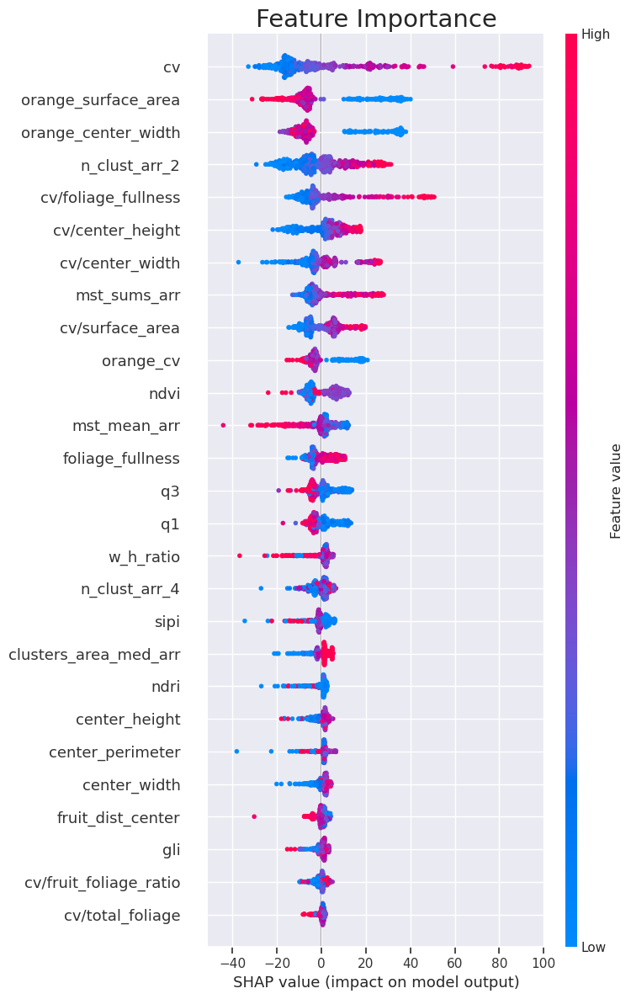

In [68]:
import shap
import matplotlib.pyplot as plt

def plot_shap_summary(model, data, max_display=50):
    # Compute SHAP values
    explainer = shap.Explainer(model, data)
    shap_values = explainer(data)

    # Plot SHAP summary
    shap.summary_plot(shap_values, data, show=False, max_display=max_display)
    
    # Customize the plot
    plt.title("Feature Importance")
    plt.tight_layout()
    plt.show()
    return explainer, shap_values

def plot_waterfall(shap_values,sample_ind ,max_display=50):
    shap.plots.waterfall(shap_values[sample_ind], max_display=max_display)

model_xgb.fit(X_tr_trees, y)
plot_shap_summary(model_xgb, X_tr_trees)


In [69]:
model_xgb = XGBRegressor(**xgb_params)
X_tr_trees["rand_noise"] = np.random.randn(X_tr_trees.shape[0])
X_train_lr, X_test_lr, y_train_lr, y_test_lr = train_test_split(X_tr_trees,y,test_size = 0.2)
model_xgb.fit(X_train_lr,y_train_lr)

result = permutation_importance(model_xgb, X_test_lr, y_test_lr, n_repeats=16, n_jobs=8)
sorted_idx = result.importances_mean.argsort()

/home/fruitspec-lab/anaconda3/envs/FsCounter/lib/python3.8/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/home/fruitspec-lab/anaconda3/envs/FsCounter/lib/python3.8/site-packages/xgboost/data.py:250: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/home/fruitspec-lab/anaconda3/envs/FsCounter/lib/python3.8/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/home/fruitspec-lab/anaconda3/envs/FsCounter/lib/python3.8/site-packages/xgboost/data.py:250: FutureWarn

In [70]:
permutation_importance_res = pd.DataFrame({"names": X_train_lr.columns,"imp": result.importances_mean,
                                          "std": result.importances_std})
permutation_importance_res["l_ci"] = permutation_importance_res["imp"] - 2* permutation_importance_res["std"] 
permutation_importance_res= permutation_importance_res.sort_values("imp",ascending = False)

In [71]:
cfg.drop_from_trees = ["cv^2", "clusters_area_med_arr", "avg_height", "height", "avg_perimeter", "perimeter",
                   "width", "avg_width", "mst_sums_arr^2", "cv/fruit_foliage_ratio", "avg_volume"]

In [72]:
permutation_importance_res

,names,imp,std,l_ci
1,cv,0.174218,0.023204,0.127809
19,n_clust_arr_2,0.084399,0.013539,0.057321
13,mst_sums_arr,0.082664,0.022099,0.038466
4,orange_surface_area,0.067503,0.017048,0.033407
2,mst_mean_arr,0.058748,0.023440,0.011868
7,orange_center_width,0.047949,0.012257,0.023434
25,q1,0.047943,0.017736,0.012471
6,cv/foliage_fullness,0.041583,0.006898,0.027787
3,cv/surface_area,0.038101,0.011630,0.014841
0,cv/center_width,0.037770,0.014920,0.007931


In [73]:
imp_params = permutation_importance_res["names"][permutation_importance_res["imp"]> 0].values
model_xgb = XGBRegressor(**xgb_params)
model_xgb.fit(X_tr_trees[imp_params],y)
print((np.mean(score['test_score']), np.std(score['test_score'])))
print(cross_validate_with_mean(model_xgb,X_tr_trees[imp_params],y,groups = groups))
print(cross_validate_with_mean(model_xgb,X_tr_trees[imp_params],y,groups = groups, use_log1p = True))

(-0.33924935601278966, 0.07514294606991938)
true: 31172.0,    pred: 24880.953125. (20.18 %) (SUMGLD)
true: 10260.0,    pred: 7216.69140625. (29.66 %) (DWDBCL46)
true: 2600.0,    pred: 2283.554443359375. (12.17 %) (2018XXXX)
true: 1464.0,    pred: 1187.5272216796875. (18.88 %) (M7XXXXXX)
true: 1690.0,    pred: 1692.0726318359375. (0.12 %) (LaneLatX)
true: 3006.0,    pred: 2455.79150390625. (18.30 %) (2005XXXX)
true: 3540.0,    pred: 2581.503173828125. (27.08 %) (94000000)
true: 8680.0,    pred: 5793.16357421875. (33.26 %) (Mandarin)
true: 1610.0,    pred: 2264.703125. (40.66 %) (FUKUMOTO)
true: 2226.0,    pred: 2275.556640625. (2.23 %) (DWDBNB05)
true: 1494.0,    pred: 1616.2938232421875. (8.19 %) (2018NINA)
true: 3996.0,    pred: 3088.65869140625. (22.71 %) (DWDBCN51)
true: 7898.0,    pred: 4523.84814453125. (42.72 %) (DWDBMN37)
true: 2354.0,    pred: 1855.259521484375. (21.19 %) (DWDBNB07)
true: 4410.0,    pred: 3560.818359375. (19.26 %) (DWDBMN38)
true: 1569.0,    pred: 1777.01977539

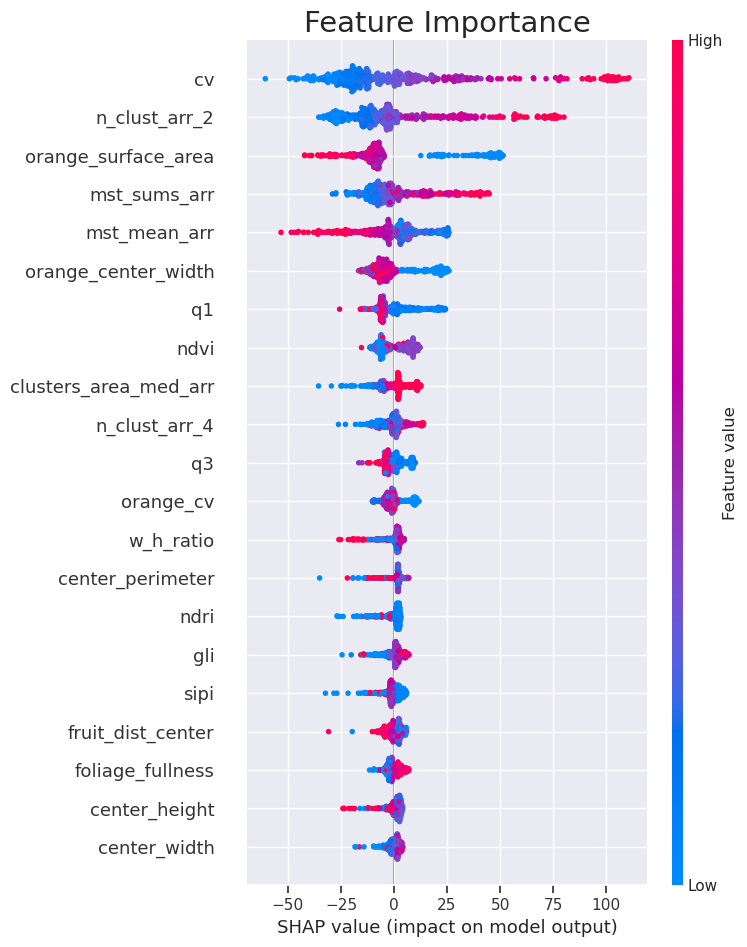

In [75]:
tree_cols_no_interact = ["cv", "mst_mean_arr", "orange_surface_area","orange_center_width", "orange_cv",
        "w_h_ratio", "fruit_dist_center", "mst_sums_arr", "foliage_fullness",
"center_width", "center_height", "center_perimeter", "clusters_area_med_arr", 'n_clust_arr_2', 'n_clust_arr_4',
            "ndvi", "ndri", "sipi", "gli", "q1", "q3"]
X_tr_trees = X_tr_lr.copy()[tree_cols_no_interact]

model_xgb.fit(X_tr_trees, y)
plot_shap_summary(model_xgb, X_tr_trees)

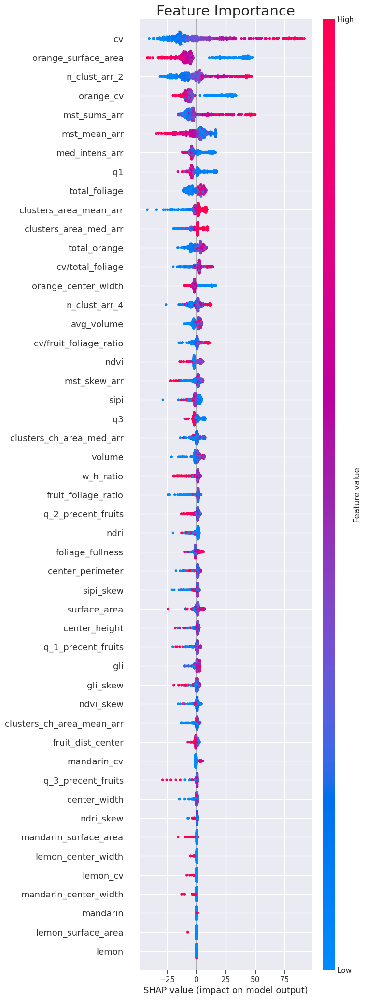

In [82]:
X_tr_trees = X_tr_lr.drop(["cv/surface_area", "cv/center_width", "cv^2", "cv/center_height", 'cv/foliage_fullness',
                           "cv2", "cv3", "cv4", "cv5", "orange"], axis=1)

model_xgb.fit(X_tr_trees, y)
plot_shap_summary(model_xgb, X_tr_trees)

### RF

In [ ]:
X_tr_trees = X_tr_lr.drop(cfg.drop_from_trees,axis = 1)
X_tr_trees = X_tr_lr.copy()[tree_cols]

In [ ]:
rf_params = {'n_estimators': 1773, 'max_depth': 134, 'min_samples_split': 4, 'min_samples_leaf': 2, 
             'max_features': 1.0, 'ccp_alpha': 0.02258939198870146, 'max_samples': 0.6000000000000001}
rf_params = {'n_estimators': 10,
  'min_samples_split': 3,
  'min_samples_leaf': 2,
  'max_features': 0.9000000000000001,
  'ccp_alpha': 2.4115573736096106e-05,
  'max_samples': 0.9}
model_rf = RandomForestRegressor(**rf_params)
score = cross_validate(model_rf, X_tr_trees , y=y,cv=8, n_jobs=-1, scoring="neg_mean_absolute_percentage_error")

In [ ]:
print((np.mean(score['test_score']), np.std(score['test_score'])))
print(cross_validate_with_mean(model_rf,X_tr_trees,y,groups = groups))
print(cross_validate_with_mean(model_rf,X_tr_trees,y,groups = groups, use_log1p = True))

### RF feature importncae

In [ ]:
plot_shap_summary(model_rf, X_tr_trees)

In [ ]:
model_rf = RandomForestRegressor(**rf_params)
X_train_lr, X_test_lr, y_train_lr, y_test_lr = train_test_split(X_tr_trees,y,test_size = 0.2)
model_rf.fit(X_train_lr,y_train_lr)
result = permutation_importance(model_rf, X_test_lr, y_test_lr, n_repeats=16, n_jobs=8)
sorted_idx = result.importances_mean.argsort()
permutation_importance_res = pd.DataFrame({"names": X_train_lr.columns,"imp": result.importances_mean,
                                          "std": result.importances_std})
permutation_importance_res["l_ci"] = permutation_importance_res["imp"] - 2* permutation_importance_res["std"] 
permutation_importance_res= permutation_importance_res.sort_values("imp",ascending = False)
permutation_importance_res

### Lasso

In [ ]:
# import pickle

# # Save the model to a file
# with open('model.pkl', 'wb') as f:
#     pickle.dump(mhsfpp_statisticly, f)


In [ ]:
from sklearn.linear_model import LassoCV
alphas = np.linspace(0.1,50,2500)
las = LassoCV(n_alphas=2500,cv = 8, n_jobs = -1,max_iter=10000, eps=1e-10)
sc = StandardScaler()
las.fit(pd.DataFrame(sc.fit_transform(X_tr_lr), columns = X_tr_lr.columns),y)

las_score = cross_validate(las, sc.fit_transform(X_tr_lr) ,
               y=y,cv=8, n_jobs=-1, scoring="neg_mean_absolute_percentage_error")

In [ ]:
np.mean(las_score["test_score"])

In [ ]:
plt.plot(las.alphas_,np.mean(las.mse_path_,axis = 1))

In [ ]:
X_tr_lr.columns[las.coef_ !=0]

In [ ]:
cols = X_tr_lr.columns[las.coef_ !=0]
X_non_scale = X_tr_lr.copy()[cols]
sc = scalers["Robust"]
X_scaled = sc.fit_transform(X_non_scale)
X_scaled = pd.DataFrame(X_scaled,columns = X_non_scale.columns)
X_tr_lm = sm.add_constant(X_scaled)

model = sm.OLS(y.reset_index(drop=True),X_tr_lm)
results = model.fit()
results.summary()

In [ ]:
from sklearn.base import BaseEstimator, TransformerMixin

class LassoSelector(BaseEstimator, TransformerMixin):
    def __init__(self, estimator):
        self.estimator = estimator

    def fit(self, X, y=None):
        self.estimator.fit(X, y)
        self.coefs_ = self.estimator.coef_
        return self

    def transform(self, X):
        return X[:, self.coefs_ != 0]

# Define the column transformer and the model
lasso = LassoCV(n_alphas=2500,cv = 8, n_jobs = -1,max_iter=10000)
# lasso = LassoCV(alphas=alphas,cv = 8, n_jobs = -1,max_iter=10000)

# Create the pipeline
pipe = Pipeline([("scaler", scalers["Robust"]), 
                 ("lasso_selector", LassoSelector(lasso)),
                 ("final_estimator", LinearRegression())])

las_pipe_score = cross_validate(pipe, X_tr_lr ,
               y=y,cv=8, n_jobs=-1, scoring="neg_mean_absolute_percentage_error")
print(np.mean(las_pipe_score["test_score"]))

In [ ]:
print(cross_validate_with_mean(pipe,X_tr_lr,y,groups = groups))

In [ ]:
print(cross_validate_with_mean(pipe,X_tr_lr[non_zed_cols],y,groups = groups))

In [ ]:
# Create the pipeline
for sclaer in scalers.keys():
    lasso = LassoCV(n_alphas=2500,cv = 8, n_jobs = -1,max_iter=10000)
    pipe = Pipeline([("scaler", scalers[sclaer]), 
                 ("lasso_selector", LassoSelector(lasso)),
                 ("final_estimator", LinearRegression())])
    print(sclaer)
    print(cross_validate_with_mean(pipe,X_tr_lr,y,groups = groups))


In [ ]:
stop here

### optuna

In [ ]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

In [ ]:
np.mean(las_score["test_score"])

In [ ]:
las_score2 = cross_validate(LinearRegression(), X_tr_lr.loc[:,np.abs(las.coef_) > 0] ,
               y=y,cv=8, n_jobs=-1, scoring="neg_mean_absolute_percentage_error")

In [ ]:
print(np.mean(las_score2["test_score"]))

print(X_tr_lr.loc[:,np.abs(las.coef_) > 0].columns)

print(cross_validate_with_mean(LinearRegression(),X_tr_lr.loc[:,np.abs(las.coef_) > 0],y,groups = groups))

print(cross_validate_with_mean(LinearRegression(),X_tr_lr.loc[:,np.abs(las.coef_) > 0],y,groups = groups, use_log1p = True))


In [ ]:
# XGB with feature selection
# train test split
# train xgb
# permutation_importance
# select all with value above zero
# cross validate

def objective_xgb_w_p_import(trial,n_jobs = -1, scoring = "neg_mean_absolute_percentage_error",
                 n_splits=8, shuffle=True, random_state=42, param = None, stratify = None):
    if not isinstance(stratify, type(None)):
        kfolds = StratifiedKFold(n_splits, shuffle= shuffle, random_state=random_state)
    else:
        kfolds = KFold(n_splits=n_splits, shuffle=shuffle, random_state=random_state)
    if isinstance(param, type(None)):
        param = {
            'objective': trial.suggest_categorical('objective', ["reg:squarederror",
                                                                "reg:pseudohubererror","reg:squaredlogerror"]),
            'eta': trial.suggest_float("eta", 0.0001,0.5, log = True),
            'min_child_weight': trial.suggest_float('min_child_weight',1e-2, 5+1e-2, step=1e-2),
            'max_depth': trial.suggest_int('max_depth',1,7),
            'gamma': trial.suggest_float("gamma",1e-3, 2+1e-3, step=1e-3),
            'colsample_bytree': trial.suggest_float('colsample_bytree', 0.3, 1, step=0.1),
            'colsample_bylevel': trial.suggest_float('colsample_bylevel', 0.3, 1, step=0.1),
            "reg_alpha" : trial.suggest_float("reg_alpha" ,0.1, 20, log = True),
            "reg_lambda" : trial.suggest_float("reg_lambda" ,0.1, 20, log = True),
            'subsample': trial.suggest_float('subsample', 0.4, 0.9, step=0.1),
            'n_estimators': trial.suggest_int('n_estimators', 10, 2500, step = 10)

        }
    reg = XGBRegressor(**param)
    
    X_train_lr, X_test_lr, y_train_lr, y_test_lr = train_test_split(X_tr_trees.reset_index(),y,test_size = 0.2)
    reg.fit(X_train_lr,y_train_lr)

    result = permutation_importance(reg, X_test_lr.reset_index(), y_test_lr, n_repeats=8, n_jobs=n_jobs)
    sorted_idx = result.importances_mean.argsort()
    
    permutation_importance_res = pd.DataFrame({"names": X_train_lr.columns,"imp": result.importances_mean,
                                          "std": result.importances_std}) 
    imp_params = permutation_importance_res["names"][permutation_importance_res["imp"]> 0].values
    reg = XGBRegressor(**param)
    
    scores = cross_val_score(reg, X_tr_trees[imp_params].reset_index(),y, cv=kfolds,scoring=scoring)
    return scores.mean()

In [ ]:
def objective_rf(trial,n_jobs = -1, scoring = "neg_mean_absolute_percentage_error",
                 n_splits=8, shuffle=True, random_state=42, param = None, stratify = None):
    if not isinstance(stratify, type(None)):
        kfolds = StratifiedKFold(n_splits, shuffle= shuffle, random_state=random_state)
    else:
        kfolds = KFold(n_splits=n_splits, shuffle=shuffle, random_state=random_state)
    if isinstance(param, type(None)):
        param = {
            'n_estimators': trial.suggest_int("n_estimators",10,5000, step = 10),
#             'max_depth': trial.suggest_int('max_depth', 1,150),
#             'criterion': trial.suggest_categorical('criterion', ["squared_error","absolute_error"]),
            'min_samples_split': trial.suggest_int("min_samples_split", 2,50), ###
            'min_samples_leaf': trial.suggest_int('min_samples_leaf', 2,50),
            'max_features': trial.suggest_float('max_features', 0.3, 1, step=0.1),
            "ccp_alpha" : trial.suggest_float("ccp_alpha" ,1e-16, 0.1, log = True),
            'max_samples': trial.suggest_float('max_samples', 0.4, 0.9, step=0.1),
        }
    reg = RandomForestRegressor(**param)
    scores = cross_val_score(reg, X_tr_trees.reset_index(),y, cv=kfolds,n_jobs = n_jobs,scoring=scoring)
    return scores.mean()


In [ ]:
# TODO try RFE with XGV as a combiend pipeline for paramater search
def objective_xgb(trial,n_jobs = -1, scoring = "neg_mean_absolute_percentage_error",
                 n_splits=8, shuffle=True, random_state=42, param = None, stratify = None):
    if not isinstance(stratify, type(None)):
        kfolds = StratifiedKFold(n_splits, shuffle= shuffle, random_state=random_state)
    else:
        kfolds = KFold(n_splits=n_splits, shuffle=shuffle, random_state=random_state)
    if isinstance(param, type(None)):
        param = {
            'objective': trial.suggest_categorical('objective', ["reg:squarederror",
                                                                "reg:pseudohubererror","reg:squaredlogerror"]),
            'eval_metric': trial.suggest_categorical('eval_metric', ['rmse', 'rmsle', 'mape']),
            'booster': trial.suggest_categorical('booster', ['gbtree', 'gblinear', 'dart']),
            'eta': trial.suggest_float("eta", 0.0001,0.5, log = True),
            'min_child_weight': trial.suggest_float('min_child_weight',1e-2, 5),
            'max_depth': trial.suggest_int('max_depth',1,30),
            'gamma': trial.suggest_float("gamma",1e-3, 3),
            'colsample_bytree': trial.suggest_float('colsample_bytree', 0.3, 1),
            'colsample_bylevel': trial.suggest_float('colsample_bylevel', 0.3, 1),
            "reg_alpha" : trial.suggest_float("reg_alpha" ,0.1, 20),
            "reg_lambda" : trial.suggest_float("reg_lambda" ,0.1, 20),
            'subsample': trial.suggest_float('subsample', 0.1, 0.9),
            'n_estimators': trial.suggest_int('n_estimators', 10, 2500)

        }
    reg = XGBRegressor(**param)
    scores = cross_val_score(reg, X_tr_trees.reset_index(),y, cv=kfolds,scoring=scoring)
    return scores.mean()

In [ ]:
def optimize_estimator(objective,direction='maximize',n_trails = 200,save_int = 0, save_dst="", read_from=""):
    if read_from != "":
        study = joblib.load(read_from)
    else:
        study = optuna.create_study(direction=direction)
    if save_int == 0:
        study.optimize(objective, n_trials=n_trails, n_jobs = -1)
        if save_dst!="":
            joblib.dump(study, save_dst)
    else:
        trails_per_save = np.ceil(n_trails/save_int)
        for i in range(save_int):
            study.optimize(objective, n_trials=trails_per_save)
            if save_dst!="":
                joblib.dump(study, save_dst)
    best_params = study.best_params
    best_score = study.best_value
    print(f"Best score: {best_score}\n")
    print(f"Optimized parameters: {best_params}\n")
    return best_params, best_score

In [ ]:
# {'objective': 'reg:squarederror',
#   'eta': 0.0038689409213598755,
#   'min_child_weight': 0.59,
#   'max_depth': 7,
#   'gamma': 1.8279999999999998,
#   'colsample_bytree': 0.6000000000000001,
#   'colsample_bylevel': 0.8,
#   'reg_alpha': 12.336753937066918,
#   'reg_lambda': 5.161663581823111,
#   'subsample': 0.4,
#   'n_estimators': 540}
optimize_estimator(objective_xgb,n_trails=10000,save_int = 50,save_dst = "study_xgb_notebook_2.pkl",
                   read_from = "study_xgb_notebook_2.pkl")

In [ ]:
optimize_estimator(objective_rf,n_trails=10000,save_int = 50,save_dst = "study_rf_notebook.pkl")

In [ ]:
# optimize_estimator(objective_xgb_w_p_import,n_trails=5000,save_int = 5,save_dst = "study_ndvi_w_p.pkl")

In [ ]:
# optimize_estimator(objective_rf,n_trails=10000,save_int = 100,save_dst = "study_ndvi_rf.pkl", read_from="study_ndvi_rf.pkl")

/home/fruitspec-lab/anaconda3/envs/FsCounter/lib/python3.8/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/home/fruitspec-lab/anaconda3/envs/FsCounter/lib/python3.8/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/home/fruitspec-lab/anaconda3/envs/FsCounter/lib/python3.8/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/home/fruitspec-lab/anaconda3/envs/FsCounter/lib/python3.8/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64In